## Perturbed DG Experiments - 2D Synthetic Data
#### On Duality Gap as a Measure for Monitoring GAN Training
---

This Notebook Contains the Code for the experiments pertaining perturbed DG over 2D Mixture of Gaussian datasets

---

In [1]:
%matplotlib inline

### Imports

In [2]:
from __future__ import print_function, division
import numpy as np 
import sklearn
import json
from sklearn import datasets
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Dropout
from tensorflow.keras.layers import BatchNormalization, Activation, ZeroPadding2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam
import tensorflow.keras.backend as K
import os
from functools import partial
from scipy import stats
import matplotlib.pyplot as plt
import sys
import numpy as np
import pickle

### Fix the seed for reproducibility

In [3]:
tf.random.set_seed(53)

In [4]:
os.environ["CUDA_VISIBLE_DEVICES"]="1"

### Define synthetic 2D datsasets

In [5]:
def gaussian_8_modes(BATCH_SIZE=64):
    scale = 2.
    centers = [
        (1, 0),
        (-1, 0),
        (0, 1),
        (0, -1),
        (1. / np.sqrt(2), 1. / np.sqrt(2)),
        (1. / np.sqrt(2), -1. / np.sqrt(2)),
        (-1. / np.sqrt(2), 1. / np.sqrt(2)),
        (-1. / np.sqrt(2), -1. / np.sqrt(2))
    ]
    centers = [(scale * x, scale * y) for x, y in centers]
    while True:
        dataset = []
        for i in range(BATCH_SIZE):
            point = np.random.randn(2) * .02
            center = centers[np.random.choice(len(centers))]
            point[0] += center[0]
            point[1] += center[1]
            dataset.append(point)
        dataset = np.array(dataset, dtype='float32')
        dataset /= 1.414  
        return dataset
      
def gaussian_9_modes(BATCH_SIZE):
    dataset = []
    for i in range(BATCH_SIZE):
        for x in range(-3, 3,2):
            for y in range(-3, 3,2):
                point = np.random.randn(2) * 0.05
                point[0] += 2 * x
                point[1] += 2 * y
                dataset.append(point)
    dataset = np.array(dataset, dtype='float32')
    np.random.shuffle(dataset)
    dataset /= 2.828  

    return dataset
    
def swiss_roll(BATCH_SIZE):
    batch_data = sklearn.datasets.make_swiss_roll(n_samples=BATCH_SIZE, noise=0.25)[0]
    batch_data = batch_data.astype(np.float32)[:, [0, 2]]
    batch_data /= 7.5
    return batch_data
    
def load_data(dataset,DATASET_SIZE):
    if(dataset == '8_modes'):
        return gaussian_8_modes(DATASET_SIZE)
    elif(dataset == '9_modes'):
        return gaussian_9_modes(DATASET_SIZE)
    elif(dataset=='swiss_roll'):
        return swiss_roll(DATASET_SIZE)
    else:
        print('Invalid Dataset')
        exit(0)

### Loss Functions

In [6]:
bce = tf.keras.losses.BinaryCrossentropy()

def ns_loss(y_true,y_pred):
  return -tf.math.log(y_pred+1e-8)


### Utility

In [7]:

def kde(values, fig_size=(8, 8), bbox=[-2, 2, -2, 2], xlabel="", ylabel="", cmap='BuPu', show=False, save=None):
    
    fig, ax = plt.subplots(figsize=fig_size)
    
    kernel = stats.gaussian_kde(values)

    ax.axis(bbox)
    xx, yy = np.mgrid[bbox[0]:bbox[1]:300j, bbox[2]:bbox[3]:300j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    f = np.reshape(kernel(positions).T, xx.shape)
    cfset = ax.contourf(xx, yy, f, cmap=cmap)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal')

    if save is not None: plt.savefig(save,bbox_inches='tight')
    if show: plt.show()

    plt.close()

    
def dim_vis(D, fig_size=(8, 8), bbox=[-2, 2, -2, 2], xlabel="", ylabel="", cmap='BuPu', 
            color_range=False, show=False, save=None, device='cpu'):

    fig, ax = plt.subplots(figsize=fig_size)
    ax.axis(bbox)
    xx, yy = np.mgrid[bbox[0]:bbox[1]:300j, bbox[2]:bbox[3]:300j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    f = np.reshape(D(positions.T).numpy().T, xx.shape)
    if color_range:
        cfset = ax.contourf(xx, yy, f, levels=np.linspace(0.35, 0.65, 100), cmap=cmap)
    else:
        cfset = ax.contourf(xx, yy, f, 100, cmap=cmap)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect('equal')
    cbar = fig.colorbar(cfset,fraction=0.046, pad=0.04)
    if color_range: 
        seq = [0.35, f.min(), f.mean(), f.max(), 0.65]
        cbar.set_ticks(seq)
        cbar.set_ticklabels(['%.2f' % val for val in np.round(seq, 2)])
        cbar.ax.tick_params(labelsize=22)
        #cbar.set_ticks(np.linspace(0., 1., 11))
    else:
        cbar.set_ticks(np.linspace(f.min(), f.max(), 5))
        cbar.set_ticklabels(['%.2f' % val for val in np.round(np.linspace(f.min(), f.max(), 5), 2)])
    if save is not None: plt.savefig(save,bbox_inches='tight')
    if show: plt.show()

    plt.close()

    

### Log Data

In [8]:
duality_gaps = {}
M1 = {}
M2 = {}
bbox=[-3, 3, -3,3]  

### Model Definitions

#### Parent GAN Class

In [9]:
class _GAN_():
    def __init__(self):
        self.latent_dim = 100
        self.img_shape = (2,)
        optimizer = Adam(5e-4, 0.5)
        self.d_updates = 1
        self.g_updates = 1
        self.name      = 'GAN'
        self.setting   = 'convergence'
        self.discriminator = self.build_discriminator()
        
        self.discriminator.compile(loss=bce,
            optimizer=optimizer,
            metrics=['accuracy'])

        self.generator = self.build_generator()
        z              = Input(shape=(self.latent_dim,))
        img            = self.generator(z)
        self.discriminator.trainable = False
        valid          = self.discriminator(img)
        self.combined  = Model(z, valid)
        self.combined.compile(loss=bce, optimizer=optimizer)

        
        self.D_norm = []
        self.G_norm = []
        self.D_var = []
        self.G_var = []
        self.D_losses = []
        self.G_losses = []
        
        init_var_d = [0.1 for i in range(len(self.discriminator.get_weights()))]
        init_var_g = [0.1 for i in range(len(self.generator.get_weights()))]
        
        self.D_var.append(init_var_d)
        self.G_var.append(init_var_g)
        #--------------------------------------------------------------------
        #                      DUALITY GAP
        #--------------------------------------------------------------------

        self.dg_discriminator = self.build_discriminator()
        self.dg_discriminator.compile(loss=bce,
            optimizer=optimizer,
            metrics=['accuracy'])


        self.dg_generator = self.build_generator()
        z                 = Input(shape=(self.latent_dim,))
        img               = self.dg_generator(z)
        self.dg_discriminator.trainable = False
        valid             = self.dg_discriminator(img)
        self.dg_combined  = Model(z, valid)
        self.dg_combined.compile(loss=bce, optimizer=optimizer)

    def configure_setting(self,setting):
          
        if(setting=='convergence'):
          self.setting = 'convergence'
          self.d_updates = 1
          self.g_updates = 1

        elif(setting=='mode_collapse'):
          self.setting = 'mode_collapse'
          self.d_updates = 15
          self.g_updates = 1
        
        elif(setting=='divergence'):
          self.setting = 'divergence'
          self.d_updates = 1
          self.g_updates = 15
        else:
          return "Invalid Setting"
          
    def build_generator(self):
        model = Sequential()
        model.add(Dense(128 , input_dim=self.latent_dim))
        model.add(Activation("relu"))
        model.add(Dense(128 ))
        model.add(Activation("relu"))
        model.add(Dense(2 , activation=None))
#         model.summary()
        noise = Input(shape=(self.latent_dim,))
        img   = model(noise)

        return Model(noise, img)

    def build_discriminator(self):
        model = Sequential()
        model.add(Dense(128 , input_dim=2))
        model.add(Activation("relu"))
        model.add(Dense(128 ))
        model.add(Activation("relu"))
        model.add(Dense(1, activation='sigmoid'))
#         model.summary()
        img = Input(shape=self.img_shape)
        validity = model(img)

        return Model(img, validity)


    def duality_gap(self):
        
        DG = {}
        M1 = {}
        M2 = {}
        
        M_u_v_worst = 0
        M_u_worst_v = 0

        self.dg_train_d(random=False)
        M_u_v_worst =  self.score()
        self.dg_train_g(random=False)
        M_u_worst_v =  self.score()
        
        DG['vanilla'] = M_u_v_worst - M_u_worst_v
        M1['vanilla'] = M_u_v_worst
        M2['vanilla'] = M_u_worst_v
        
        self.dg_train_d(random=True)
        M_u_v_worst =  self.score()
        self.dg_train_g(random=True)
        M_u_worst_v =  self.score()
        
        DG['local_random'] = M_u_v_worst - M_u_worst_v
        M1['local_random'] = M_u_v_worst
        M2['local_random'] = M_u_worst_v
        
        return DG,M1,M2

    def score(self):
        nsamples = 128
        ntrials  = 100

        scores = []
        for i in range(ntrials):
          idx = np.random.randint(0, self.X.shape[0], nsamples)
          X = tf.convert_to_tensor(self.X[idx])
          noise = tf.convert_to_tensor(np.random.normal(0, 1, (nsamples, self.latent_dim)),dtype=tf.float32)
          score = tf.reduce_mean( tf.math.log(self.dg_discriminator(X)+1e-4)) + tf.reduce_mean(tf.math.log(abs(1 - self.dg_combined(noise)+1e-4)))
          scores.append(score)
        return np.average(scores)

    def dg_train_g(self, epochs=250, batch_size=64, save_interval=50,random=False):

        if(random):
            random_weight_init = [ w + np.random.normal(size=w.shape,scale=np.sqrt(np.asarray(self.G_var)[-1,i])).reshape(w.shape) for i,w in enumerate(self.generator.get_weights())]
            self.dg_generator.set_weights(random_weight_init)
        else:
            self.dg_generator.set_weights(self.generator.get_weights())
        
        self.dg_discriminator.set_weights(self.discriminator.get_weights())
        
        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        print(" M2 - Random : {}".format(random))
        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(1,epochs):
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            g_loss = self.dg_combined.train_on_batch(noise, valid)
            progbar.update(epoch)

    def dg_train_d(self, epochs=250, batch_size=64, save_interval=50,random=False):

        if(random):
            random_weight_init = [ w + np.random.normal(size=w.shape,scale=np.sqrt(np.asarray(self.D_var)[-1,i])).reshape(w.shape) for i,w in enumerate(self.discriminator.get_weights())]
            self.dg_discriminator.set_weights(random_weight_init)
        else:    
            self.dg_discriminator.set_weights(self.discriminator.get_weights())
            
        self.dg_generator.set_weights(self.generator.get_weights())
        
        
        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        print(" M1 - Random : {}".format(random))
        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(1,epochs):
            X_train = self.X
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.dg_generator.predict(noise)
            d_loss_real = self.dg_discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.dg_discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
            progbar.update(epoch)

    def get_valid_label(self,batch_size):
        return np.ones((batch_size, 1))
    
    def get_fake_label(self,batch_size):
        return np.zeros((batch_size, 1))

    def dataset_tune(self,dataset):
        print(dataset,self.setting)
        if(self.setting=='convergence'):
          
          if(dataset=='swiss_roll'):
            self.d_updates = 3
            self.g_updates = 2

          elif(dataset=='8_modes'):
            self.d_updates = 1
            self.g_updates = 1
          
          elif(dataset=='9_modes'):
            self.d_updates = 3
            self.g_updates = 3
          
          else:
            print("Invalid Dataset")
        print(self.d_updates,self.g_updates)
        
        
    def train(self, epochs, batch_size=128, save_interval=50,d_updates=1,g_updates=1,dataset='8_modes',save_path='./',nbatch=100000):
        
        d_updates = self.d_updates
        g_updates = self.g_updates
        X_train = load_data(dataset,nbatch*batch_size)
        self.X = X_train
        self.dataset_tune(dataset)

        idx = np.random.randint(0, X_train.shape[0], 8000)
        gt = X_train[idx]      
        kde(gt.T, show=True, save=os.path.join(save_path, 'ground_truth'), bbox=bbox)

        valid = self.get_valid_label(batch_size)
        fake  = self.get_fake_label(batch_size)

        global M1
        global M2
        global duality_gaps

        progbar = tf.keras.utils.Progbar(epochs)
        for epoch in range(epochs):

            for d_step in range(d_updates):
              X_train = self.X
              idx = np.random.randint(0, X_train.shape[0], batch_size)
              imgs = X_train[idx]
              noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
              gen_imgs = self.generator.predict(noise)

              d_loss_real = self.discriminator.train_on_batch(imgs, valid)
              d_loss_fake = self.discriminator.train_on_batch(gen_imgs, fake)
              d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
            
            
            self.D_losses.append(d_loss)
            for g_step in range(g_updates):
              noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
              g_loss = self.combined.train_on_batch(noise, valid)              
              self.G_losses.append(g_loss)



            if epoch % save_interval == 0:
                d_weights = self.discriminator.get_weights()
                g_weights = self.generator.get_weights()

                d_norm = [ np.linalg.norm(x) for x in d_weights ]
                g_norm = [ np.linalg.norm(x) for x in g_weights ]

                d_var  = [np.var(x) for x in d_weights]
                g_var  = [np.var(x) for x in g_weights]

                self.D_norm.append(d_norm)
                self.G_norm.append(g_norm)
                self.D_var.append(d_var)
                self.G_var.append(g_var)

                DG,M1_,M2_ = self.duality_gap()
                print ("Iteration : %d [D loss: %f, acc.: %.2f%%] [G loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))
                print('Vanilla   Duality GAP : ',DG['vanilla'])
                print('L Random  Duality Gap : ',DG['local_random'])
                duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)].append(DG['vanilla'])
                M1['{}-vanilla-{}'.format(self.name,self.setting)].append(M1_['vanilla'])
                M2['{}-vanilla-{}'.format(self.name,self.setting)].append(M2_['vanilla'])
                
                duality_gaps['{}-local_random-{}'.format(self.name,self.setting)].append(DG['local_random'])
                M1['{}-local_random-{}'.format(self.name,self.setting)].append(M1_['local_random'])
                M2['{}-local_random-{}'.format(self.name,self.setting)].append(M2_['local_random'])
                
                
                save_data = {
                    'DG':{
                        'vanilla': duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': duality_gaps['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'M1':{
                        'vanilla': M1['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': M1['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'M2':{
                        'vanilla': M2['{}-vanilla-{}'.format(self.name,self.setting)],
                        'local_random': M2['{}-local_random-{}'.format(self.name,self.setting)]
                    },
                    'D_norm':np.asarray(self.D_norm),
                    'G_norm':np.asarray(self.G_norm),
                    'D_var':np.asarray(self.D_var),
                    'G_var':np.asarray(self.G_var),
                    'D_losses':np.asarray(self.D_losses),
                    'G_losses':np.asarray(self.G_losses)
                }

                # with open(os.path.join(save_path,'data.json'), 'w') as save_file:
                #   json.dump(save_data, save_file)

                with open( os.path.join(save_path,'data.pkl'), 'wb') as fp:
                    pickle.dump(save_data, fp)

                self.save_imgs(epoch,d_updates,g_updates,save_path=save_path)
            progbar.update(epoch)

    def save_imgs(self, epoch,d_updates=1,g_updates=1,save_path='./'):
        r, c = 1, 1
        visualize_count = 5000
        noise = np.random.normal(0, 1, (visualize_count, self.latent_dim))
        gen_imgs = self.generator.predict(noise)
        
        fig_dir = '{}/iterations'.format(save_path)
        if not os.path.exists(fig_dir):
            os.makedirs(fig_dir)
        
        if(epoch%500==0):
            generator_save_name = os.path.join(fig_dir, 'generator_step_' + str(epoch))
            discriminator_save_name = os.path.join(fig_dir, 'discriminator_step_' + str(epoch))
            kde(gen_imgs.T, show=True, save=generator_save_name, bbox=bbox)
            dim_vis(self.discriminator, show=True, save=discriminator_save_name, bbox=bbox)
        
        else:
            r, c = 3, 2
            visualize_count = 5000
            noise = np.random.normal(0, 1, (visualize_count, self.latent_dim))
            gen_imgs = self.generator.predict(noise)
            
            global duality_gaps
            
            fig, axs = plt.subplots(r, c,figsize=(16,16))
            cnt = 0
            axs[0,0].set_title('Learning Visualization D{} G{}'.format(d_updates,g_updates))
            axs[0,0].scatter(self.X[:visualize_count,0],self.X[:visualize_count,1],color='r',alpha=0.11,label='Real Data')
            axs[0,0].scatter(gen_imgs[:,0],gen_imgs[:,1], color='b',alpha=0.1,label='Fake Data')
            
            axs[0,1].set_title('Duality Gap')
            xaxis = [i*100 for i in range(len(duality_gaps['{}-local_random-{}'.format(self.name,self.setting)]))]
            axs[0,1].plot(xaxis,duality_gaps['{}-vanilla-{}'.format(self.name,self.setting)],label='Vanilla')
            axs[0,1].plot(xaxis,duality_gaps['{}-local_random-{}'.format(self.name,self.setting)],label='Random')
            
            norm_axis = [i*100 for i in range(len(self.D_norm))]
            var_axis = [i*100 for i in range(len(self.D_var))]
            
            axs[1,0].set_title('Discriminator Weight Norm')
            for i in range(len(self.discriminator.get_weights())):
                axs[1,0].plot(norm_axis,np.asarray(self.D_norm)[:,i],label='Layer {}'.format(i+1))

            axs[1,1].set_title('Discriminator Weight Variance')
            for i in range(len(self.discriminator.get_weights())):
                axs[1,1].plot(var_axis,np.asarray(self.D_var)[:,i],label='Layer {}'.format(i+1))
 
            
            axs[2,0].set_title('Generator Weight Norm')
            for i in range(len(self.generator.get_weights())):
                axs[2,0].plot(norm_axis,np.asarray(self.G_norm)[:,i],label='Layer {}'.format(i+1))

            axs[2,1].set_title('Generator Weight Variance')
            for i in range(len(self.generator.get_weights())):
                axs[2,1].plot(var_axis,np.asarray(self.G_var)[:,i],label='Layer {}'.format(i+1))
 
 
            plt.legend()
            
            fig_dir = '{}/dg_plots'.format(save_path)
            if not os.path.exists(fig_dir):
                os.makedirs(fig_dir,exist_ok=True)
            plt.savefig(fig_dir+'/{}.png'.format(epoch))
        
            plt.show()
            plt.close()

        weight_save_path  = '{}/weights'.format(save_path)
        generator_weights = '{}/weights/G/step_{}/'.format(save_path,epoch)
        discriminator_weights = '{}/weights/D/step_{}/'.format(save_path,epoch)
        os.makedirs(generator_weights,exist_ok = True)               
        os.makedirs(discriminator_weights,exist_ok = True)               
        tf.keras.Model.save_weights(self.generator, generator_weights)
        tf.keras.Model.save_weights(self.discriminator, discriminator_weights)
        
        

#### Model Definition


In [10]:

class Classic_GAN(_GAN_):
    def __init__(self):
        super().__init__()
        self.name      = 'GAN'


class NSGAN(_GAN_):
    def __init__(self):
        super().__init__()
        optimizer = Adam(5e-4, 0.5)
        self.name      = 'NSGAN'
        self.combined.compile(loss=ns_loss, optimizer=optimizer)
        self.dg_combined.compile(loss=ns_loss, optimizer=optimizer)


### Experimentation

----------------------------------------------------------------------------------------------------
		8_modes GAN convergence
----------------------------------------------------------------------------------------------------
./Experiments/8_modes/GAN/convergence
8_modes convergence
1 1
 M1 - Random : False
249/250 [============================>.] - ETA: 0sIteration : 0 [D loss: 0.699011, acc.: 50.00%] [G loss: 0.720618]
Vanilla   Duality GAP :  8.340663
L Random  Duality Gap :  8.606382


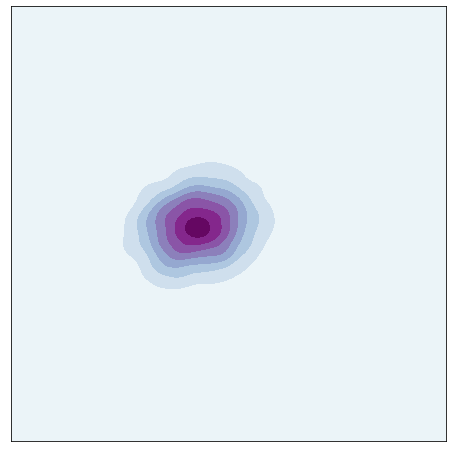

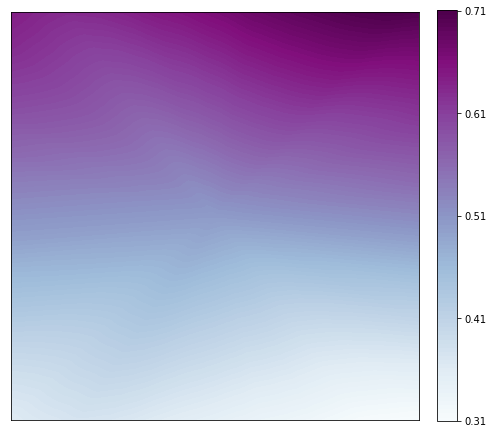

237/250 [===========================>..] - ETA: 0sIteration : 100 [D loss: 0.639131, acc.: 76.95%] [G loss: 0.849536]
Vanilla   Duality GAP :  8.698801
L Random  Duality Gap :  9.101981


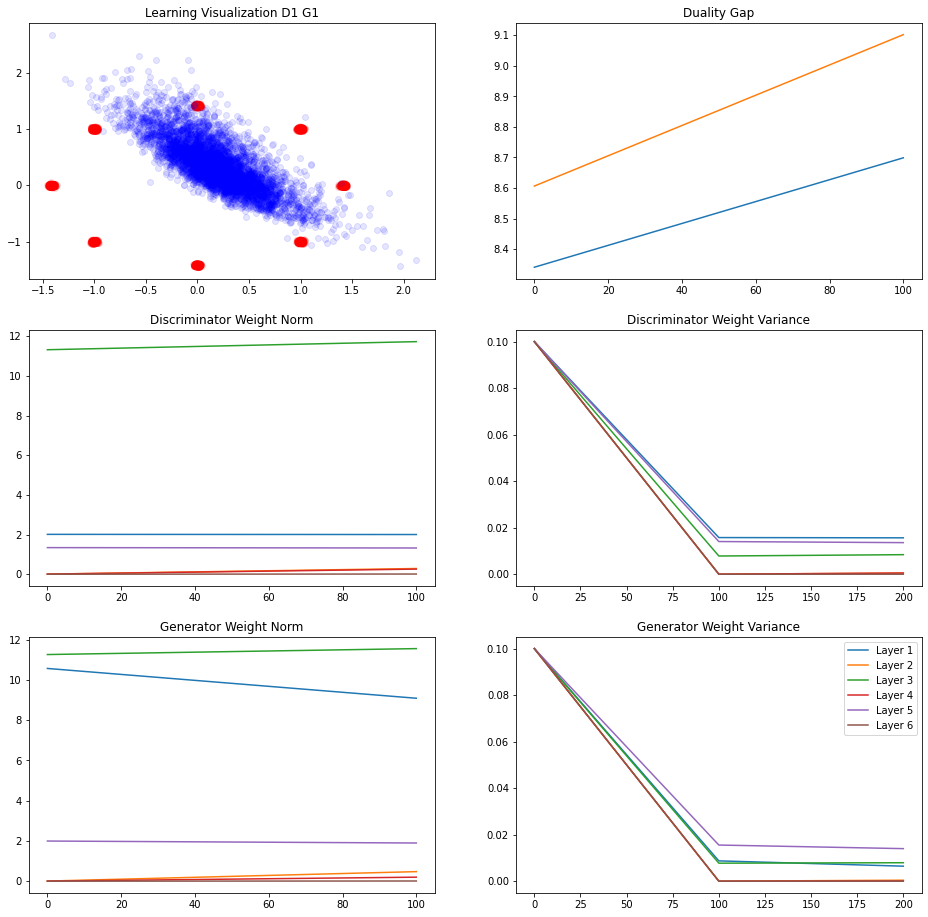

246/250 [============================>.] - ETA: 0sIteration : 200 [D loss: 0.724608, acc.: 49.22%] [G loss: 0.700577]
Vanilla   Duality GAP :  8.0199
L Random  Duality Gap :  8.234227


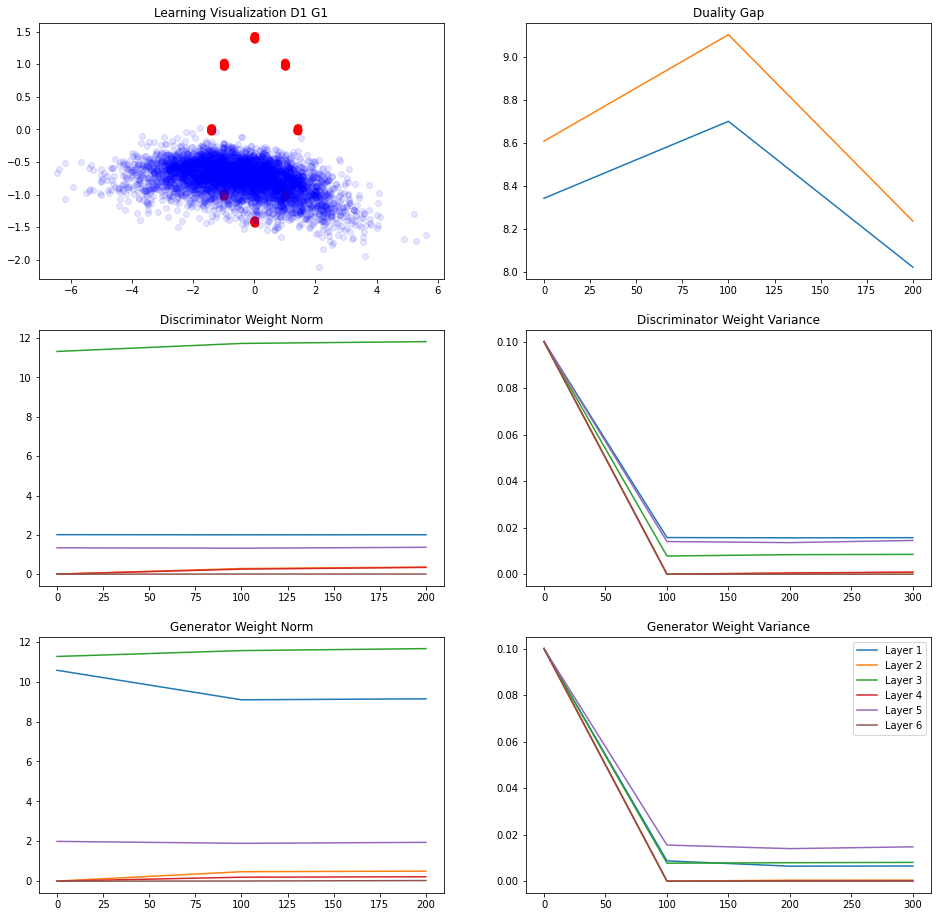

239/250 [===========================>..] - ETA: 0sIteration : 300 [D loss: 0.638527, acc.: 74.61%] [G loss: 0.978607]
Vanilla   Duality GAP :  7.9208913
L Random  Duality Gap :  8.604431


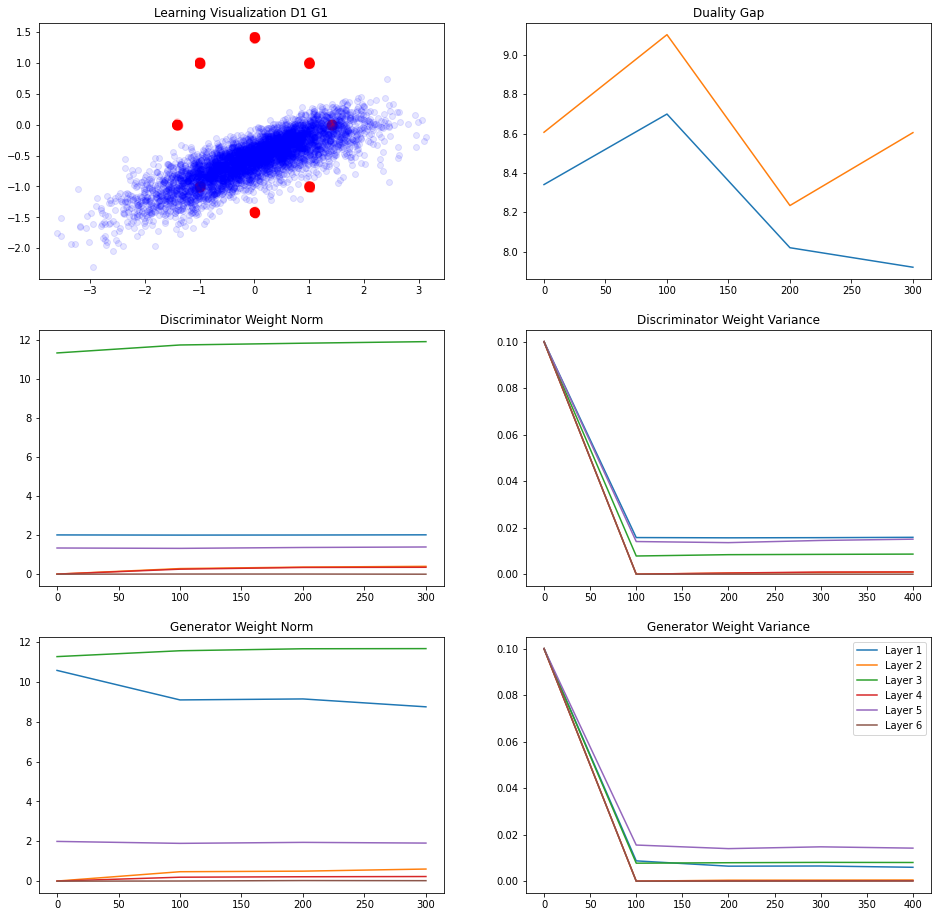

245/250 [============================>.] - ETA: 0sIteration : 400 [D loss: 0.626584, acc.: 71.09%] [G loss: 0.910669]
Vanilla   Duality GAP :  8.104763
L Random  Duality Gap :  8.594713


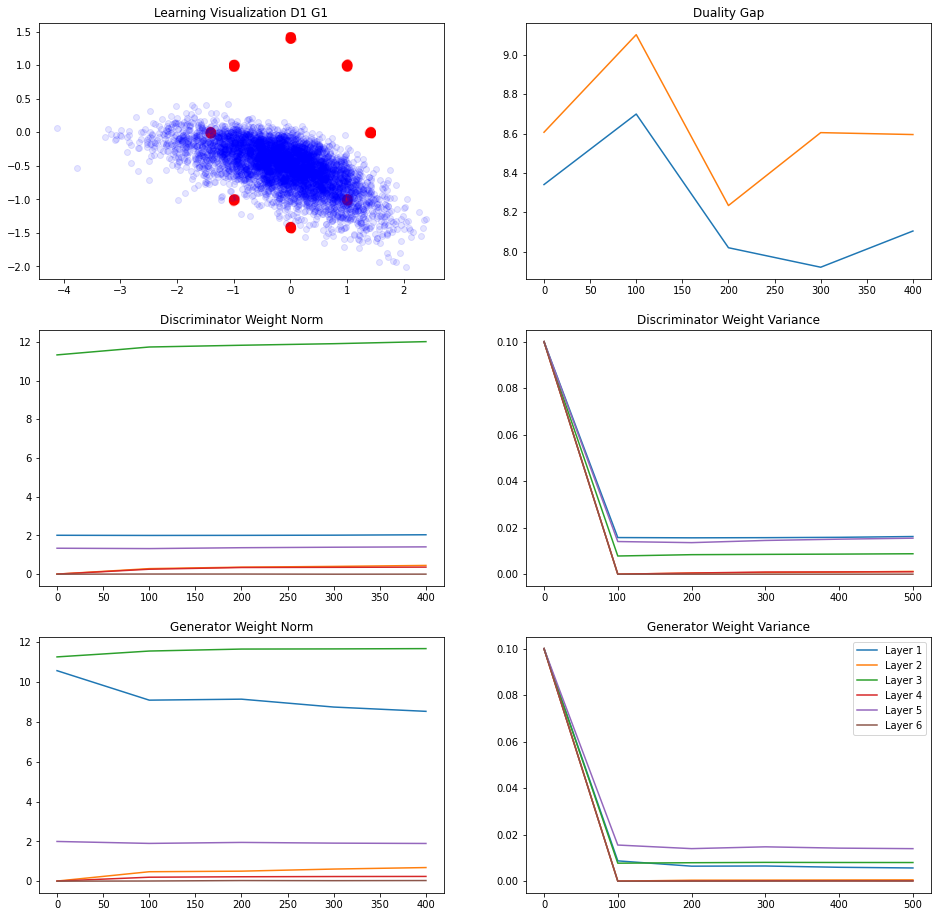

239/250 [===========================>..] - ETA: 0sIteration : 500 [D loss: 0.600966, acc.: 76.17%] [G loss: 0.875898]
Vanilla   Duality GAP :  7.7922406
L Random  Duality Gap :  8.453938


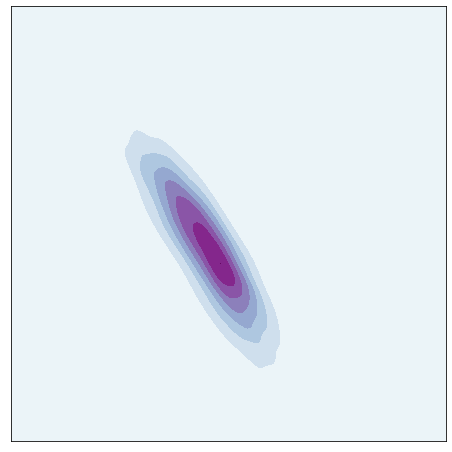

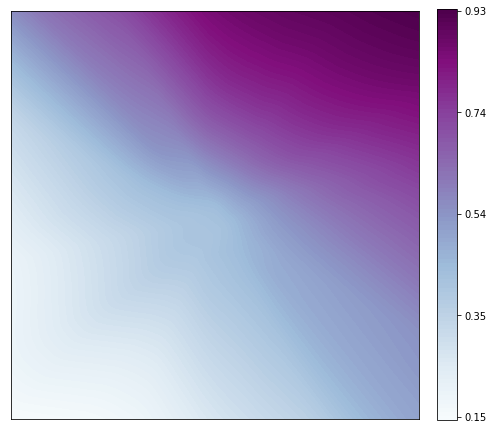

237/250 [===========================>..] - ETA: 0sIteration : 600 [D loss: 0.636183, acc.: 59.38%] [G loss: 0.795299]
Vanilla   Duality GAP :  8.152748
L Random  Duality Gap :  8.702689


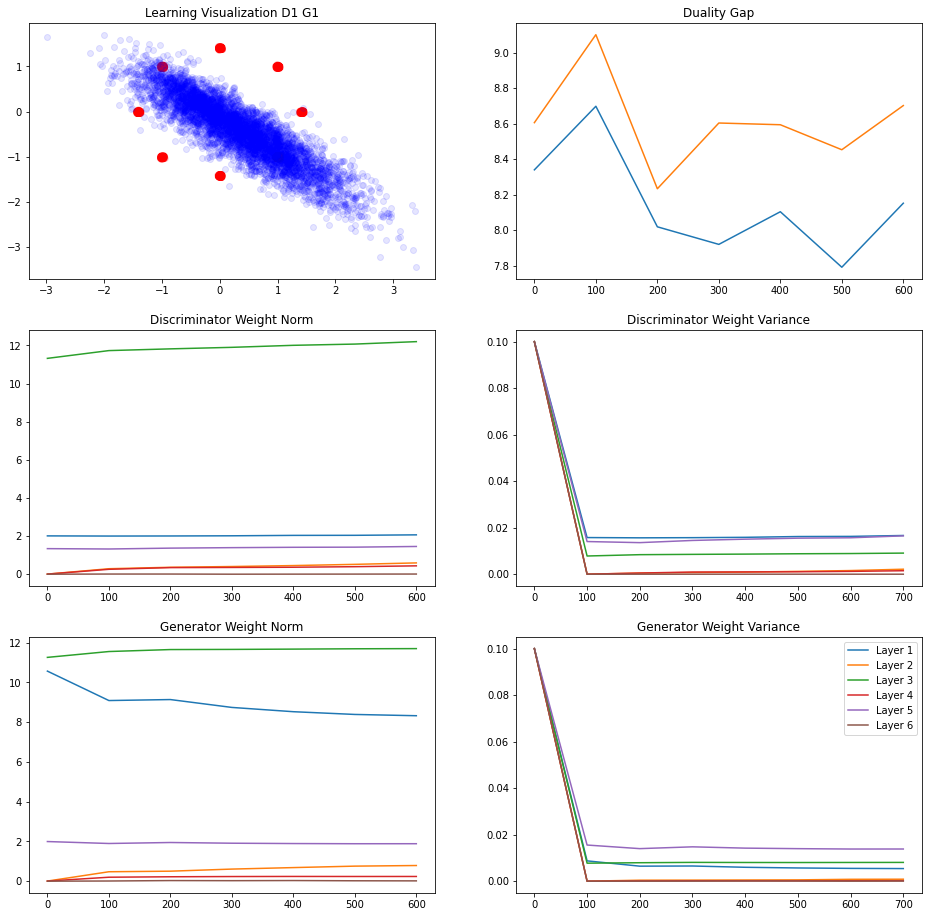

242/250 [============================>.] - ETA: 0sIteration : 700 [D loss: 0.599283, acc.: 69.53%] [G loss: 0.828859]
Vanilla   Duality GAP :  7.887789
L Random  Duality Gap :  8.43637


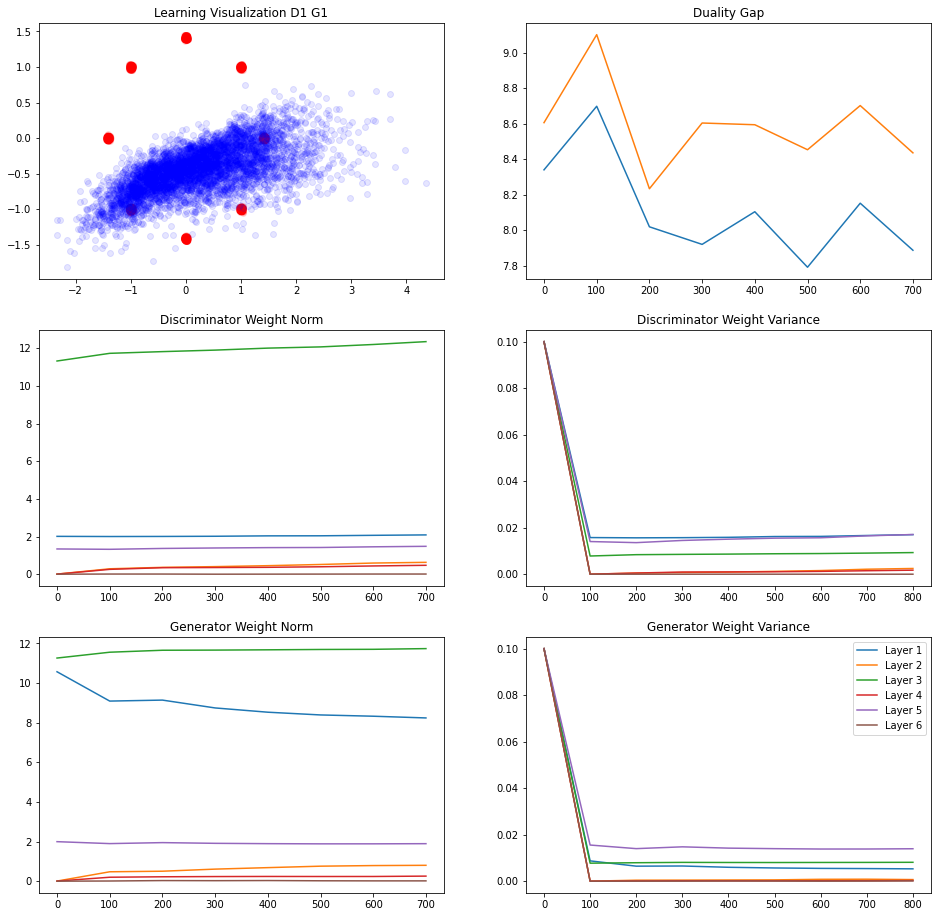

244/250 [============================>.] - ETA: 0sIteration : 800 [D loss: 0.596410, acc.: 66.41%] [G loss: 1.169855]
Vanilla   Duality GAP :  6.9529724
L Random  Duality Gap :  7.6103864


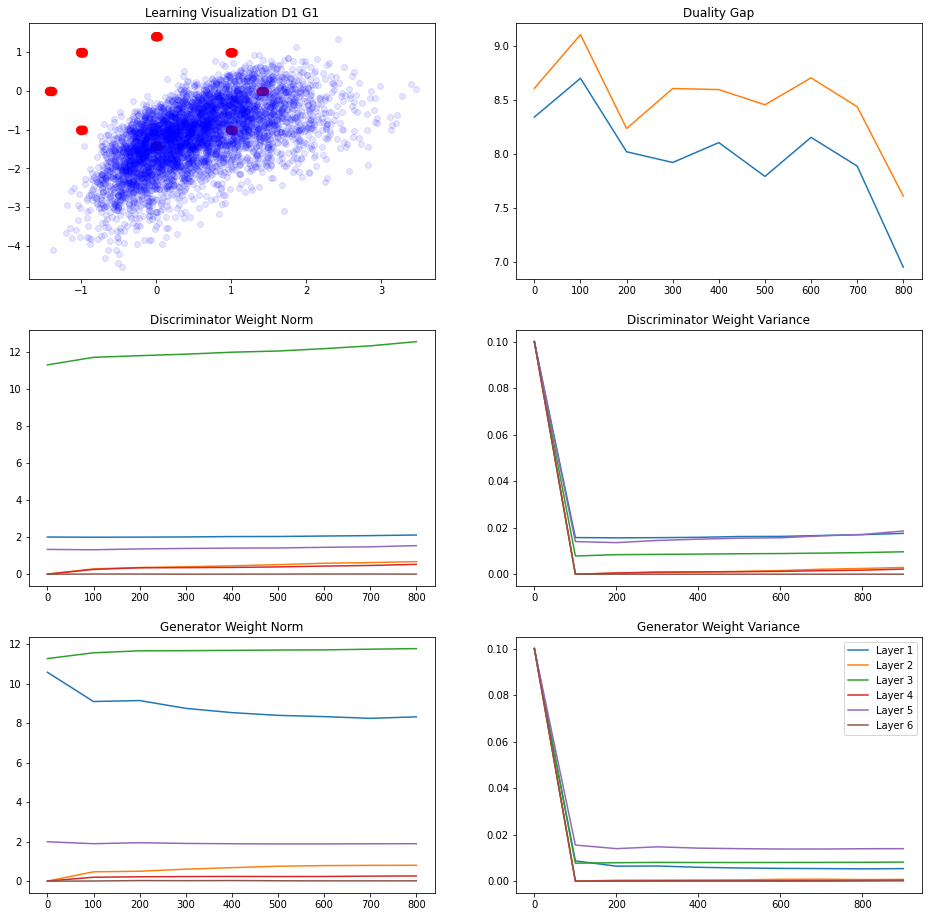

241/250 [===========================>..] - ETA: 0sIteration : 900 [D loss: 0.636539, acc.: 68.75%] [G loss: 0.818032]
Vanilla   Duality GAP :  5.6077924
L Random  Duality Gap :  6.7774324


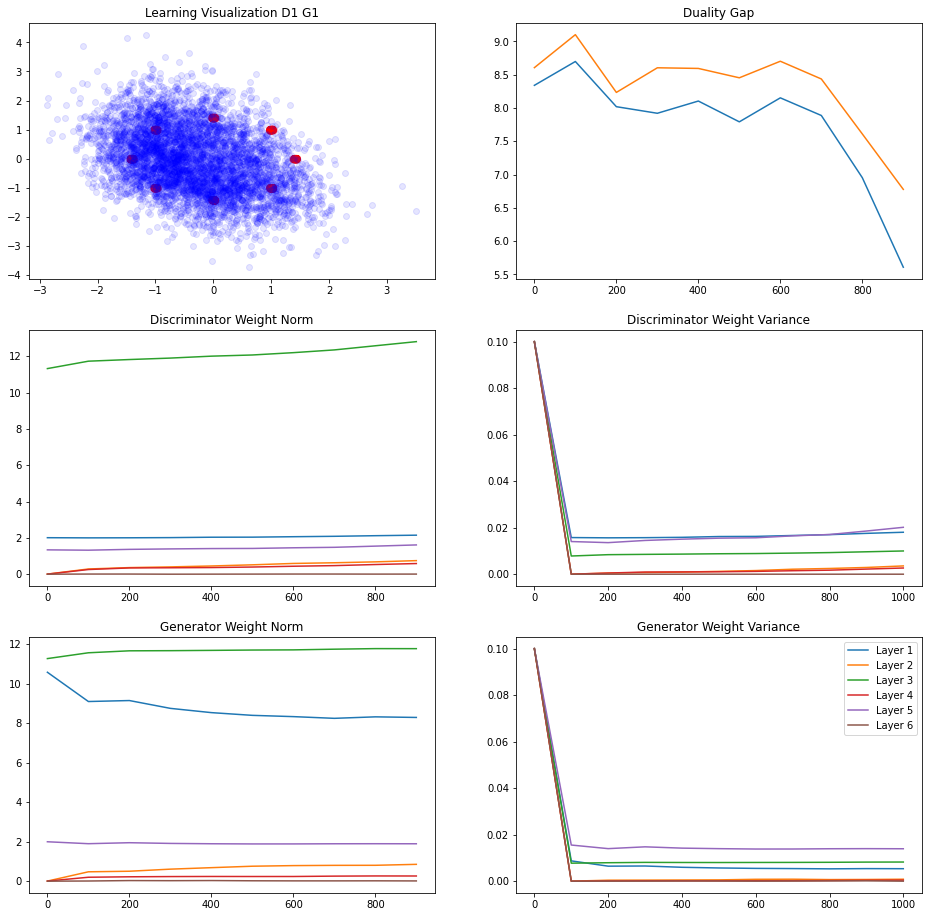

244/250 [============================>.] - ETA: 0sIteration : 1000 [D loss: 0.618014, acc.: 83.59%] [G loss: 0.783669]
Vanilla   Duality GAP :  0.2954185
L Random  Duality Gap :  0.21141195


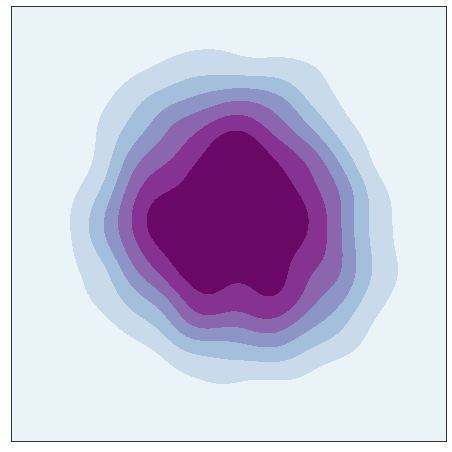

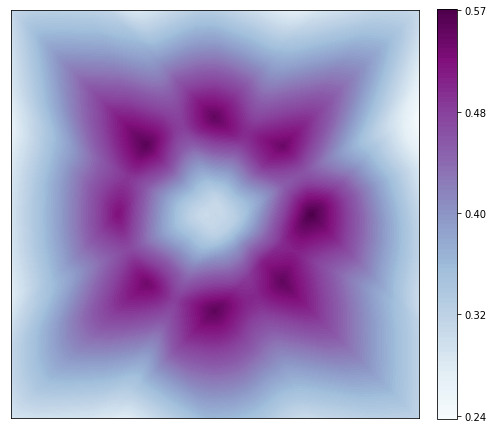

242/250 [============================>.] - ETA: 0sIteration : 1100 [D loss: 0.601888, acc.: 78.91%] [G loss: 0.799641]
Vanilla   Duality GAP :  0.28256702
L Random  Duality Gap :  0.2157445


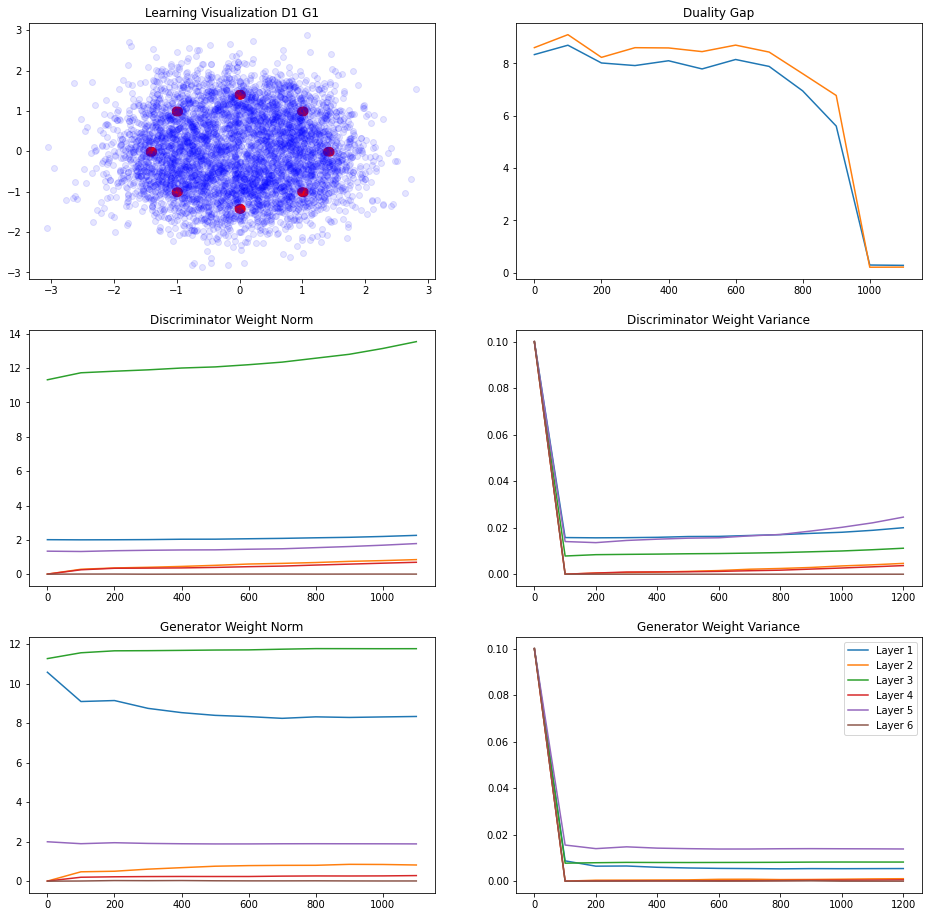

246/250 [============================>.] - ETA: 0sIteration : 1200 [D loss: 0.589184, acc.: 79.30%] [G loss: 0.829943]
Vanilla   Duality GAP :  0.18283272
L Random  Duality Gap :  0.24388409


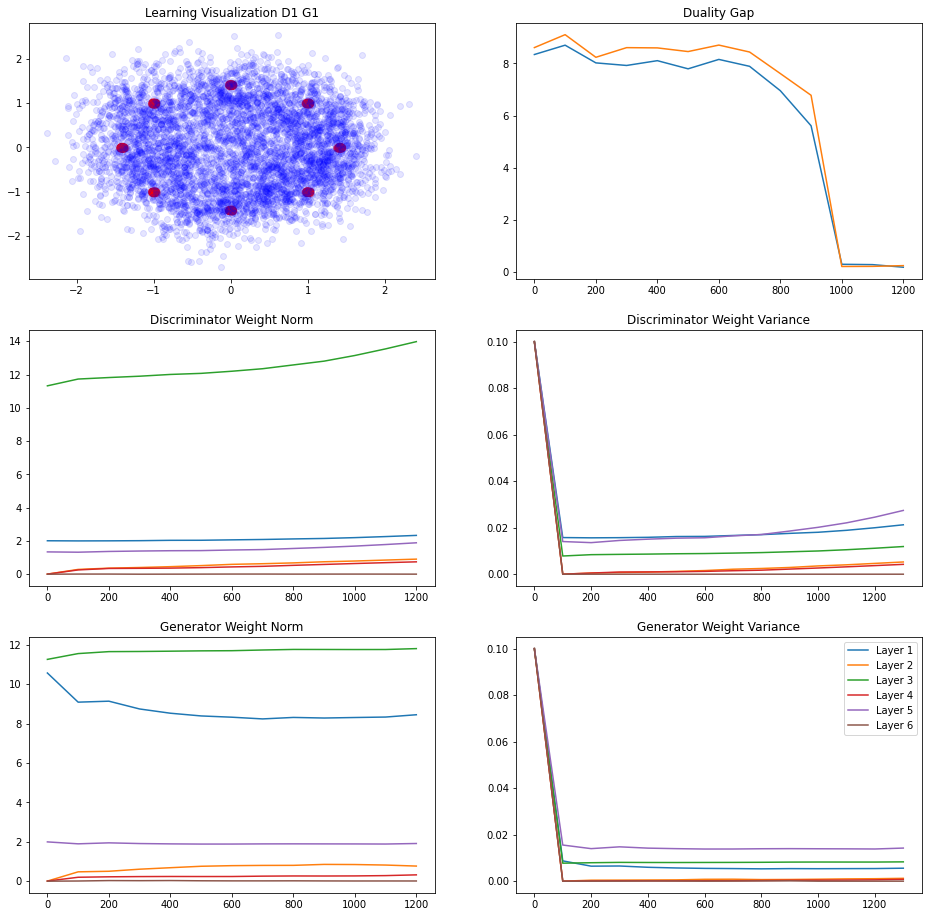

244/250 [============================>.] - ETA: 0sIteration : 1300 [D loss: 0.596389, acc.: 83.98%] [G loss: 0.801443]
Vanilla   Duality GAP :  0.12980533
L Random  Duality Gap :  0.1383152


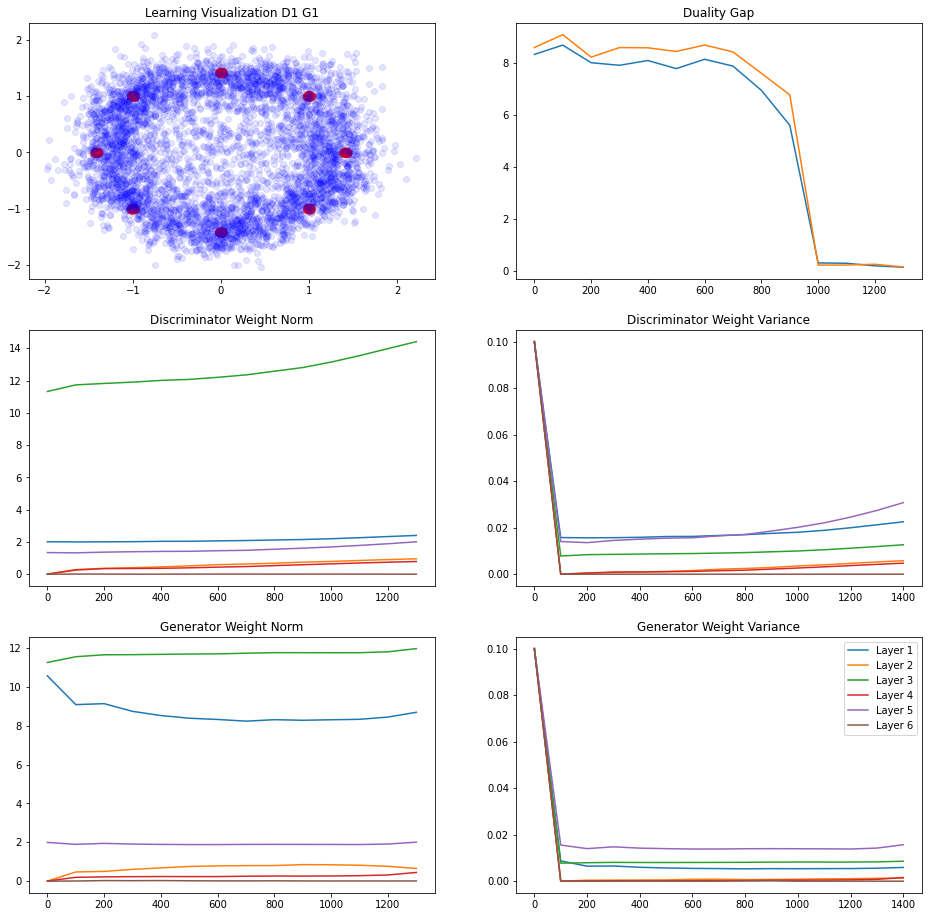

238/250 [===========================>..] - ETA: 0sIteration : 1400 [D loss: 0.593300, acc.: 87.11%] [G loss: 0.828766]
Vanilla   Duality GAP :  0.08783066
L Random  Duality Gap :  -0.081777096


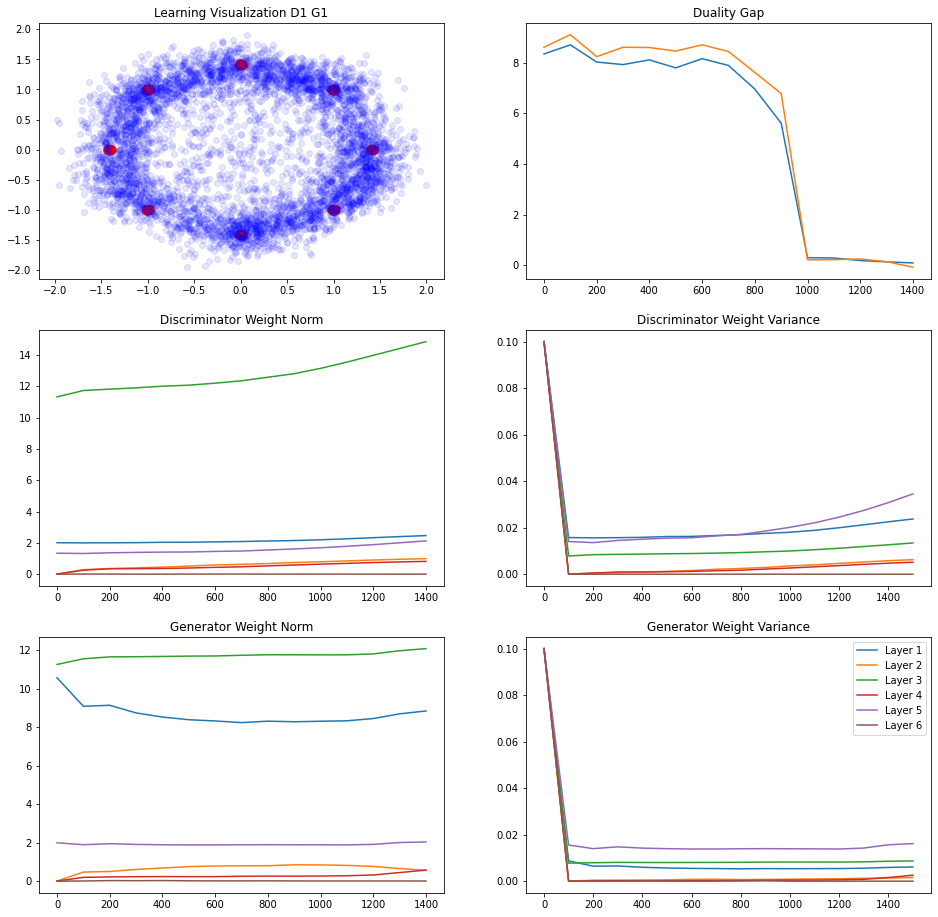

246/250 [============================>.] - ETA: 0sIteration : 1500 [D loss: 0.590344, acc.: 88.67%] [G loss: 0.801814]
Vanilla   Duality GAP :  0.078407526
L Random  Duality Gap :  -0.010056257


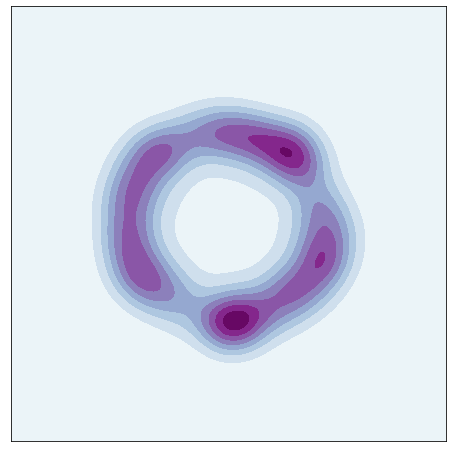

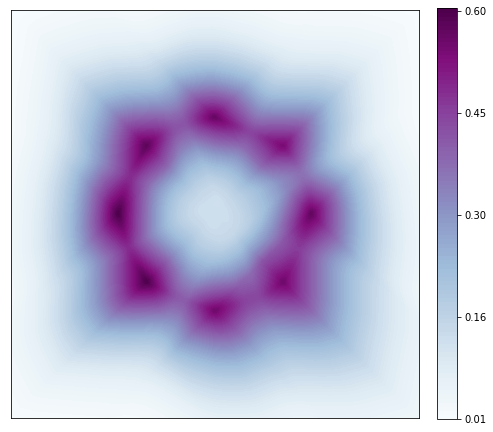

248/250 [============================>.] - ETA: 0sIteration : 1600 [D loss: 0.584083, acc.: 90.23%] [G loss: 0.803549]
Vanilla   Duality GAP :  0.07526958
L Random  Duality Gap :  -0.17321217


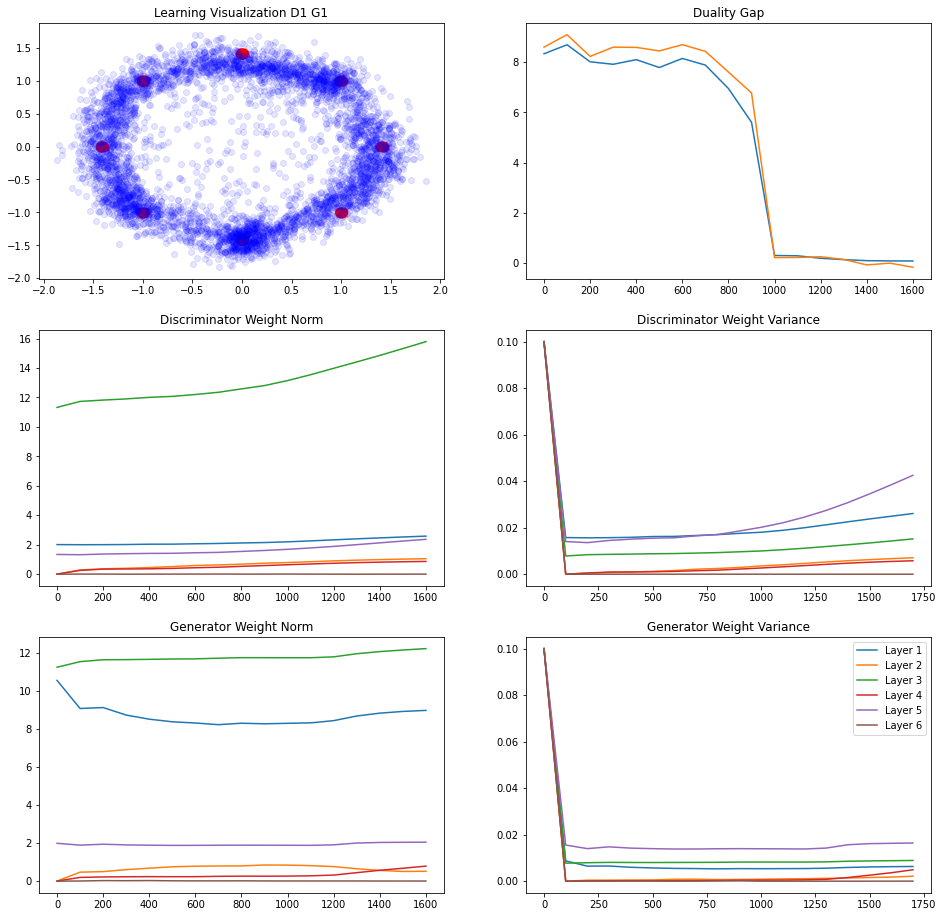

245/250 [============================>.] - ETA: 0sIteration : 1700 [D loss: 0.580198, acc.: 87.50%] [G loss: 0.819205]
Vanilla   Duality GAP :  0.06365013
L Random  Duality Gap :  -0.018736362


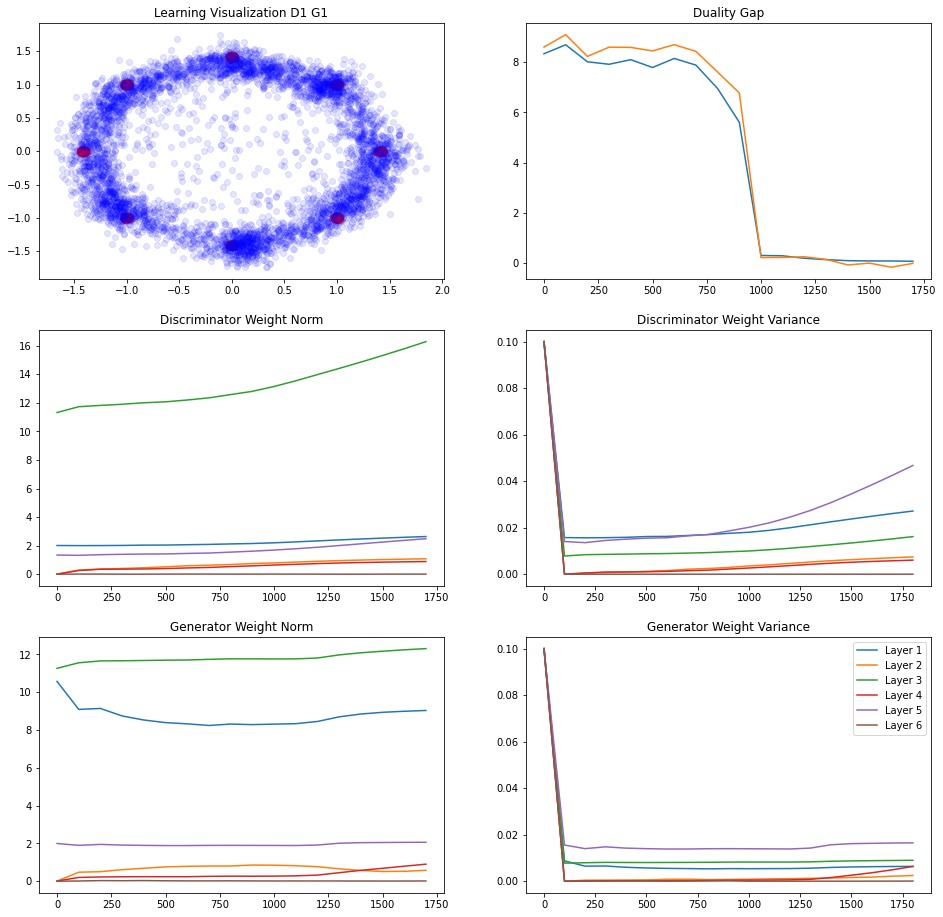

246/250 [============================>.] - ETA: 0sIteration : 1800 [D loss: 0.582816, acc.: 86.33%] [G loss: 0.934093]
Vanilla   Duality GAP :  0.08040488
L Random  Duality Gap :  -0.12241733


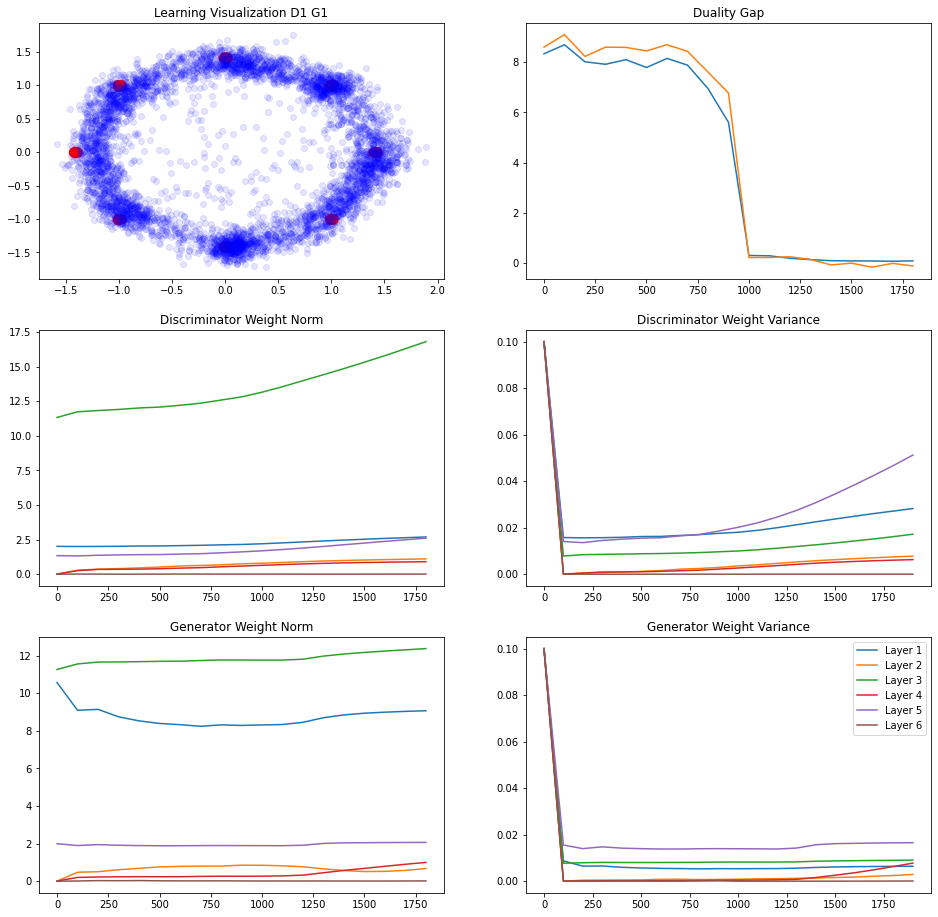

247/250 [============================>.] - ETA: 0sIteration : 1900 [D loss: 0.590853, acc.: 84.38%] [G loss: 0.841657]
Vanilla   Duality GAP :  0.067237854
L Random  Duality Gap :  -0.15926594


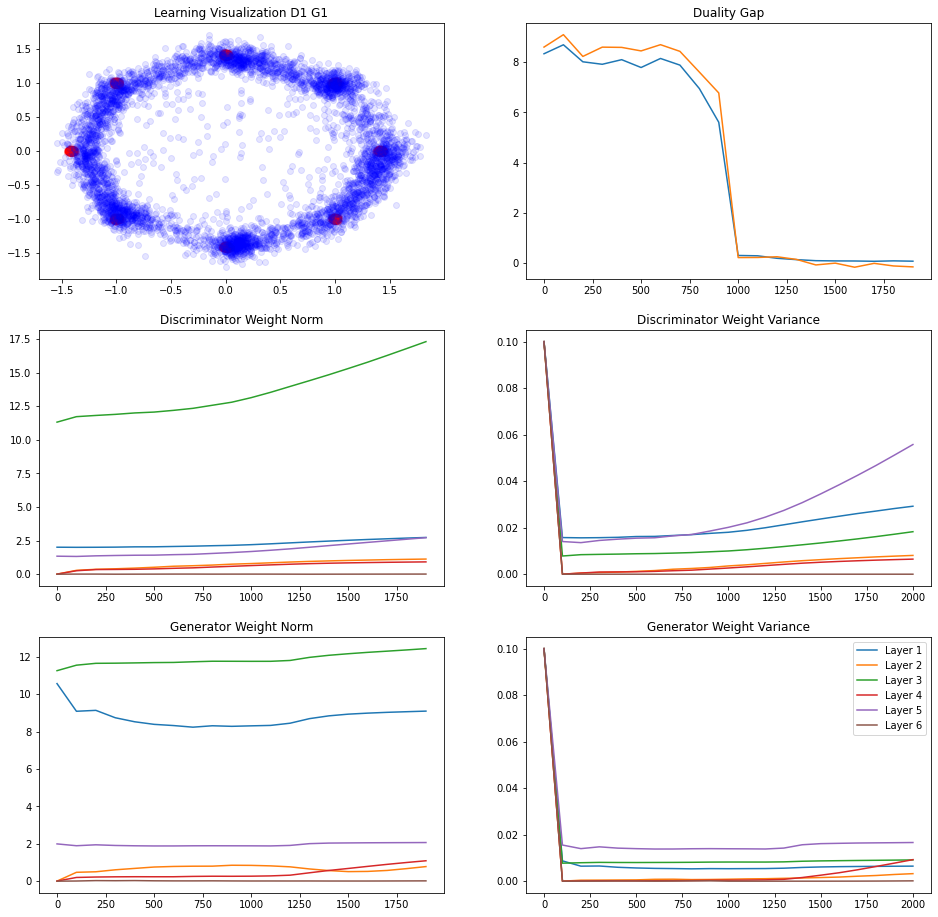

243/250 [============================>.] - ETA: 0sIteration : 2000 [D loss: 0.590209, acc.: 82.42%] [G loss: 0.843279]
Vanilla   Duality GAP :  0.043395996
L Random  Duality Gap :  -0.23780304


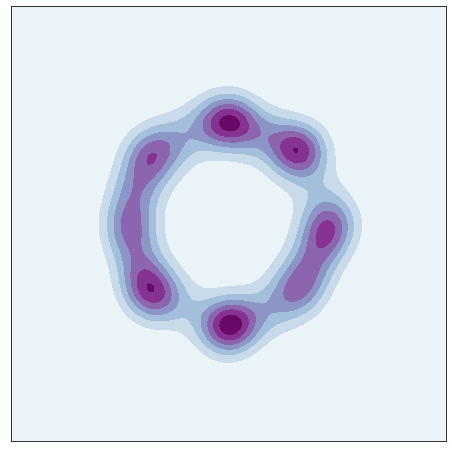

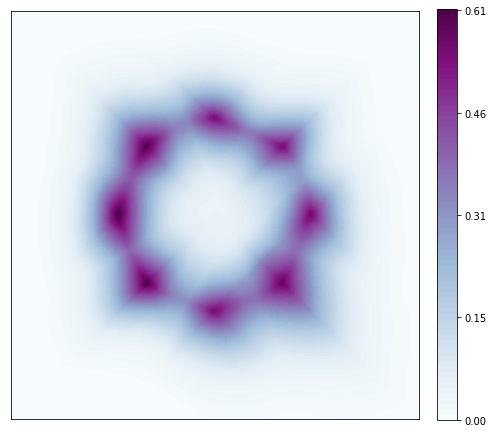

240/250 [===========================>..] - ETA: 0sIteration : 2100 [D loss: 0.582233, acc.: 84.77%] [G loss: 0.896768]
Vanilla   Duality GAP :  0.058529615
L Random  Duality Gap :  -0.30163348


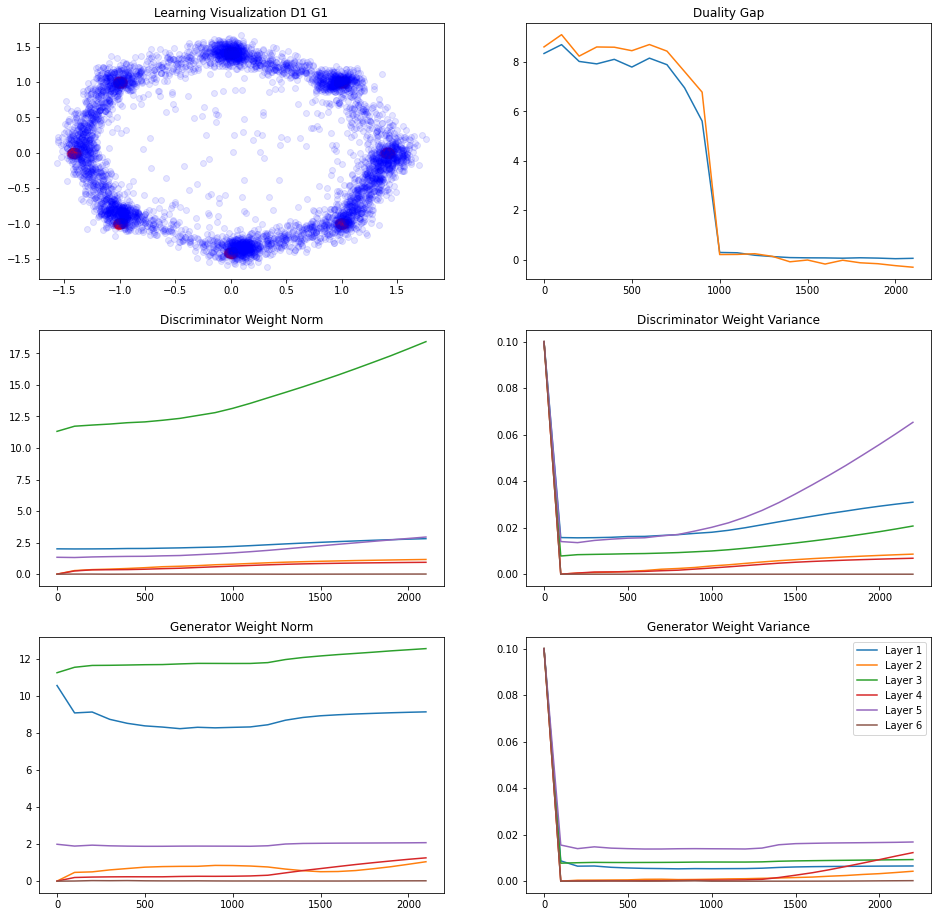

248/250 [============================>.] - ETA: 0sIteration : 2200 [D loss: 0.560308, acc.: 87.89%] [G loss: 0.892898]
Vanilla   Duality GAP :  0.06202793
L Random  Duality Gap :  -0.21922785


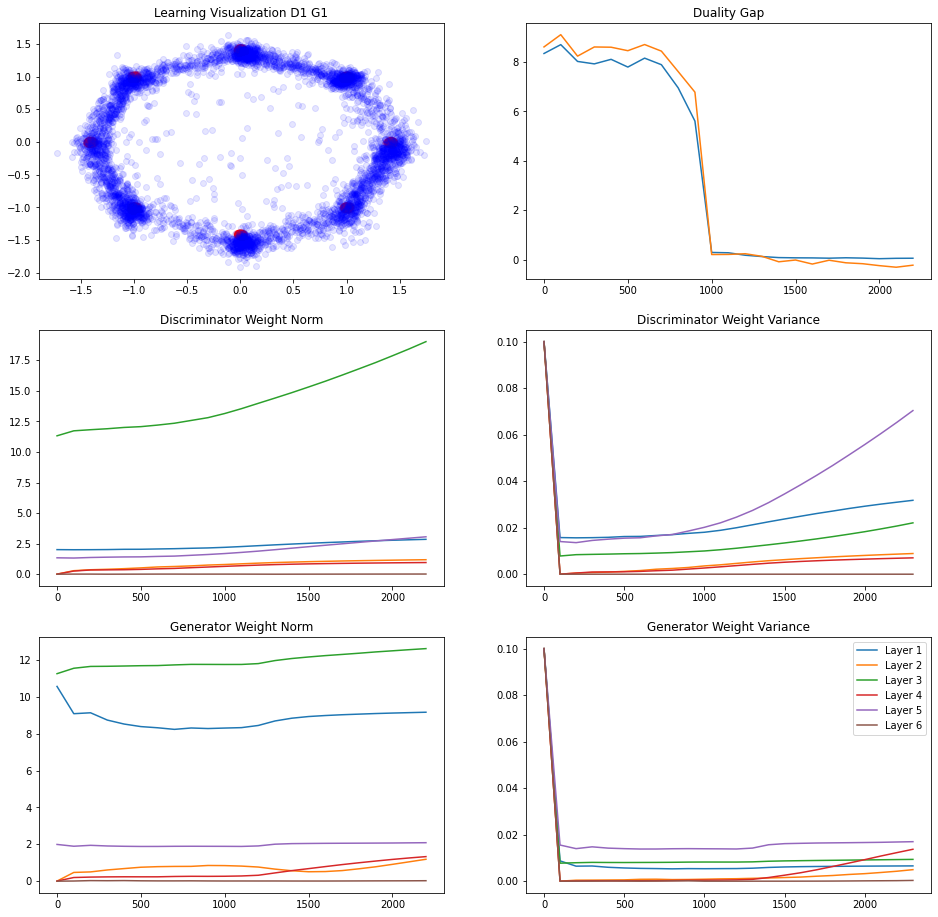

248/250 [============================>.] - ETA: 0sIteration : 2300 [D loss: 0.594816, acc.: 83.59%] [G loss: 0.919886]
Vanilla   Duality GAP :  0.04161322
L Random  Duality Gap :  -0.3313281


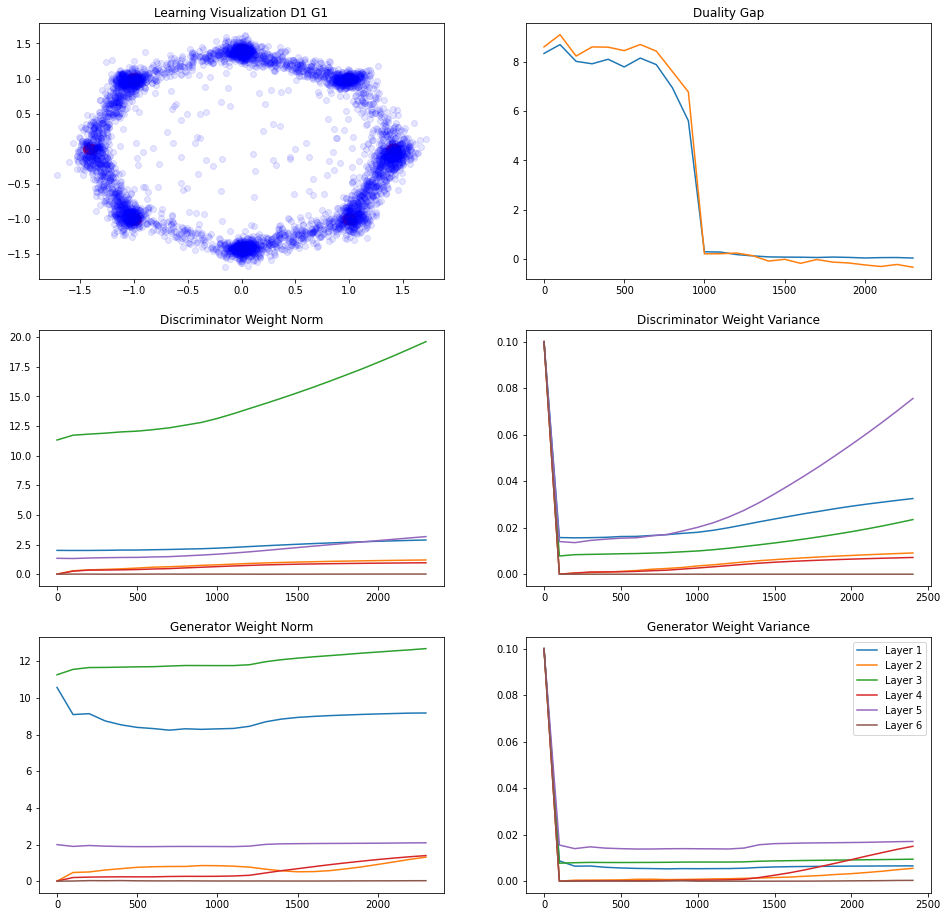

237/250 [===========================>..] - ETA: 0sIteration : 2400 [D loss: 0.590629, acc.: 82.81%] [G loss: 0.886335]
Vanilla   Duality GAP :  0.040314674
L Random  Duality Gap :  -0.3587392


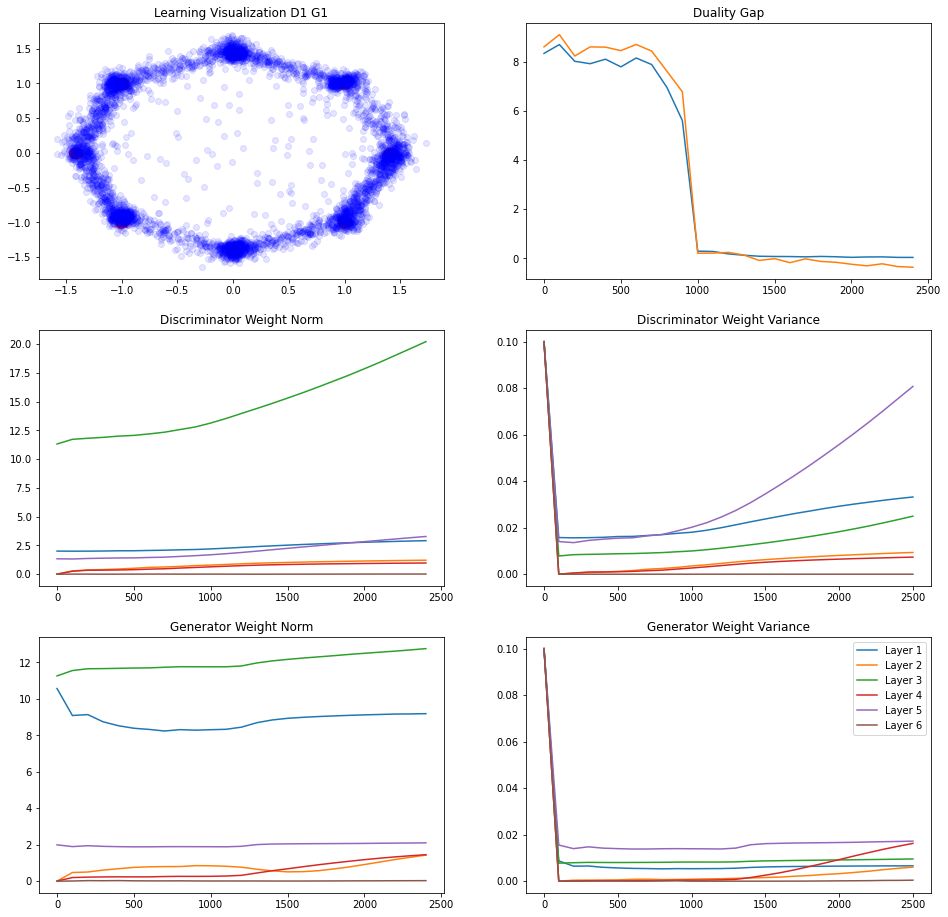

246/250 [============================>.] - ETA: 0sIteration : 2500 [D loss: 0.584458, acc.: 82.81%] [G loss: 0.885235]
Vanilla   Duality GAP :  0.035111547
L Random  Duality Gap :  -0.31775123


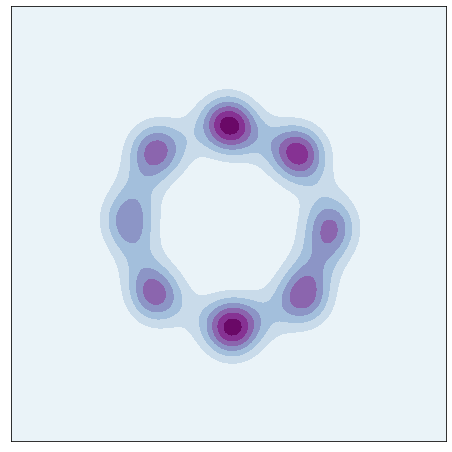

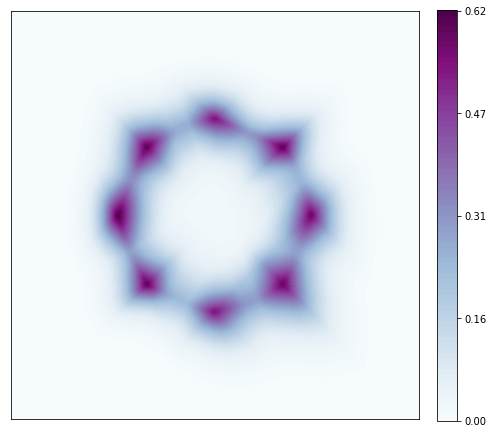

237/250 [===========================>..] - ETA: 0sIteration : 2600 [D loss: 0.576182, acc.: 84.38%] [G loss: 0.925307]
Vanilla   Duality GAP :  0.035869956
L Random  Duality Gap :  -0.34375447


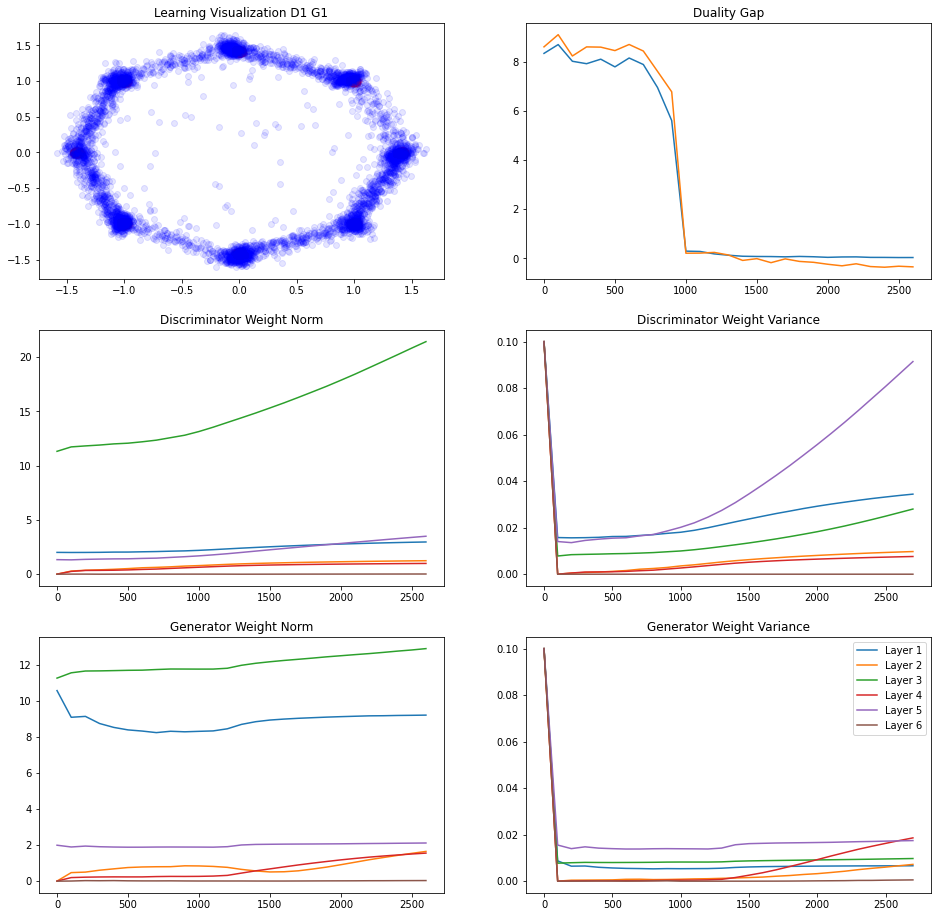

242/250 [============================>.] - ETA: 0sIteration : 2700 [D loss: 0.566884, acc.: 82.42%] [G loss: 0.881729]
Vanilla   Duality GAP :  0.038719654
L Random  Duality Gap :  -0.4648738


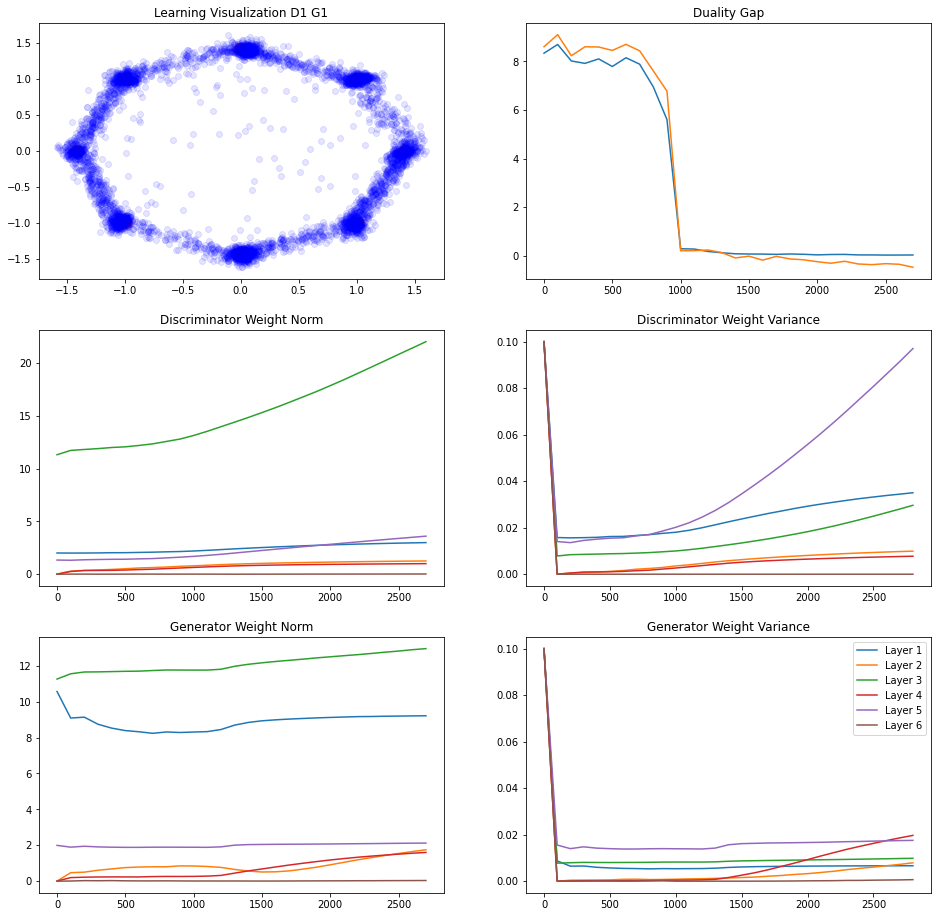

240/250 [===========================>..] - ETA: 0sIteration : 2800 [D loss: 0.576303, acc.: 78.52%] [G loss: 0.835007]
Vanilla   Duality GAP :  0.030376911
L Random  Duality Gap :  -0.42856032


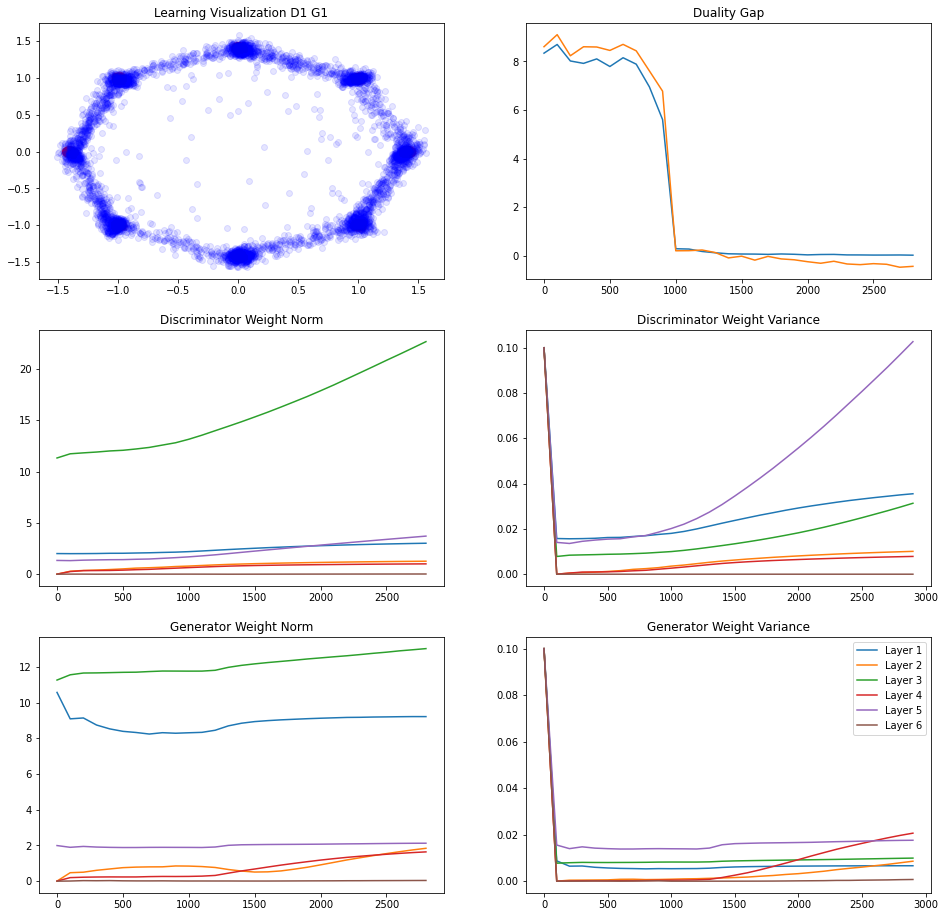

240/250 [===========================>..] - ETA: 0sIteration : 2900 [D loss: 0.581886, acc.: 78.52%] [G loss: 0.925823]
Vanilla   Duality GAP :  0.11268723
L Random  Duality Gap :  -0.3554266


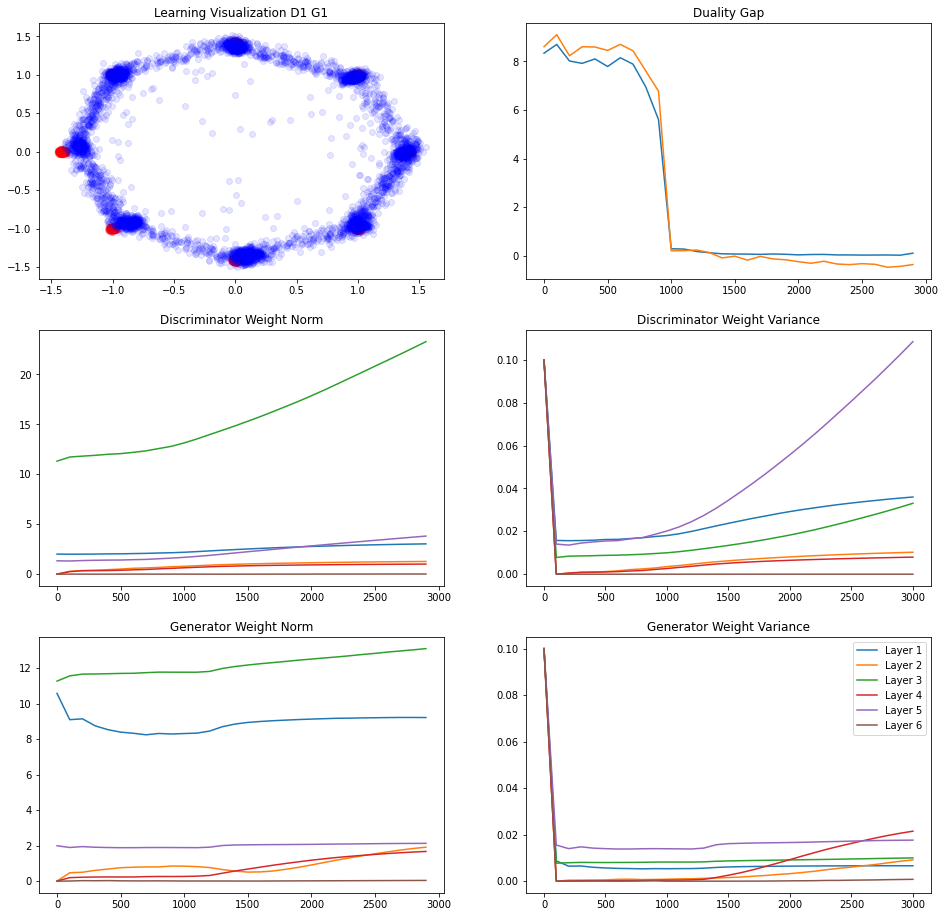

237/250 [===========================>..] - ETA: 0sIteration : 3000 [D loss: 0.601377, acc.: 74.61%] [G loss: 0.880357]
Vanilla   Duality GAP :  0.04240179
L Random  Duality Gap :  -0.44338727


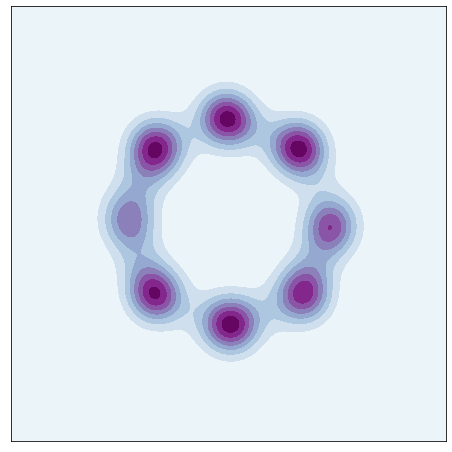

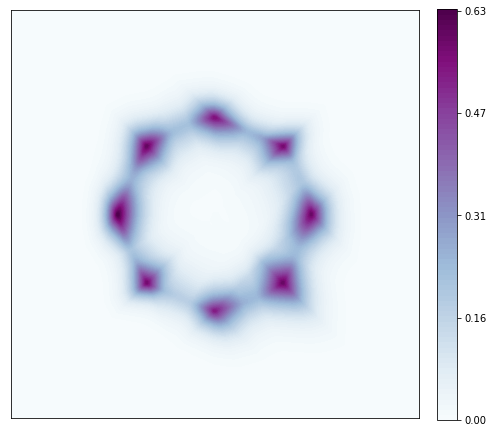

245/250 [============================>.] - ETA: 0sIteration : 3100 [D loss: 0.601970, acc.: 73.83%] [G loss: 0.952225]
Vanilla   Duality GAP :  0.017206788
L Random  Duality Gap :  -0.5332707


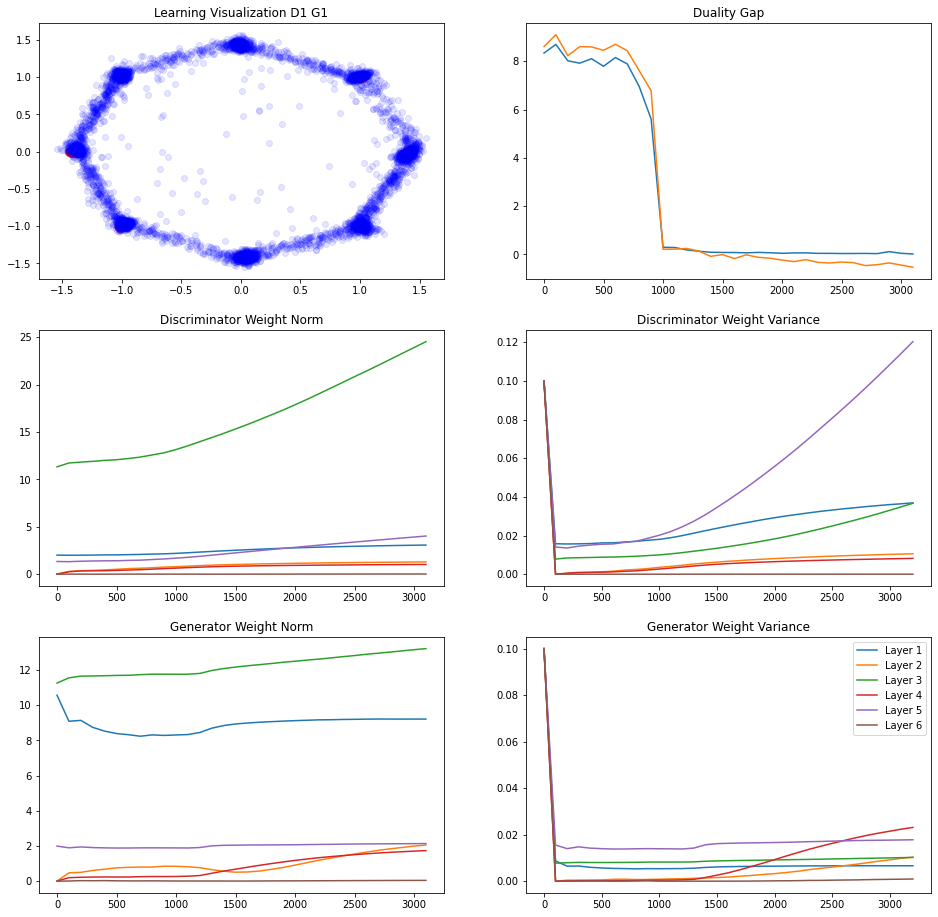

248/250 [============================>.] - ETA: 0sIteration : 3200 [D loss: 0.599853, acc.: 74.22%] [G loss: 1.065109]
Vanilla   Duality GAP :  0.06846619
L Random  Duality Gap :  -0.5484176


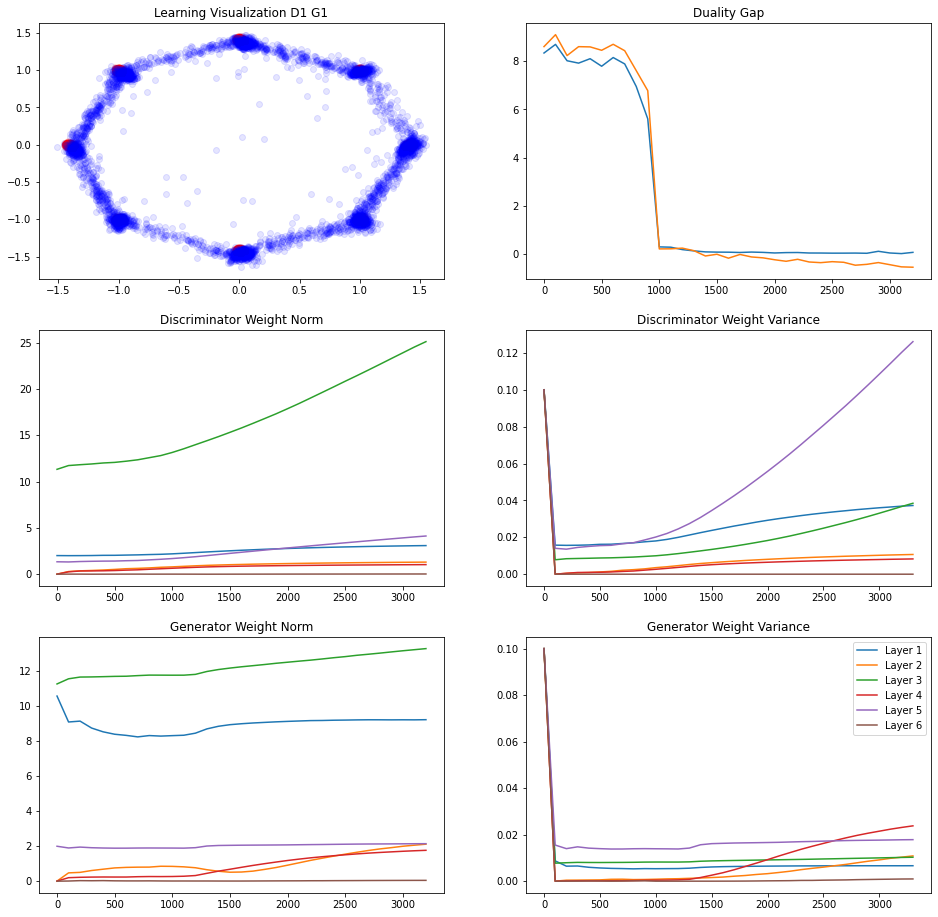

244/250 [============================>.] - ETA: 0sIteration : 3300 [D loss: 0.598085, acc.: 75.00%] [G loss: 0.895083]
Vanilla   Duality GAP :  0.08706689
L Random  Duality Gap :  -0.45289958


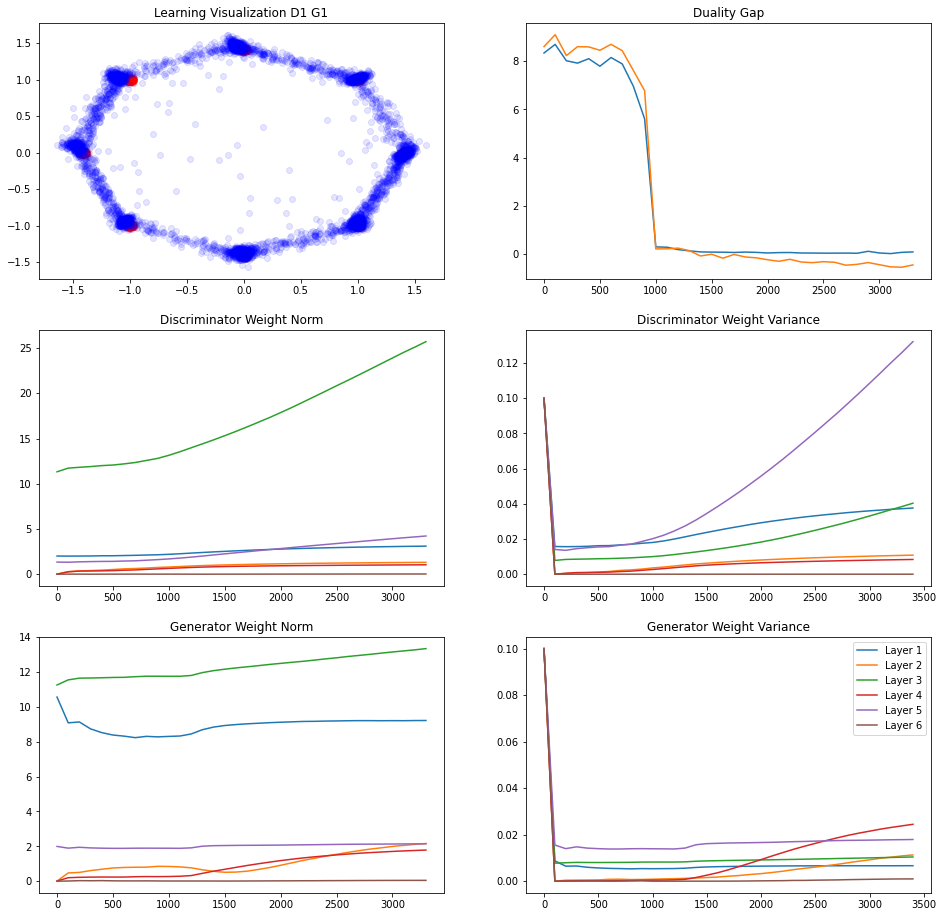

246/250 [============================>.] - ETA: 0sIteration : 3400 [D loss: 0.577445, acc.: 79.30%] [G loss: 0.967906]
Vanilla   Duality GAP :  0.035650373
L Random  Duality Gap :  -0.53459907


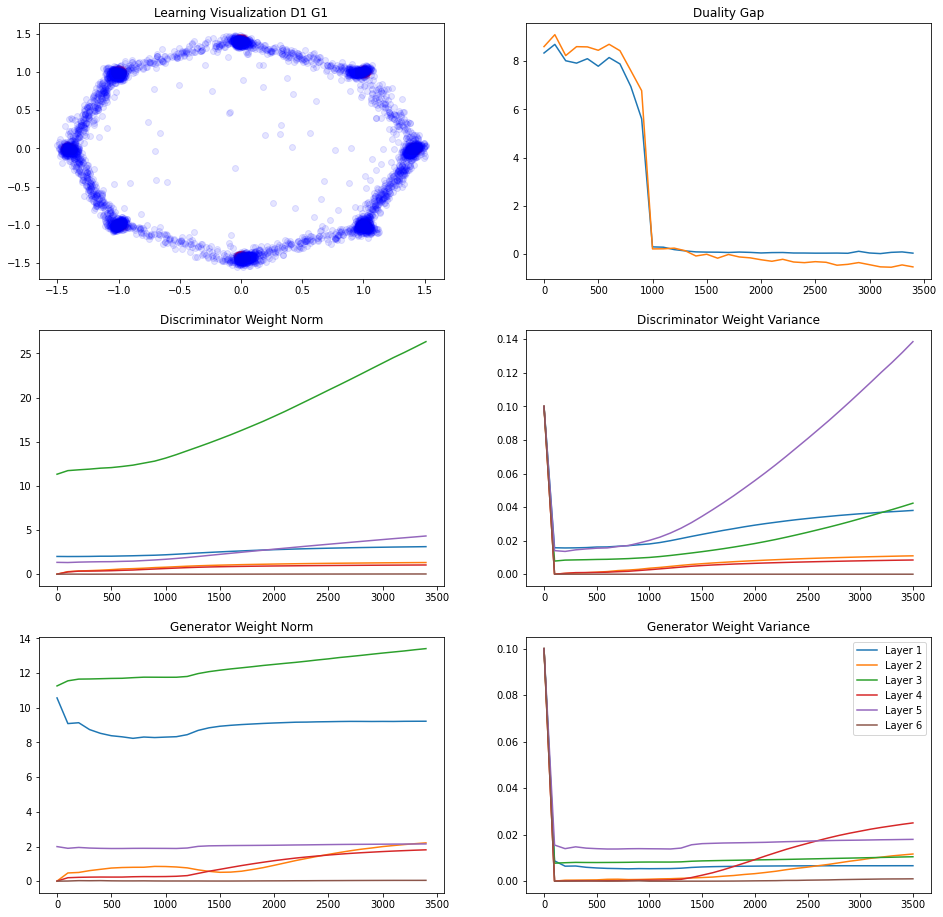

249/250 [============================>.] - ETA: 0sIteration : 3500 [D loss: 0.593752, acc.: 71.88%] [G loss: 0.906555]
Vanilla   Duality GAP :  0.03887868
L Random  Duality Gap :  -0.5415358


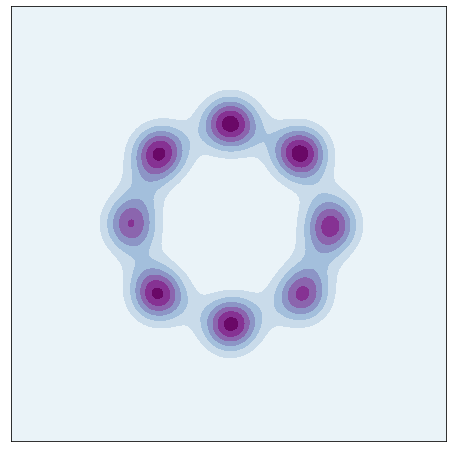

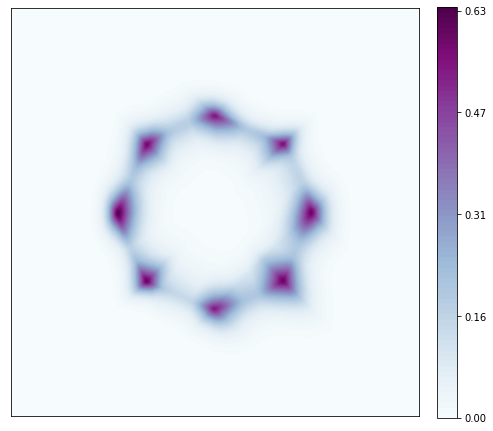

244/250 [============================>.] - ETA: 0sIteration : 3600 [D loss: 0.589667, acc.: 76.56%] [G loss: 0.998611]
Vanilla   Duality GAP :  0.09921026
L Random  Duality Gap :  -0.5821968


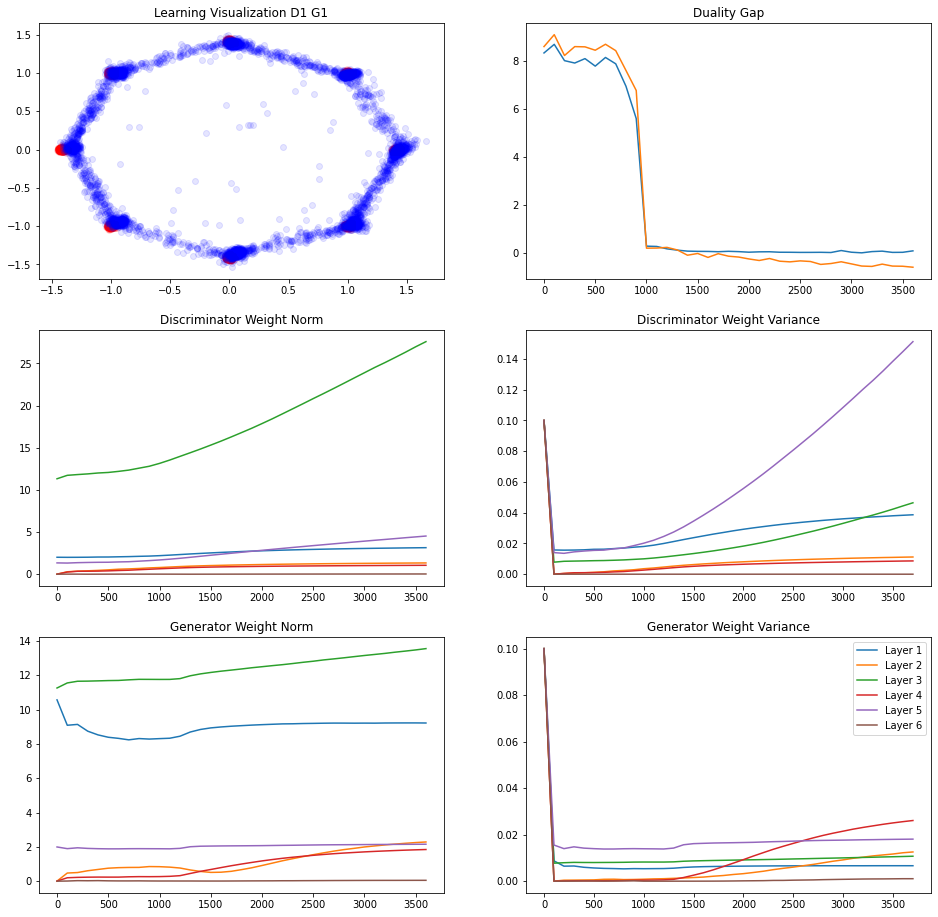

248/250 [============================>.] - ETA: 0sIteration : 3700 [D loss: 0.584212, acc.: 79.30%] [G loss: 0.920083]
Vanilla   Duality GAP :  0.0018464327
L Random  Duality Gap :  -0.57305324


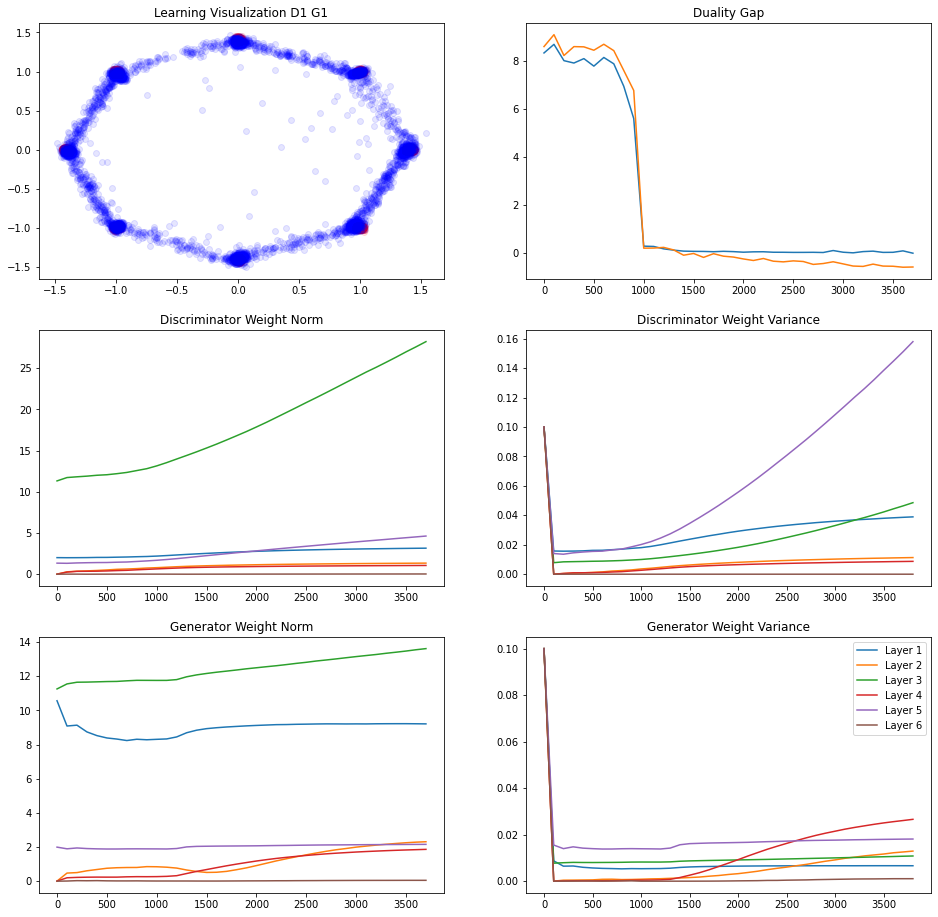

236/250 [===========================>..] - ETA: 0sIteration : 3800 [D loss: 0.616439, acc.: 71.09%] [G loss: 0.897469]
Vanilla   Duality GAP :  0.04415059
L Random  Duality Gap :  -0.5085558


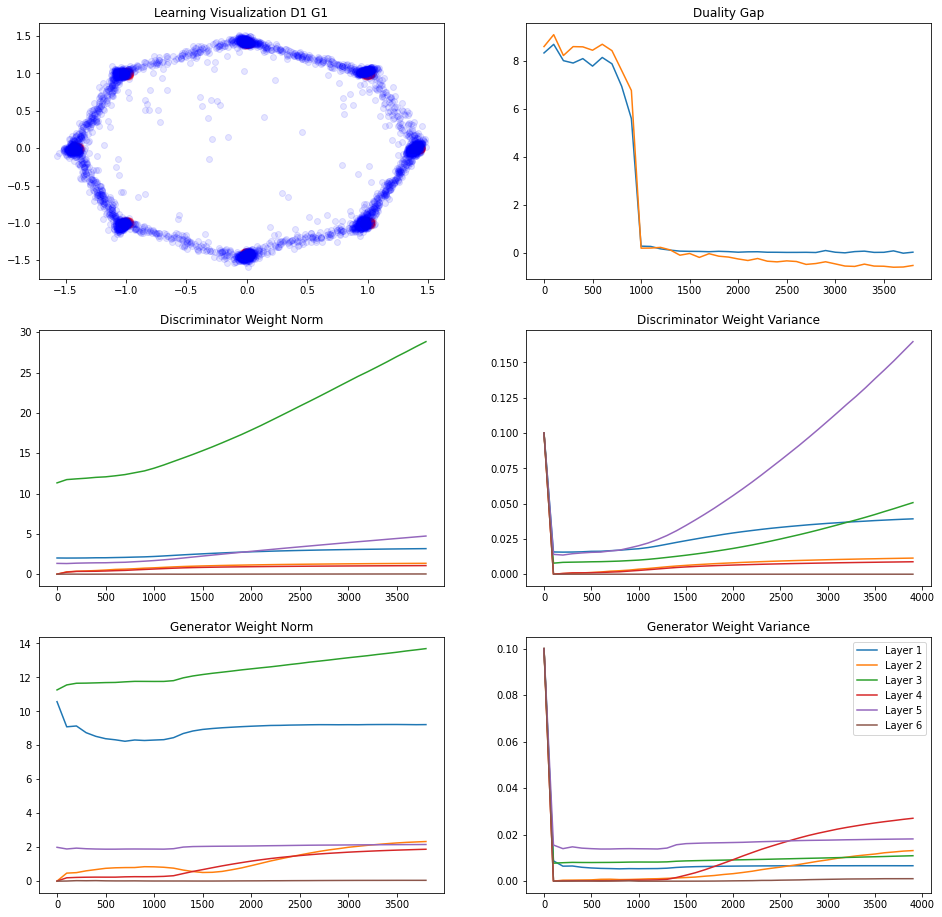

247/250 [============================>.] - ETA: 0sIteration : 3900 [D loss: 0.597969, acc.: 78.91%] [G loss: 0.945094]
Vanilla   Duality GAP :  0.1421367
L Random  Duality Gap :  -0.52197284


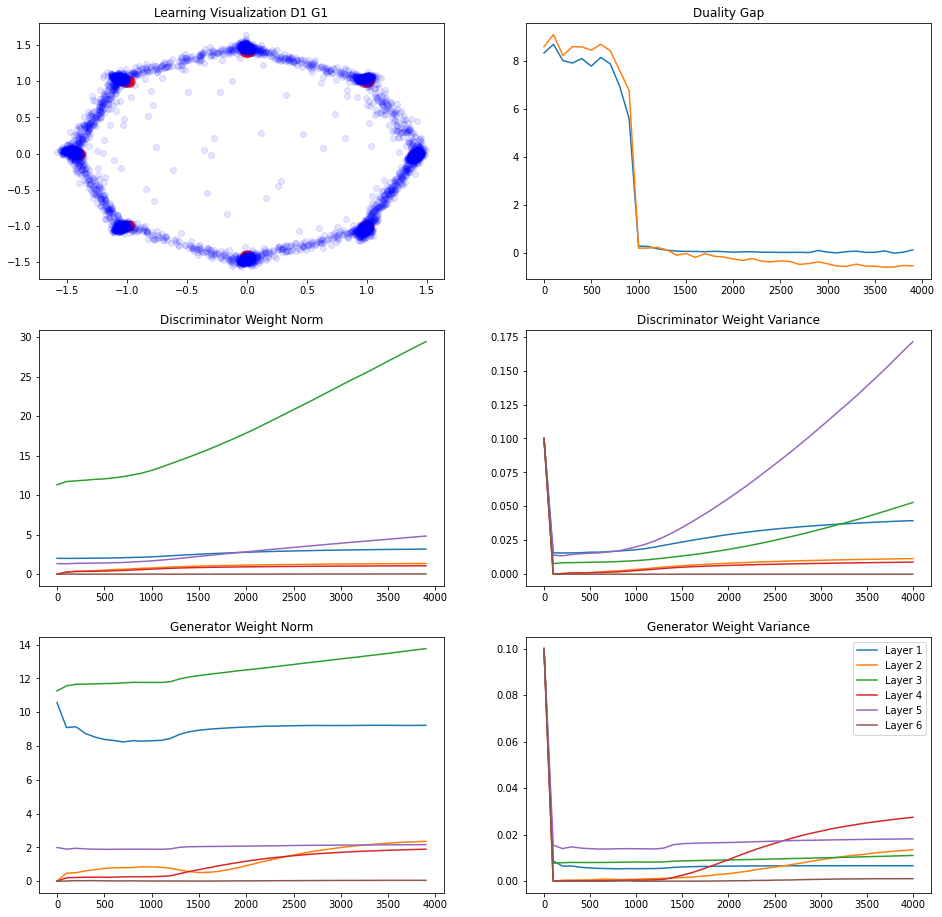

249/250 [============================>.] - ETA: 0sIteration : 4000 [D loss: 0.609559, acc.: 71.48%] [G loss: 0.928136]
Vanilla   Duality GAP :  0.019610167
L Random  Duality Gap :  -0.61601335


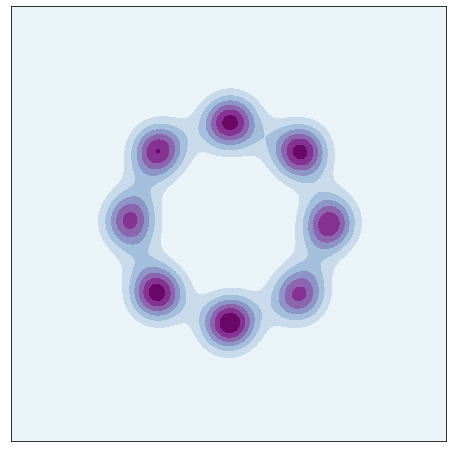

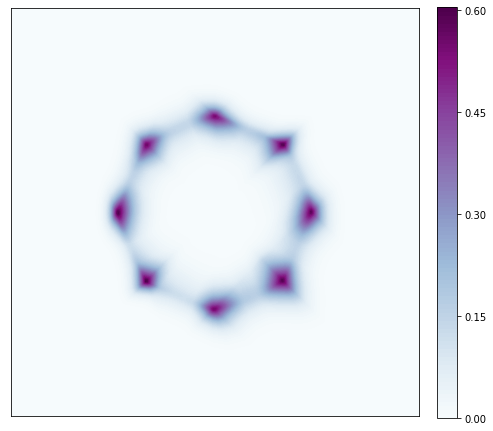

237/250 [===========================>..] - ETA: 0sIteration : 4100 [D loss: 0.586083, acc.: 77.73%] [G loss: 1.139275]
Vanilla   Duality GAP :  0.16815543
L Random  Duality Gap :  -0.54424405


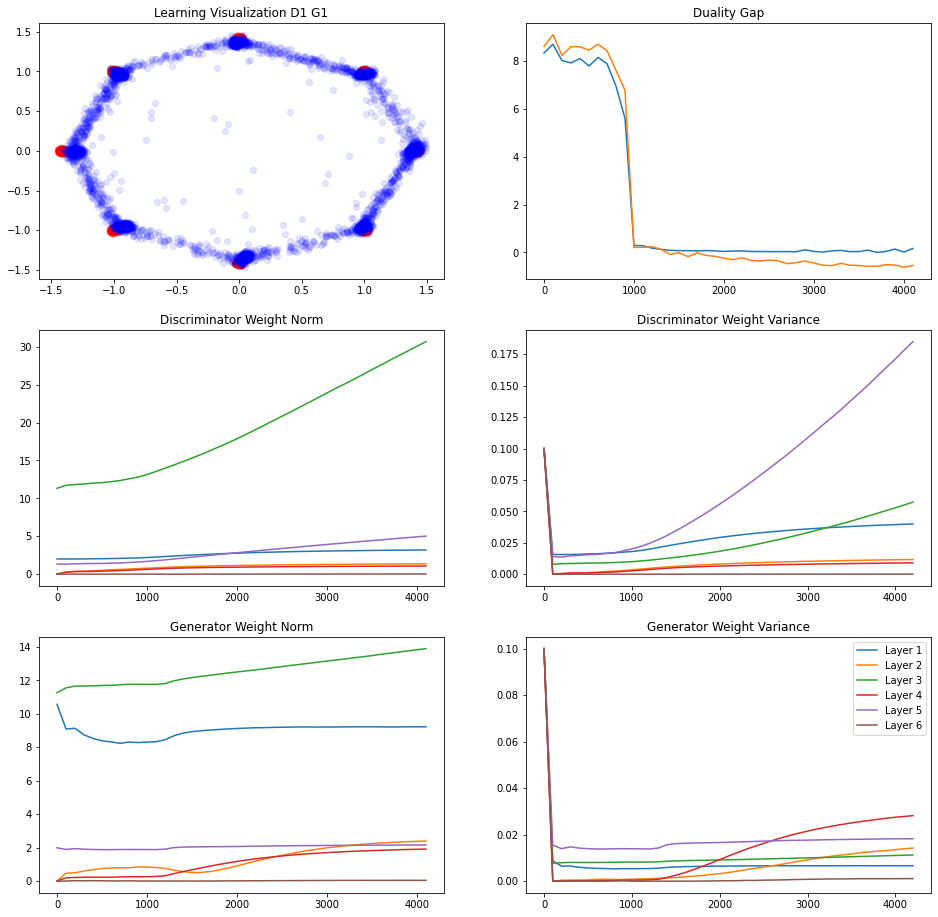

246/250 [============================>.] - ETA: 0sIteration : 4200 [D loss: 0.600548, acc.: 69.92%] [G loss: 0.909945]
Vanilla   Duality GAP :  0.06731546
L Random  Duality Gap :  -0.62755793


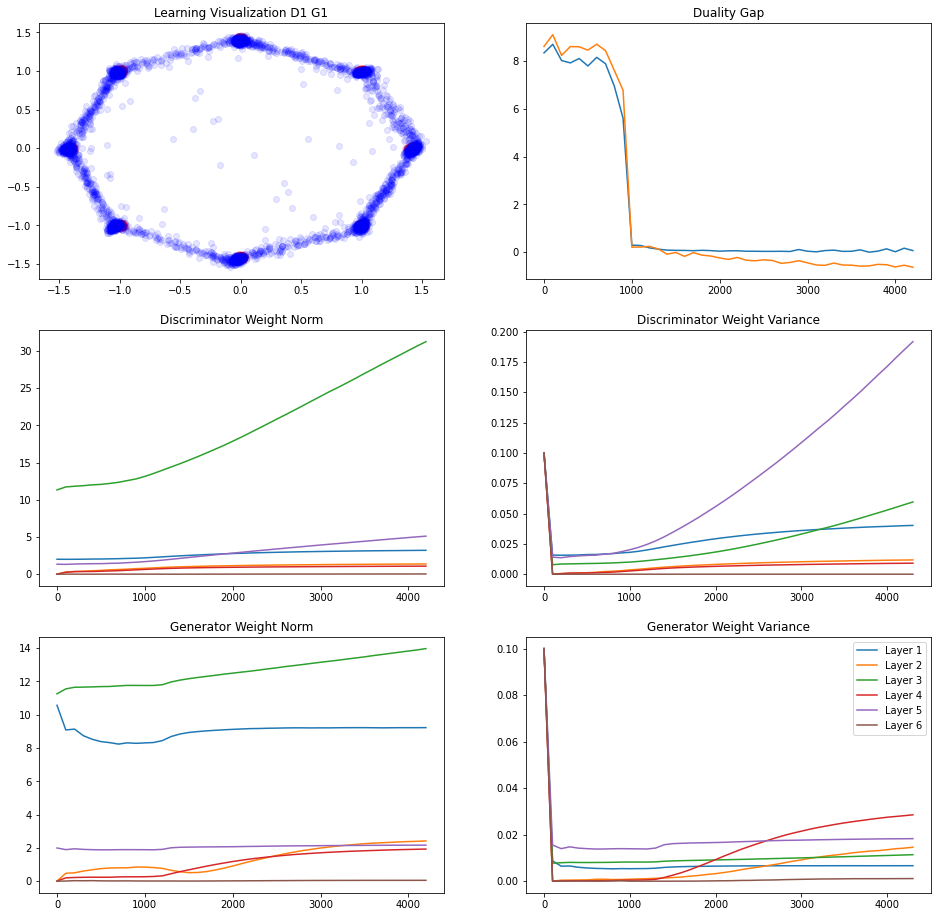

238/250 [===========================>..] - ETA: 0sIteration : 4300 [D loss: 0.593907, acc.: 73.44%] [G loss: 0.962319]
Vanilla   Duality GAP :  0.1336348
L Random  Duality Gap :  -0.6341122


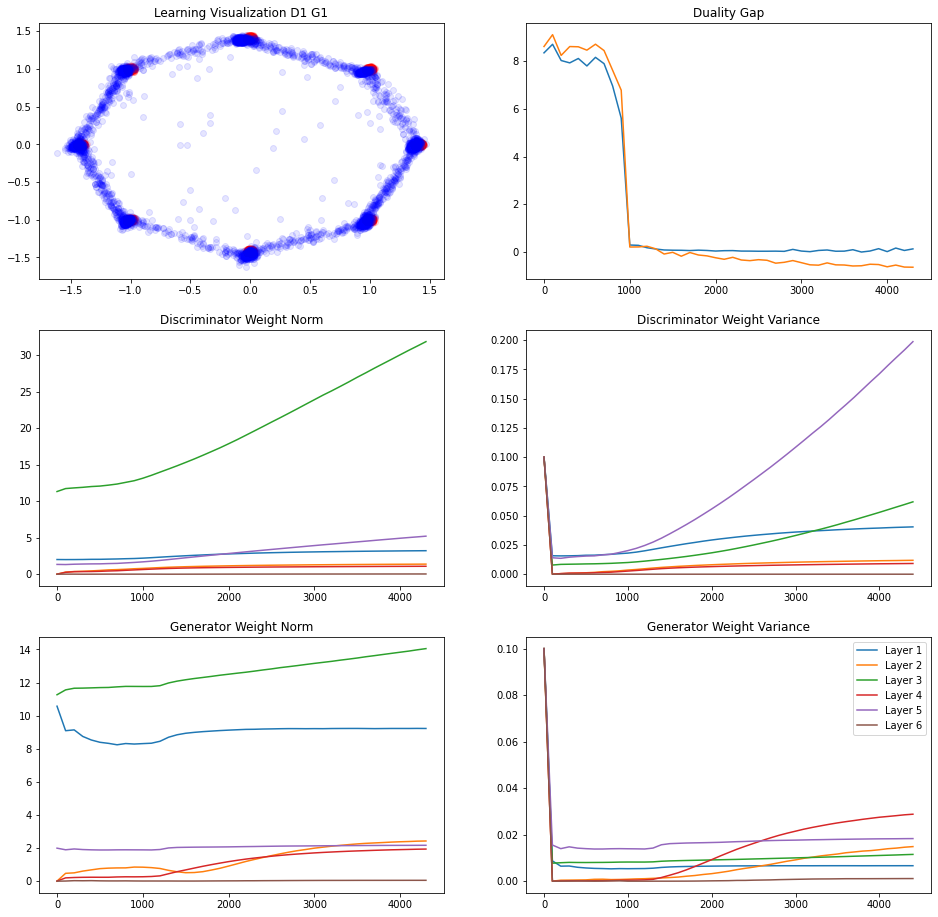

242/250 [============================>.] - ETA: 0sIteration : 4400 [D loss: 0.577826, acc.: 79.69%] [G loss: 1.068676]
Vanilla   Duality GAP :  0.024476767
L Random  Duality Gap :  -0.62594765


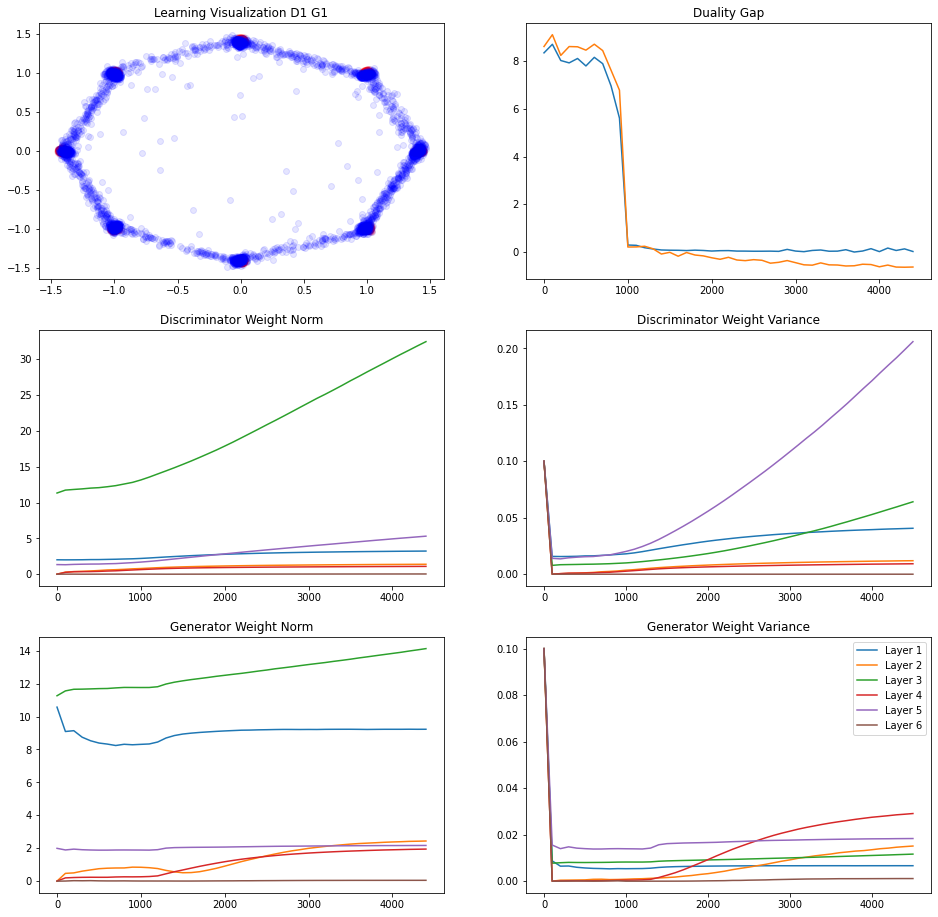

245/250 [============================>.] - ETA: 0sIteration : 4500 [D loss: 0.587519, acc.: 78.52%] [G loss: 1.050645]
Vanilla   Duality GAP :  0.059371114
L Random  Duality Gap :  -0.5591188


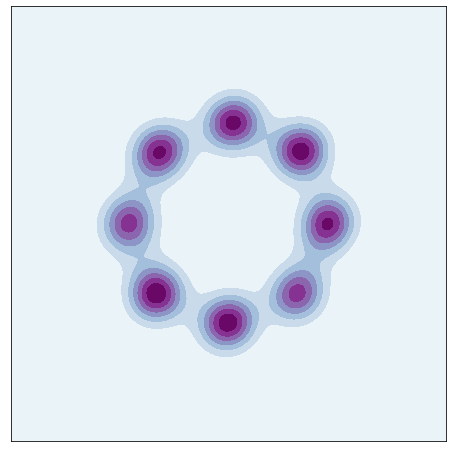

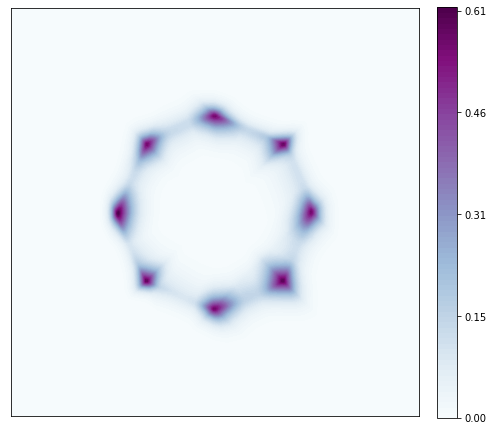

245/250 [============================>.] - ETA: 0sIteration : 4600 [D loss: 0.594493, acc.: 69.53%] [G loss: 1.053697]
Vanilla   Duality GAP :  0.017528415
L Random  Duality Gap :  -0.6448491


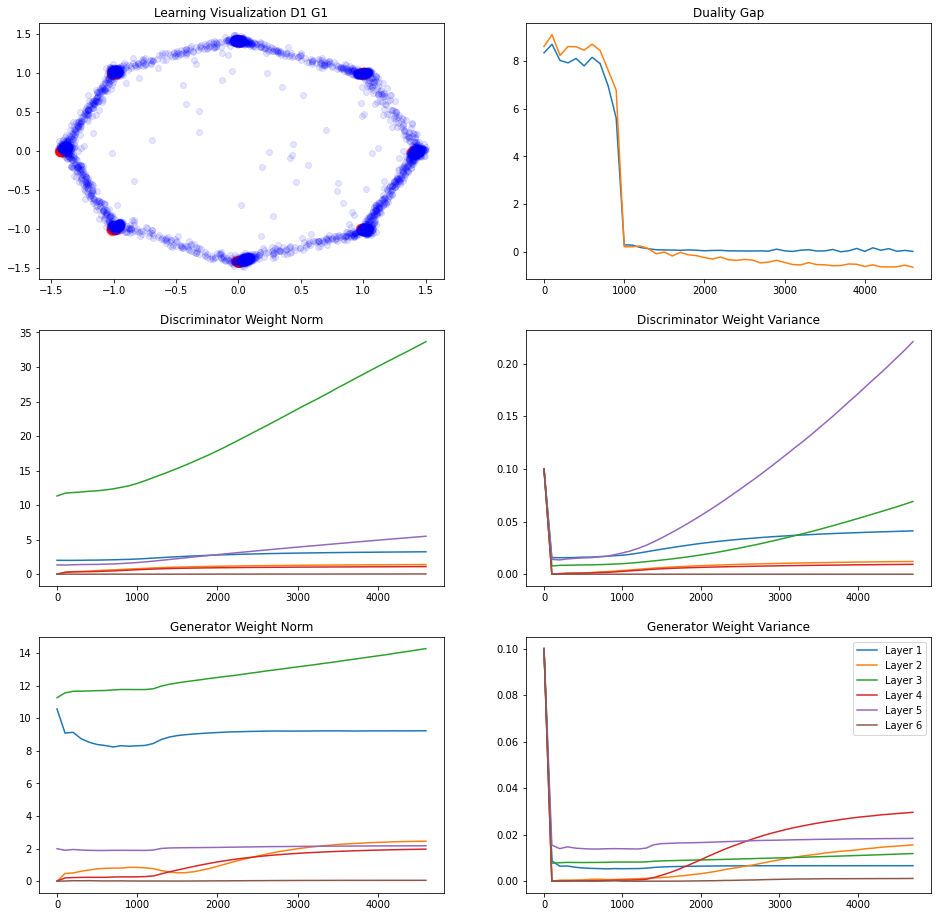

246/250 [============================>.] - ETA: 0sIteration : 4700 [D loss: 0.588416, acc.: 71.09%] [G loss: 0.970599]
Vanilla   Duality GAP :  0.10074353
L Random  Duality Gap :  -0.59839636


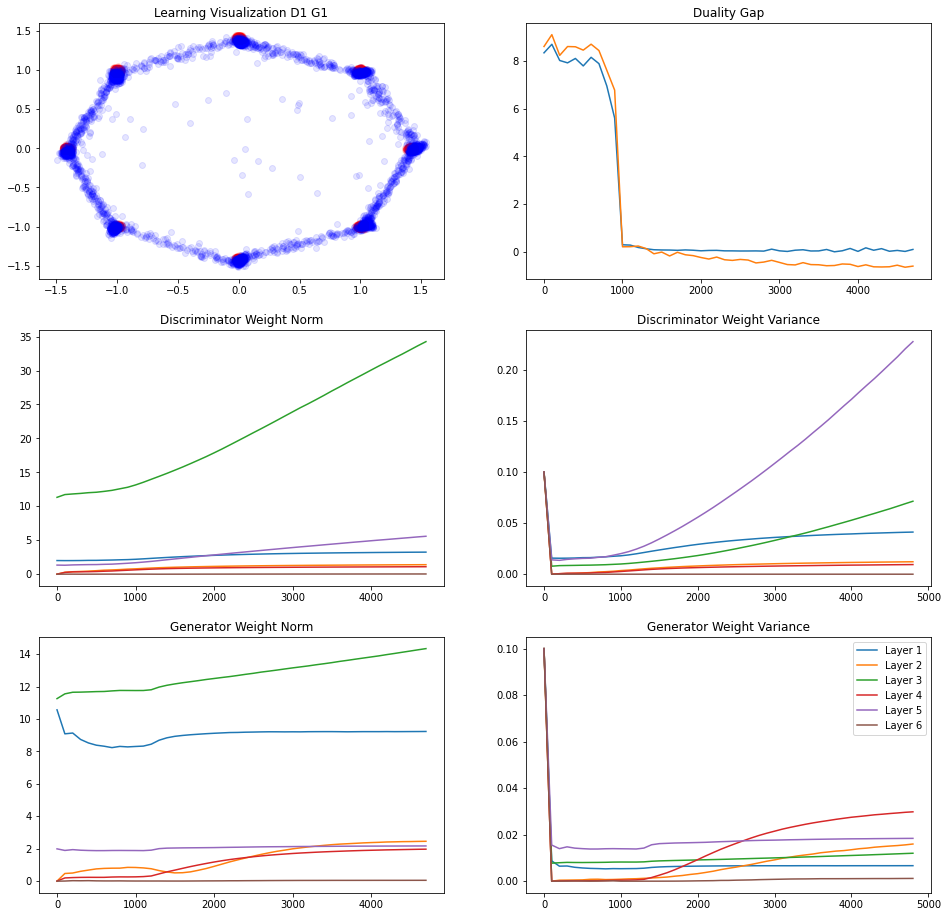

249/250 [============================>.] - ETA: 0sIteration : 4800 [D loss: 0.618715, acc.: 68.75%] [G loss: 0.959832]
Vanilla   Duality GAP :  0.086782336
L Random  Duality Gap :  -0.6175222


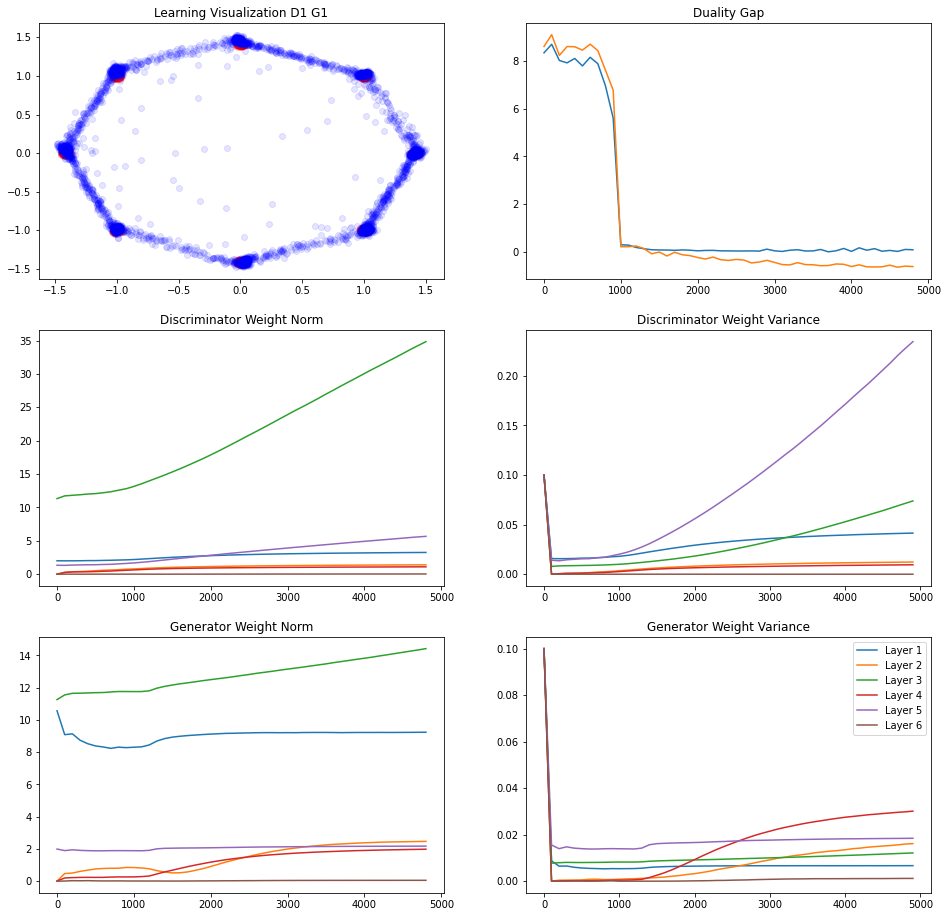

246/250 [============================>.] - ETA: 0sIteration : 4900 [D loss: 0.596165, acc.: 71.88%] [G loss: 0.973401]
Vanilla   Duality GAP :  0.06141293
L Random  Duality Gap :  -0.58577853


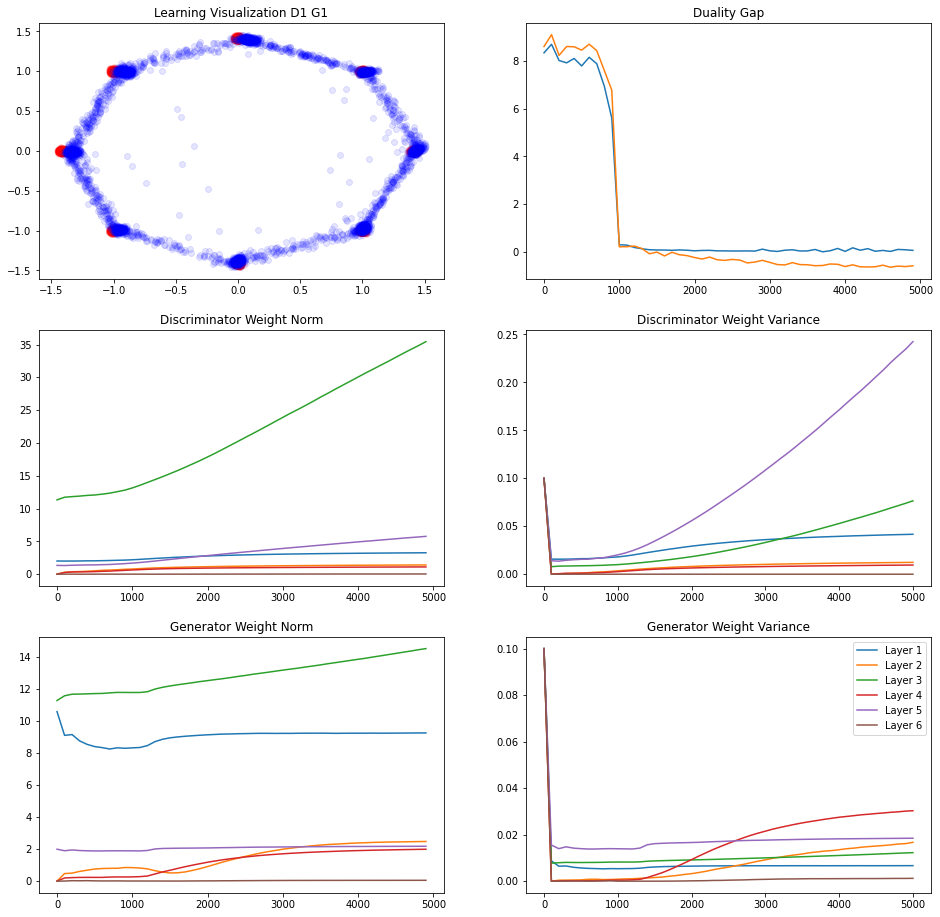

238/250 [===========================>..] - ETA: 0sIteration : 5000 [D loss: 0.602940, acc.: 73.44%] [G loss: 0.909263]
Vanilla   Duality GAP :  0.104194164
L Random  Duality Gap :  -0.620033


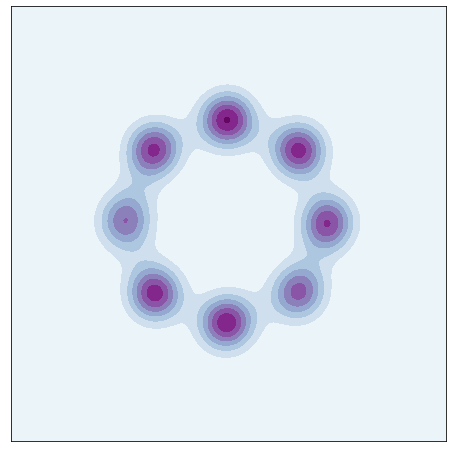

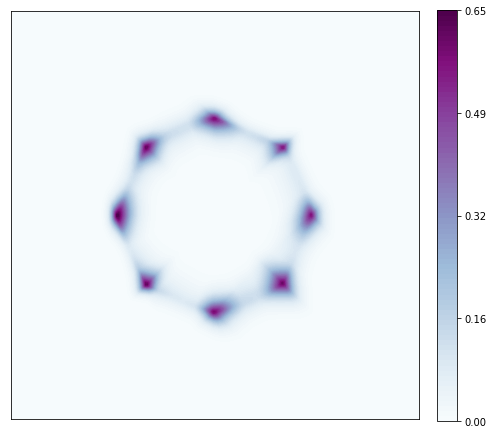

240/250 [===========================>..] - ETA: 0sIteration : 5100 [D loss: 0.642791, acc.: 64.45%] [G loss: 1.054022]
Vanilla   Duality GAP :  0.16706228
L Random  Duality Gap :  -0.6348111


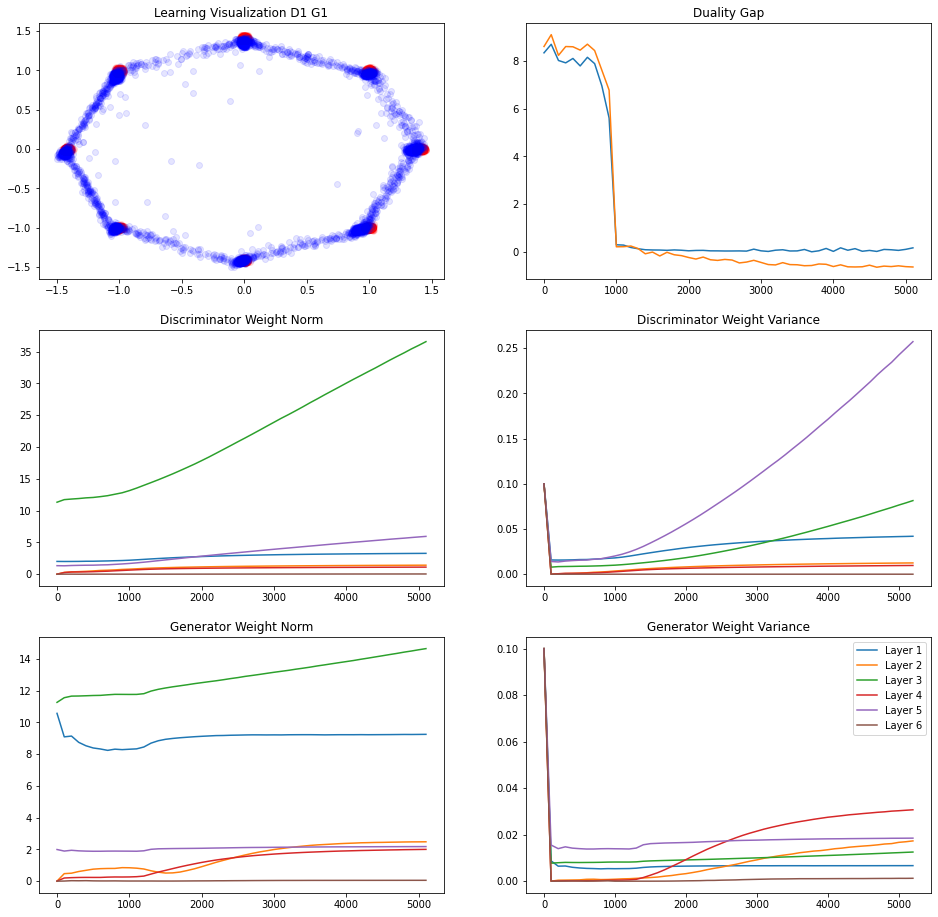

244/250 [============================>.] - ETA: 0sIteration : 5200 [D loss: 0.628329, acc.: 68.36%] [G loss: 0.927214]
Vanilla   Duality GAP :  0.066299915
L Random  Duality Gap :  -0.61792666


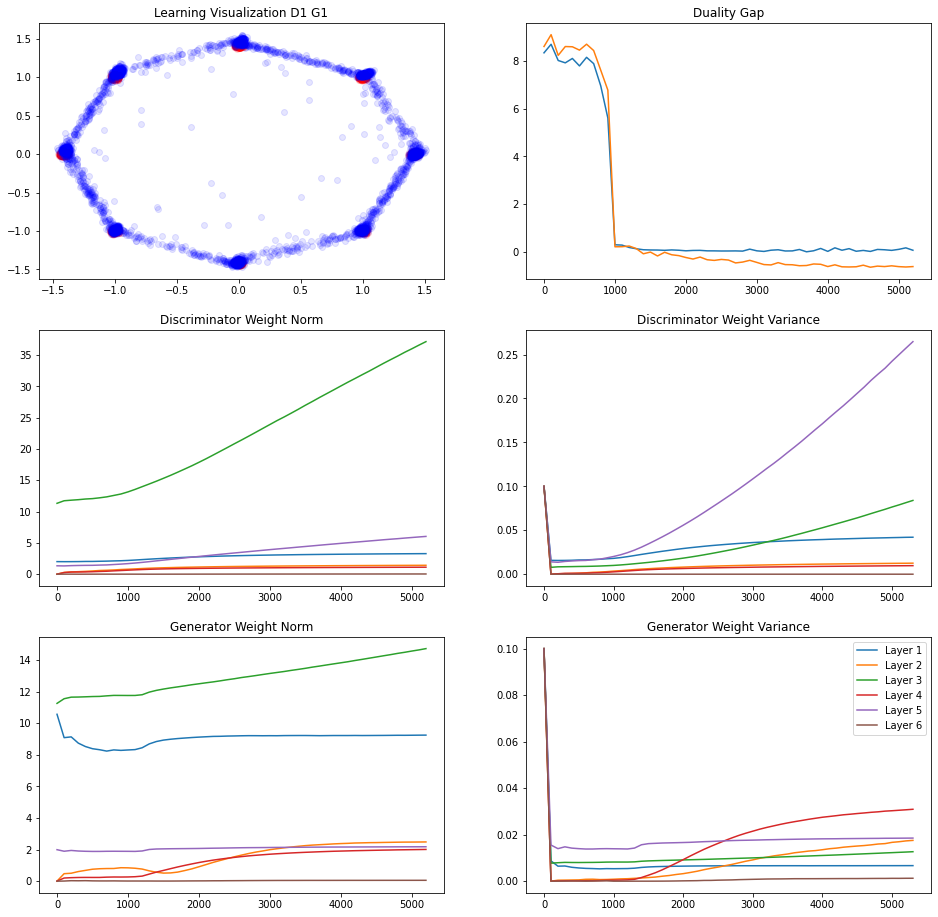

246/250 [============================>.] - ETA: 0sIteration : 5300 [D loss: 0.603808, acc.: 69.92%] [G loss: 1.010594]
Vanilla   Duality GAP :  0.028988004
L Random  Duality Gap :  -0.62400746


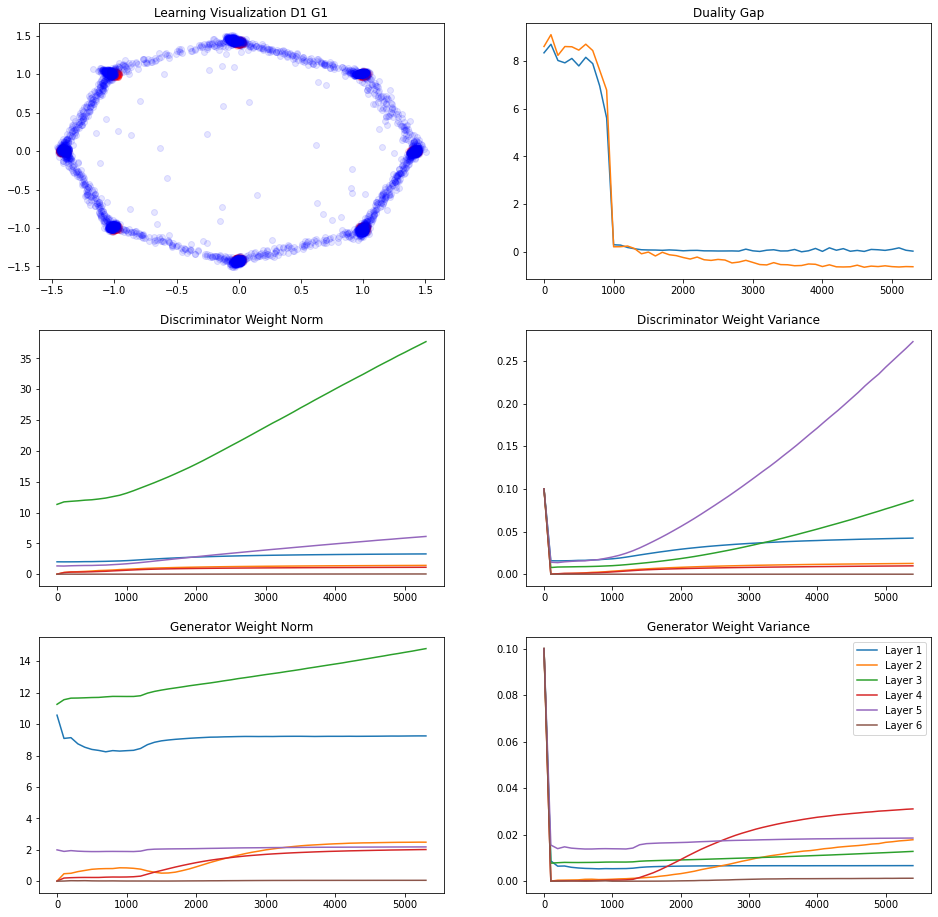

246/250 [============================>.] - ETA: 0sIteration : 5400 [D loss: 0.617992, acc.: 64.45%] [G loss: 0.931683]
Vanilla   Duality GAP :  0.1576178
L Random  Duality Gap :  -0.6868795


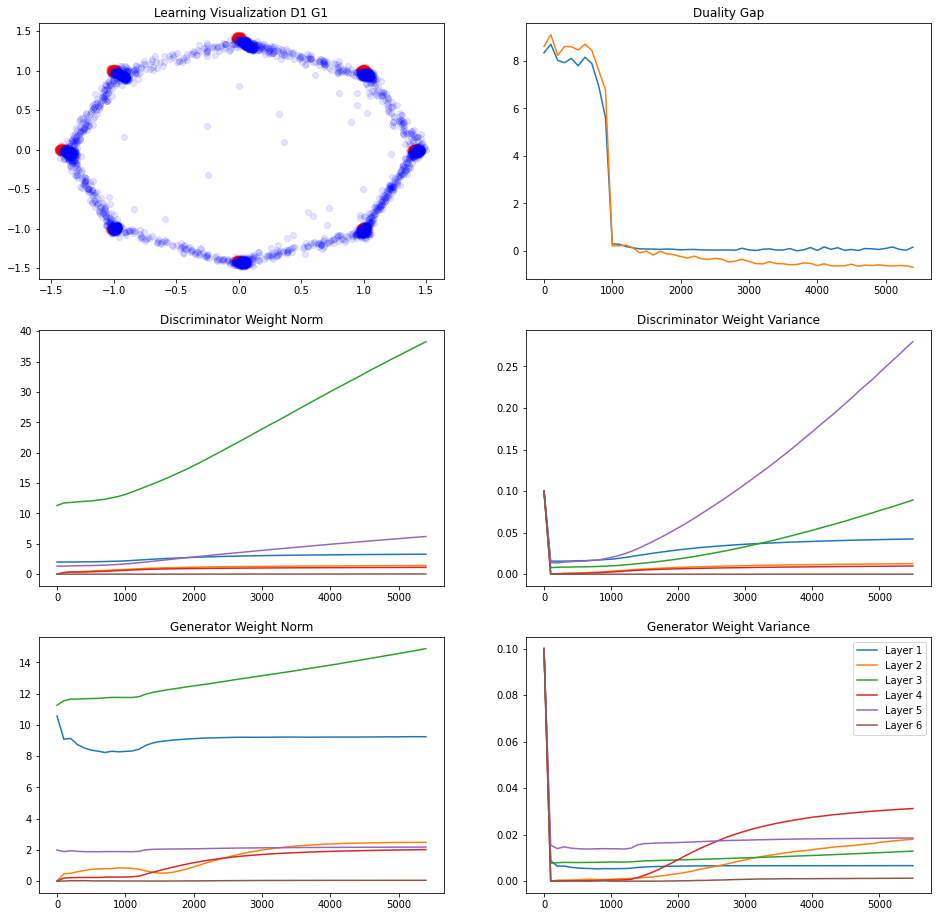

245/250 [============================>.] - ETA: 0sIteration : 5500 [D loss: 0.626054, acc.: 61.33%] [G loss: 0.933543]
Vanilla   Duality GAP :  0.11236048
L Random  Duality Gap :  -0.5943239


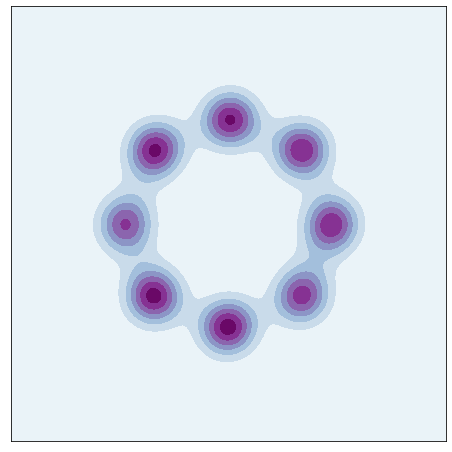

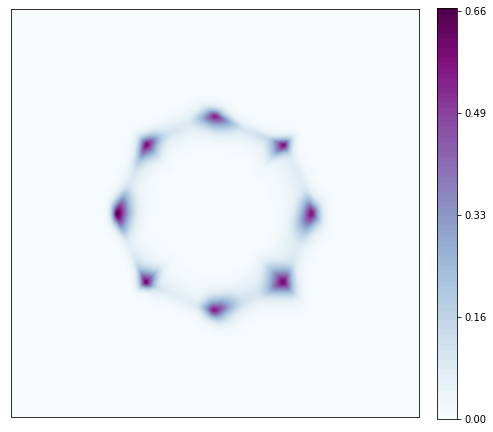

242/250 [============================>.] - ETA: 0sIteration : 5600 [D loss: 0.591826, acc.: 73.83%] [G loss: 1.020281]
Vanilla   Duality GAP :  0.05627048
L Random  Duality Gap :  -0.72119445


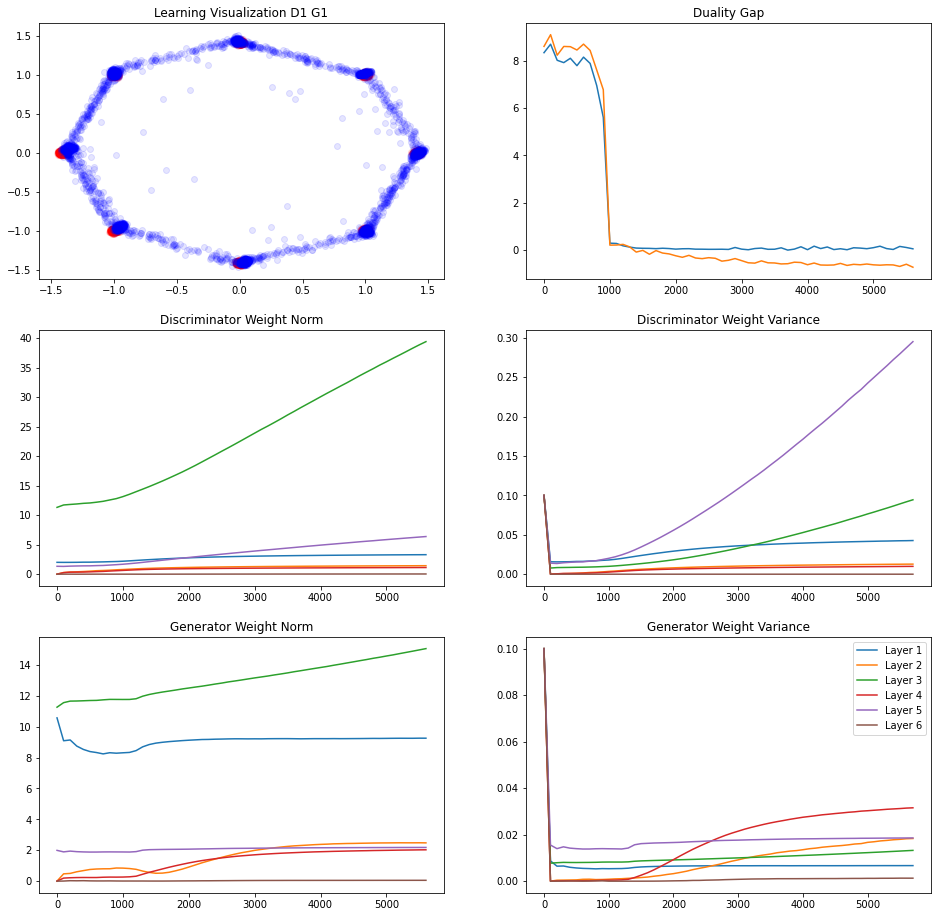

241/250 [===========================>..] - ETA: 0sIteration : 5700 [D loss: 0.634893, acc.: 62.89%] [G loss: 1.040824]
Vanilla   Duality GAP :  0.069898605
L Random  Duality Gap :  -0.65461713


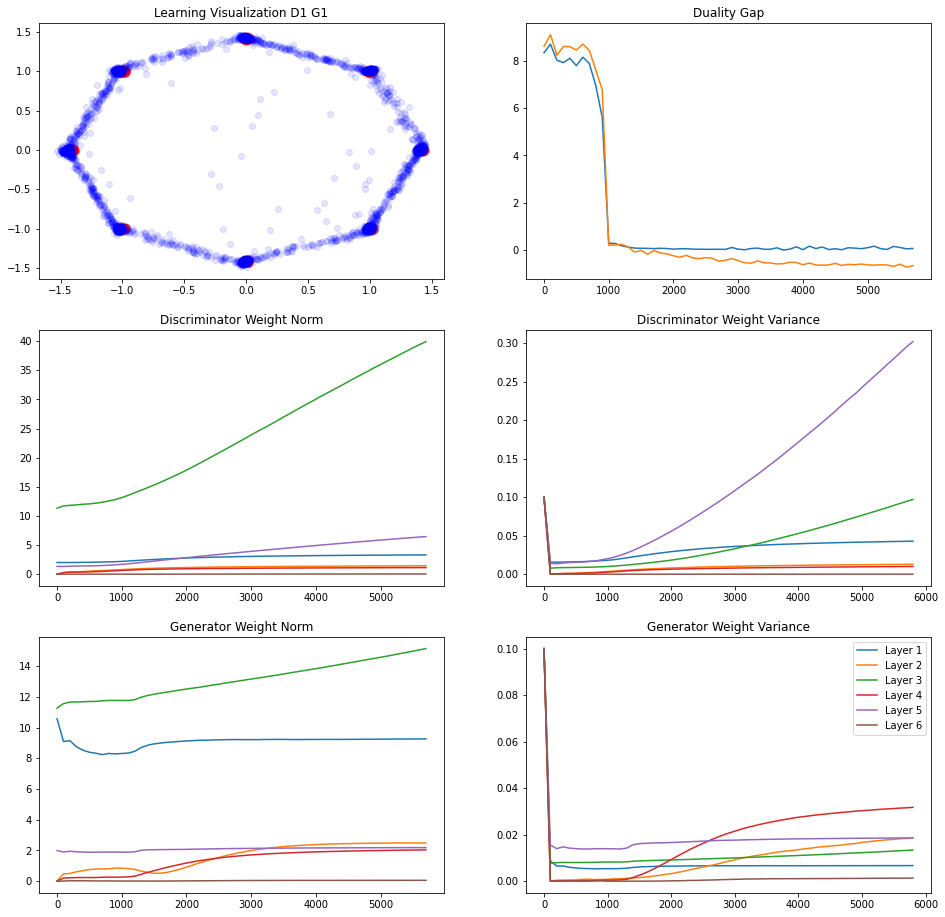

246/250 [============================>.] - ETA: 0sIteration : 5800 [D loss: 0.617990, acc.: 68.75%] [G loss: 0.929226]
Vanilla   Duality GAP :  0.19304979
L Random  Duality Gap :  -0.5672211


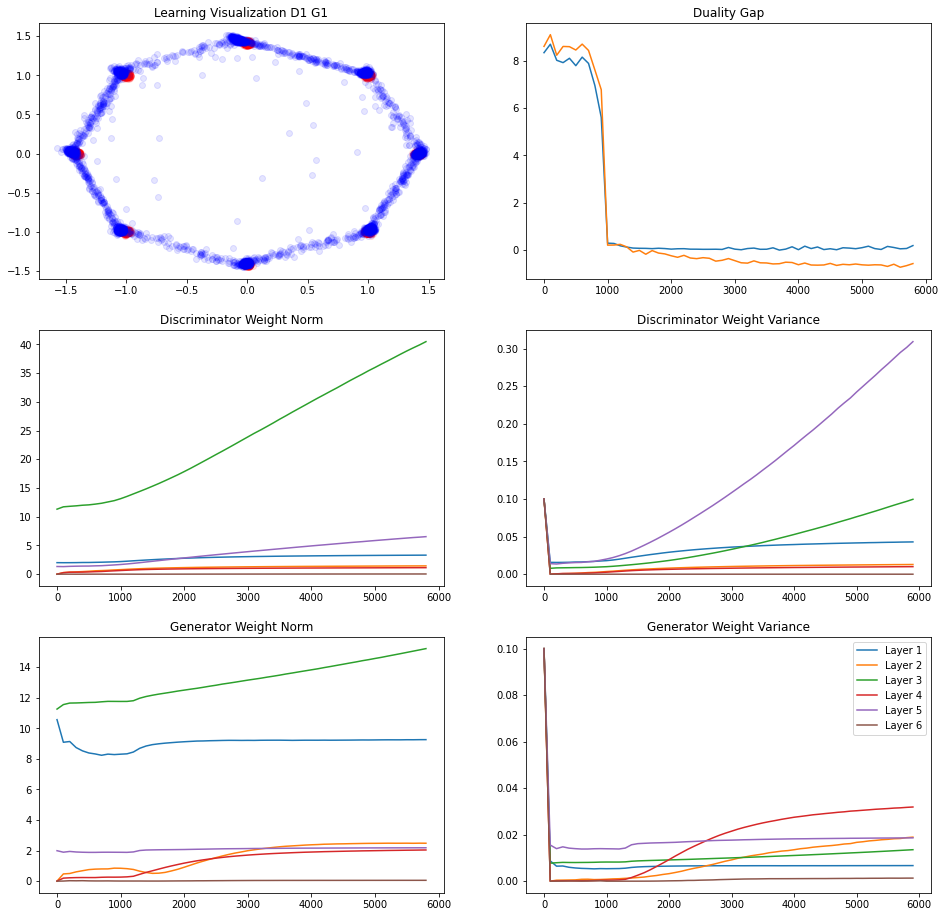

245/250 [============================>.] - ETA: 0sIteration : 5900 [D loss: 0.596635, acc.: 71.48%] [G loss: 0.910689]
Vanilla   Duality GAP :  0.046818495
L Random  Duality Gap :  -0.6527641


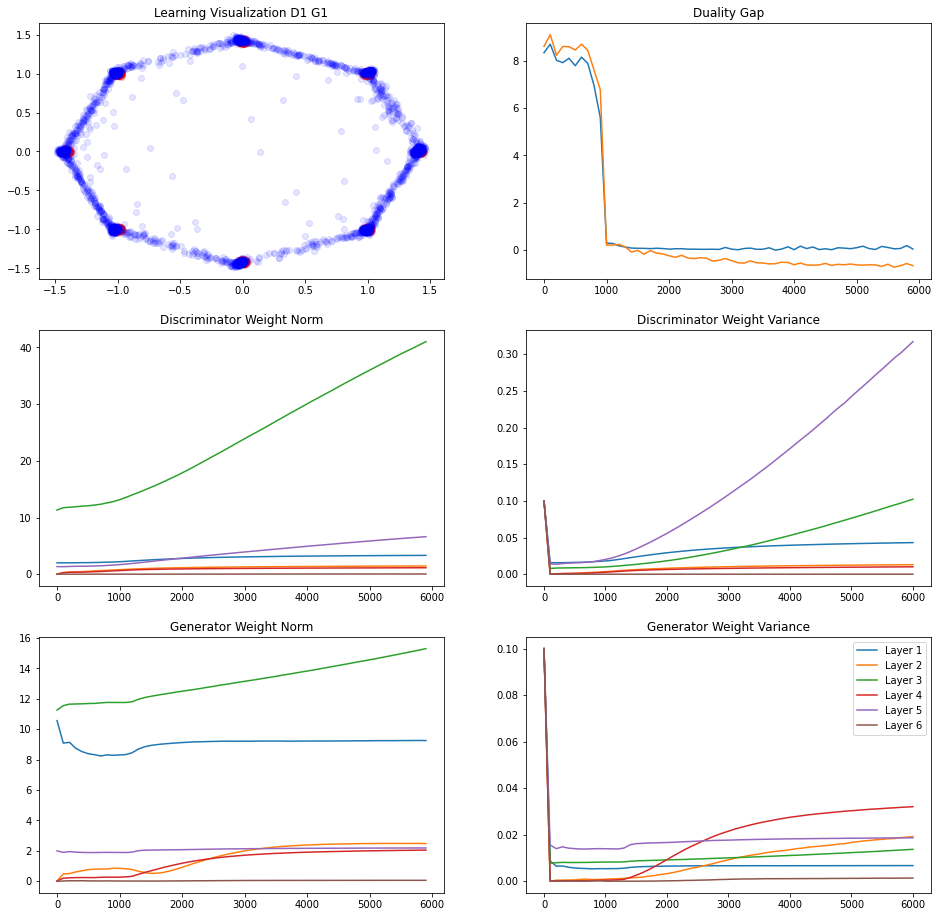

244/250 [============================>.] - ETA: 0sIteration : 6000 [D loss: 0.637147, acc.: 61.33%] [G loss: 0.966281]
Vanilla   Duality GAP :  0.086812615
L Random  Duality Gap :  -0.6384176


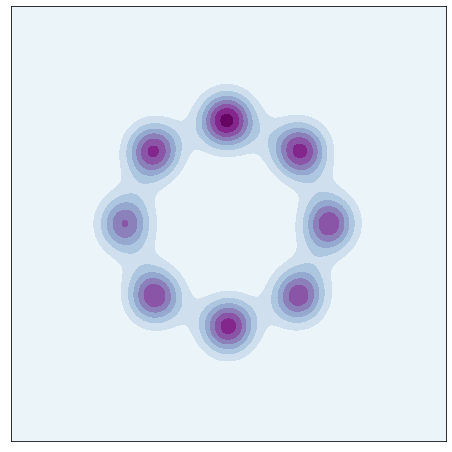

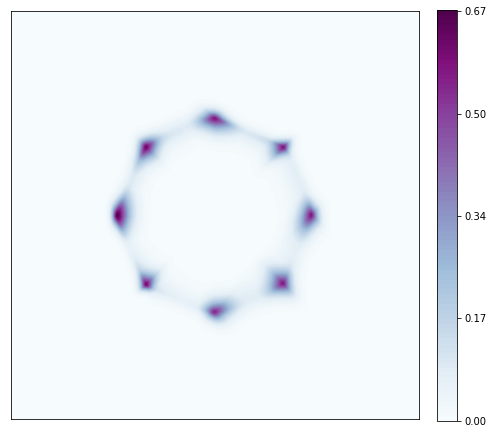

247/250 [============================>.] - ETA: 0sIteration : 6100 [D loss: 0.628672, acc.: 67.58%] [G loss: 1.041987]
Vanilla   Duality GAP :  0.13197482
L Random  Duality Gap :  -0.72370994


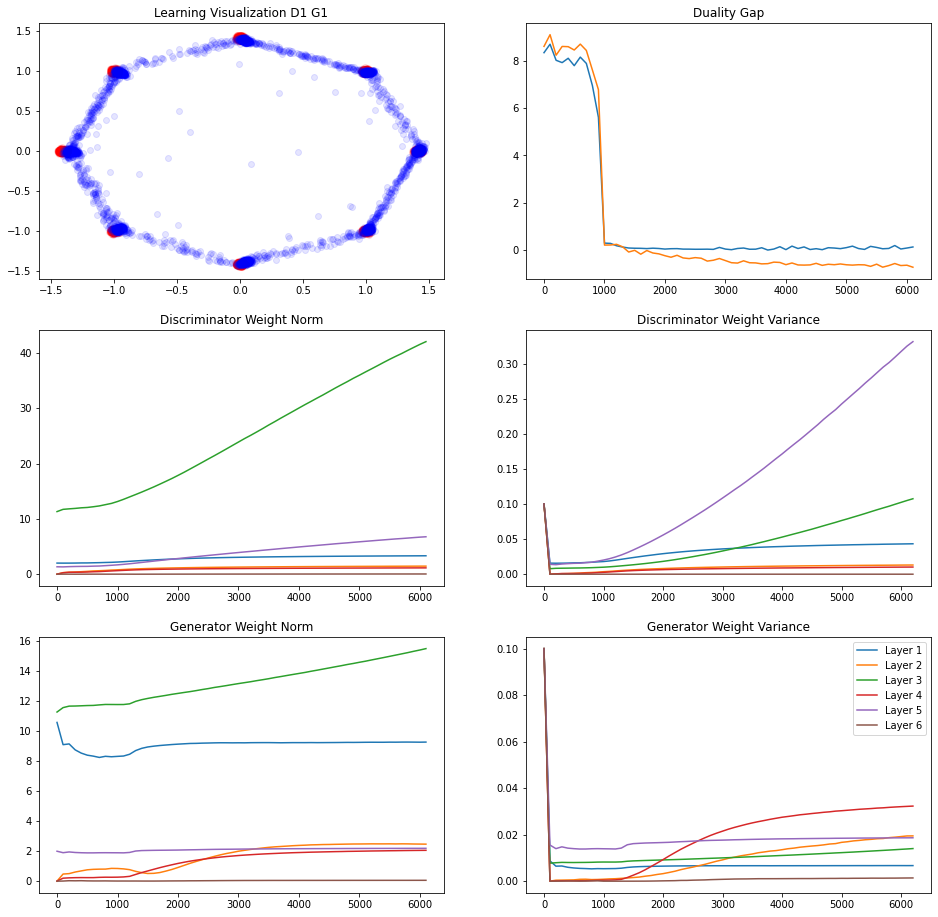

246/250 [============================>.] - ETA: 0sIteration : 6200 [D loss: 0.624335, acc.: 66.80%] [G loss: 0.963167]
Vanilla   Duality GAP :  -0.004361272
L Random  Duality Gap :  -0.62494904


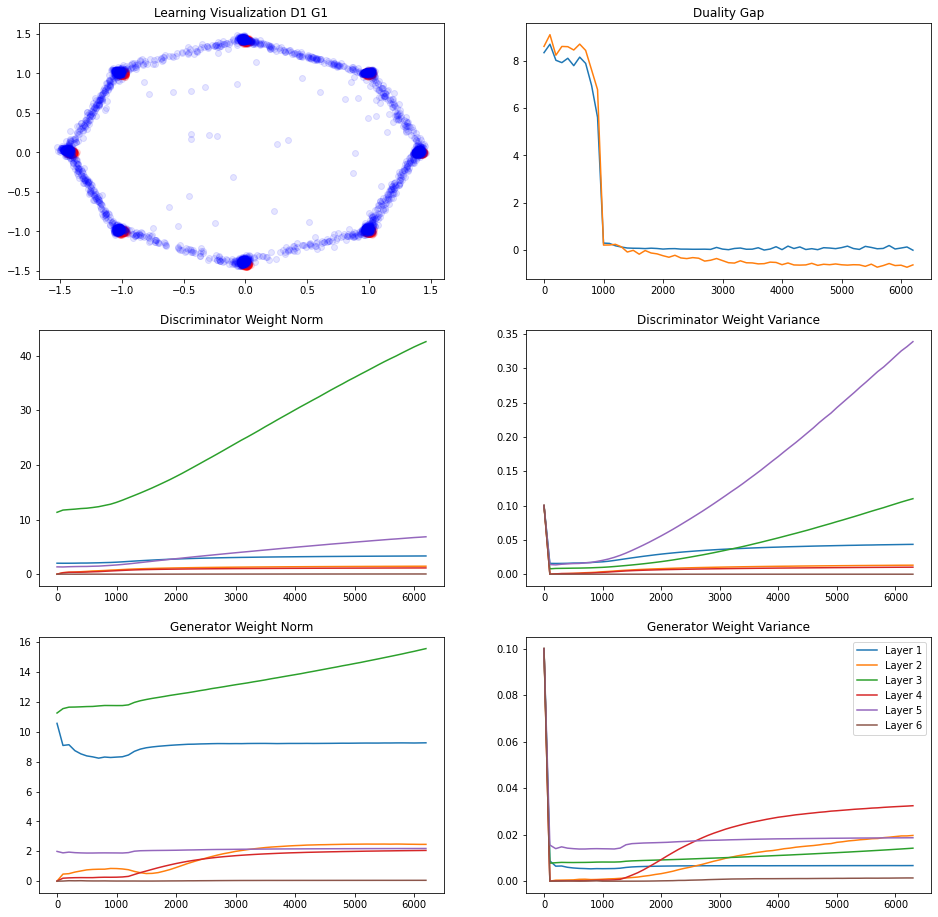

245/250 [============================>.] - ETA: 0sIteration : 6300 [D loss: 0.619483, acc.: 66.80%] [G loss: 0.976218]
Vanilla   Duality GAP :  -0.04630947
L Random  Duality Gap :  -0.6976008


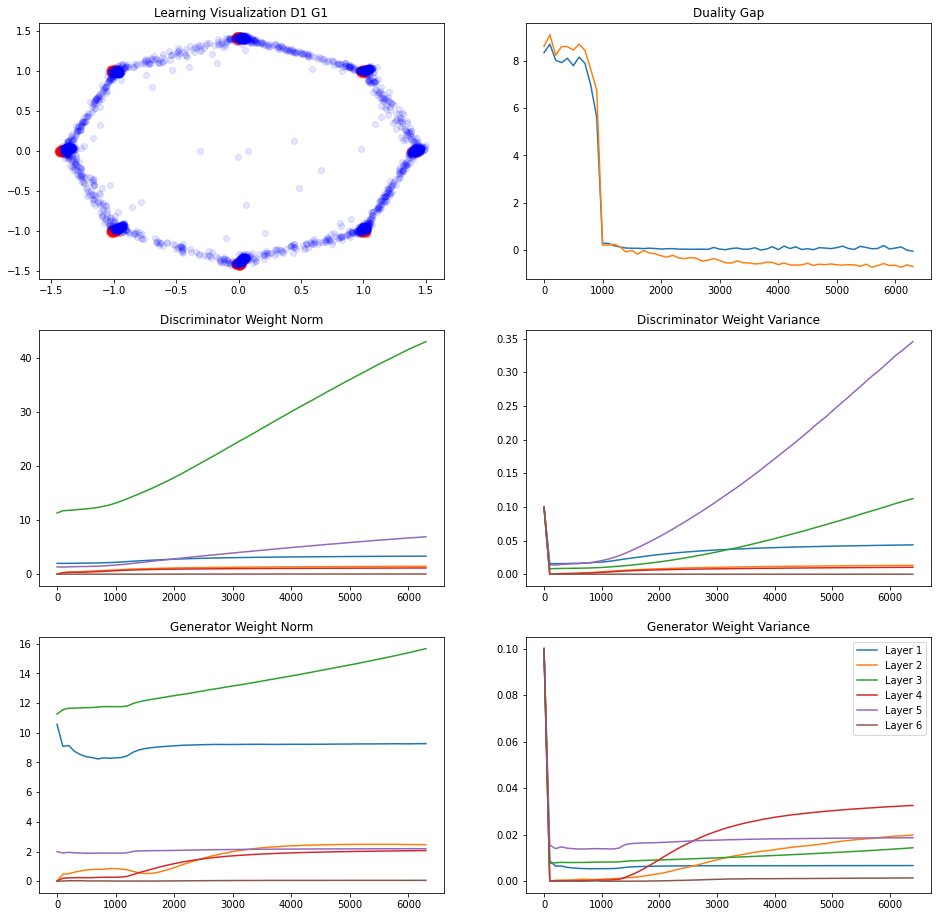

249/250 [============================>.] - ETA: 0sIteration : 6400 [D loss: 0.578988, acc.: 76.56%] [G loss: 1.050474]
Vanilla   Duality GAP :  0.10805619
L Random  Duality Gap :  -0.643458


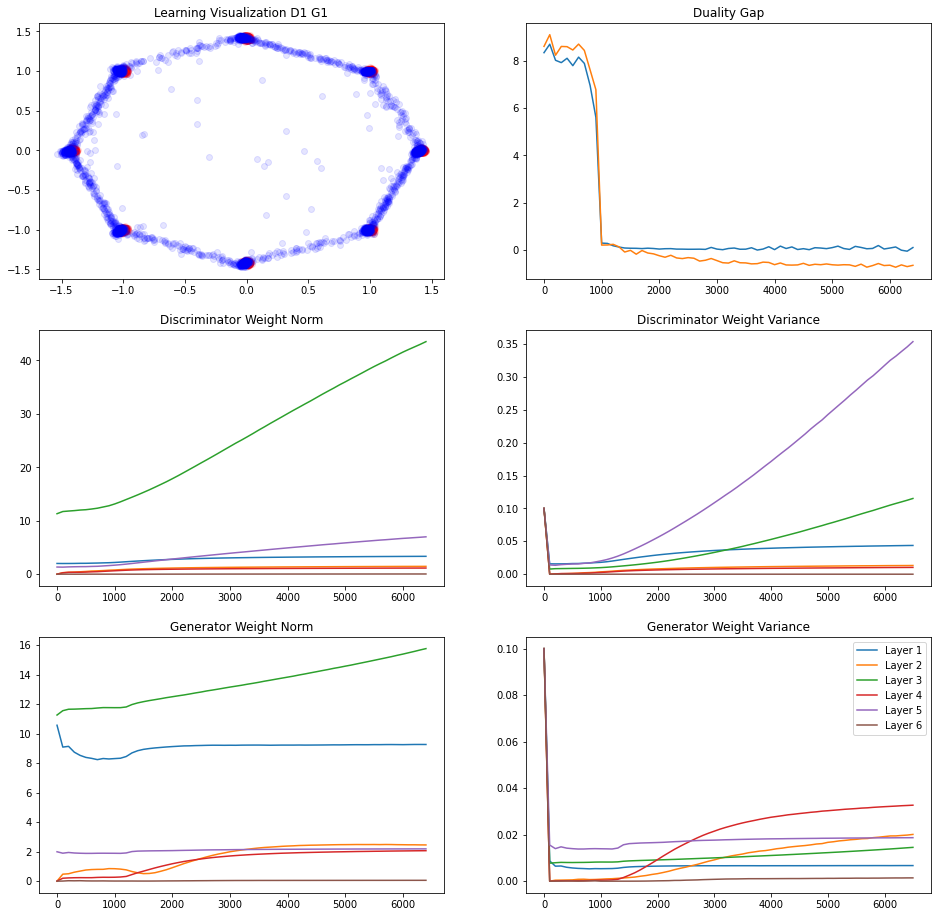

246/250 [============================>.] - ETA: 0sIteration : 6500 [D loss: 0.617719, acc.: 68.75%] [G loss: 0.979305]
Vanilla   Duality GAP :  -0.016994476
L Random  Duality Gap :  -0.70865625


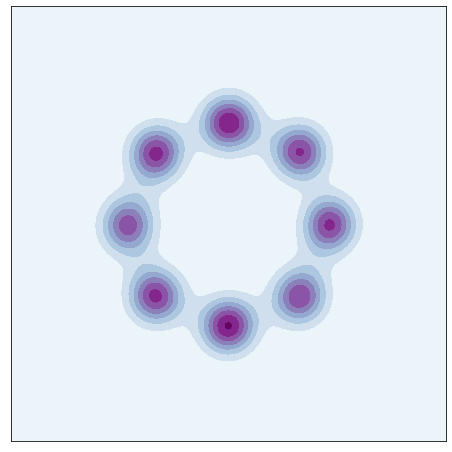

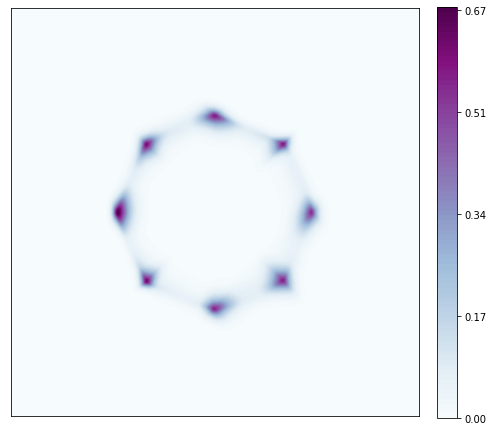

236/250 [===========================>..] - ETA: 0sIteration : 6600 [D loss: 0.608758, acc.: 73.05%] [G loss: 1.076756]
Vanilla   Duality GAP :  0.08782244
L Random  Duality Gap :  -0.621157


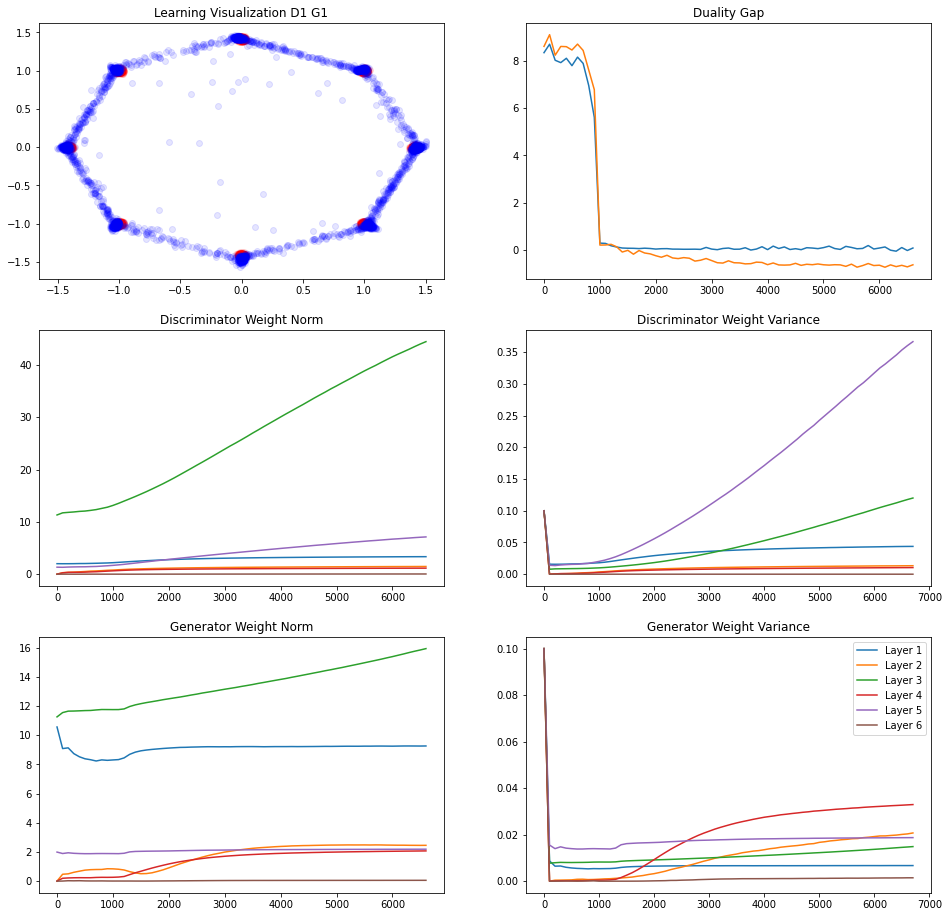

243/250 [============================>.] - ETA: 0sIteration : 6700 [D loss: 0.633408, acc.: 64.06%] [G loss: 1.008334]
Vanilla   Duality GAP :  0.19197965
L Random  Duality Gap :  -0.6356191


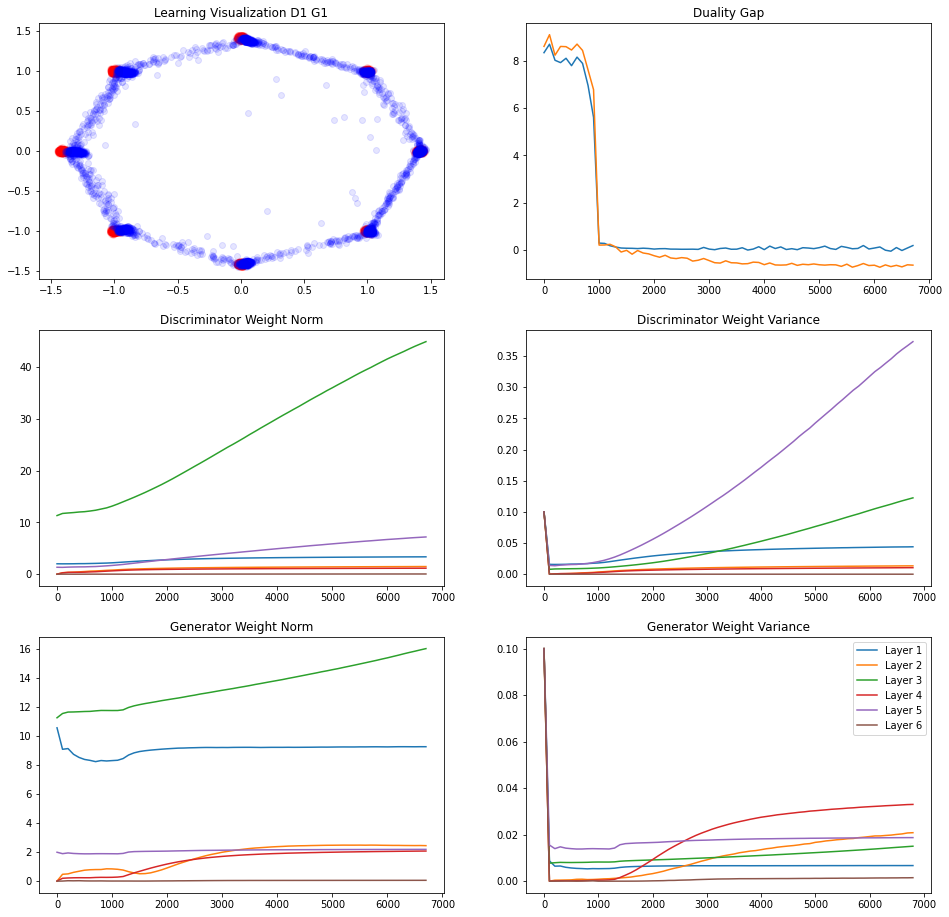

236/250 [===========================>..] - ETA: 0sIteration : 6800 [D loss: 0.531075, acc.: 83.98%] [G loss: 1.307929]
Vanilla   Duality GAP :  0.1714915
L Random  Duality Gap :  -0.70440817


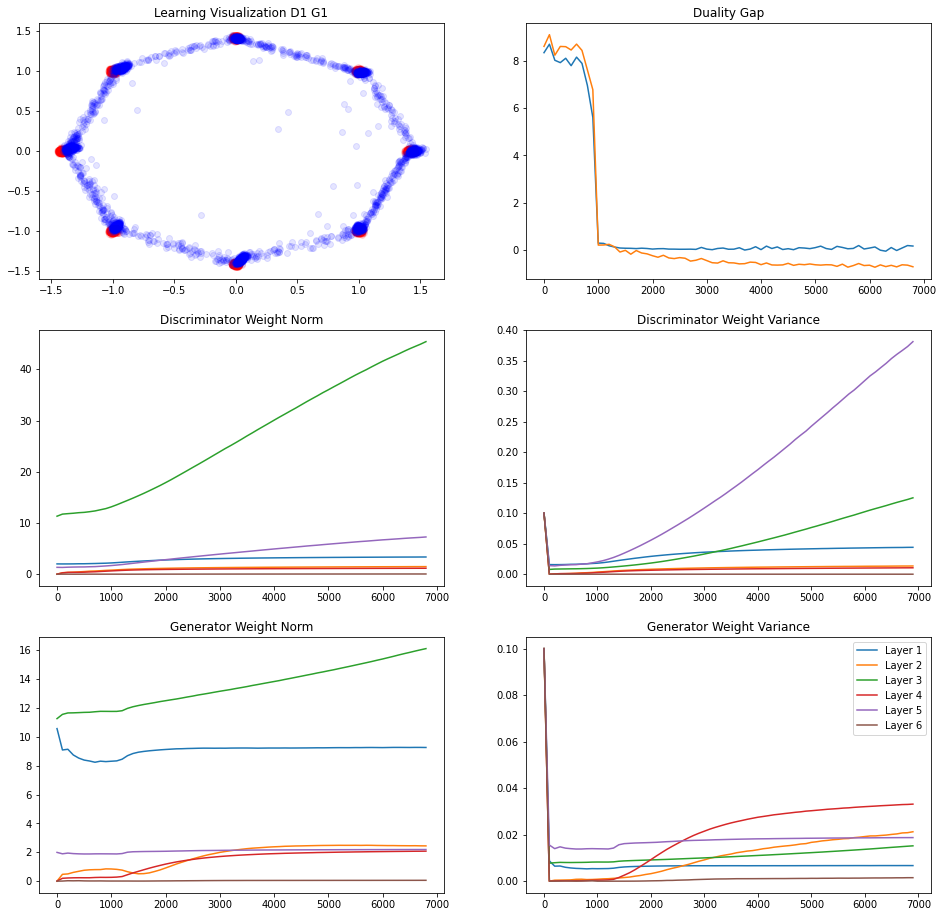

244/250 [============================>.] - ETA: 0sIteration : 6900 [D loss: 0.567070, acc.: 77.73%] [G loss: 1.201946]
Vanilla   Duality GAP :  0.1367222
L Random  Duality Gap :  -0.99258846


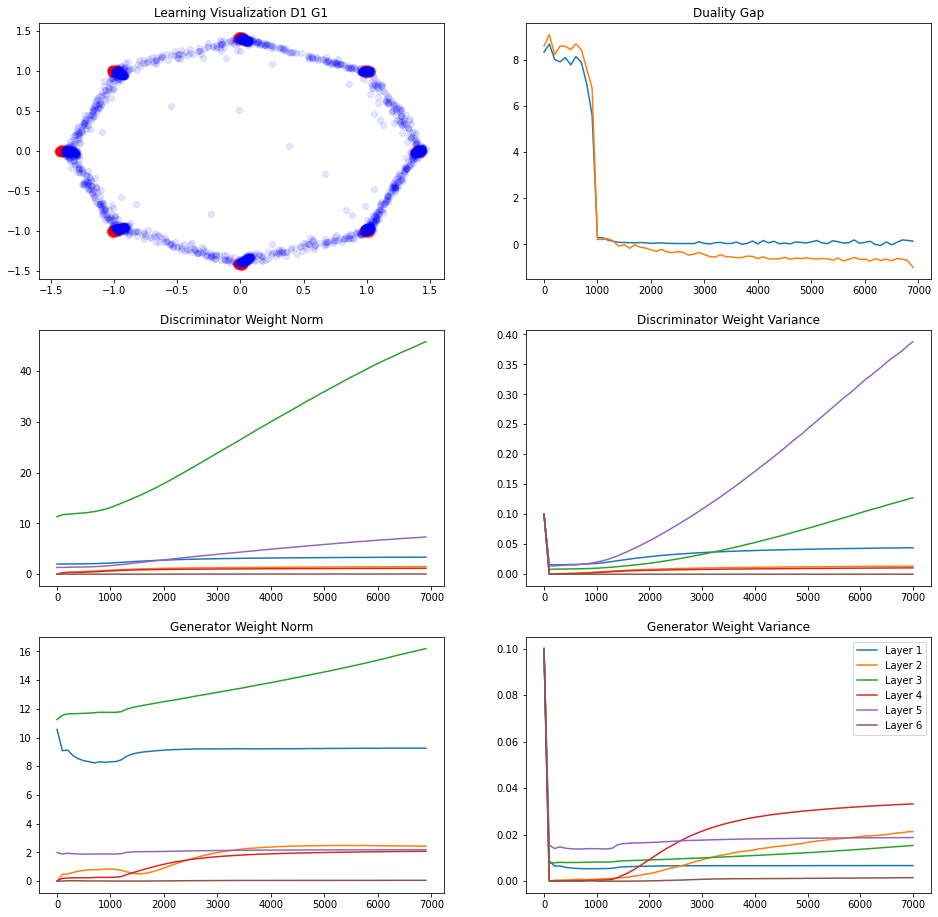

246/250 [============================>.] - ETA: 0sIteration : 7000 [D loss: 0.634897, acc.: 62.50%] [G loss: 0.972927]
Vanilla   Duality GAP :  0.047804117
L Random  Duality Gap :  -0.71652853


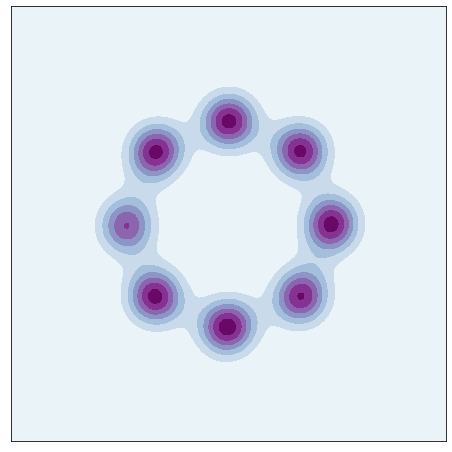

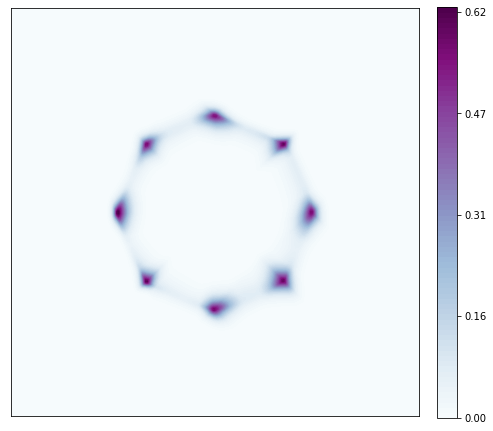

243/250 [============================>.] - ETA: 0sIteration : 7100 [D loss: 0.603062, acc.: 66.80%] [G loss: 0.995798]
Vanilla   Duality GAP :  0.18822753
L Random  Duality Gap :  -0.60332173


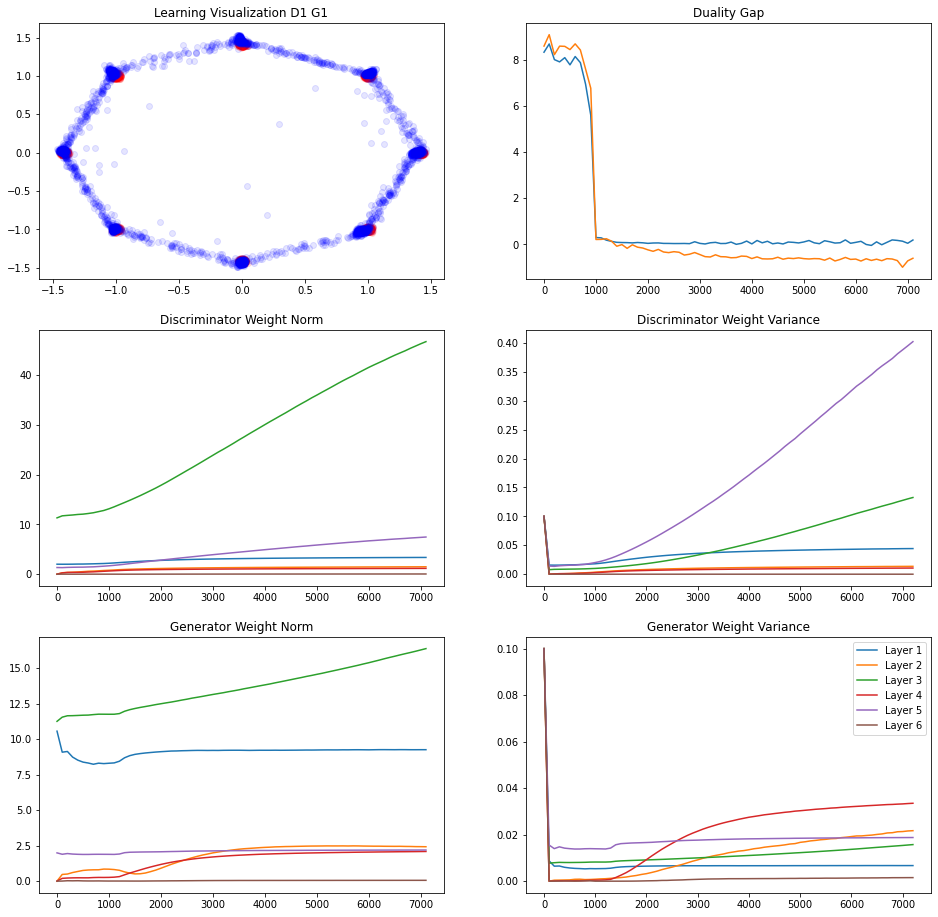

248/250 [============================>.] - ETA: 0sIteration : 7200 [D loss: 0.548730, acc.: 83.59%] [G loss: 1.246717]
Vanilla   Duality GAP :  0.17409027
L Random  Duality Gap :  -0.78026503


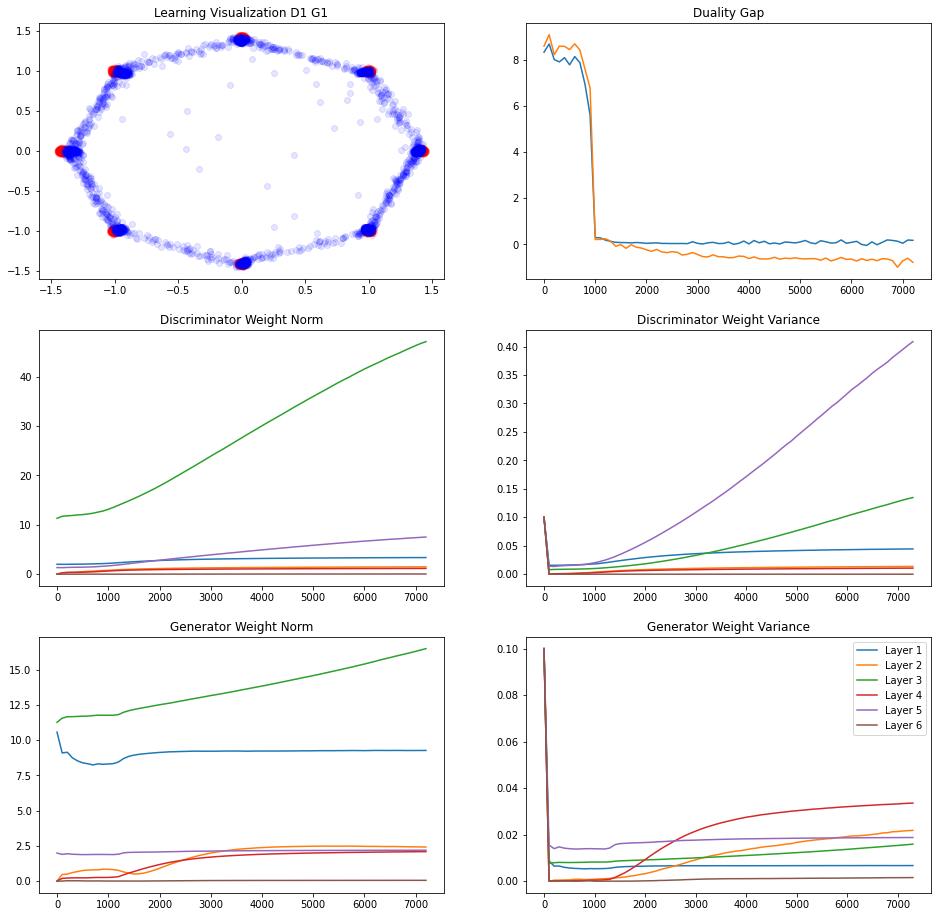

239/250 [===========================>..] - ETA: 0sIteration : 7300 [D loss: 0.604417, acc.: 66.80%] [G loss: 1.035764]
Vanilla   Duality GAP :  0.19315183
L Random  Duality Gap :  -0.6597192


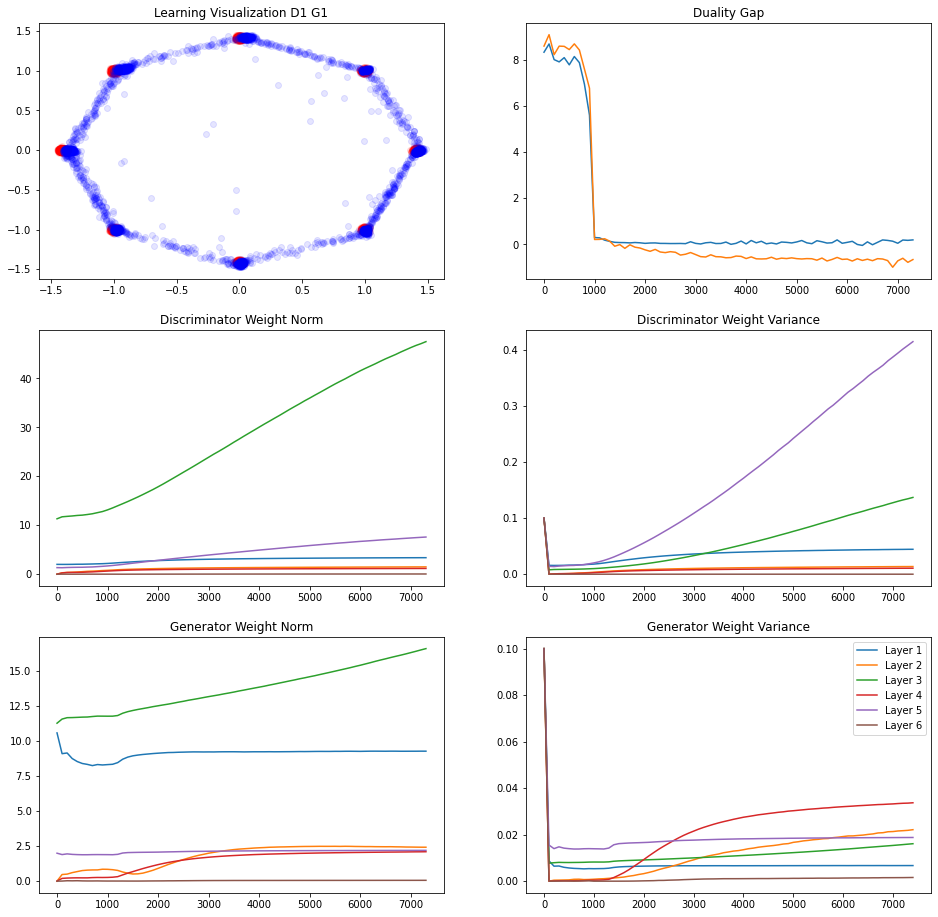

240/250 [===========================>..] - ETA: 0sIteration : 7400 [D loss: 0.623617, acc.: 63.28%] [G loss: 1.054064]
Vanilla   Duality GAP :  0.07441676
L Random  Duality Gap :  -0.7543537


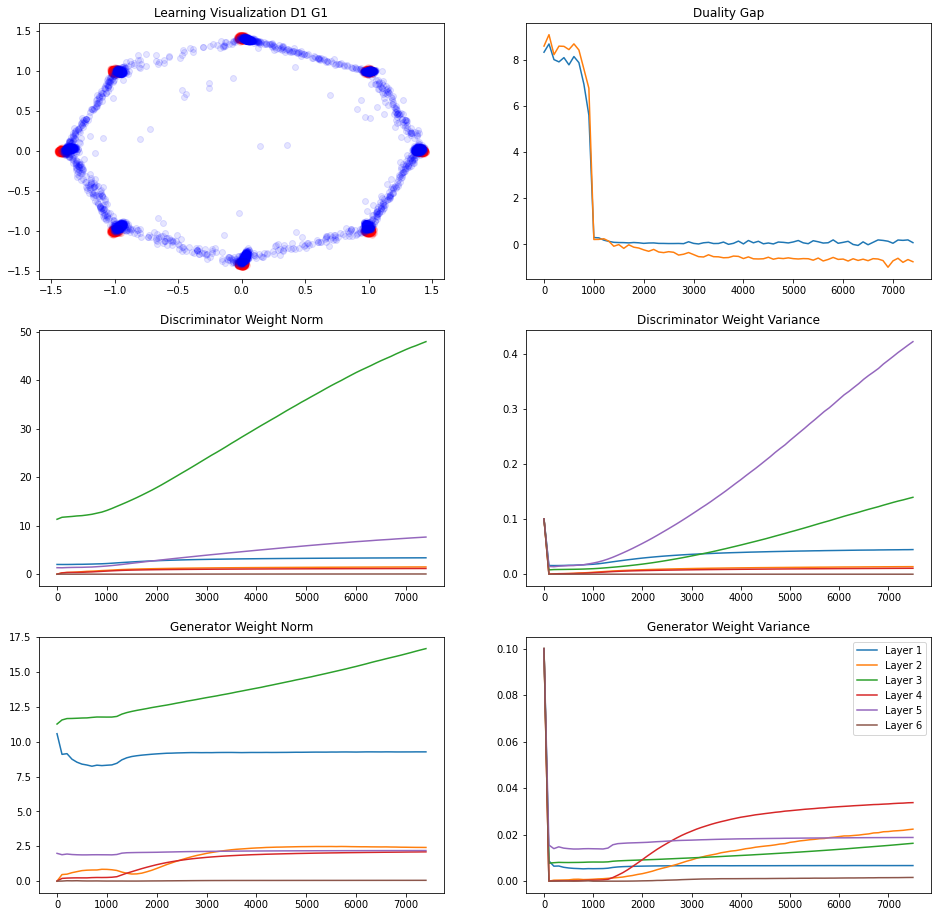

248/250 [============================>.] - ETA: 0sIteration : 7500 [D loss: 0.633964, acc.: 61.72%] [G loss: 1.045497]
Vanilla   Duality GAP :  -0.039995313
L Random  Duality Gap :  -0.745598


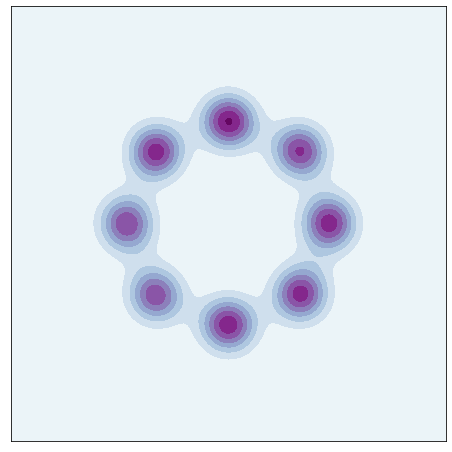

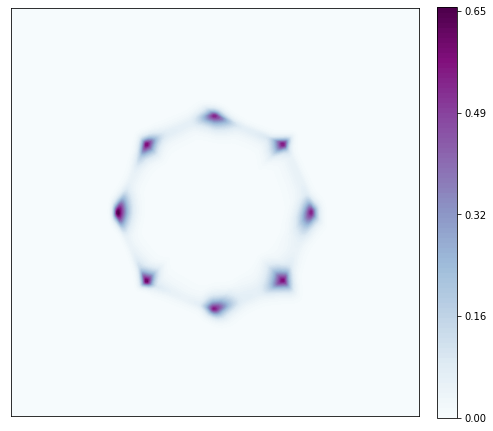

247/250 [============================>.] - ETA: 0sIteration : 7600 [D loss: 0.642742, acc.: 60.16%] [G loss: 0.908145]
Vanilla   Duality GAP :  -0.039266944
L Random  Duality Gap :  -0.7261769


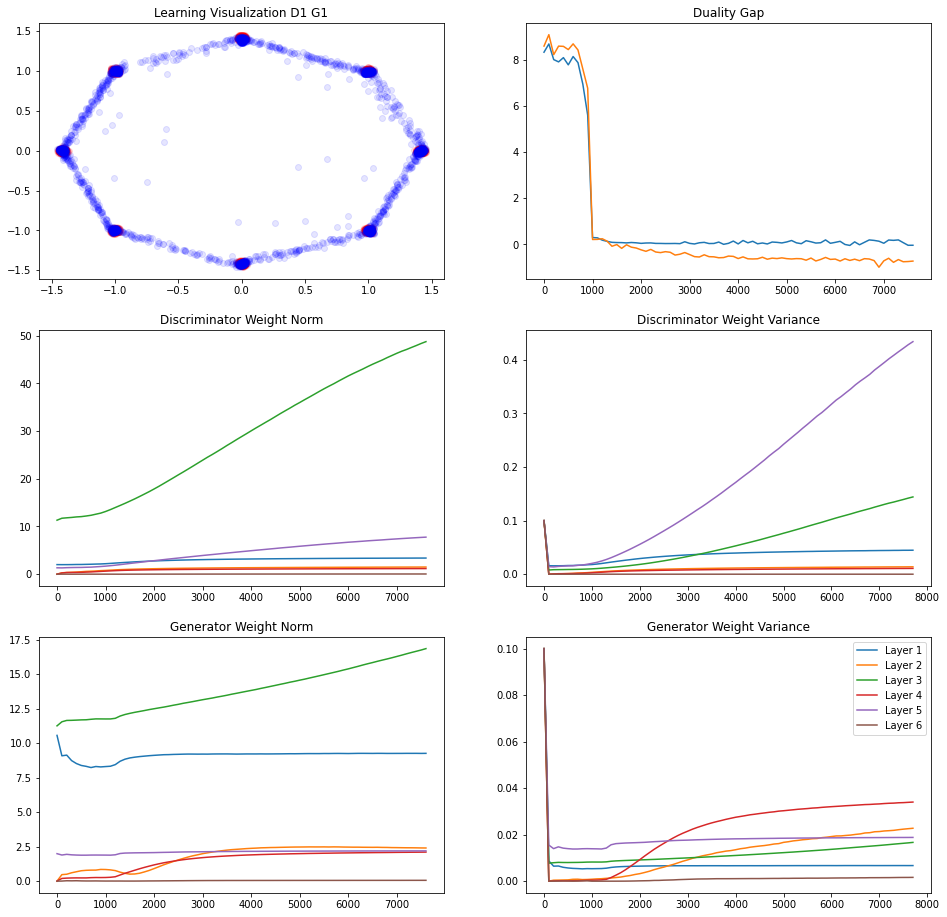

245/250 [============================>.] - ETA: 0sIteration : 7700 [D loss: 0.621590, acc.: 62.89%] [G loss: 0.964976]
Vanilla   Duality GAP :  0.1109066
L Random  Duality Gap :  -0.7119439


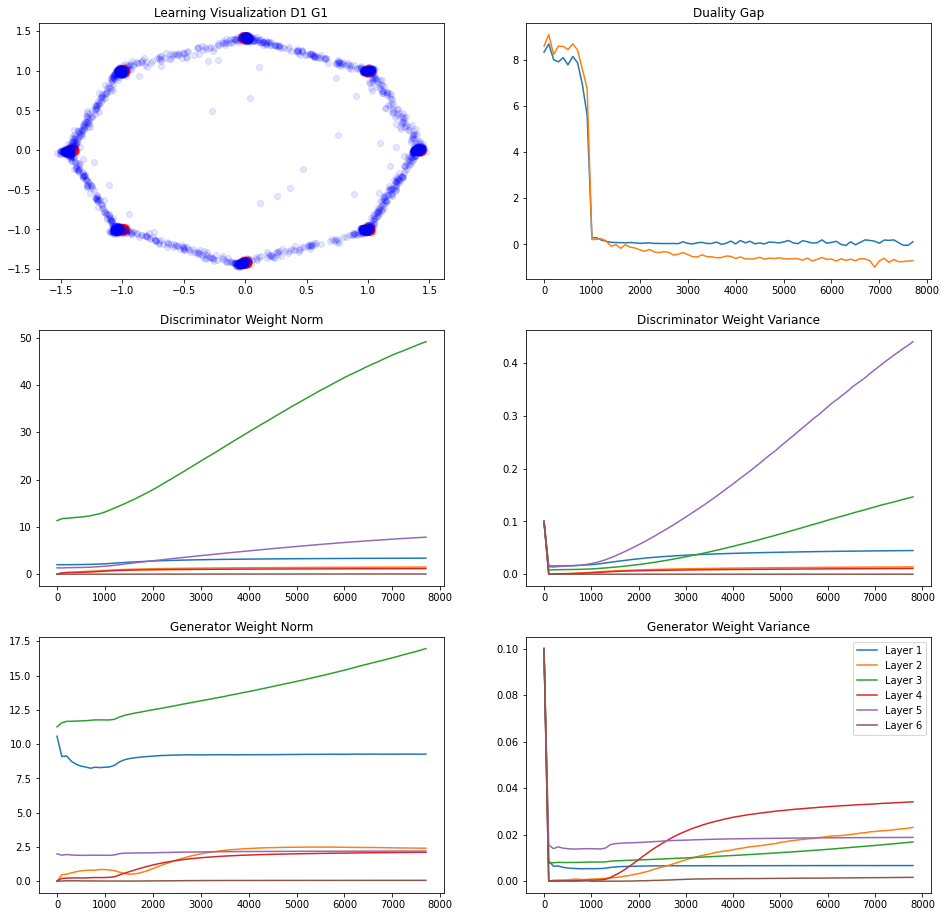

246/250 [============================>.] - ETA: 0sIteration : 7800 [D loss: 0.624288, acc.: 63.28%] [G loss: 0.919811]
Vanilla   Duality GAP :  0.09891784
L Random  Duality Gap :  -0.79709476


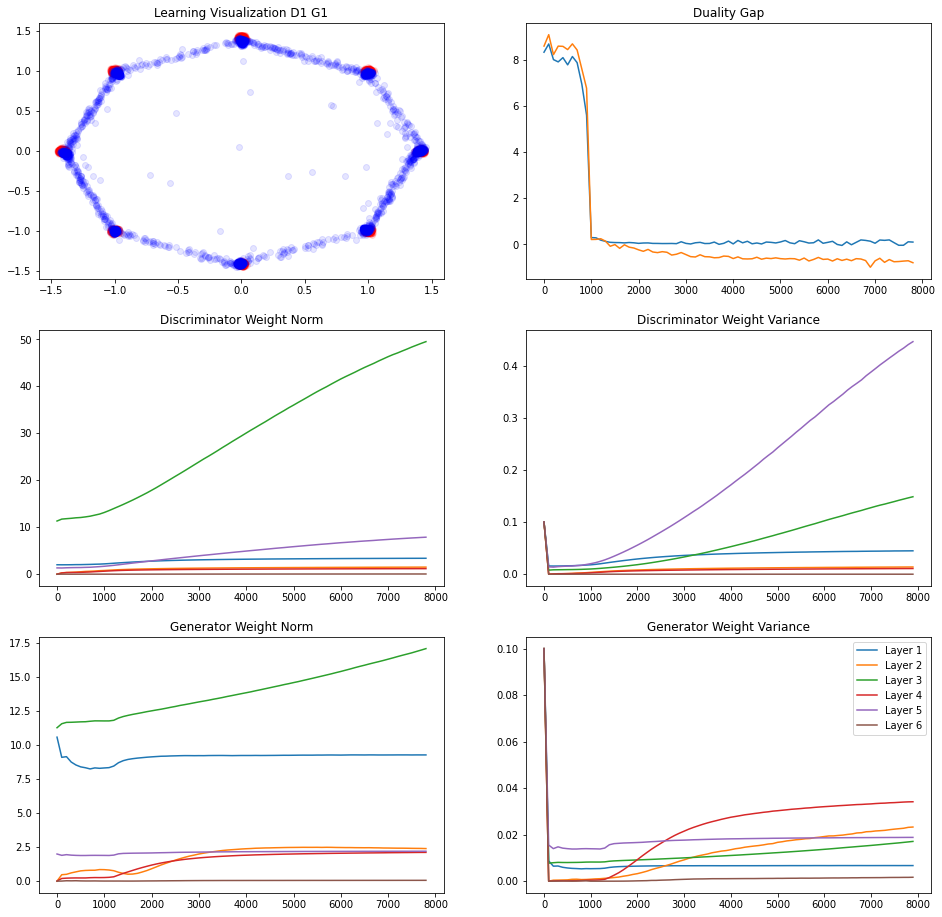

241/250 [===========================>..] - ETA: 0sIteration : 7900 [D loss: 0.628850, acc.: 62.11%] [G loss: 0.869756]
Vanilla   Duality GAP :  0.3023718
L Random  Duality Gap :  -0.53800446


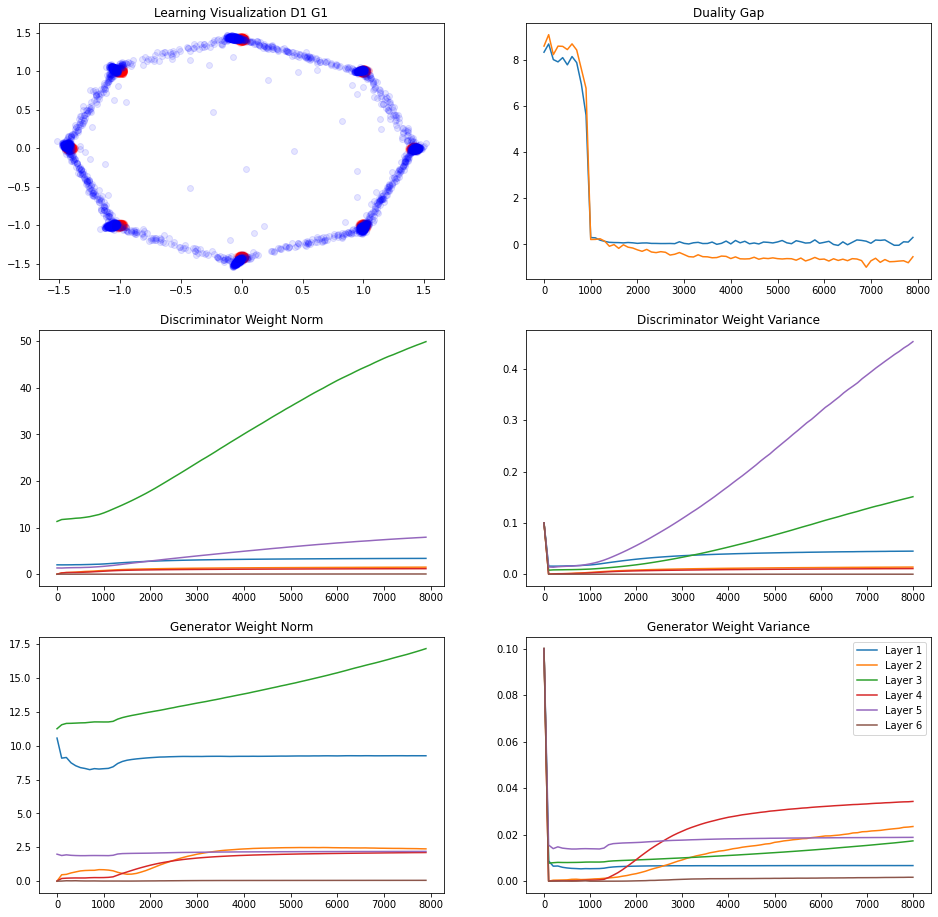

236/250 [===========================>..] - ETA: 0sIteration : 8000 [D loss: 0.676333, acc.: 58.20%] [G loss: 0.892183]
Vanilla   Duality GAP :  -0.025296092
L Random  Duality Gap :  -0.711717


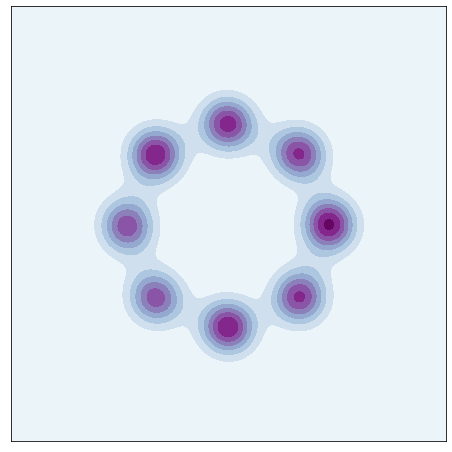

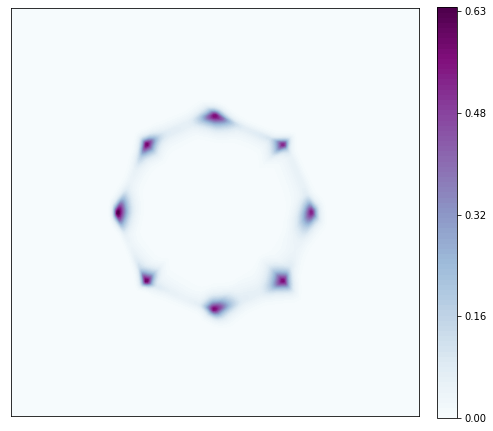

243/250 [============================>.] - ETA: 0sIteration : 8100 [D loss: 0.638870, acc.: 62.50%] [G loss: 0.937820]
Vanilla   Duality GAP :  0.23221481
L Random  Duality Gap :  -0.6158124


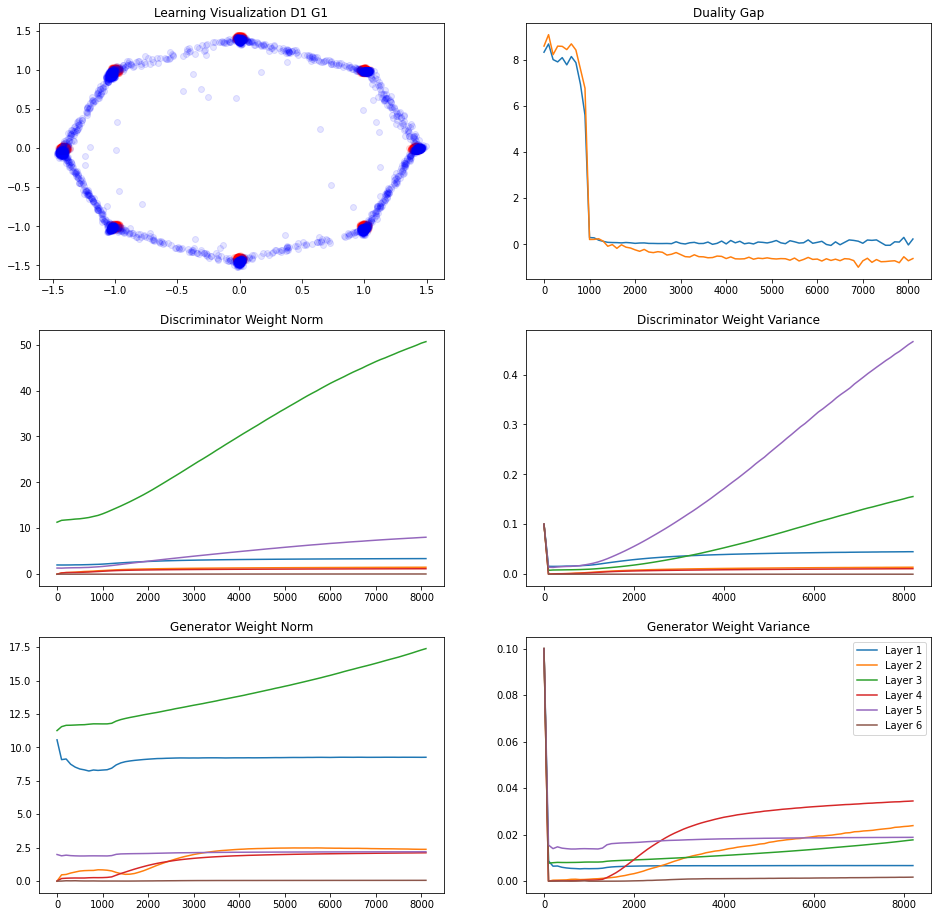

245/250 [============================>.] - ETA: 0sIteration : 8200 [D loss: 0.672230, acc.: 54.30%] [G loss: 1.017006]
Vanilla   Duality GAP :  -0.0019055605
L Random  Duality Gap :  -0.74452615


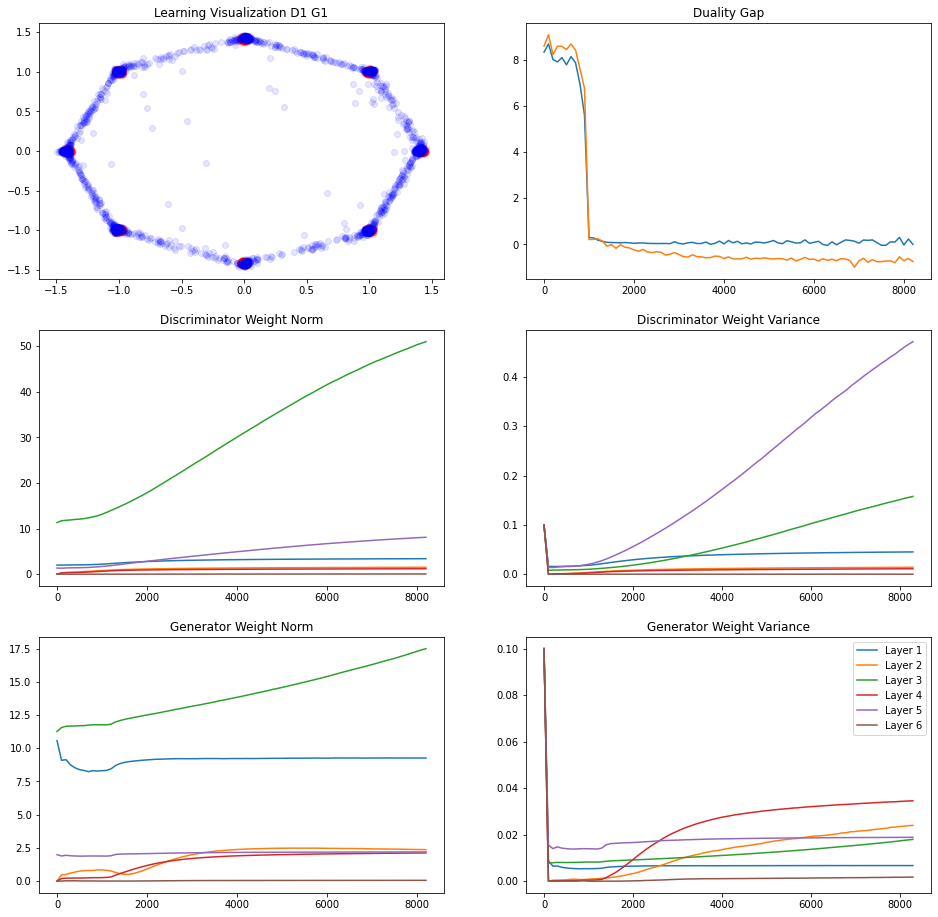

241/250 [===========================>..] - ETA: 0sIteration : 8300 [D loss: 0.572190, acc.: 75.00%] [G loss: 1.200763]
Vanilla   Duality GAP :  -0.06262457
L Random  Duality Gap :  -0.7326463


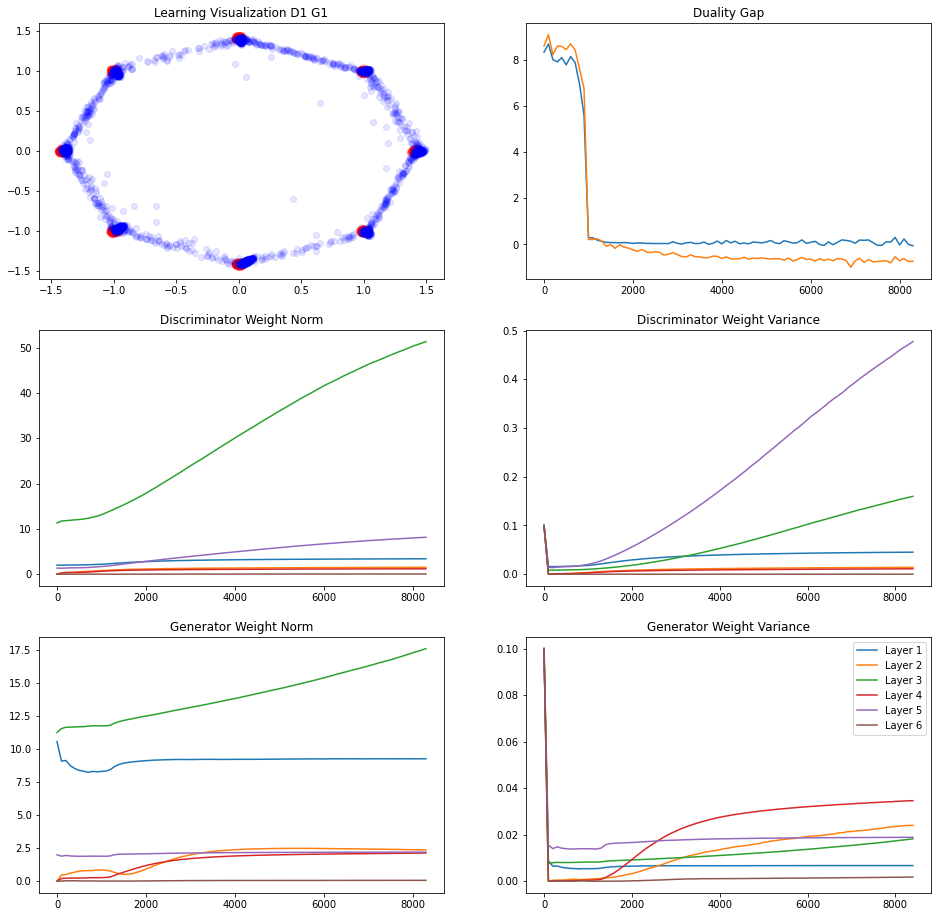

248/250 [============================>.] - ETA: 0sIteration : 8400 [D loss: 0.644182, acc.: 58.59%] [G loss: 1.031436]
Vanilla   Duality GAP :  0.20078182
L Random  Duality Gap :  -0.9059866


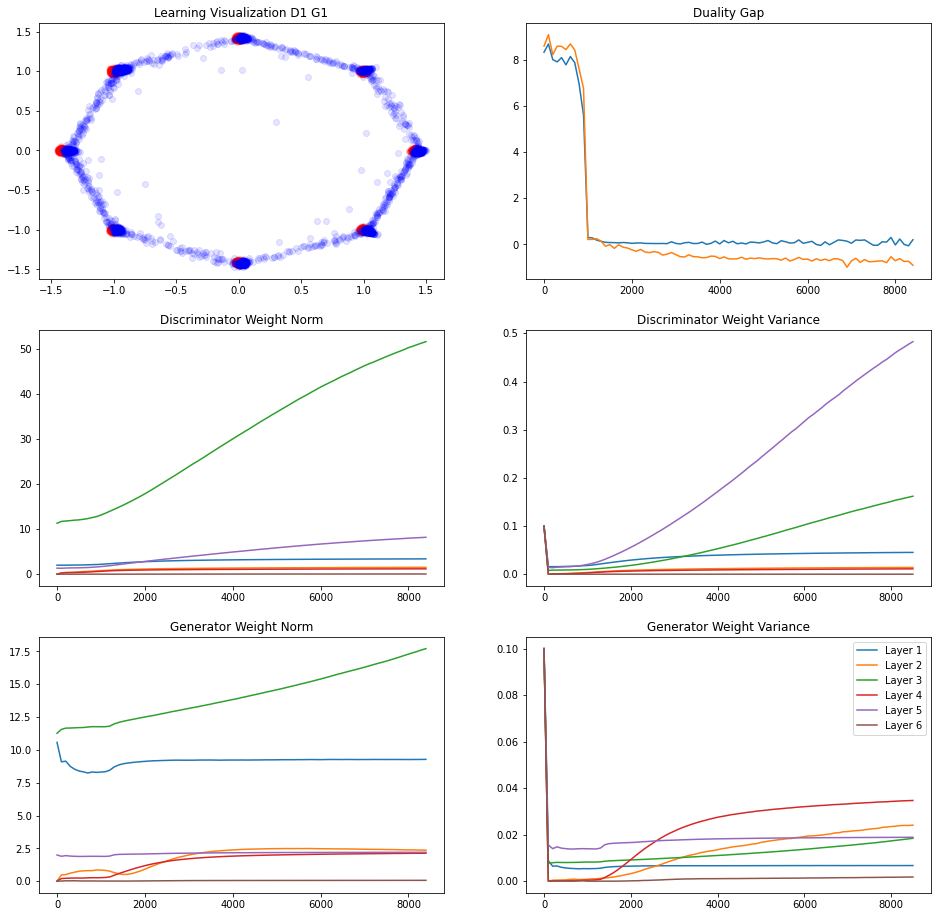

242/250 [============================>.] - ETA: 0sIteration : 8500 [D loss: 0.594280, acc.: 73.05%] [G loss: 1.114691]
Vanilla   Duality GAP :  0.22897917
L Random  Duality Gap :  -0.7722025


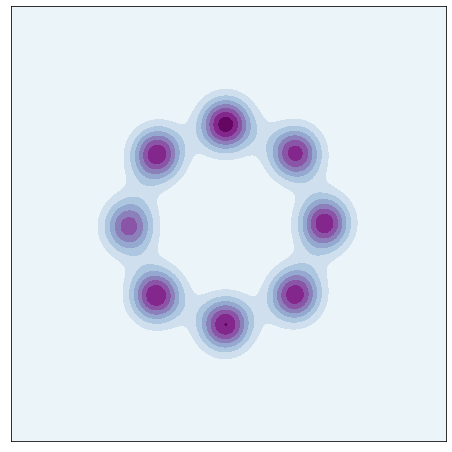

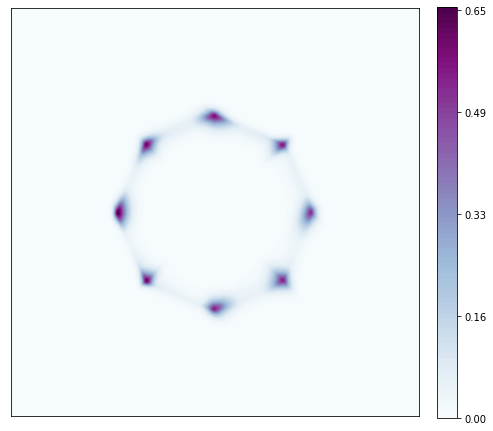

241/250 [===========================>..] - ETA: 0sIteration : 8600 [D loss: 0.626468, acc.: 62.11%] [G loss: 0.888728]
Vanilla   Duality GAP :  0.19565797
L Random  Duality Gap :  -0.59154224


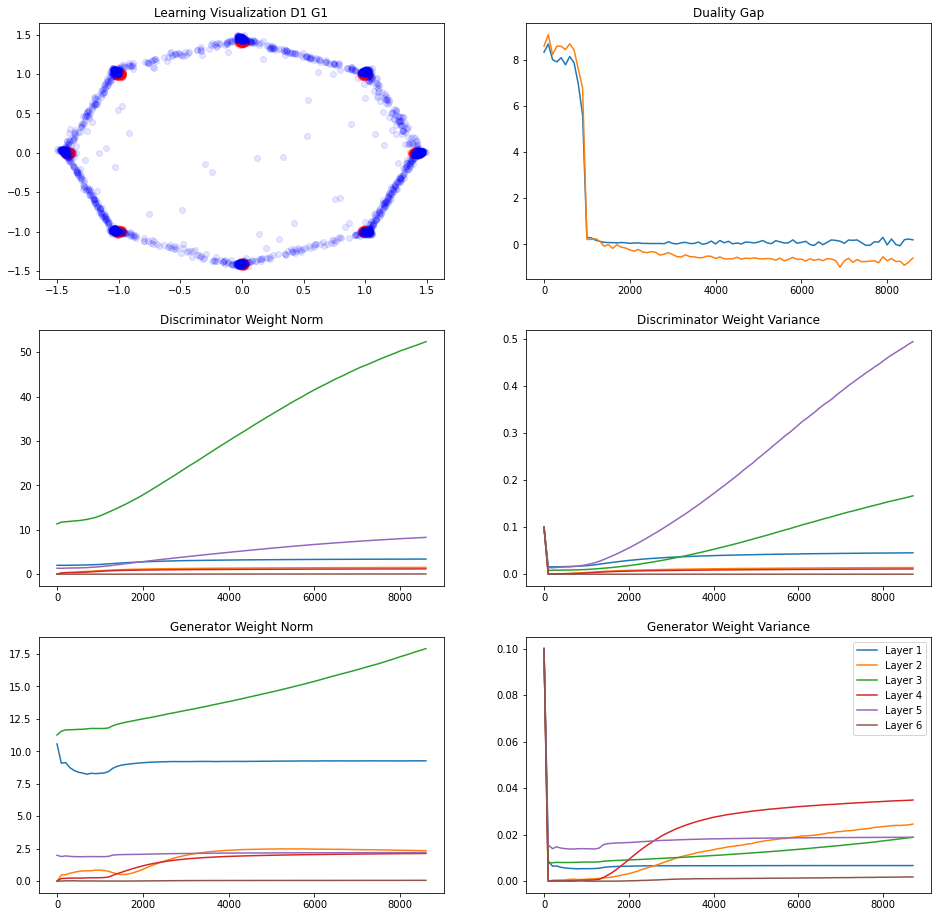

244/250 [============================>.] - ETA: 0sIteration : 8700 [D loss: 0.650860, acc.: 60.55%] [G loss: 0.946265]
Vanilla   Duality GAP :  0.08997083
L Random  Duality Gap :  -0.69241595


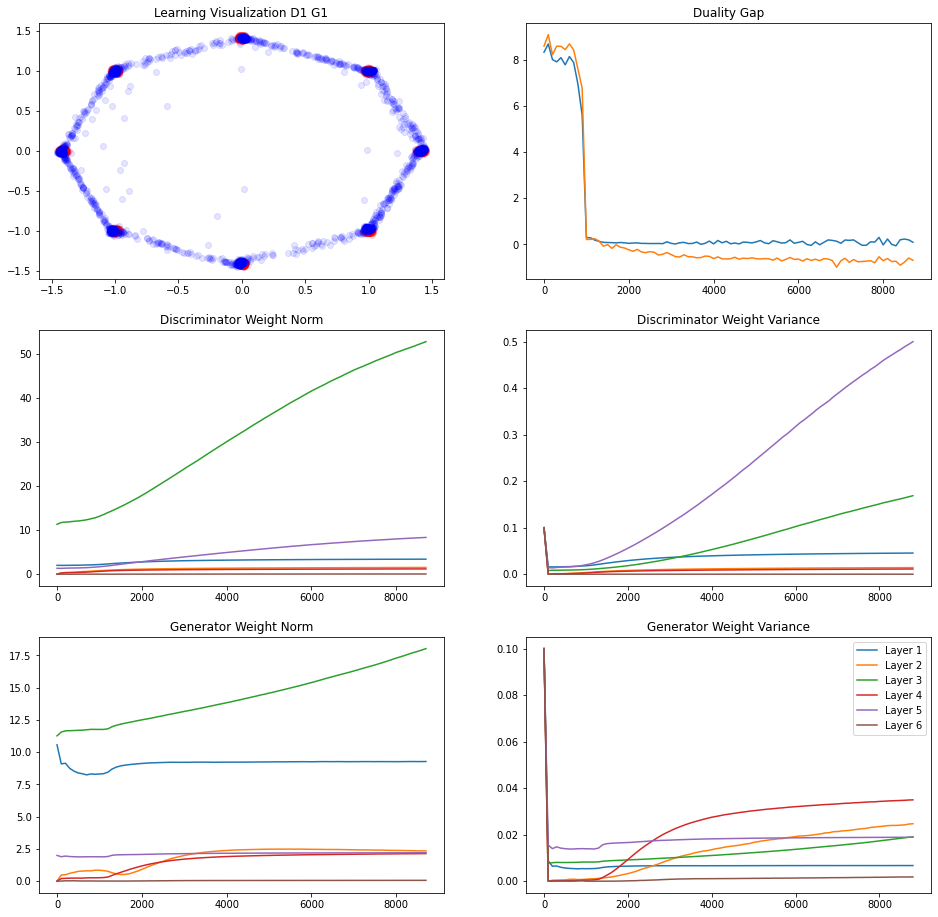

241/250 [===========================>..] - ETA: 0sIteration : 8800 [D loss: 0.673317, acc.: 48.44%] [G loss: 0.976016]
Vanilla   Duality GAP :  0.028511405
L Random  Duality Gap :  -0.65574807


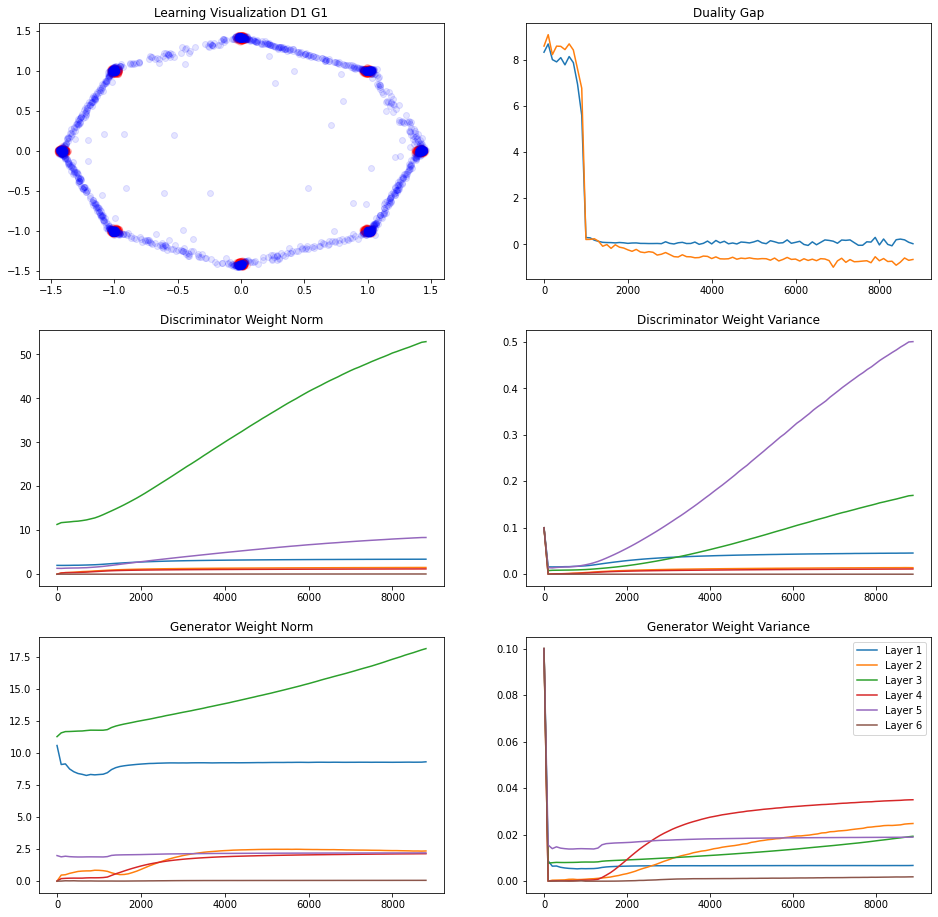

244/250 [============================>.] - ETA: 0sIteration : 8900 [D loss: 0.655440, acc.: 52.34%] [G loss: 1.037195]
Vanilla   Duality GAP :  0.06266451
L Random  Duality Gap :  -0.68143487


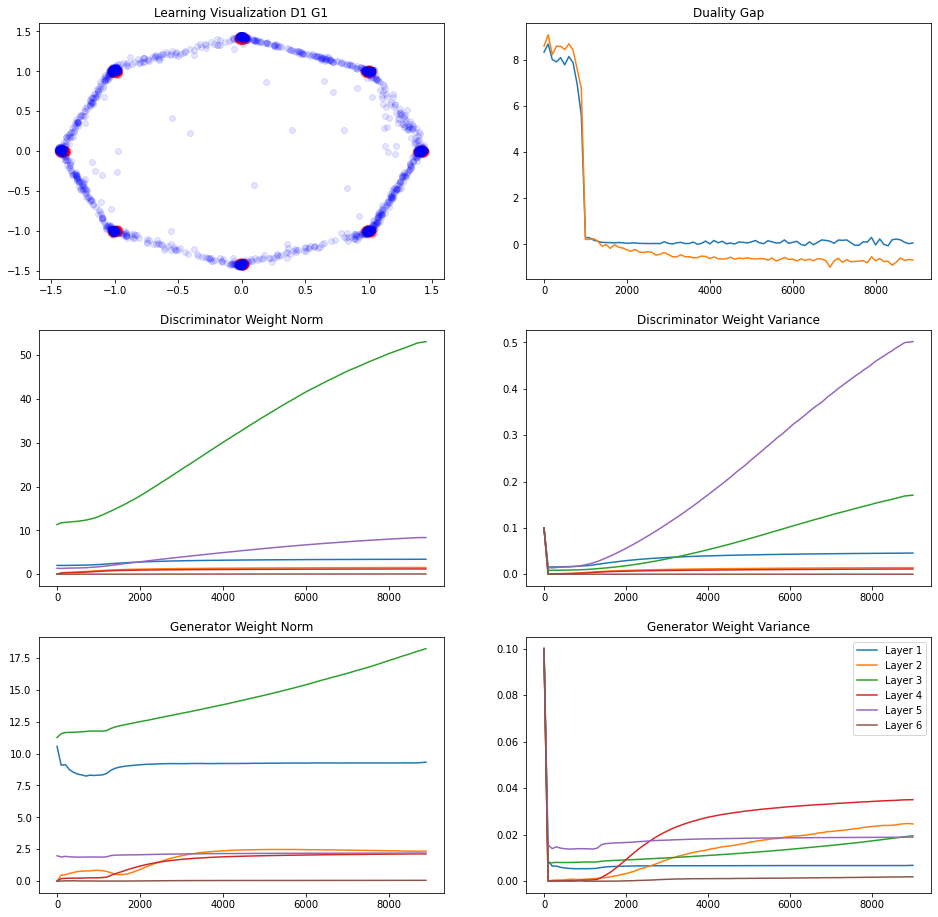

237/250 [===========================>..] - ETA: 0sIteration : 9000 [D loss: 0.668677, acc.: 41.41%] [G loss: 0.935540]
Vanilla   Duality GAP :  -0.0043447018
L Random  Duality Gap :  -0.6998345


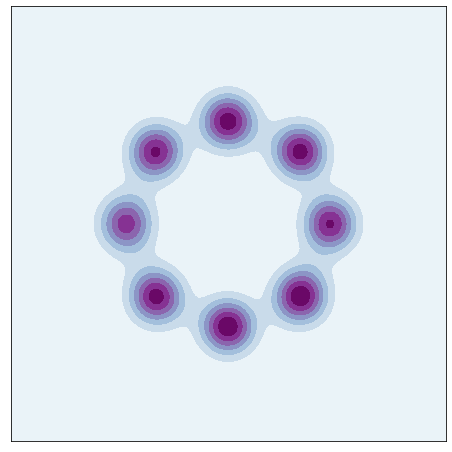

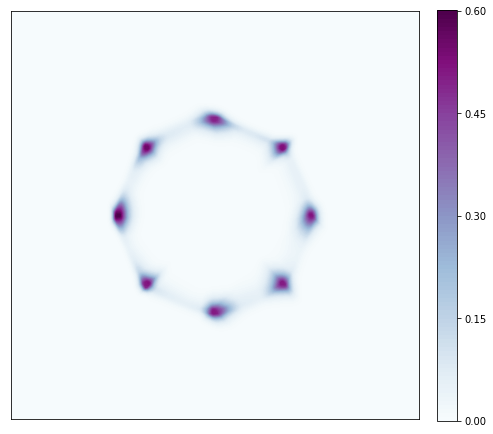

239/250 [===========================>..] - ETA: 0sIteration : 9100 [D loss: 0.670933, acc.: 42.97%] [G loss: 0.869115]
Vanilla   Duality GAP :  0.028378129
L Random  Duality Gap :  -0.68072987


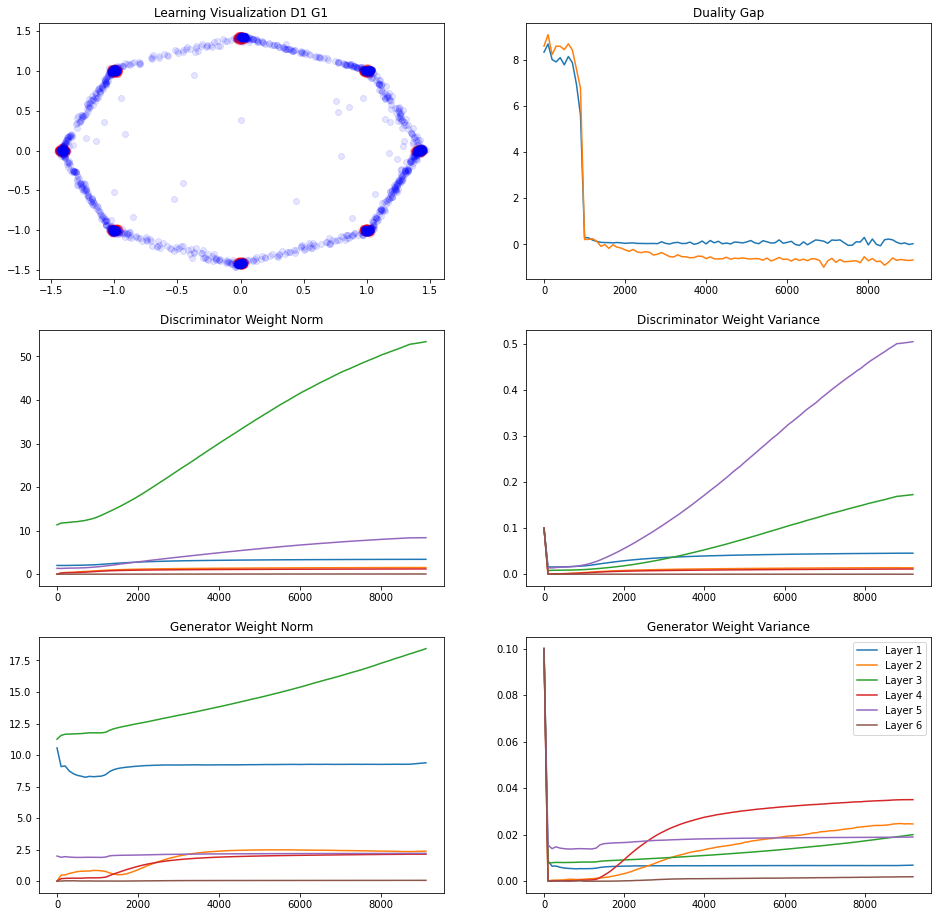

241/250 [===========================>..] - ETA: 0sIteration : 9200 [D loss: 0.671621, acc.: 41.80%] [G loss: 0.863607]
Vanilla   Duality GAP :  -0.011346698
L Random  Duality Gap :  -0.6582904


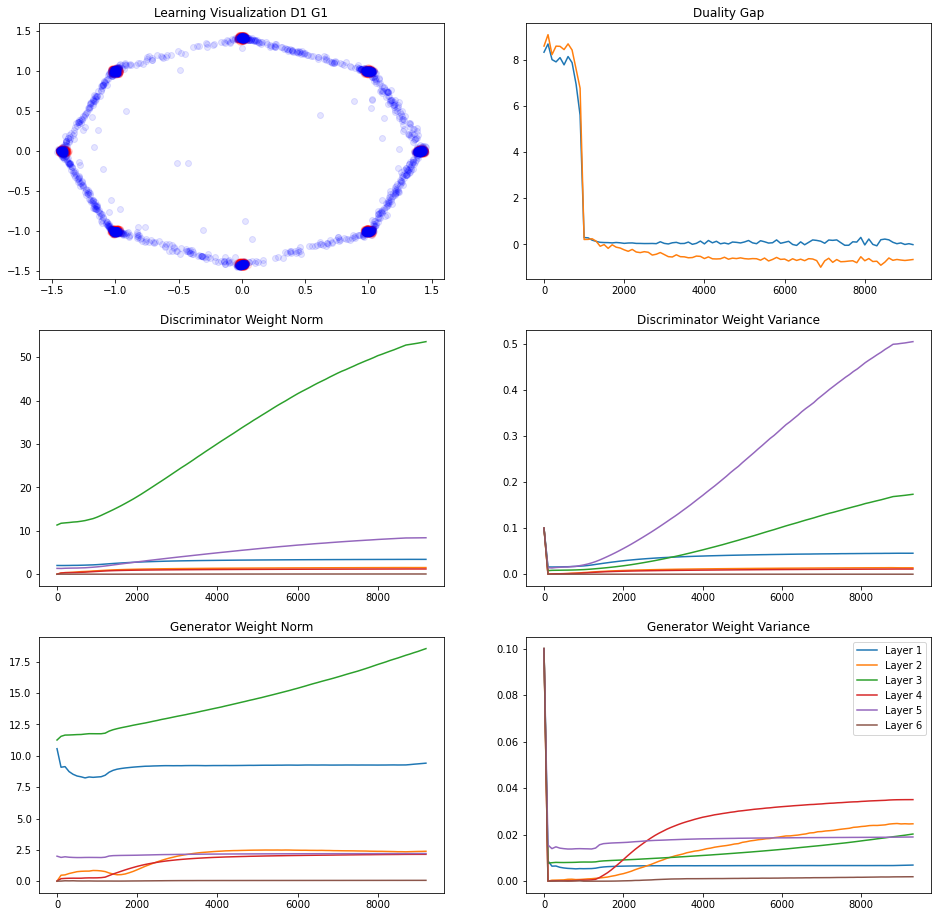

248/250 [============================>.] - ETA: 0sIteration : 9300 [D loss: 0.660041, acc.: 48.05%] [G loss: 0.958644]
Vanilla   Duality GAP :  0.032447815
L Random  Duality Gap :  -0.6755581


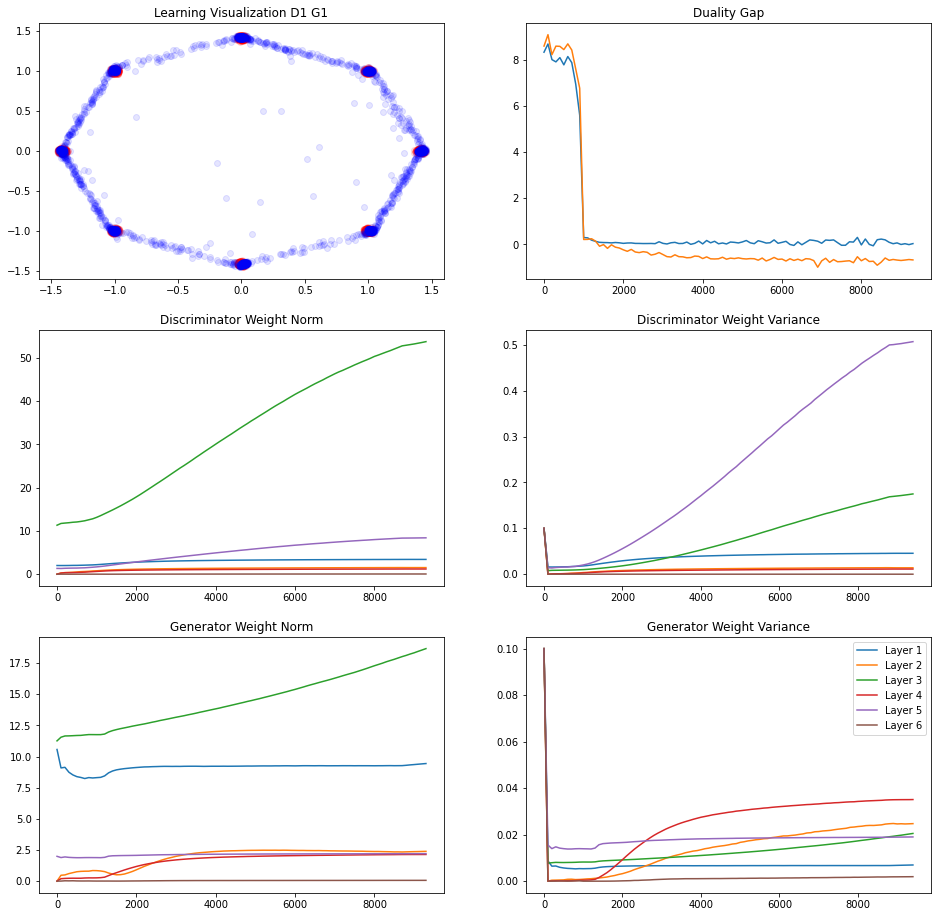

247/250 [============================>.] - ETA: 0sIteration : 9400 [D loss: 0.678258, acc.: 39.06%] [G loss: 0.897286]
Vanilla   Duality GAP :  0.041172266
L Random  Duality Gap :  -0.6972694


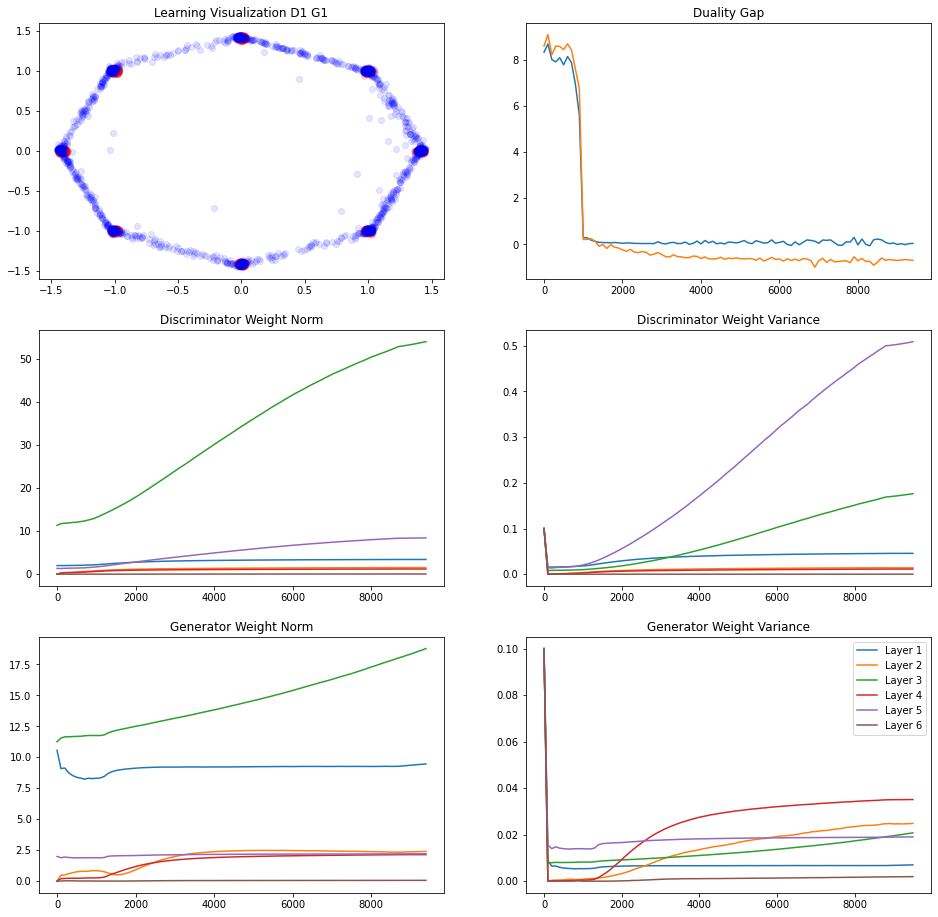

242/250 [============================>.] - ETA: 0sIteration : 9500 [D loss: 0.560233, acc.: 80.86%] [G loss: 1.246000]
Vanilla   Duality GAP :  0.055176258
L Random  Duality Gap :  -0.9036798


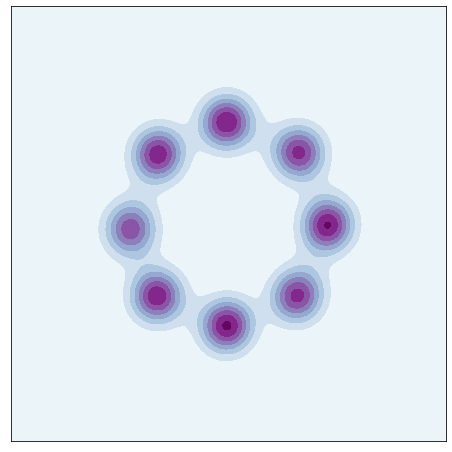

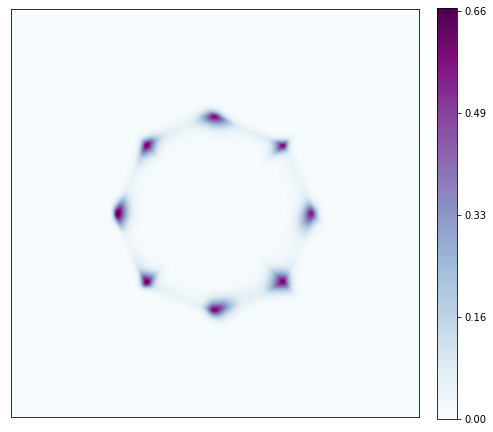

243/250 [============================>.] - ETA: 0sIteration : 9600 [D loss: 0.637118, acc.: 66.02%] [G loss: 1.071460]
Vanilla   Duality GAP :  0.22525084
L Random  Duality Gap :  -0.606669


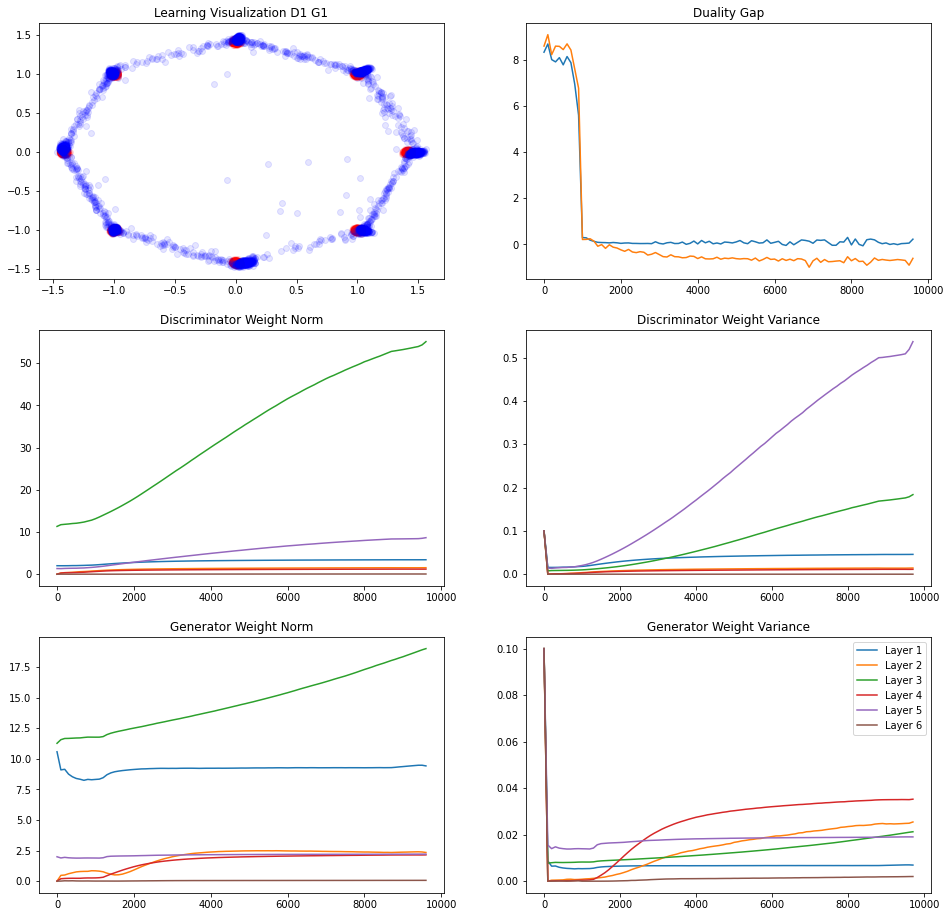

247/250 [============================>.] - ETA: 0sIteration : 9700 [D loss: 0.589140, acc.: 71.48%] [G loss: 1.126209]
Vanilla   Duality GAP :  0.2980371
L Random  Duality Gap :  -0.7327094


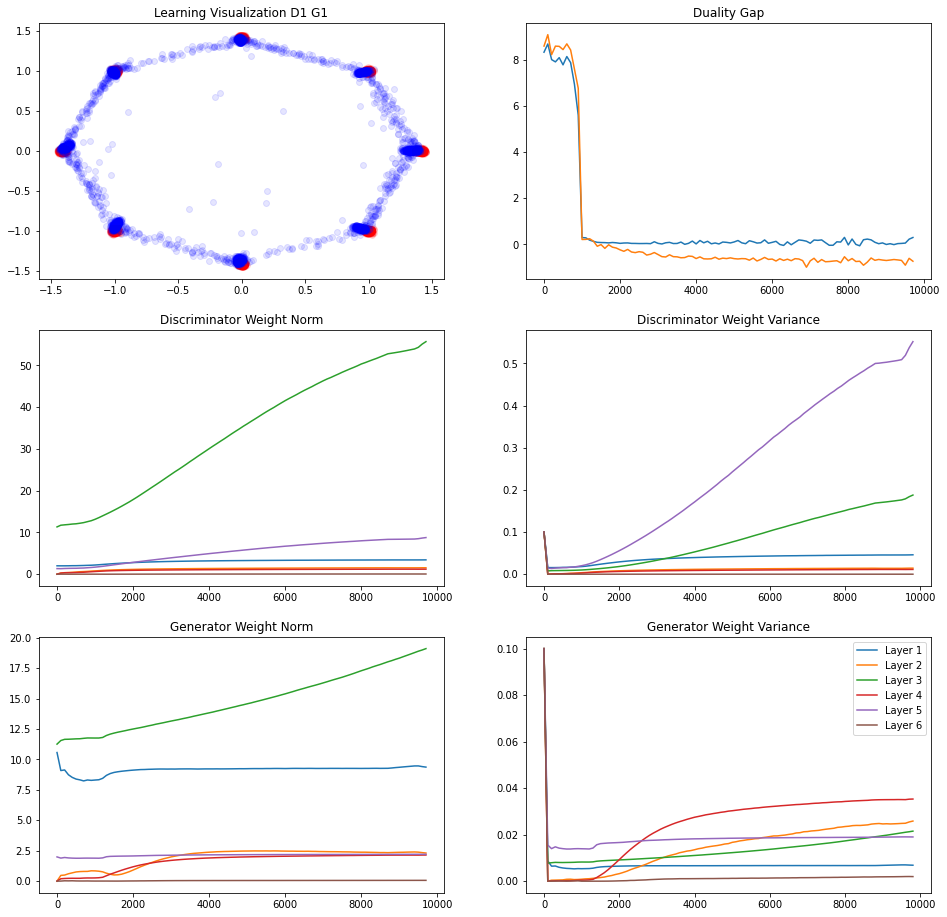

237/250 [===========================>..] - ETA: 0sIteration : 9800 [D loss: 0.652685, acc.: 62.50%] [G loss: 0.872660]
Vanilla   Duality GAP :  0.19060242
L Random  Duality Gap :  -0.73320484


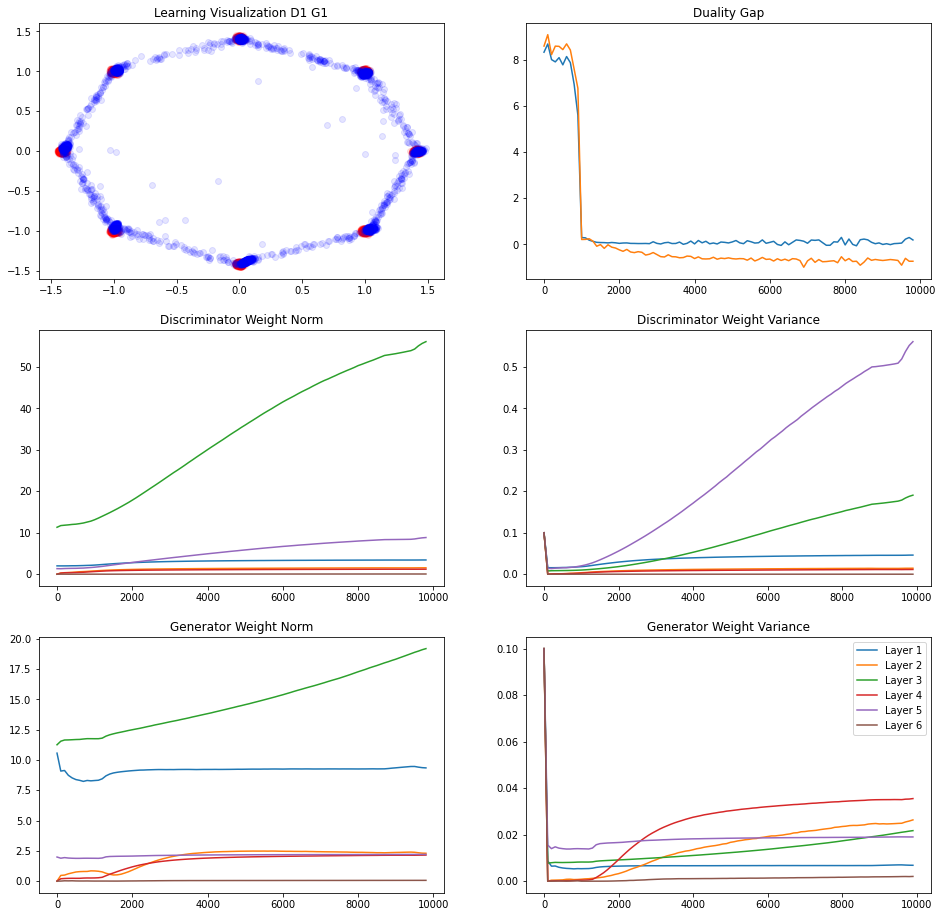

240/250 [===========================>..] - ETA: 0sIteration : 9900 [D loss: 0.530684, acc.: 82.03%] [G loss: 1.275068]
Vanilla   Duality GAP :  0.13679373
L Random  Duality Gap :  -0.76906645


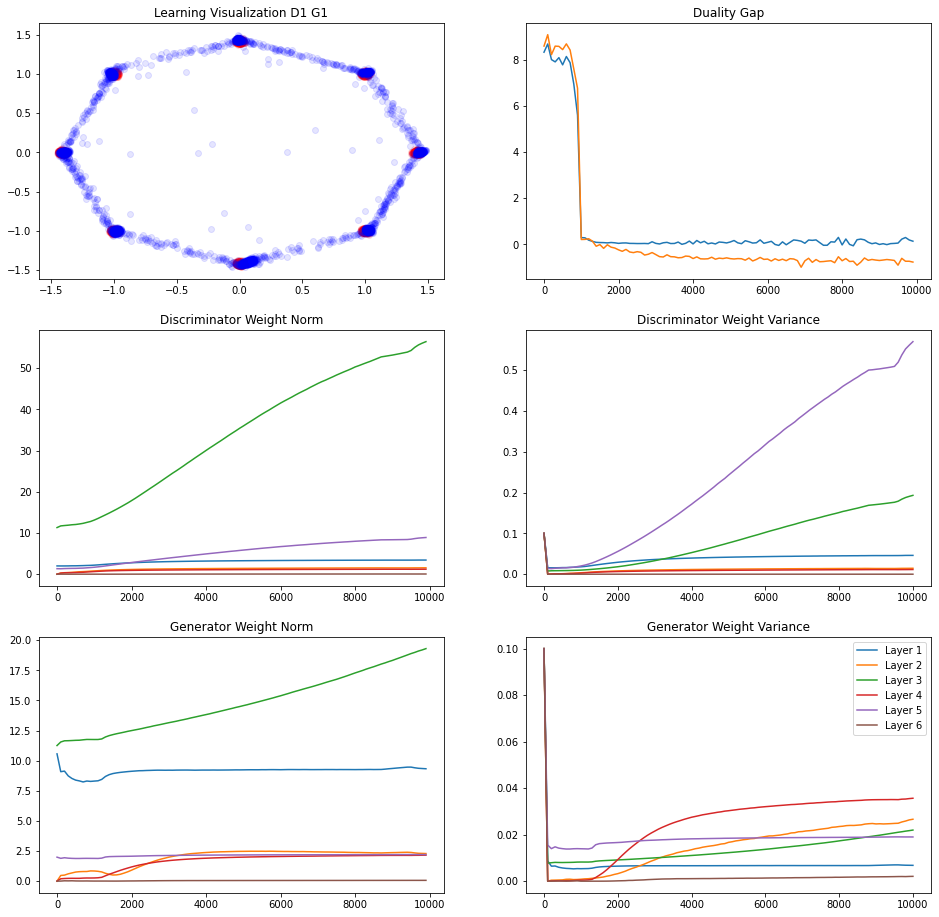

245/250 [============================>.] - ETA: 0sIteration : 10000 [D loss: 0.647952, acc.: 59.38%] [G loss: 0.973587]
Vanilla   Duality GAP :  0.3550558
L Random  Duality Gap :  -0.5912372


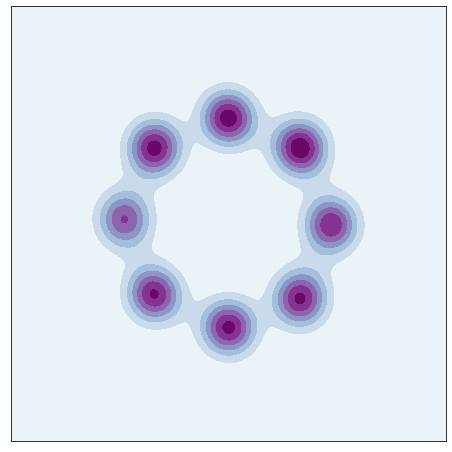

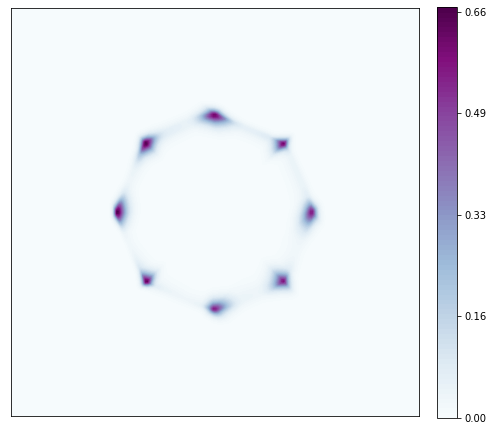

10000/10001 [============================>.] - ETA: 0s----------------------------------------------------------------------------------------------------
		8_modes GAN mode_collapse
----------------------------------------------------------------------------------------------------
./Experiments/8_modes/GAN/mode_collapse
8_modes mode_collapse
15 1
 M1 - Random : False
241/250 [===========================>..] - ETA: 0sIteration : 0 [D loss: 0.641438, acc.: 61.33%] [G loss: 0.670086]
Vanilla   Duality GAP :  8.772821
L Random  Duality Gap :  8.811216


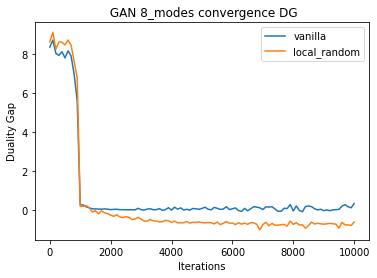

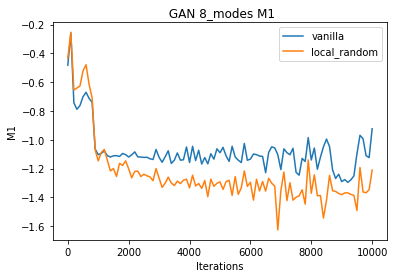

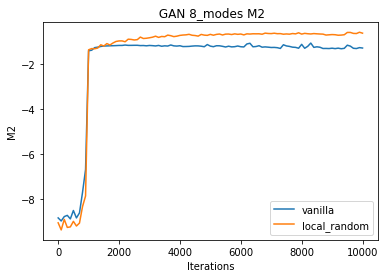

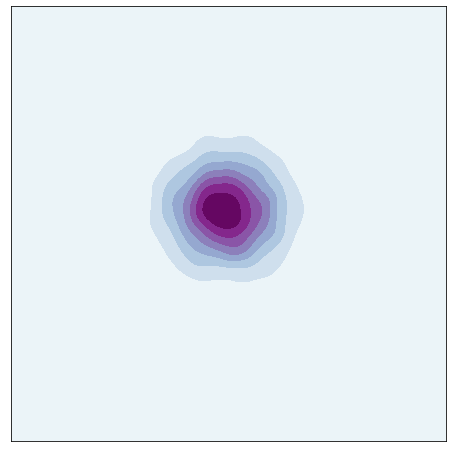

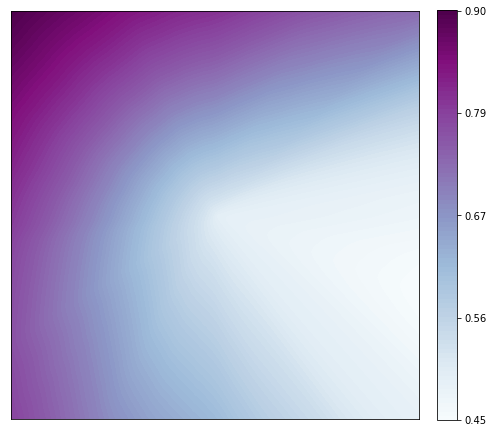

242/250 [============================>.] - ETA: 0sIteration : 100 [D loss: 0.193548, acc.: 93.36%] [G loss: 2.530531]
Vanilla   Duality GAP :  3.5766833
L Random  Duality Gap :  3.1093917


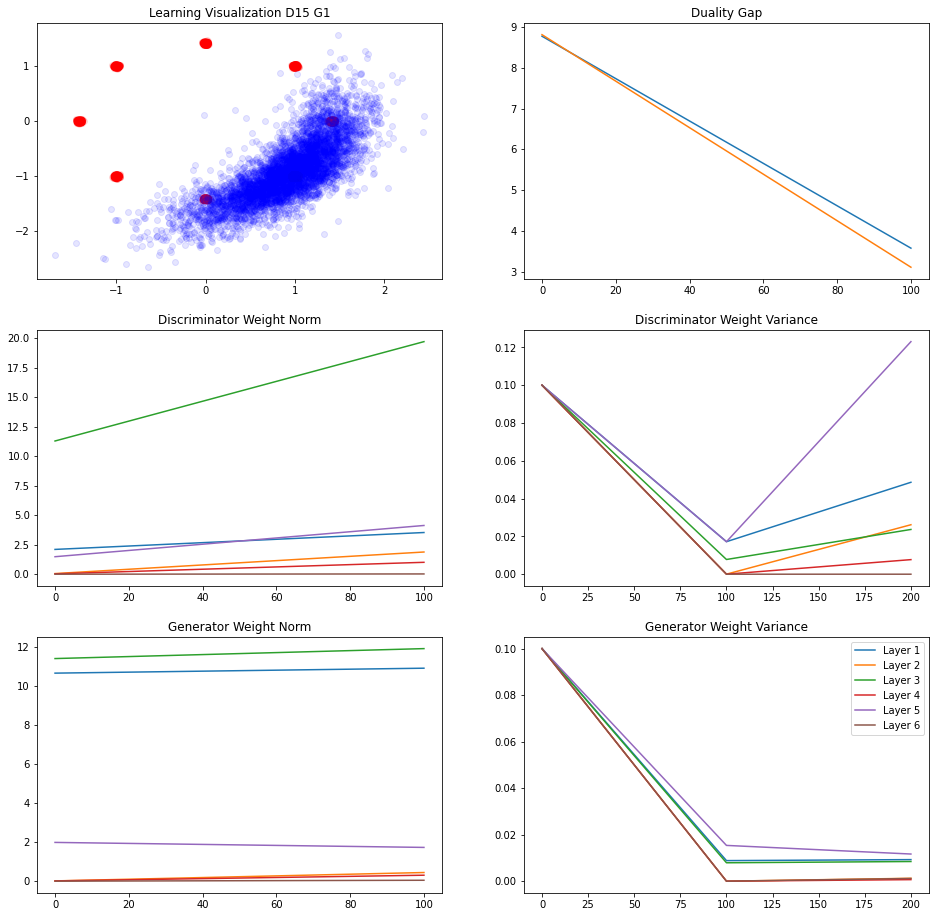

245/250 [============================>.] - ETA: 0sIteration : 200 [D loss: 0.143743, acc.: 93.36%] [G loss: 3.006107]
Vanilla   Duality GAP :  0.07301697
L Random  Duality Gap :  7.745355


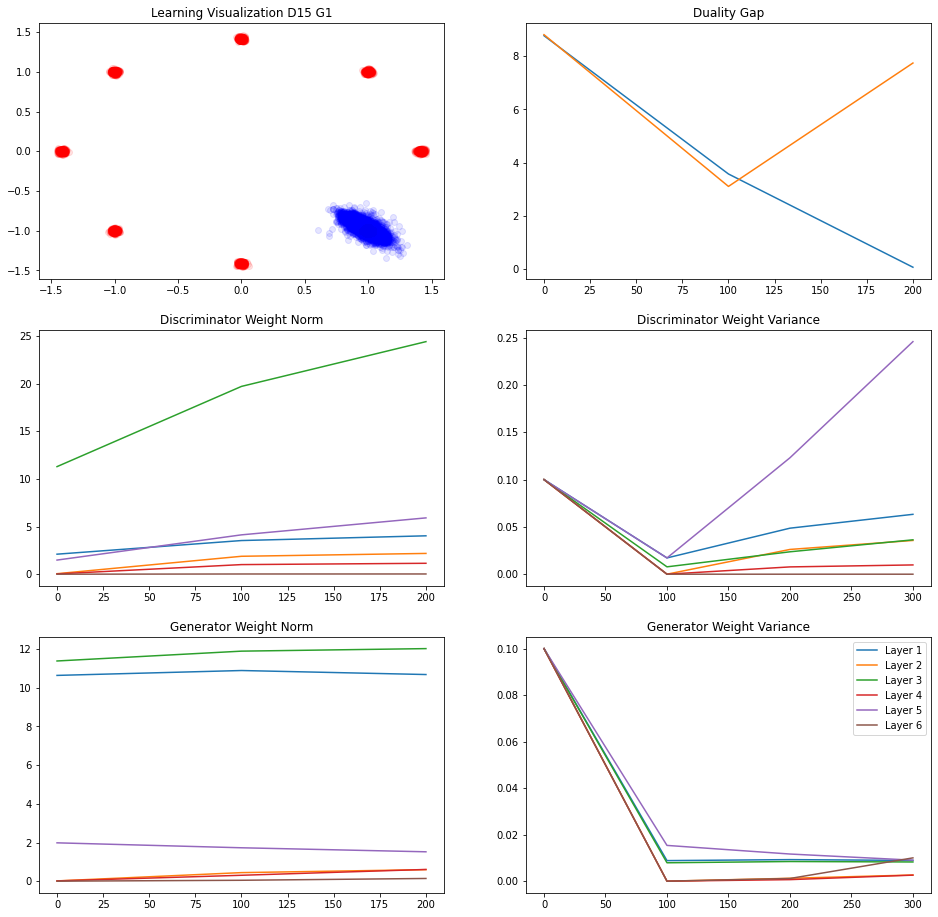

245/250 [============================>.] - ETA: 0sIteration : 300 [D loss: 0.107692, acc.: 95.70%] [G loss: 3.483775]
Vanilla   Duality GAP :  0.050767124
L Random  Duality Gap :  8.334643


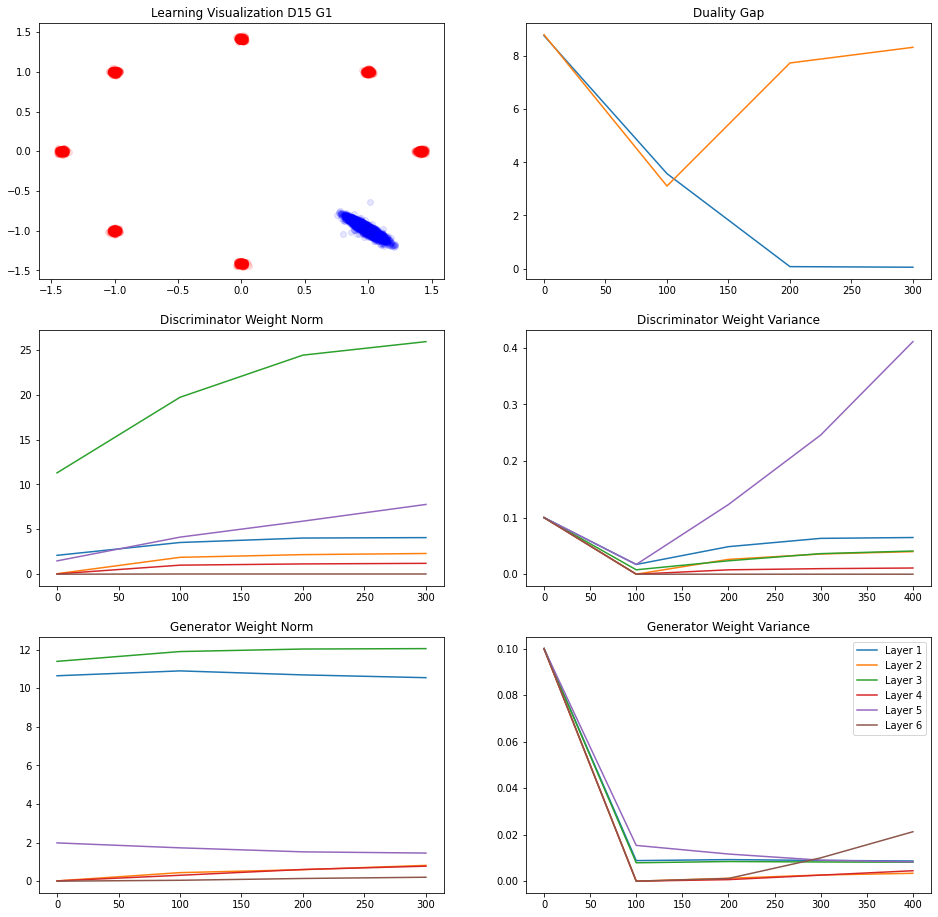

240/250 [===========================>..] - ETA: 0sIteration : 400 [D loss: 0.143397, acc.: 93.36%] [G loss: 4.120646]
Vanilla   Duality GAP :  0.041645974
L Random  Duality Gap :  8.631251


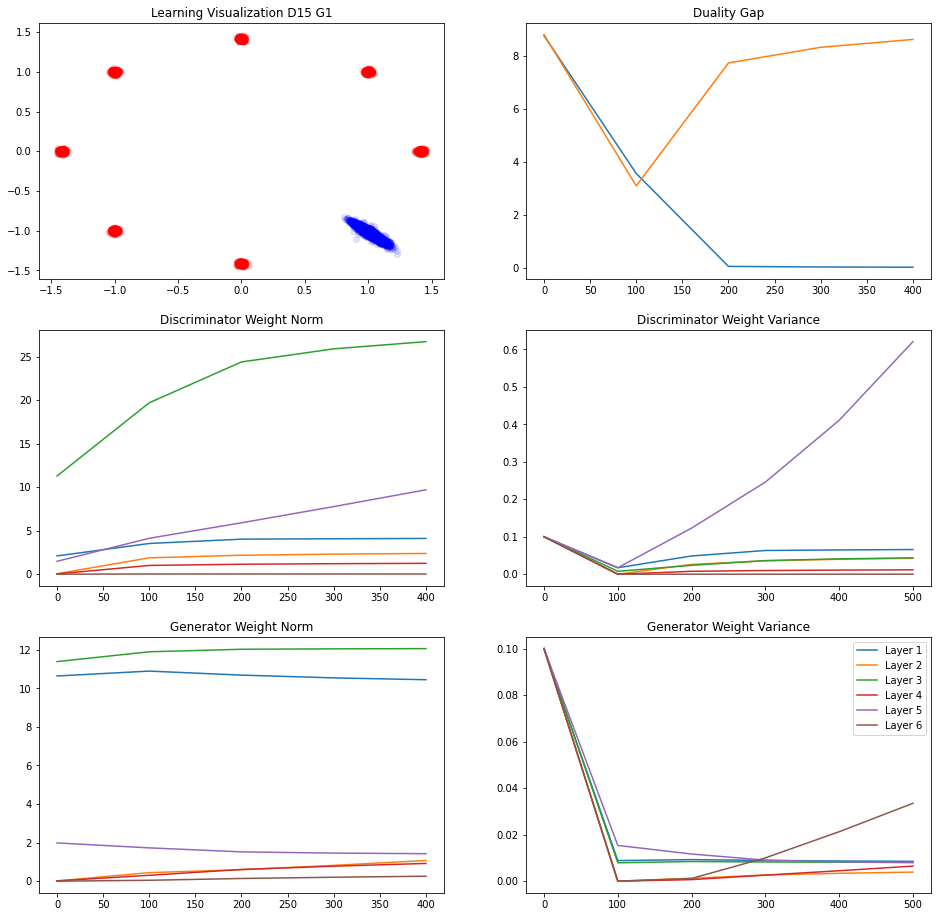

239/250 [===========================>..] - ETA: 0sIteration : 500 [D loss: 0.186878, acc.: 91.80%] [G loss: 4.453552]
Vanilla   Duality GAP :  0.018987387
L Random  Duality Gap :  8.860155


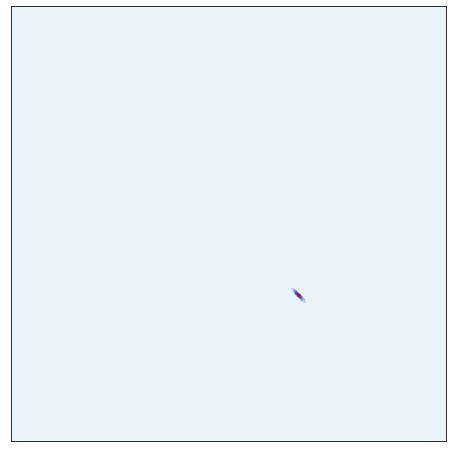

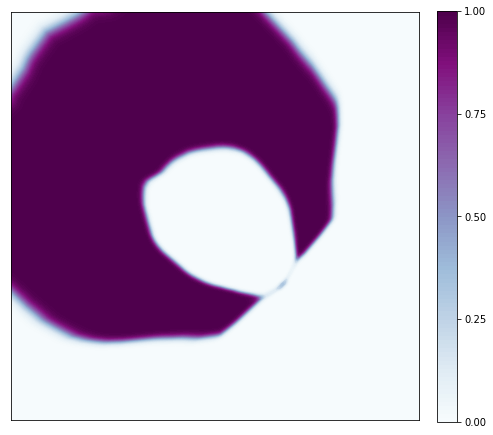

247/250 [============================>.] - ETA: 0sIteration : 600 [D loss: 0.157710, acc.: 92.97%] [G loss: 3.883983]
Vanilla   Duality GAP :  0.021076888
L Random  Duality Gap :  8.839787


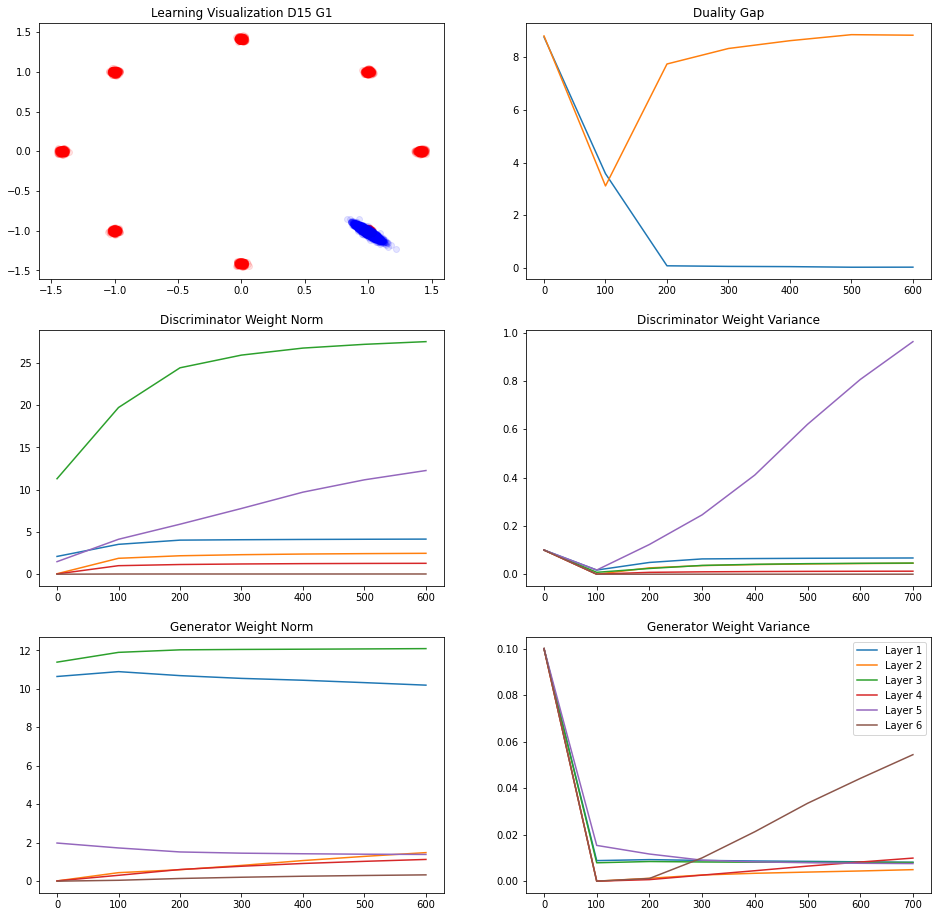

246/250 [============================>.] - ETA: 0sIteration : 700 [D loss: 0.143836, acc.: 93.75%] [G loss: 4.774887]
Vanilla   Duality GAP :  0.02993086
L Random  Duality Gap :  8.862983


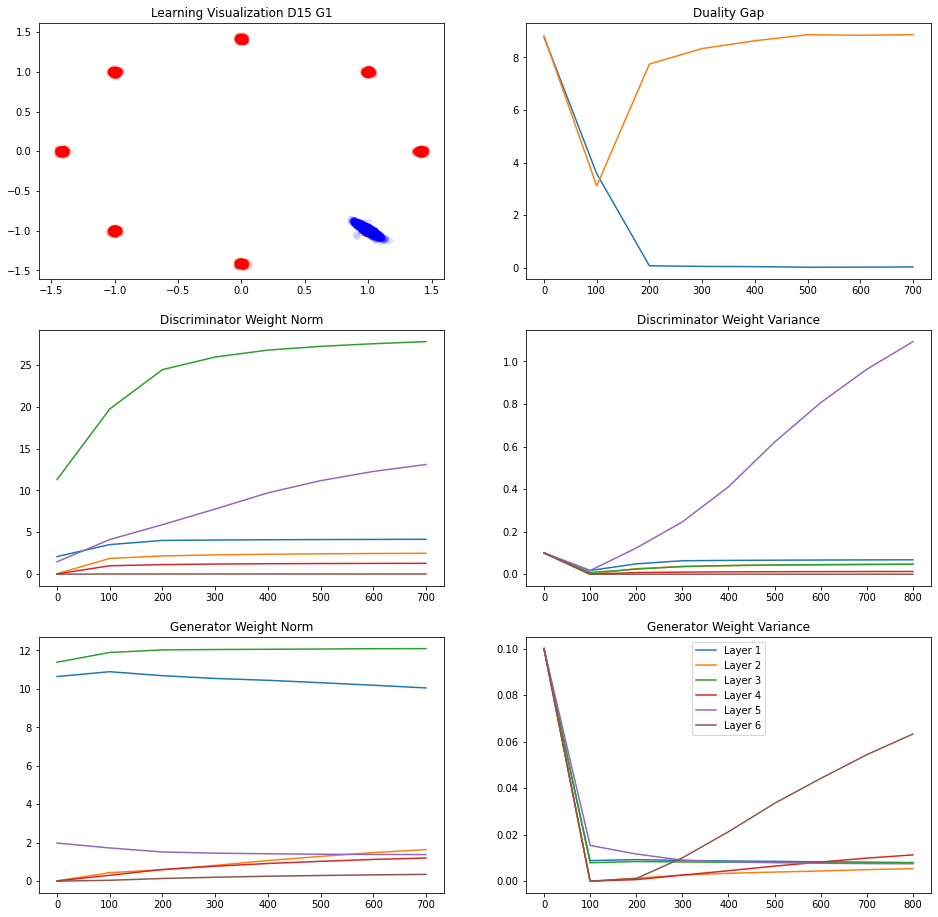

239/250 [===========================>..] - ETA: 0sIteration : 800 [D loss: 0.142892, acc.: 95.31%] [G loss: 4.736869]
Vanilla   Duality GAP :  0.010043293
L Random  Duality Gap :  8.884177


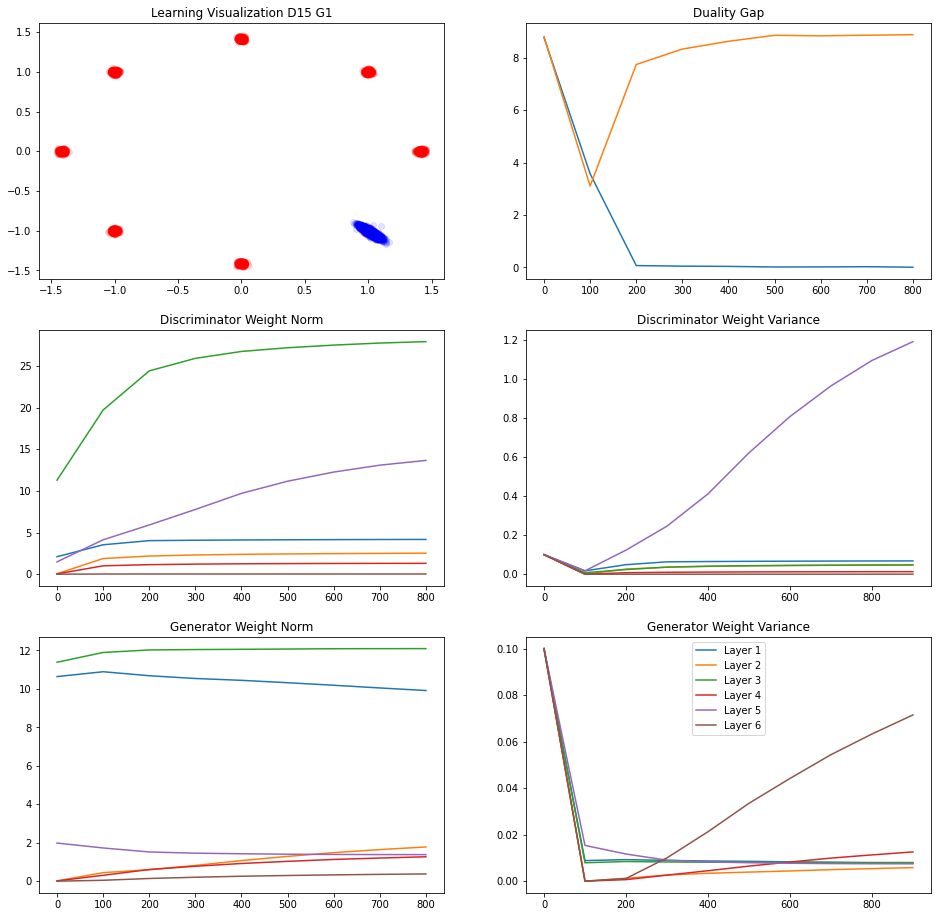

236/250 [===========================>..] - ETA: 0sIteration : 900 [D loss: 0.162545, acc.: 93.36%] [G loss: 3.834845]
Vanilla   Duality GAP :  0.006667912
L Random  Duality Gap :  8.901429


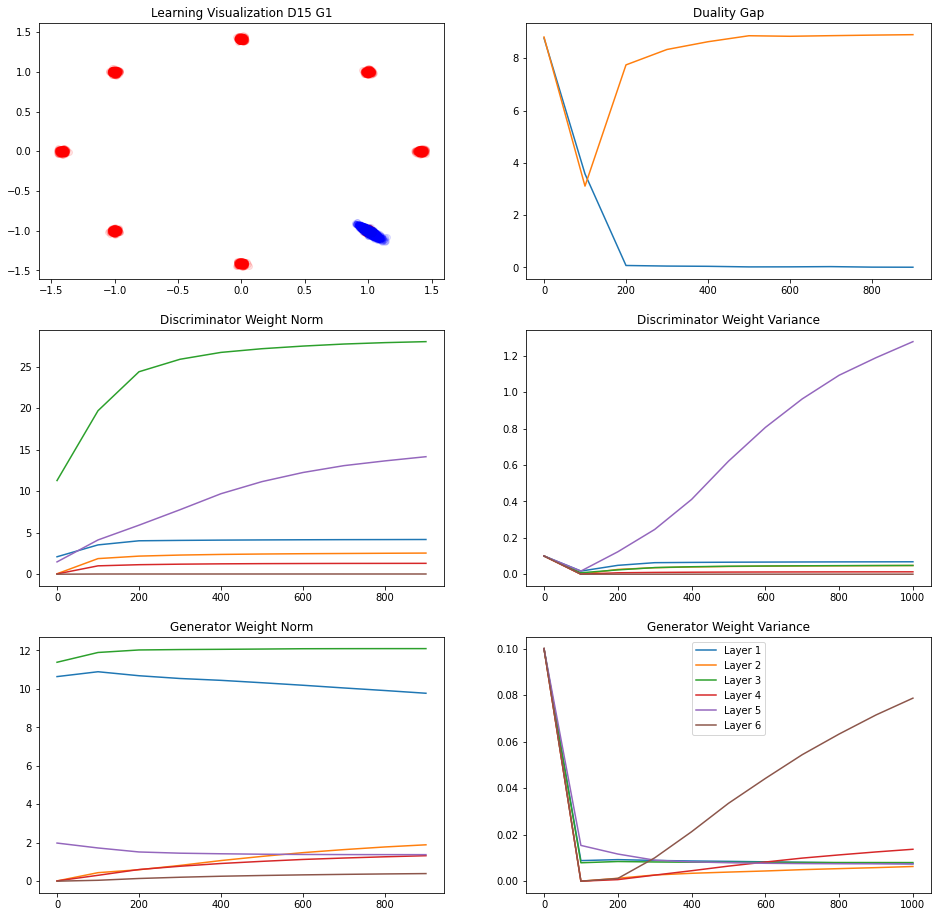

249/250 [============================>.] - ETA: 0sIteration : 1000 [D loss: 0.211906, acc.: 91.80%] [G loss: 3.622660]
Vanilla   Duality GAP :  0.021333843
L Random  Duality Gap :  8.936401


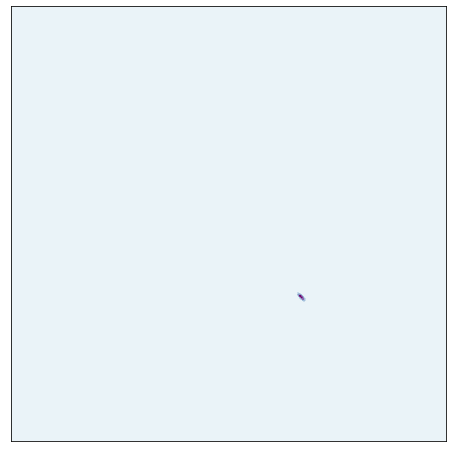

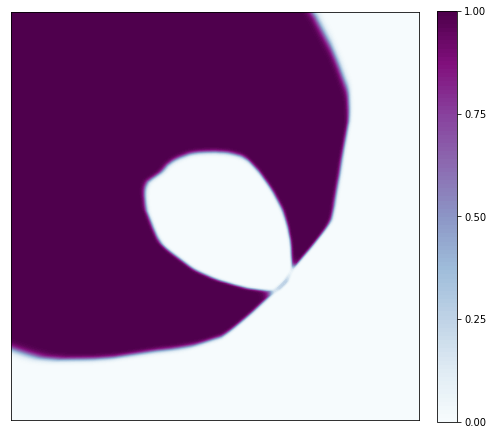

246/250 [============================>.] - ETA: 0sIteration : 1100 [D loss: 0.195204, acc.: 91.80%] [G loss: 3.749369]
Vanilla   Duality GAP :  0.012033135
L Random  Duality Gap :  8.965731


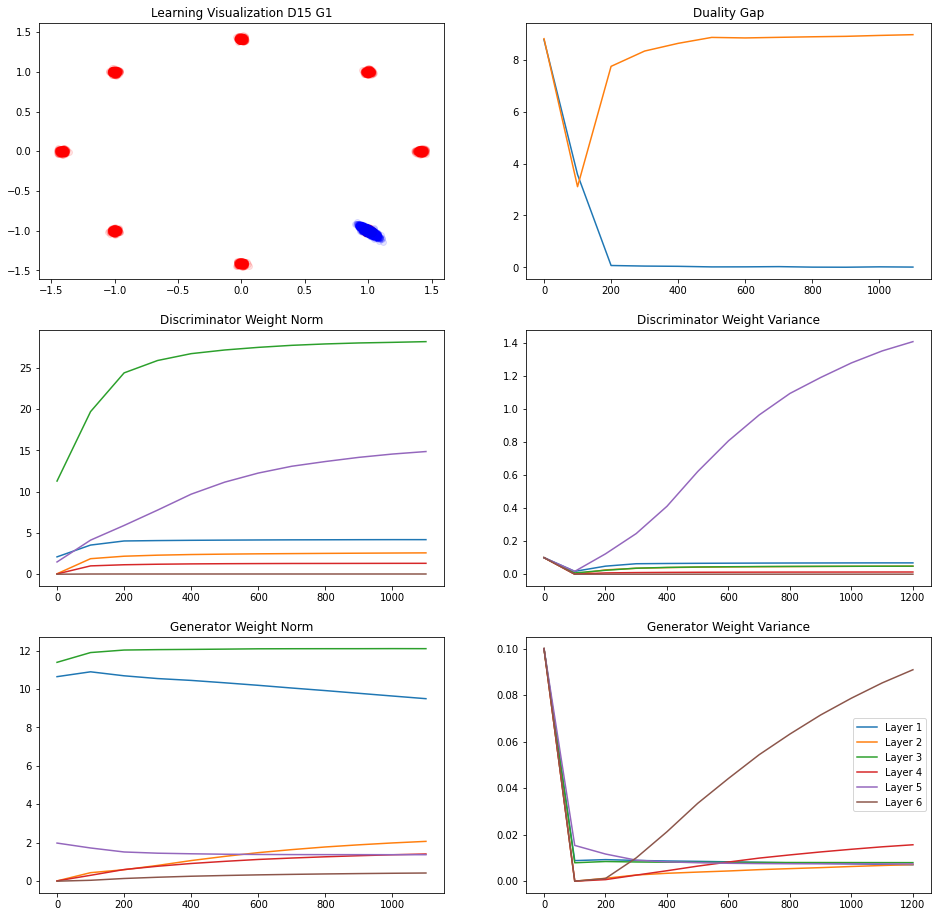

245/250 [============================>.] - ETA: 0sIteration : 1200 [D loss: 0.160120, acc.: 94.53%] [G loss: 3.076480]
Vanilla   Duality GAP :  0.011859864
L Random  Duality Gap :  8.855141


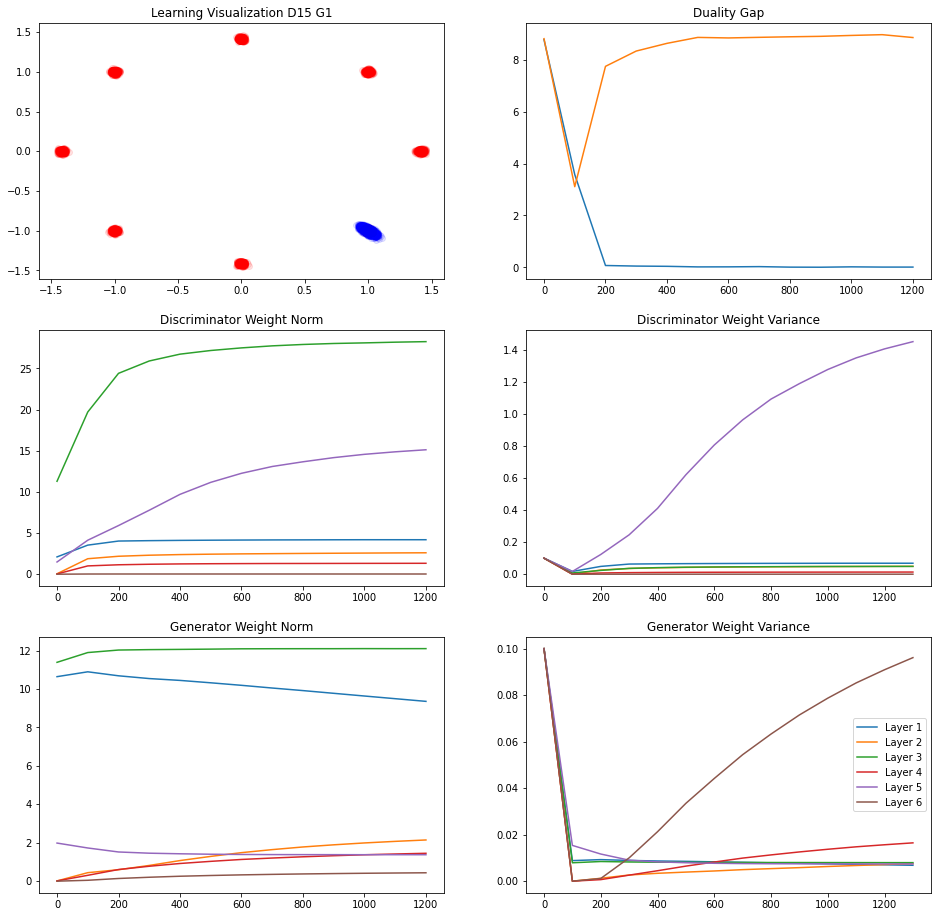

249/250 [============================>.] - ETA: 0sIteration : 1300 [D loss: 0.119585, acc.: 96.09%] [G loss: 4.120081]
Vanilla   Duality GAP :  0.030777454
L Random  Duality Gap :  8.920573


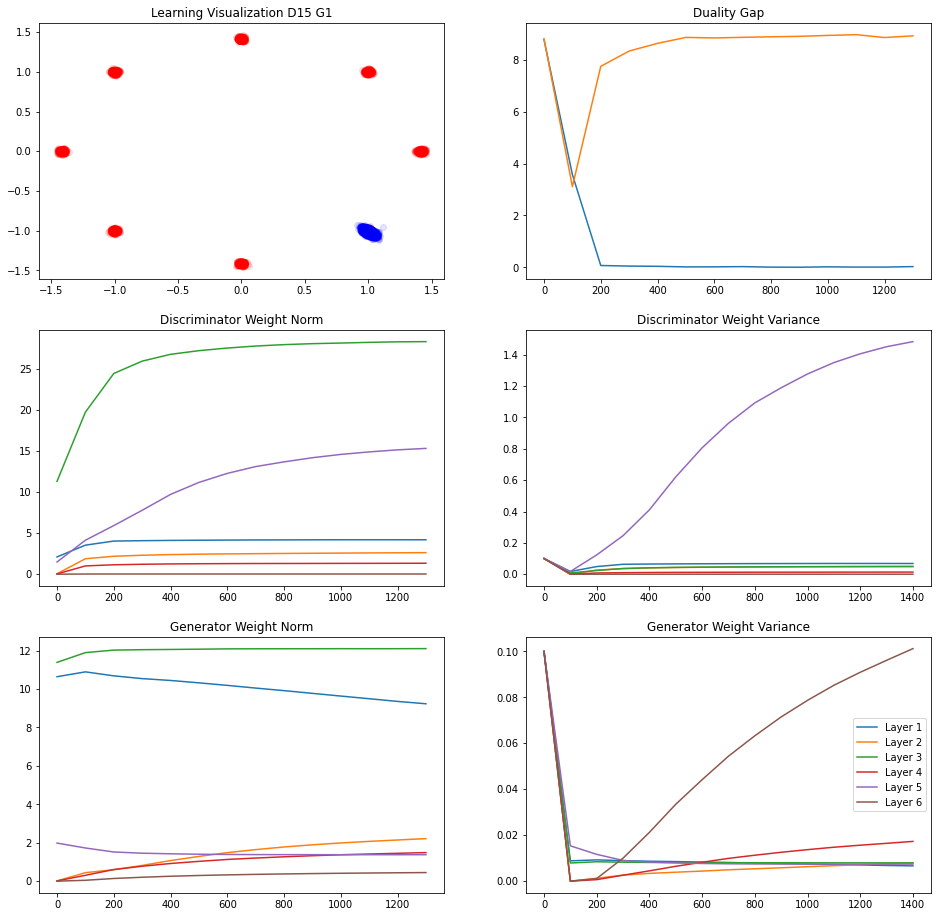

245/250 [============================>.] - ETA: 0sIteration : 1400 [D loss: 0.186168, acc.: 93.75%] [G loss: 2.684635]
Vanilla   Duality GAP :  0.011245072
L Random  Duality Gap :  8.944063


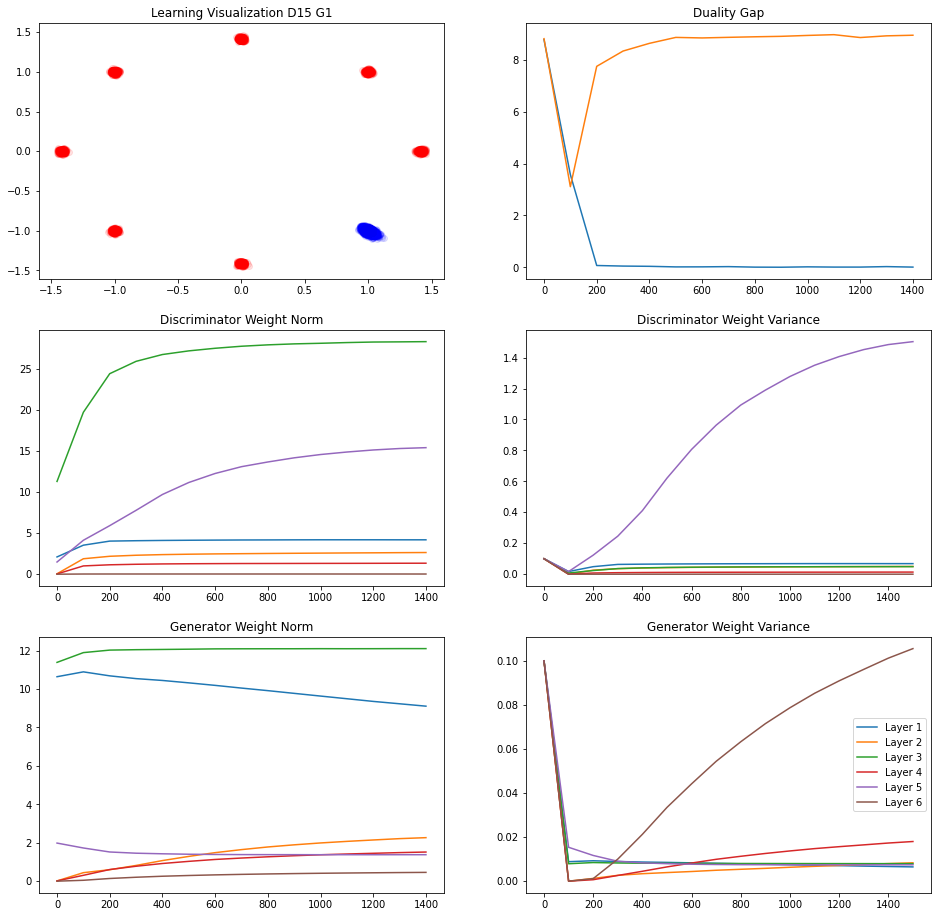

242/250 [============================>.] - ETA: 0sIteration : 1500 [D loss: 0.129376, acc.: 96.09%] [G loss: 2.511755]
Vanilla   Duality GAP :  0.013625741
L Random  Duality Gap :  8.875566


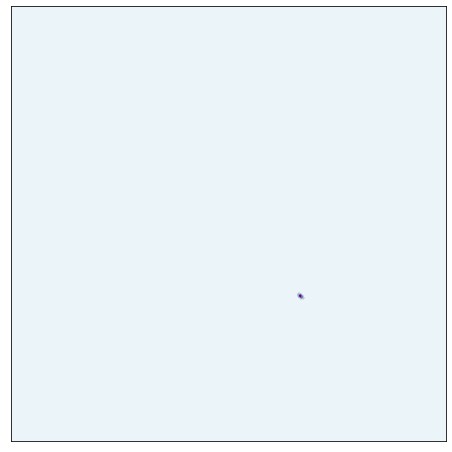

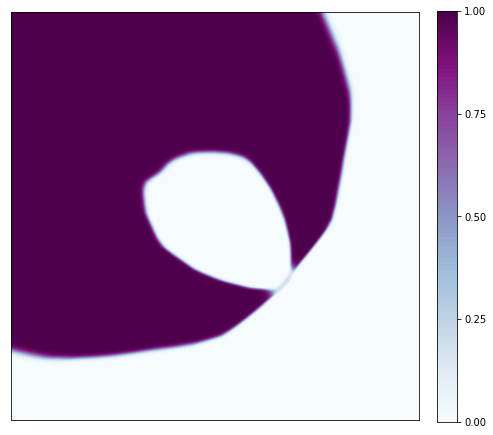

247/250 [============================>.] - ETA: 0sIteration : 1600 [D loss: 0.198366, acc.: 92.58%] [G loss: 3.007482]
Vanilla   Duality GAP :  0.0298177
L Random  Duality Gap :  9.030049


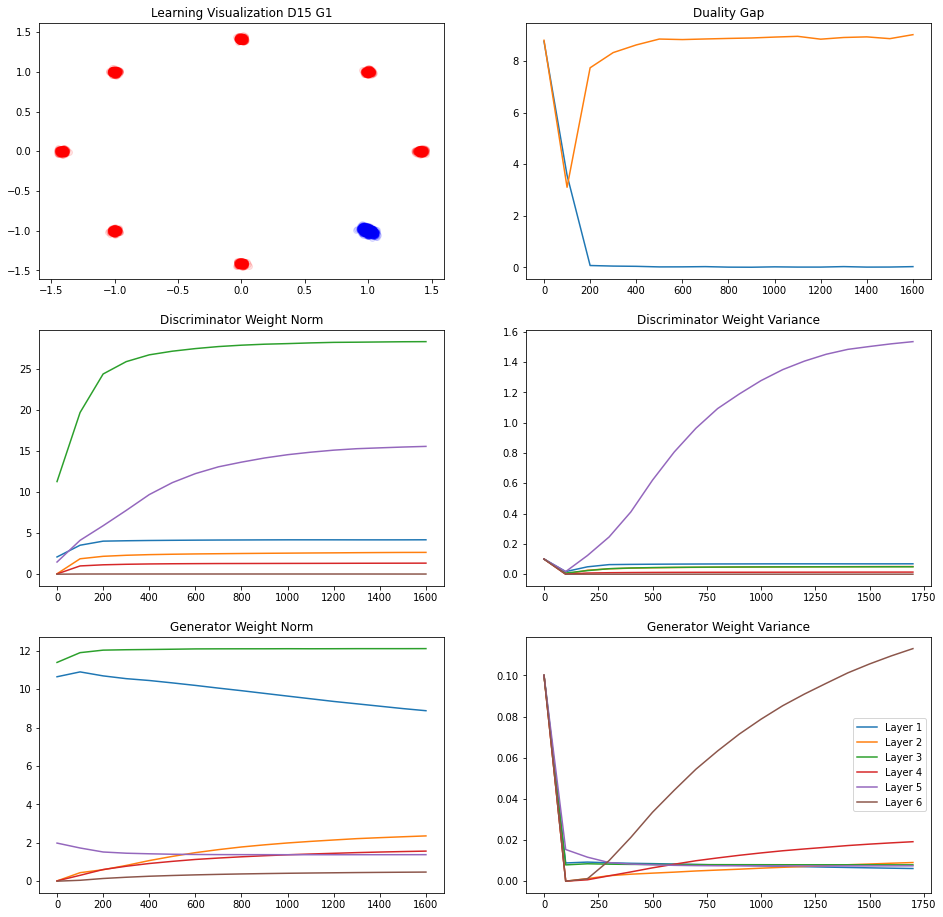

245/250 [============================>.] - ETA: 0sIteration : 1700 [D loss: 0.230276, acc.: 92.19%] [G loss: 2.892266]
Vanilla   Duality GAP :  0.028758615
L Random  Duality Gap :  8.9406805


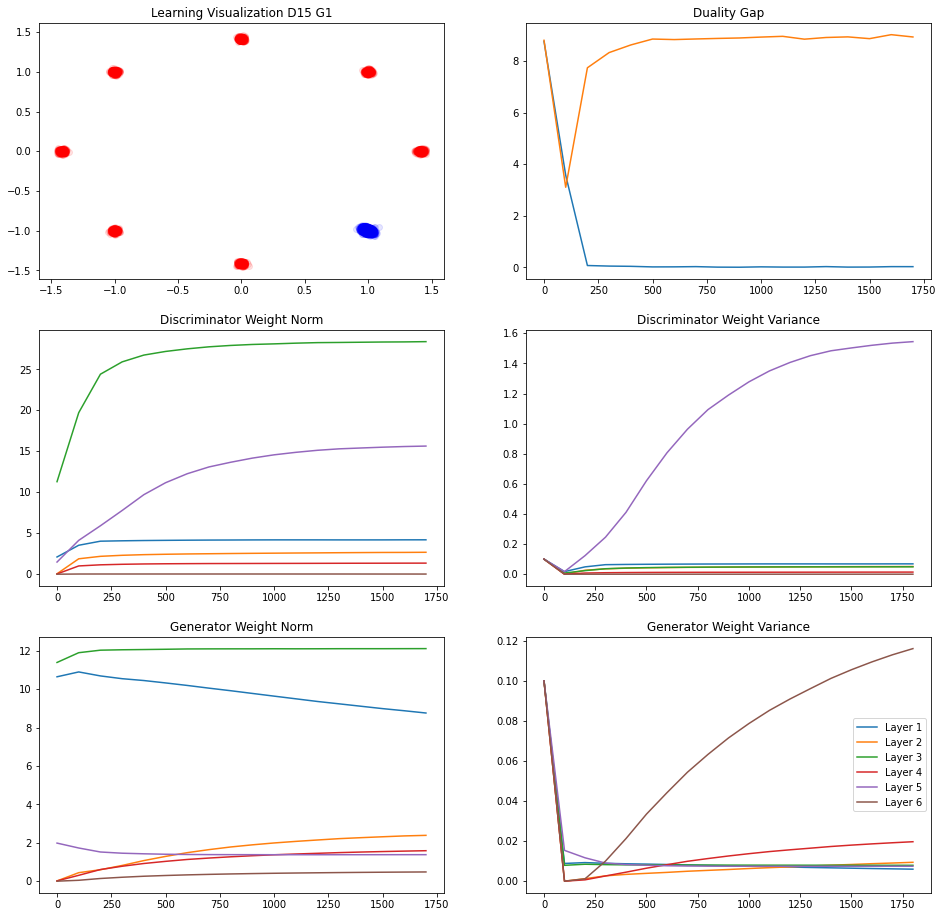

240/250 [===========================>..] - ETA: 0sIteration : 1800 [D loss: 0.207471, acc.: 92.97%] [G loss: 2.591964]
Vanilla   Duality GAP :  0.01490584
L Random  Duality Gap :  9.02427


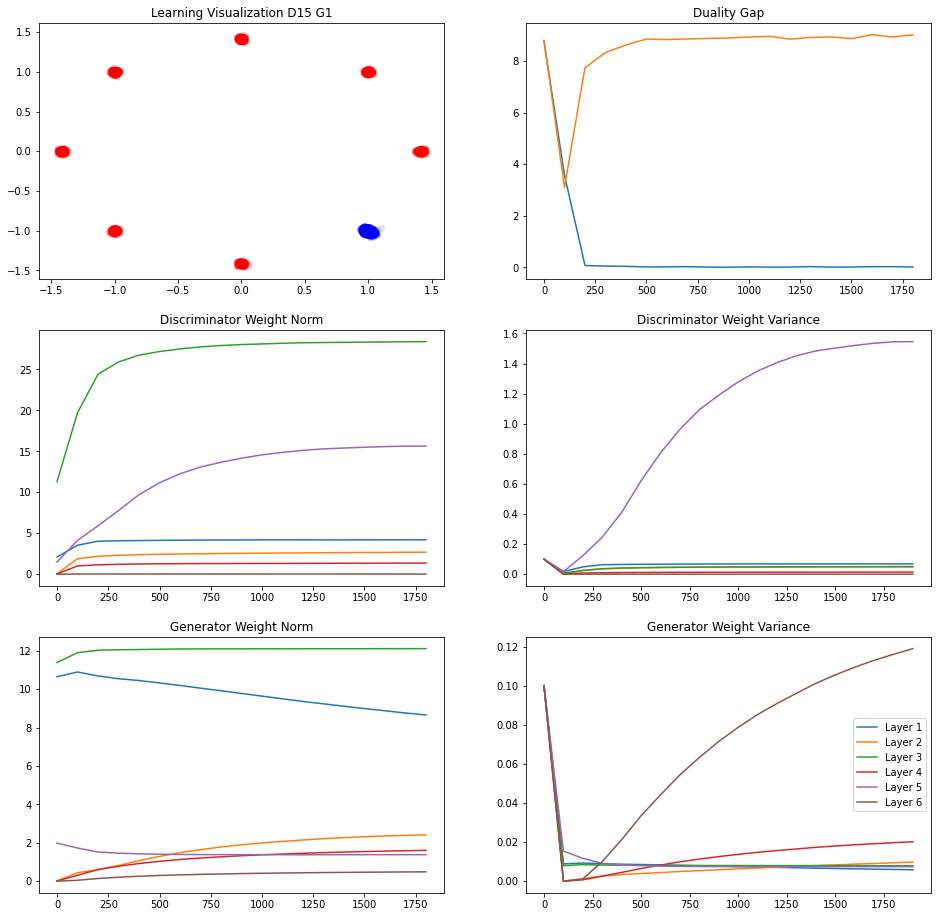

238/250 [===========================>..] - ETA: 0sIteration : 1900 [D loss: 0.129296, acc.: 95.70%] [G loss: 3.328013]
Vanilla   Duality GAP :  -0.00070258975
L Random  Duality Gap :  9.005487


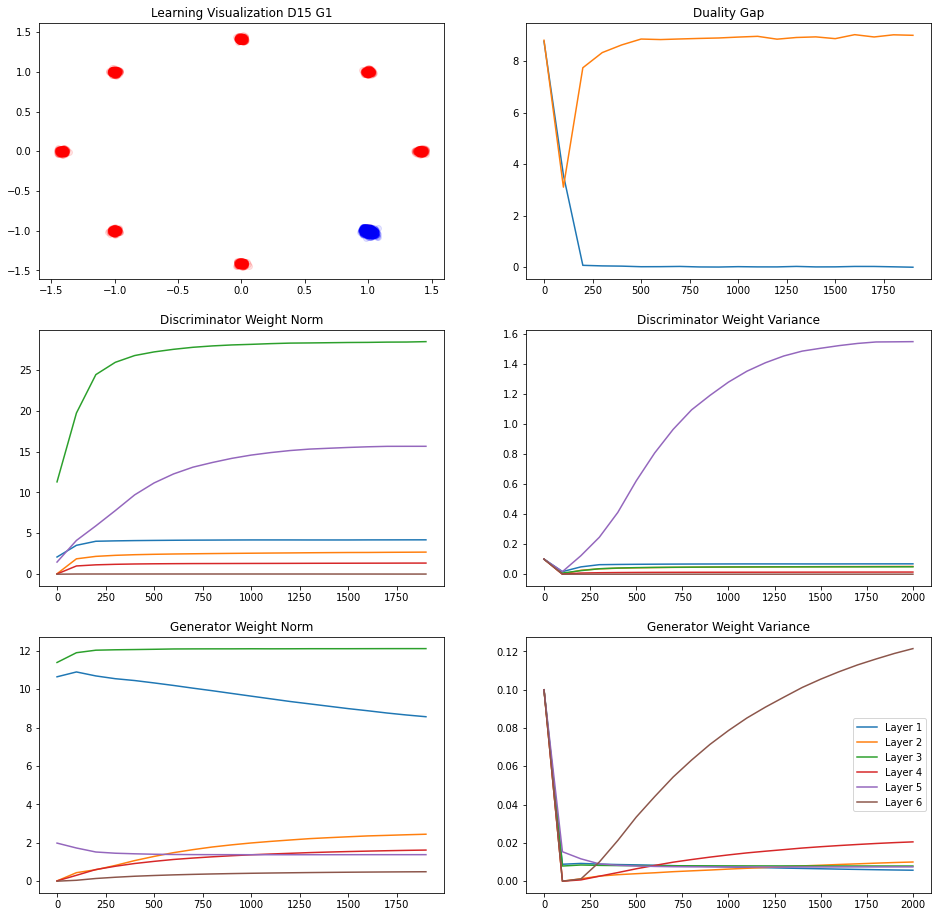

239/250 [===========================>..] - ETA: 0sIteration : 2000 [D loss: 0.123531, acc.: 96.48%] [G loss: 2.644261]
Vanilla   Duality GAP :  0.036870003
L Random  Duality Gap :  9.054888


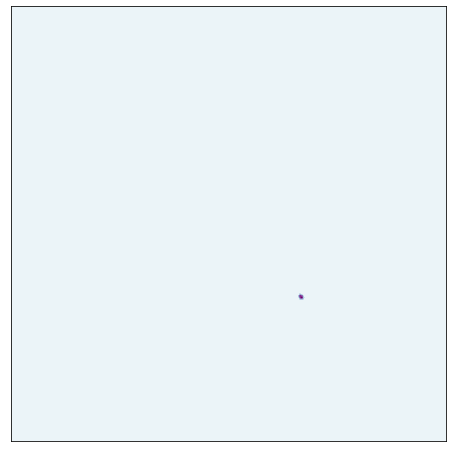

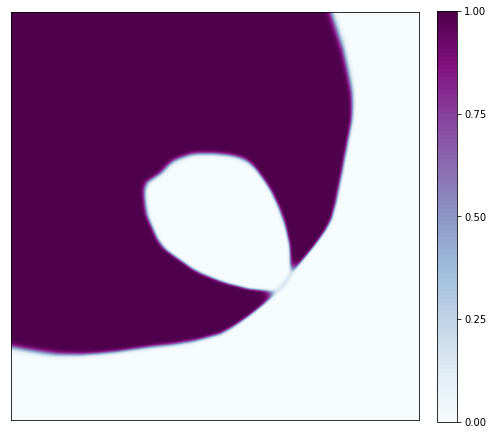

246/250 [============================>.] - ETA: 0sIteration : 2100 [D loss: 0.187893, acc.: 94.14%] [G loss: 2.352304]
Vanilla   Duality GAP :  0.005462885
L Random  Duality Gap :  9.021831


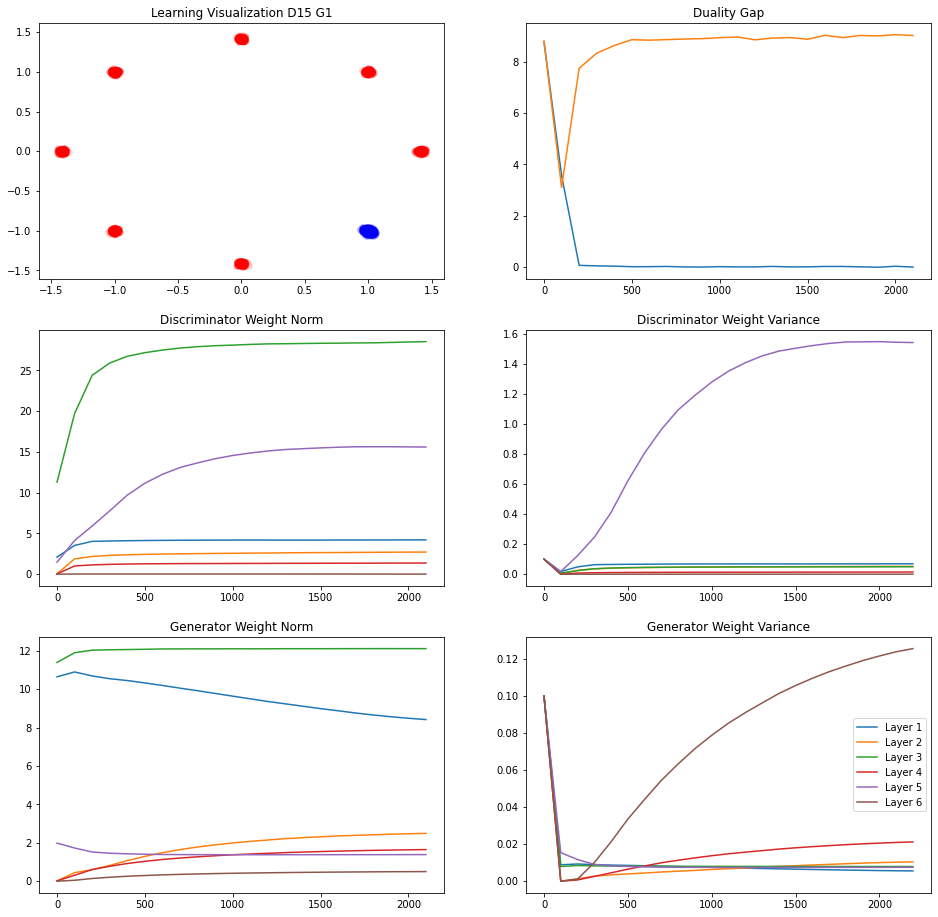

243/250 [============================>.] - ETA: 0sIteration : 2200 [D loss: 0.188603, acc.: 93.36%] [G loss: 2.498140]
Vanilla   Duality GAP :  0.042905807
L Random  Duality Gap :  9.078264


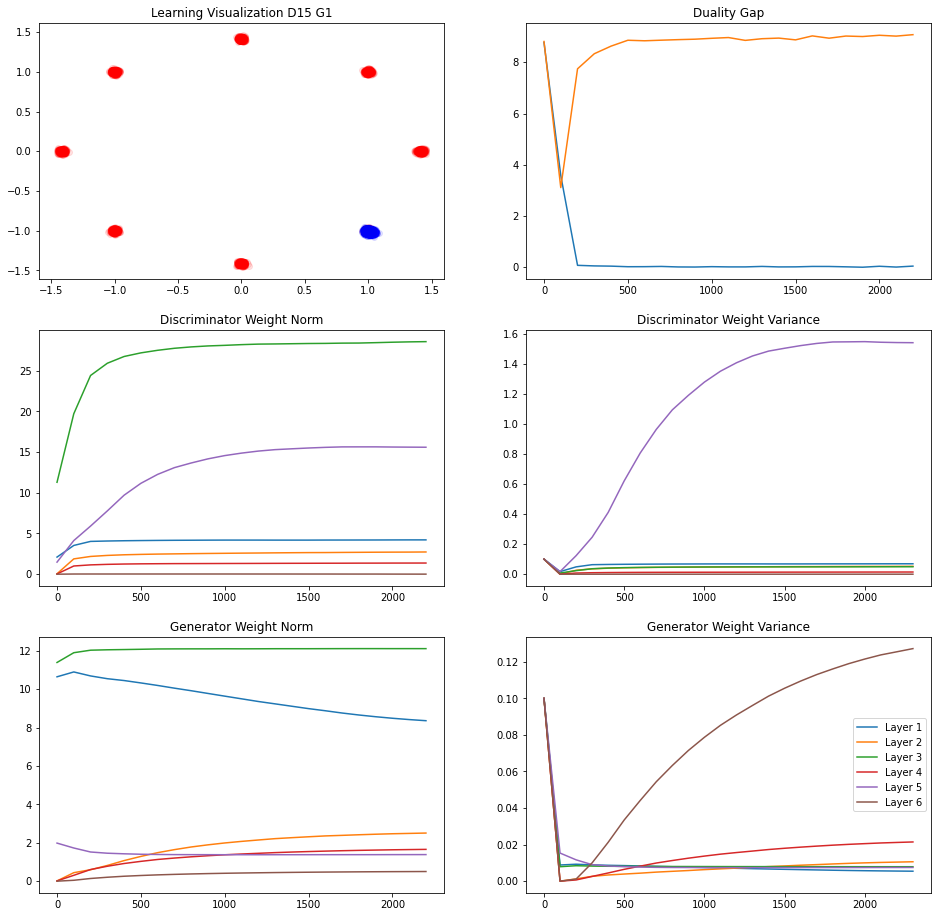

245/250 [============================>.] - ETA: 0sIteration : 2300 [D loss: 0.203838, acc.: 93.36%] [G loss: 2.177272]
Vanilla   Duality GAP :  0.005562395
L Random  Duality Gap :  9.037153


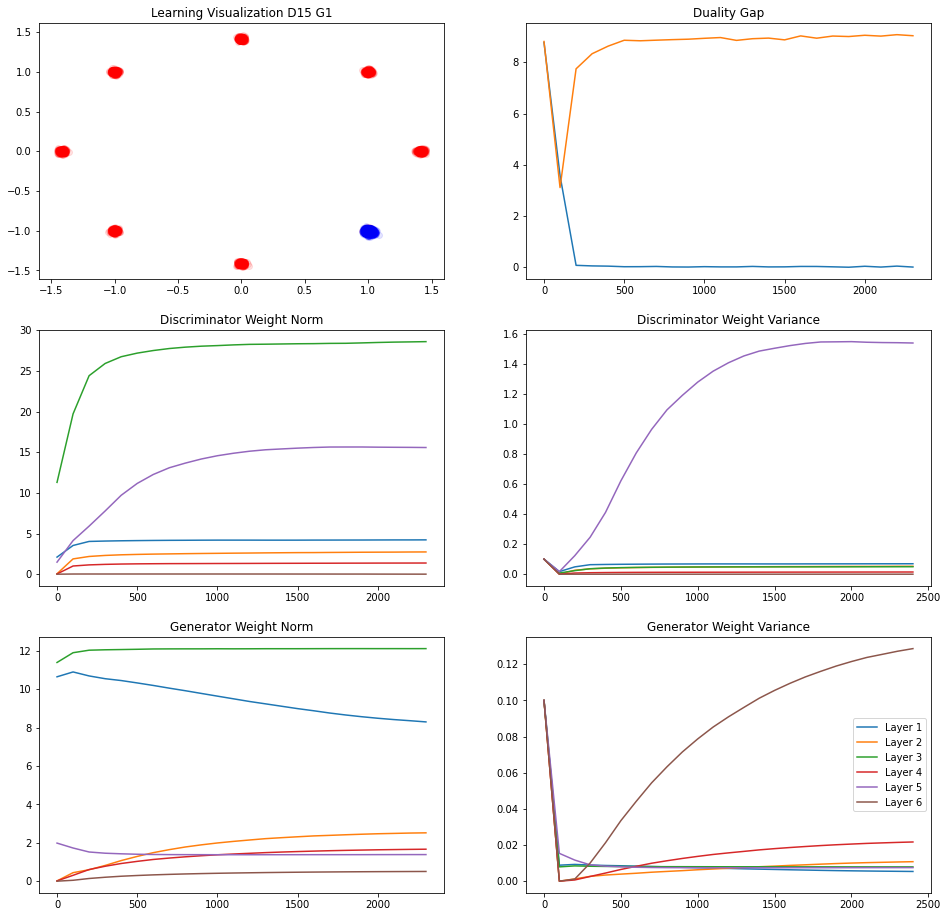

245/250 [============================>.] - ETA: 0sIteration : 2400 [D loss: 0.186735, acc.: 94.53%] [G loss: 2.155819]
Vanilla   Duality GAP :  0.010320902
L Random  Duality Gap :  8.96672


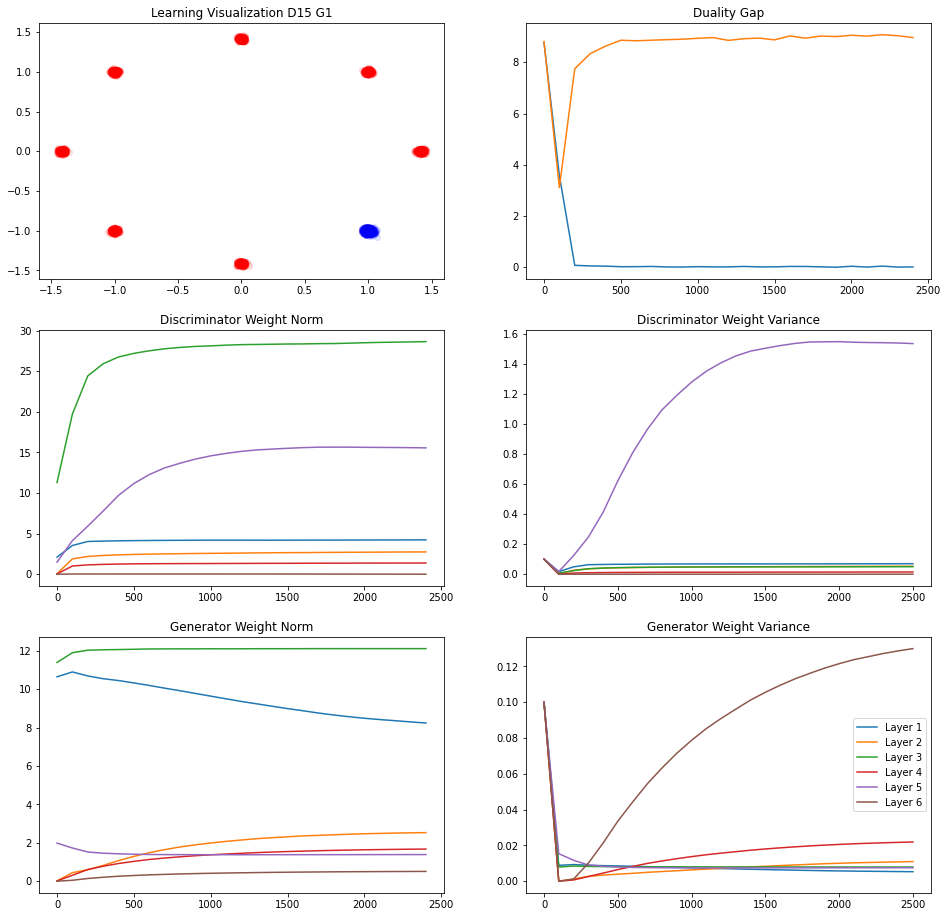

238/250 [===========================>..] - ETA: 0sIteration : 2500 [D loss: 0.190017, acc.: 94.14%] [G loss: 2.278907]
Vanilla   Duality GAP :  0.0032147467
L Random  Duality Gap :  9.051653


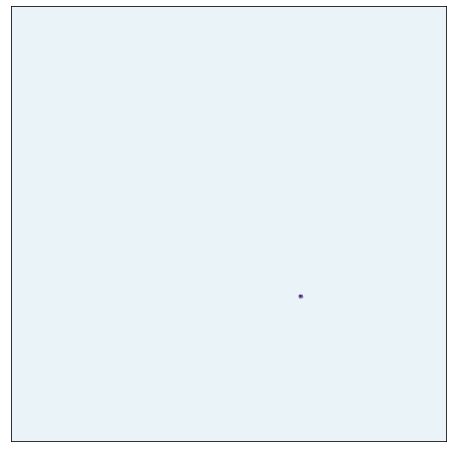

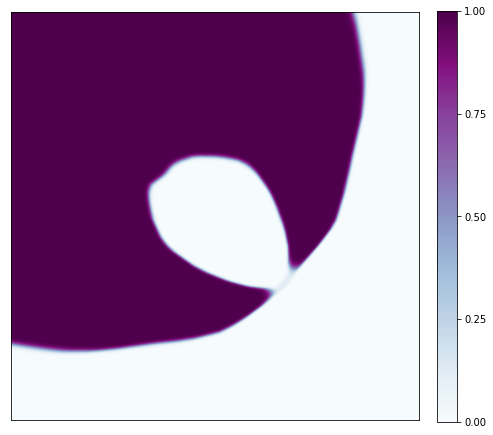

249/250 [============================>.] - ETA: 0sIteration : 2600 [D loss: 0.176057, acc.: 94.92%] [G loss: 2.606333]
Vanilla   Duality GAP :  0.054609656
L Random  Duality Gap :  8.898857


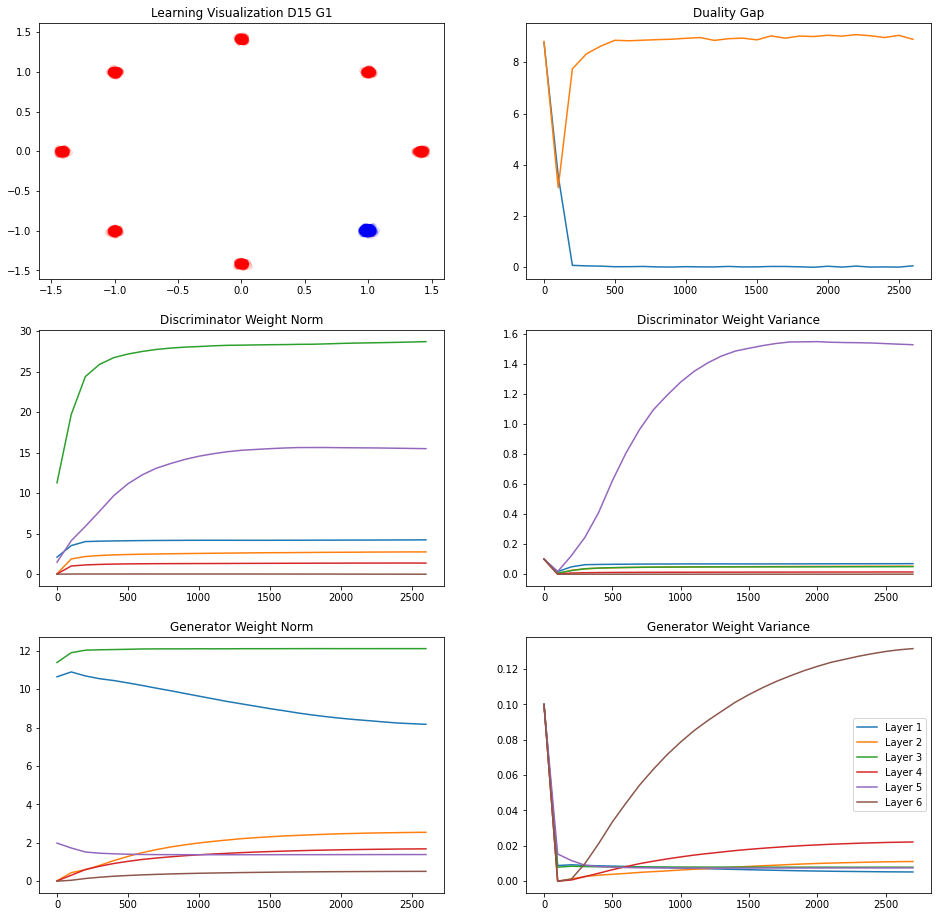

242/250 [============================>.] - ETA: 0sIteration : 2700 [D loss: 0.208727, acc.: 92.97%] [G loss: 2.291401]
Vanilla   Duality GAP :  0.036170155
L Random  Duality Gap :  9.0217


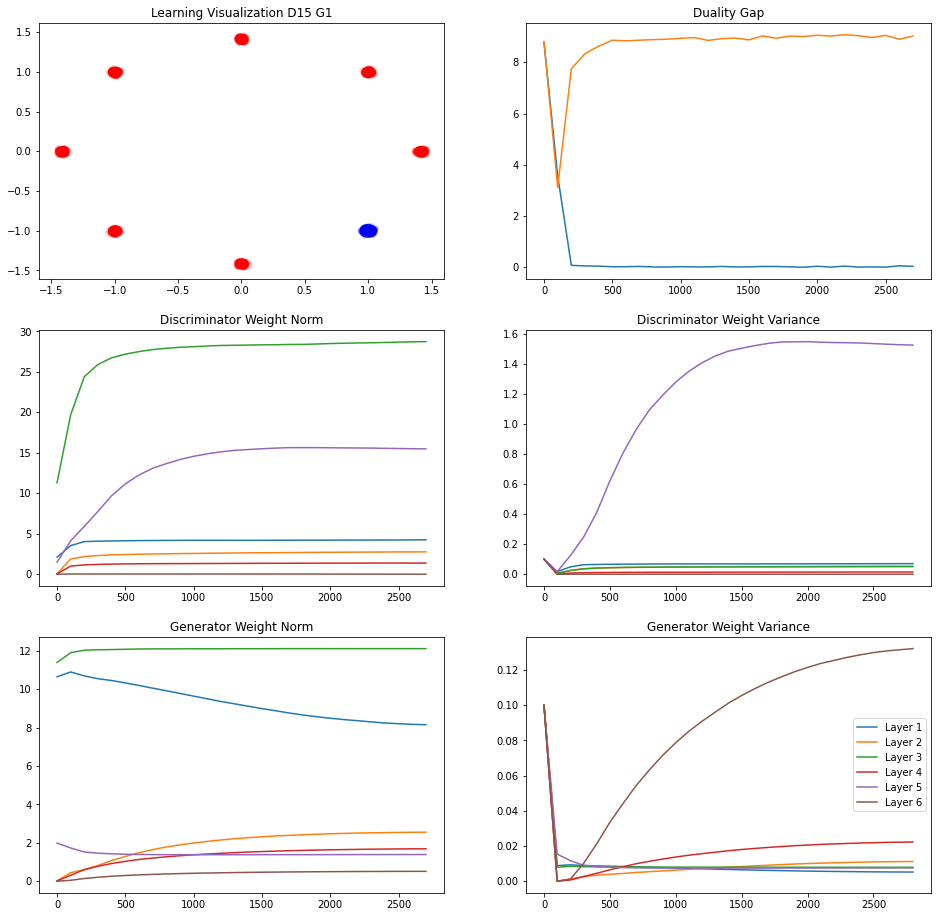

236/250 [===========================>..] - ETA: 0sIteration : 2800 [D loss: 0.137688, acc.: 96.48%] [G loss: 2.207635]
Vanilla   Duality GAP :  0.0017334521
L Random  Duality Gap :  9.083383


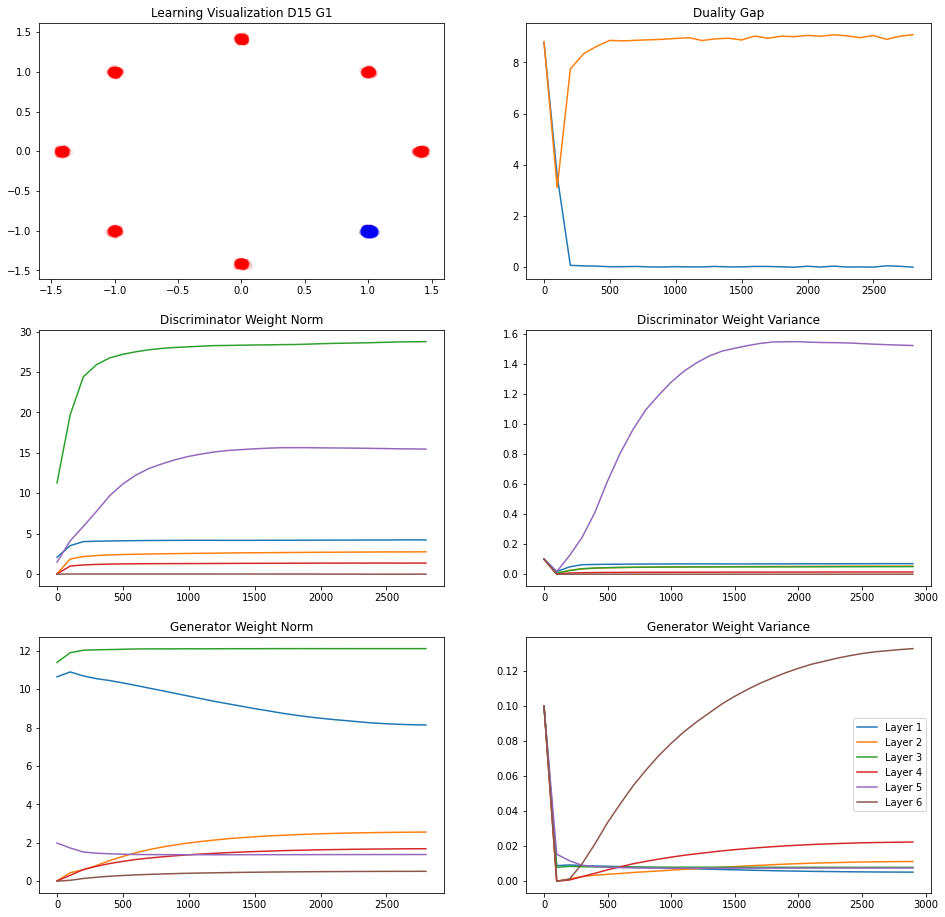

245/250 [============================>.] - ETA: 0sIteration : 2900 [D loss: 0.238812, acc.: 91.80%] [G loss: 2.202264]
Vanilla   Duality GAP :  -0.002468735
L Random  Duality Gap :  9.077092


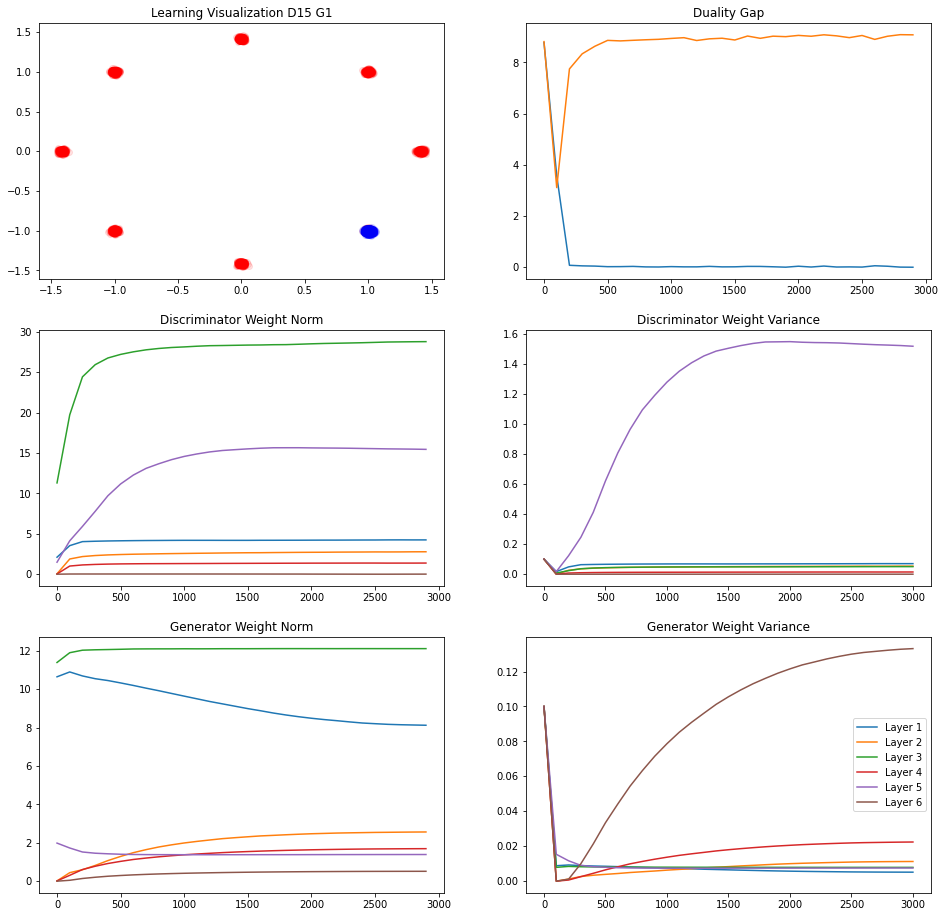

242/250 [============================>.] - ETA: 0sIteration : 3000 [D loss: 0.161635, acc.: 95.31%] [G loss: 2.183850]
Vanilla   Duality GAP :  0.01444906
L Random  Duality Gap :  9.011867


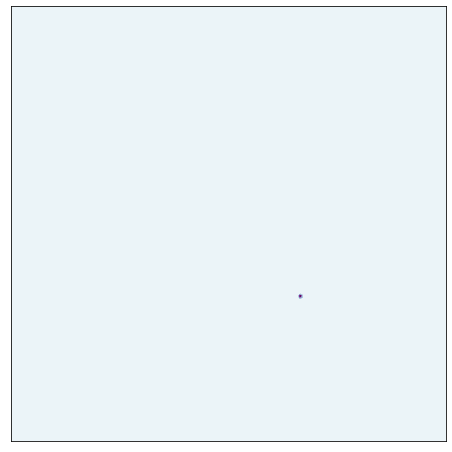

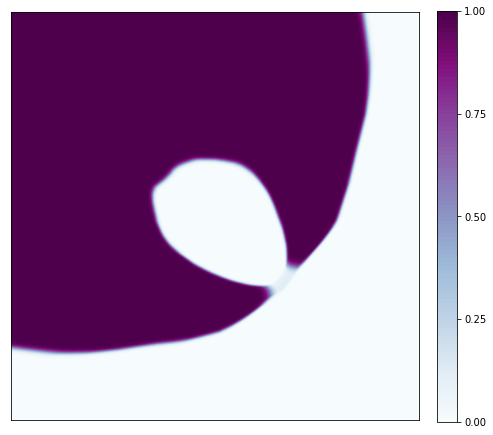

249/250 [============================>.] - ETA: 0sIteration : 3100 [D loss: 0.188033, acc.: 94.14%] [G loss: 2.233273]
Vanilla   Duality GAP :  0.0041383803
L Random  Duality Gap :  9.059349


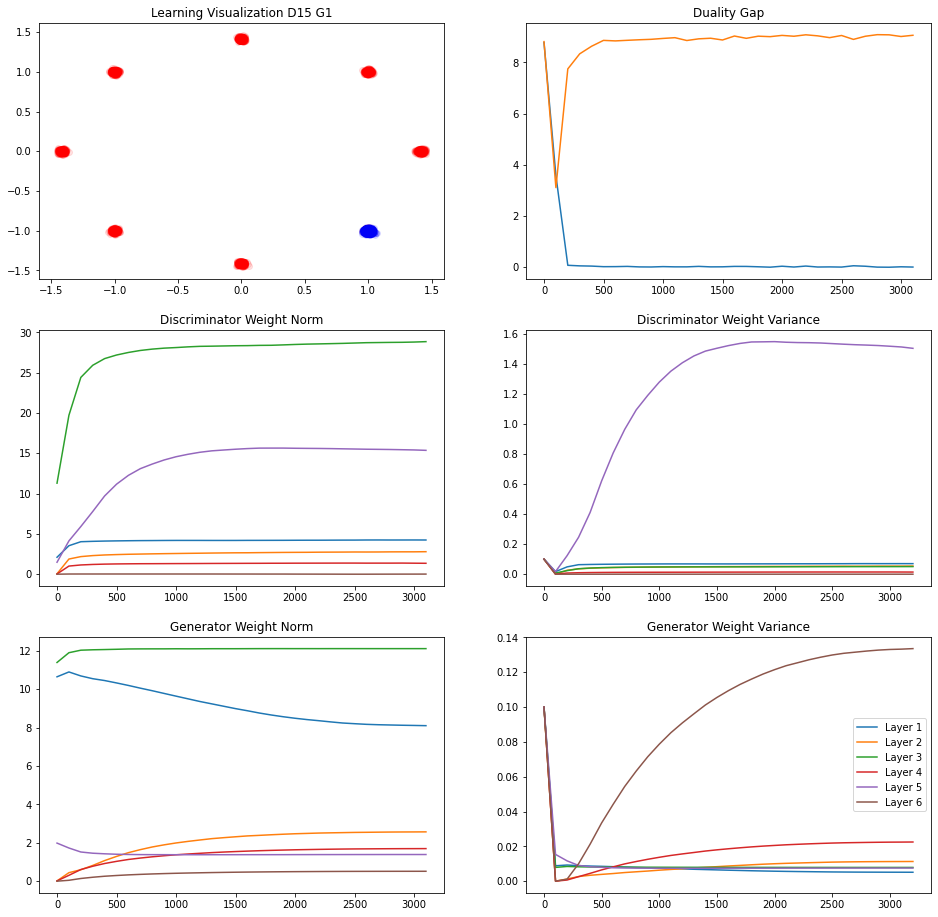

239/250 [===========================>..] - ETA: 0sIteration : 3200 [D loss: 0.211808, acc.: 92.97%] [G loss: 2.270355]
Vanilla   Duality GAP :  3.5017486
L Random  Duality Gap :  9.032981


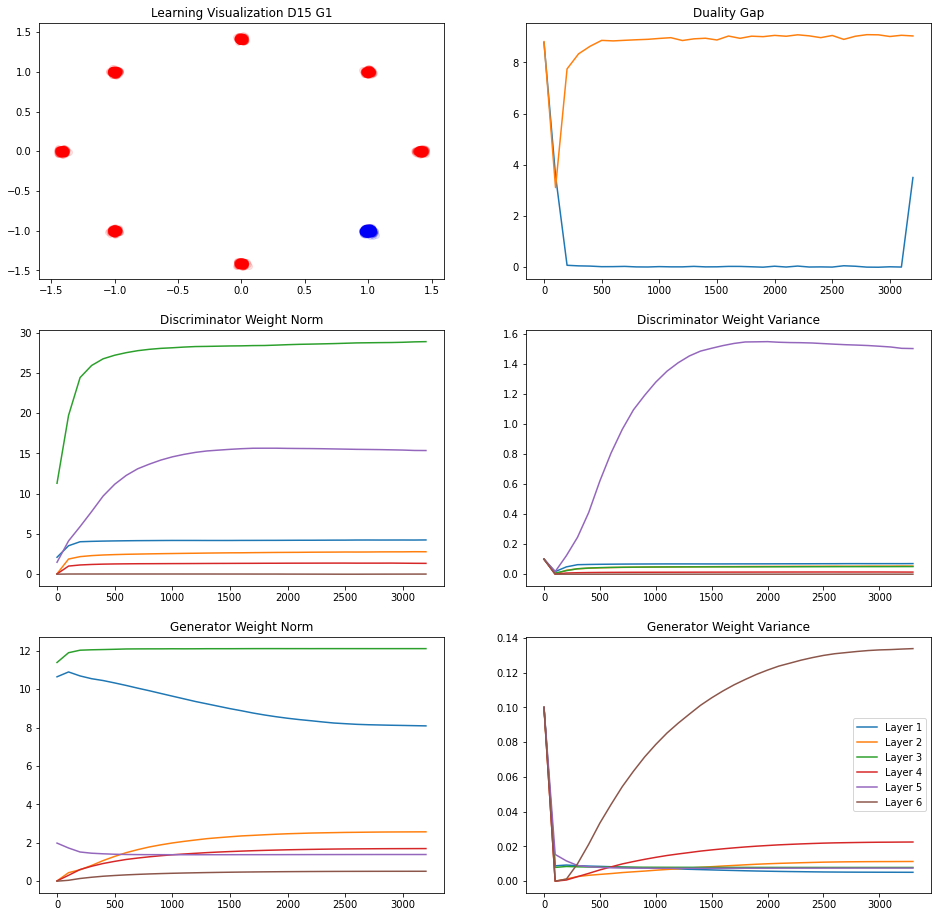

242/250 [============================>.] - ETA: 0sIteration : 3300 [D loss: 0.187820, acc.: 94.14%] [G loss: 2.331184]
Vanilla   Duality GAP :  0.00973165
L Random  Duality Gap :  9.021985


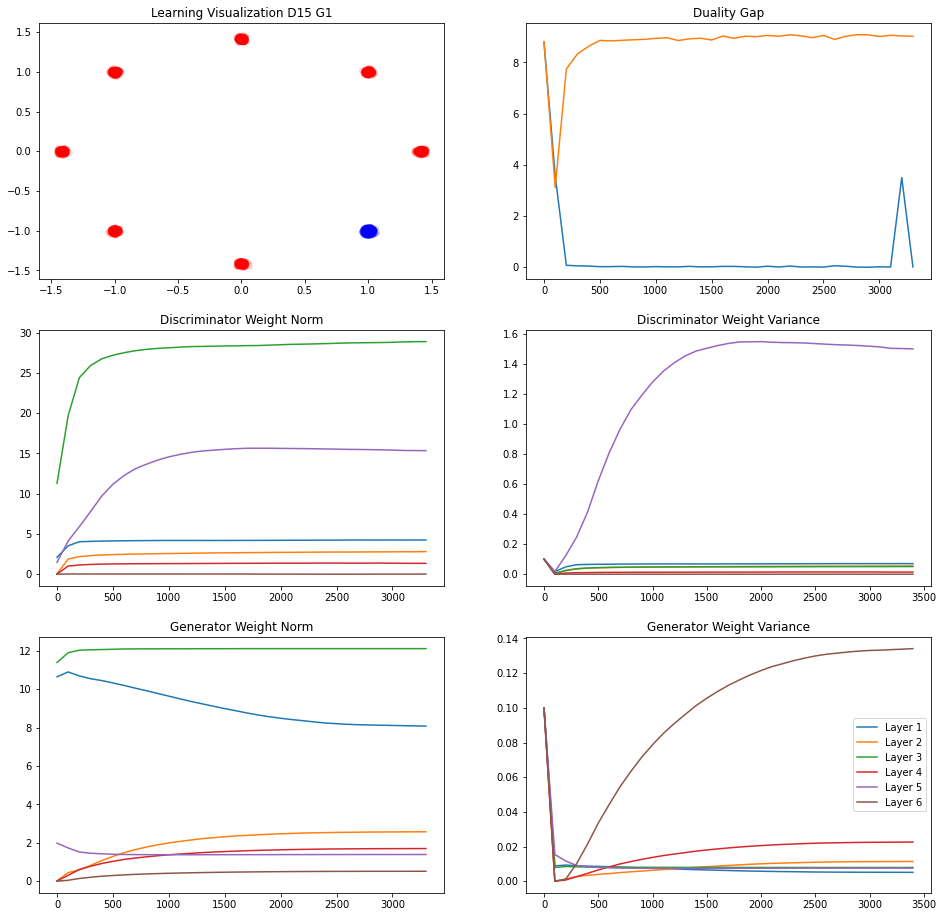

247/250 [============================>.] - ETA: 0sIteration : 3400 [D loss: 0.230533, acc.: 92.19%] [G loss: 2.154202]
Vanilla   Duality GAP :  0.014064521
L Random  Duality Gap :  9.025982


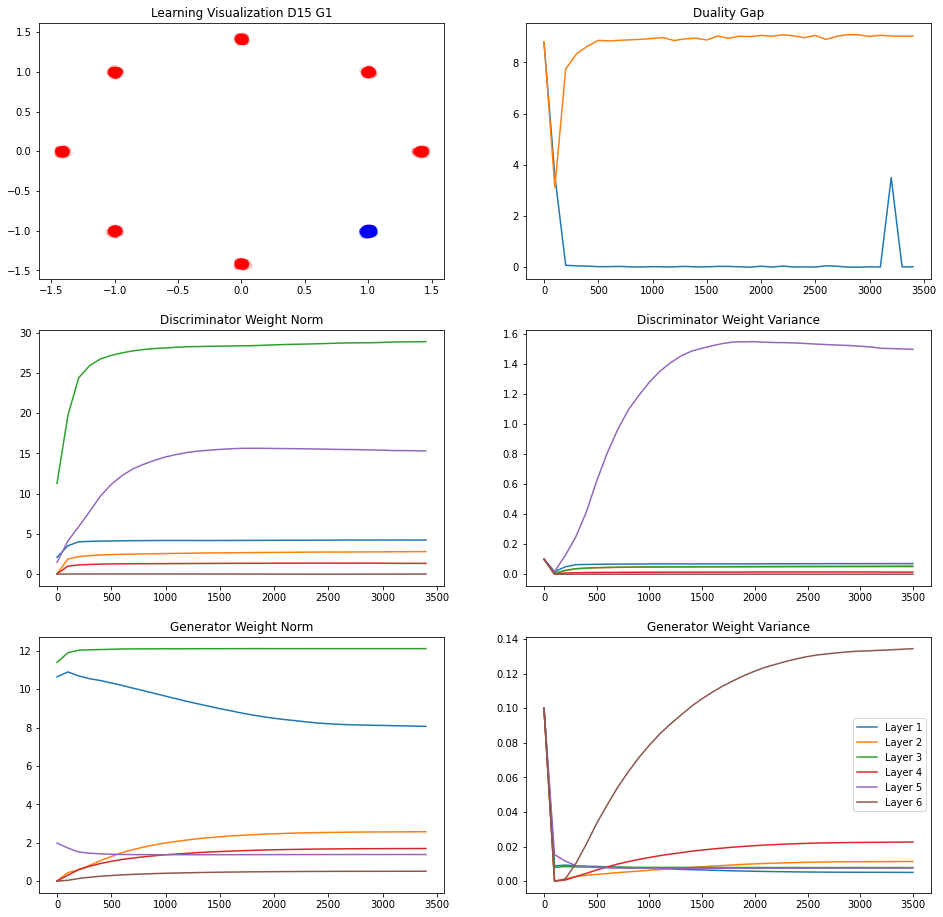

247/250 [============================>.] - ETA: 0sIteration : 3500 [D loss: 0.188307, acc.: 94.14%] [G loss: 2.206197]
Vanilla   Duality GAP :  0.012871683
L Random  Duality Gap :  8.871286


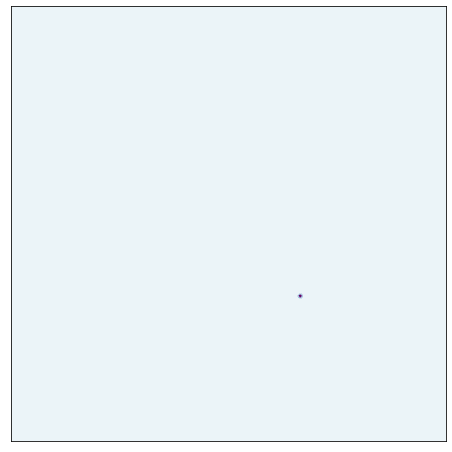

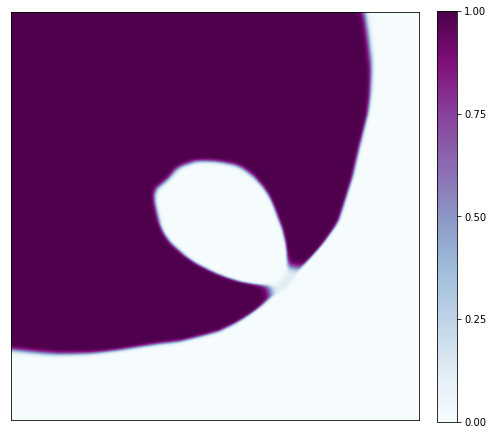

247/250 [============================>.] - ETA: 0sIteration : 3600 [D loss: 0.187631, acc.: 94.14%] [G loss: 2.187288]
Vanilla   Duality GAP :  0.0075652897
L Random  Duality Gap :  9.083093


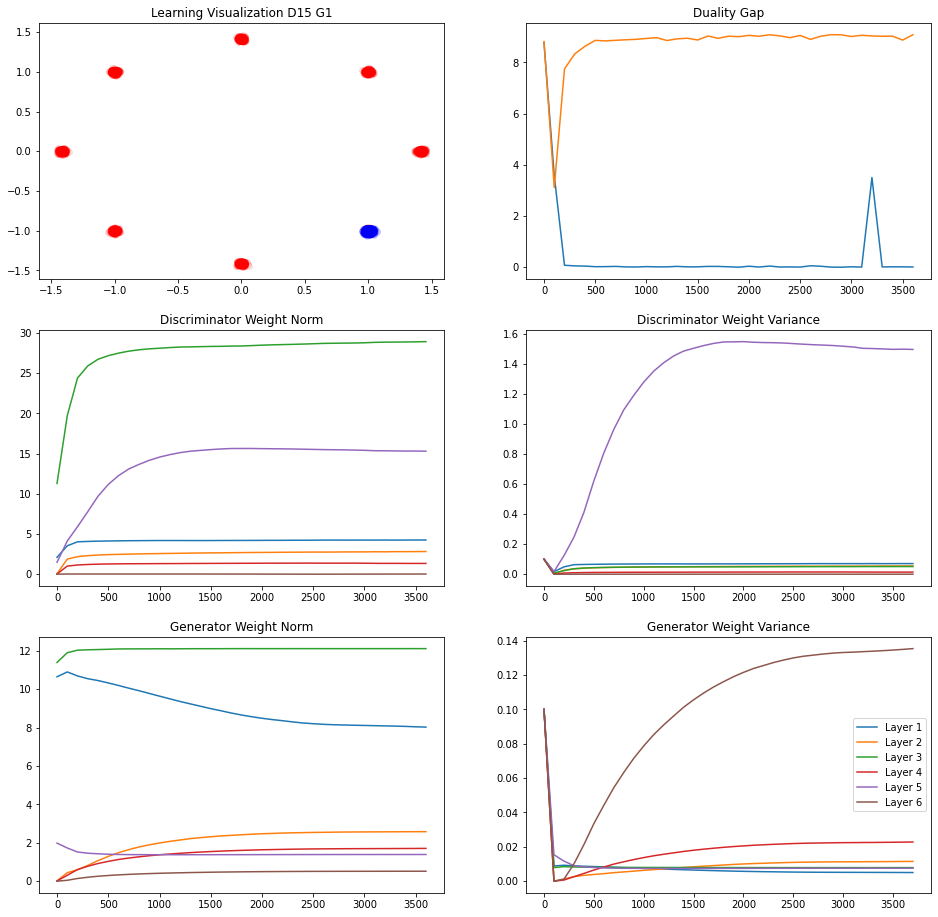

237/250 [===========================>..] - ETA: 0sIteration : 3700 [D loss: 0.222364, acc.: 92.58%] [G loss: 2.234726]
Vanilla   Duality GAP :  0.08514896
L Random  Duality Gap :  8.918095


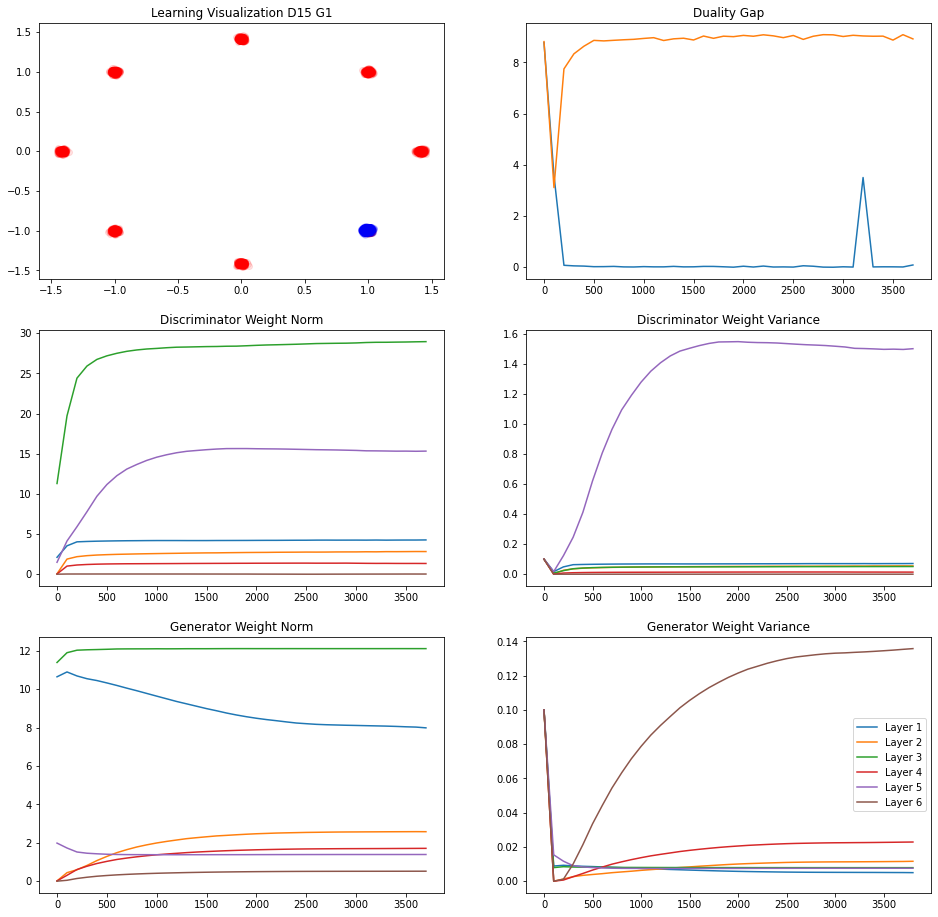

247/250 [============================>.] - ETA: 0sIteration : 3800 [D loss: 0.199334, acc.: 94.14%] [G loss: 2.397547]
Vanilla   Duality GAP :  0.06956282
L Random  Duality Gap :  9.033412


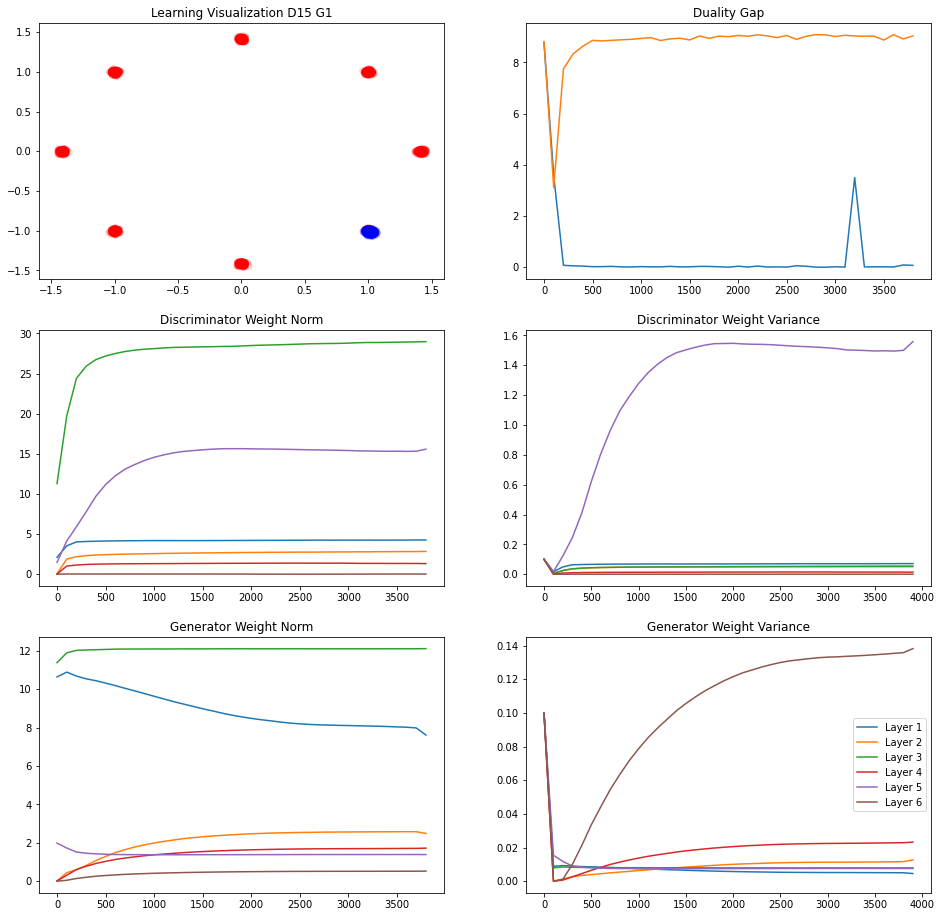

249/250 [============================>.] - ETA: 0sIteration : 3900 [D loss: 0.250109, acc.: 91.41%] [G loss: 2.229508]
Vanilla   Duality GAP :  0.008718252
L Random  Duality Gap :  9.014944


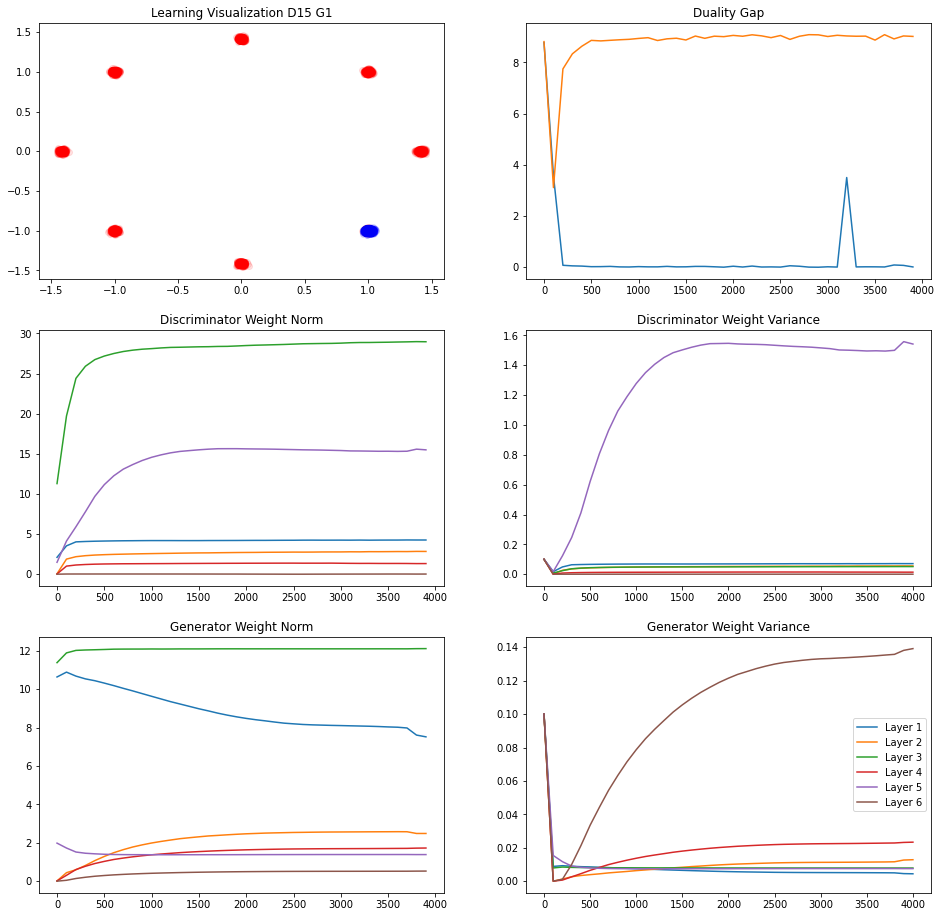

240/250 [===========================>..] - ETA: 0sIteration : 4000 [D loss: 0.224324, acc.: 92.58%] [G loss: 2.271626]
Vanilla   Duality GAP :  0.005582243
L Random  Duality Gap :  9.066053


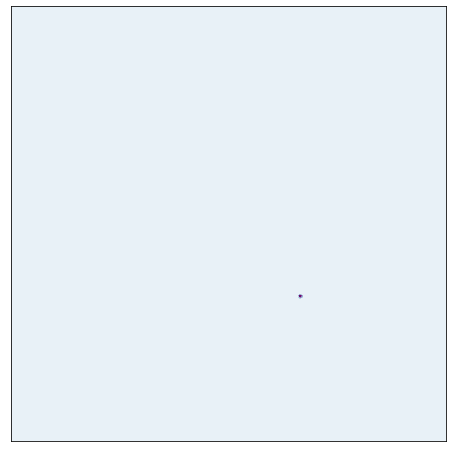

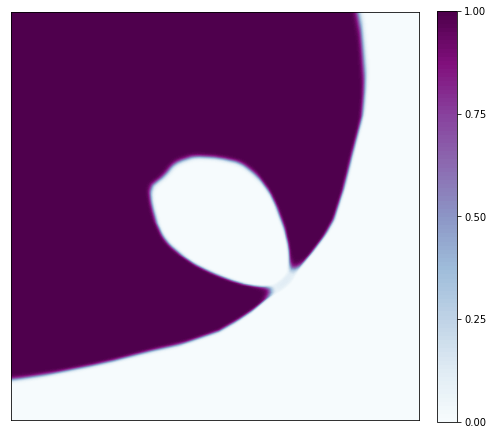

235/250 [===========================>..] - ETA: 0sIteration : 4100 [D loss: 0.225131, acc.: 92.58%] [G loss: 2.189433]
Vanilla   Duality GAP :  0.015287846
L Random  Duality Gap :  9.013351


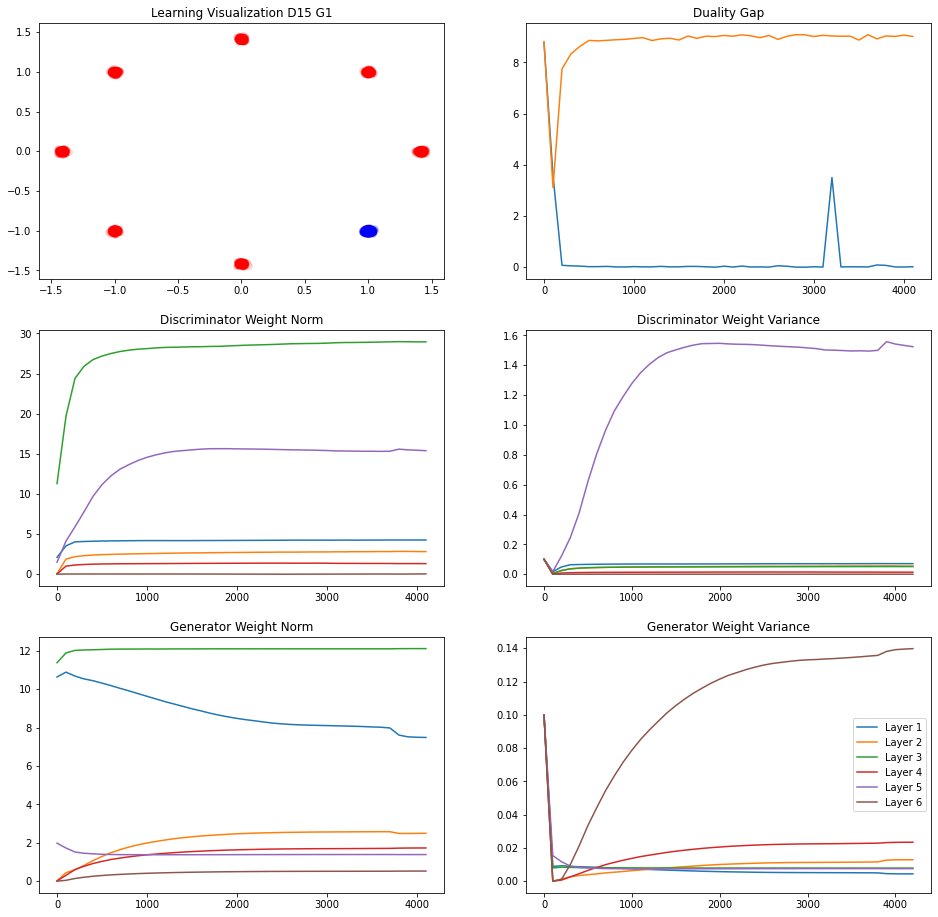

245/250 [============================>.] - ETA: 0sIteration : 4200 [D loss: 0.232653, acc.: 92.19%] [G loss: 2.216034]
Vanilla   Duality GAP :  4.754332
L Random  Duality Gap :  9.043915


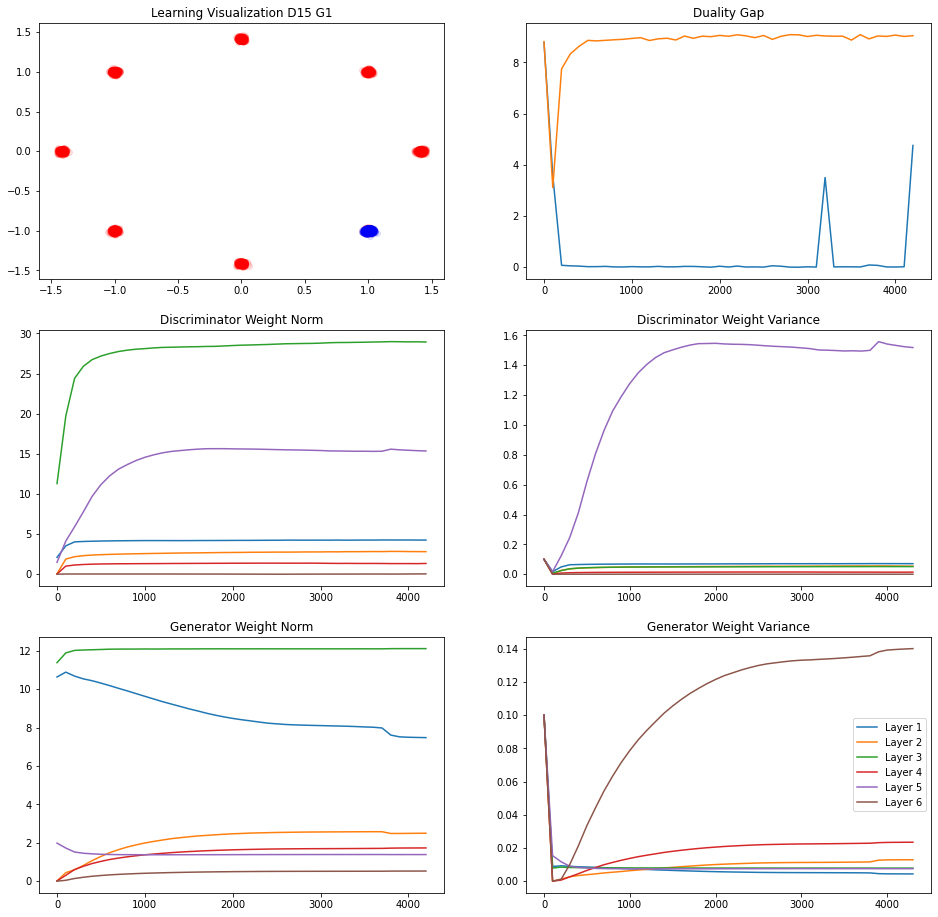

236/250 [===========================>..] - ETA: 0sIteration : 4300 [D loss: 0.188730, acc.: 94.14%] [G loss: 2.256773]
Vanilla   Duality GAP :  0.013667166
L Random  Duality Gap :  9.058112


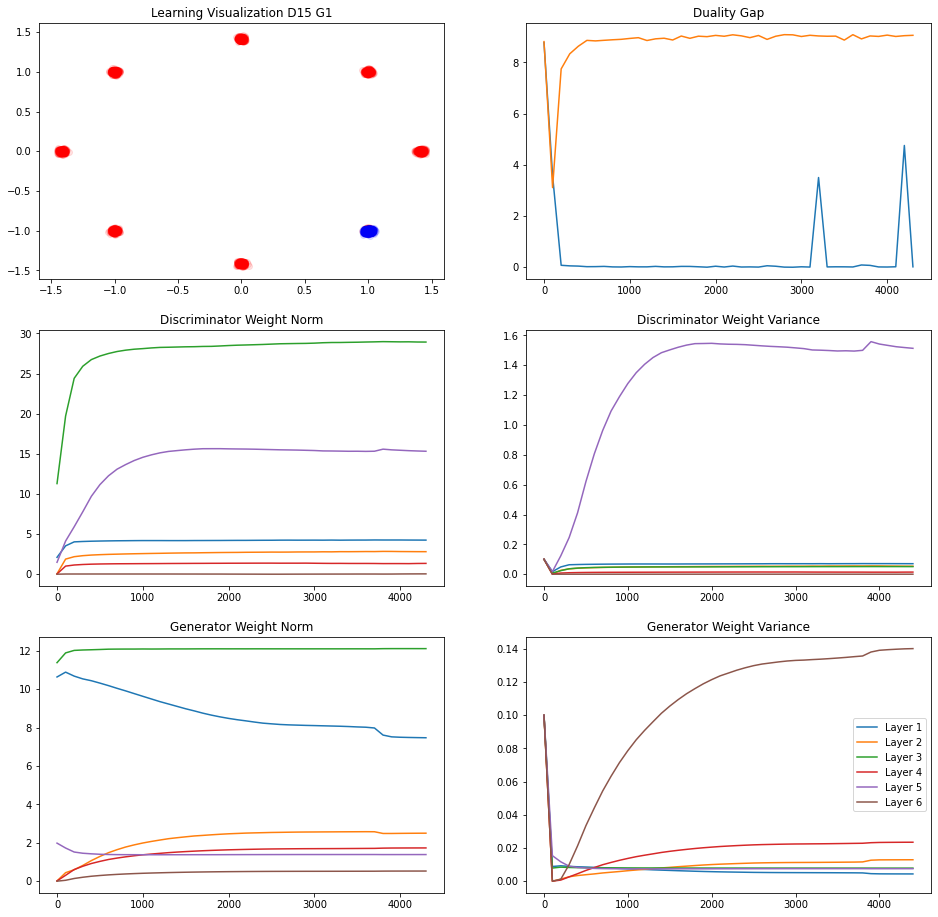

245/250 [============================>.] - ETA: 0sIteration : 4400 [D loss: 0.223683, acc.: 92.58%] [G loss: 2.209601]
Vanilla   Duality GAP :  5.0999646
L Random  Duality Gap :  9.038252


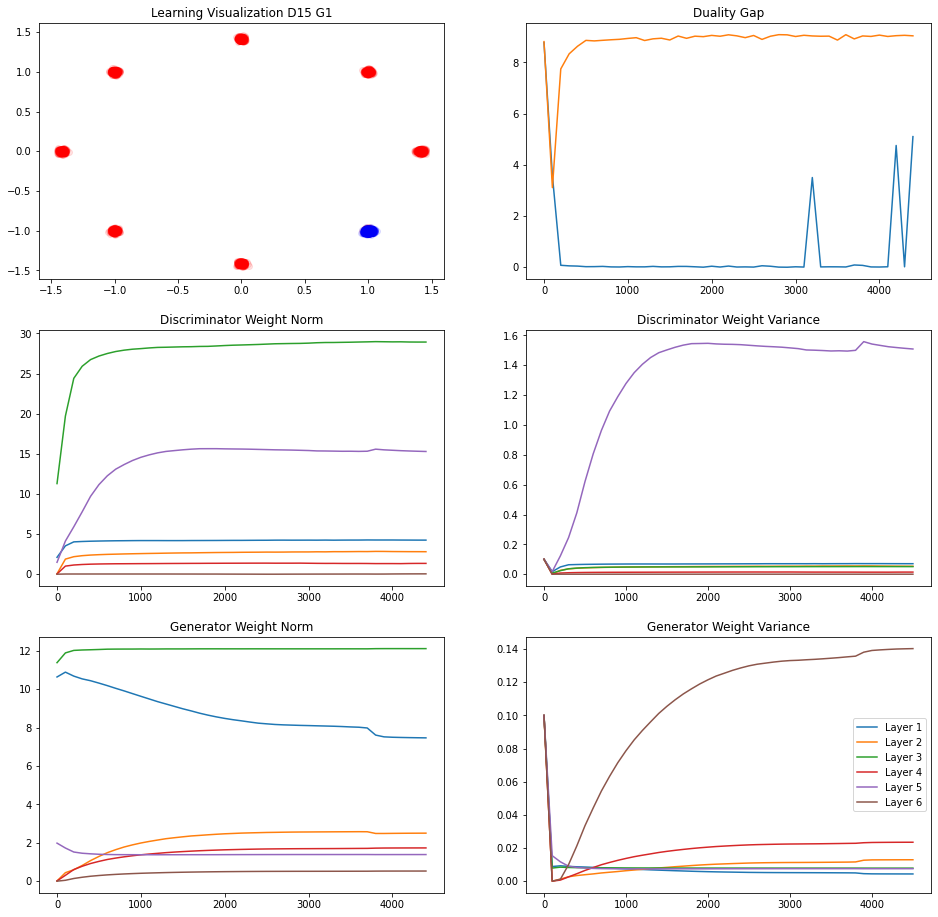

240/250 [===========================>..] - ETA: 0sIteration : 4500 [D loss: 0.152627, acc.: 95.70%] [G loss: 2.261465]
Vanilla   Duality GAP :  -0.016768008
L Random  Duality Gap :  8.99166


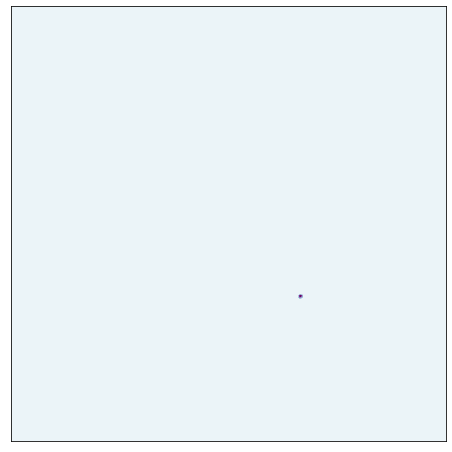

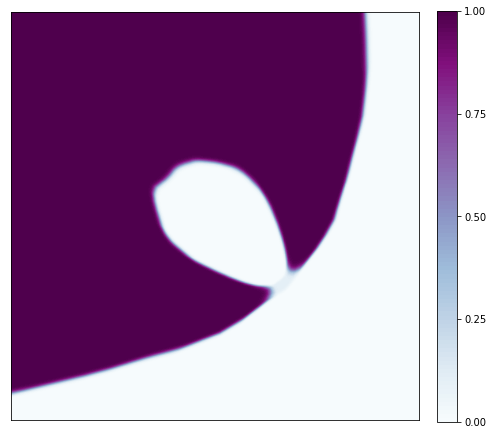

240/250 [===========================>..] - ETA: 0sIteration : 4600 [D loss: 0.145280, acc.: 96.09%] [G loss: 2.200269]
Vanilla   Duality GAP :  0.001956284
L Random  Duality Gap :  8.997078


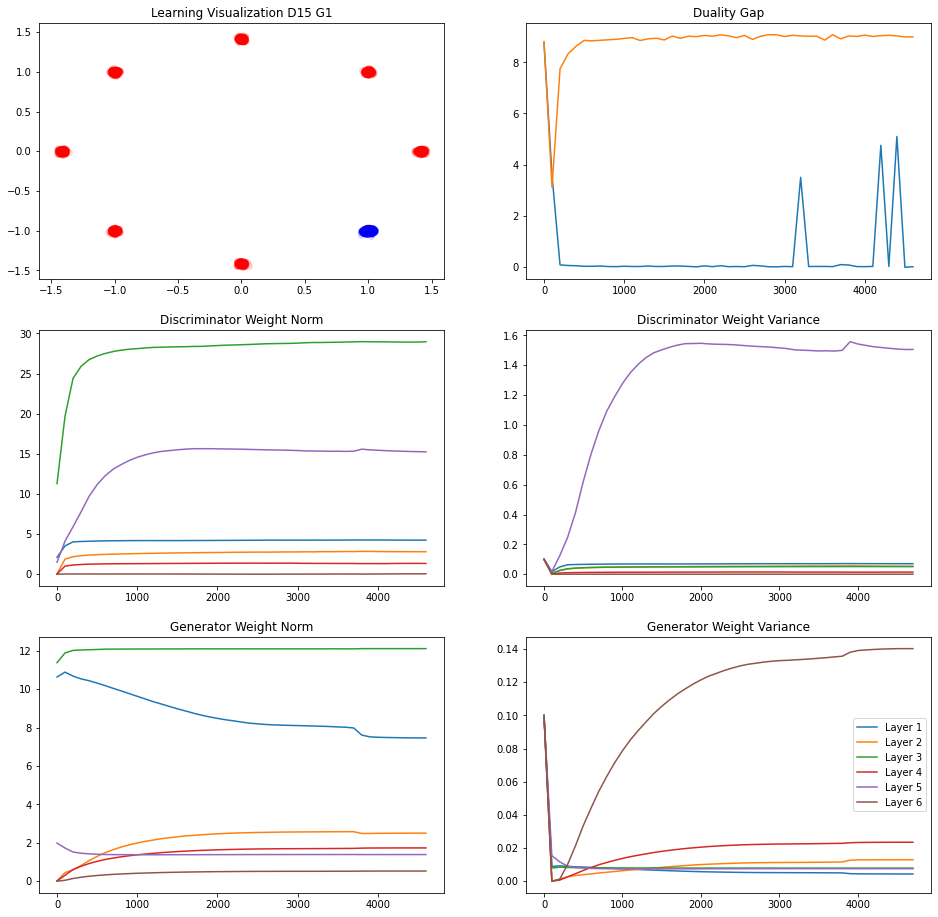

241/250 [===========================>..] - ETA: 0sIteration : 4700 [D loss: 0.205388, acc.: 93.36%] [G loss: 2.226186]
Vanilla   Duality GAP :  5.1717577
L Random  Duality Gap :  9.055198


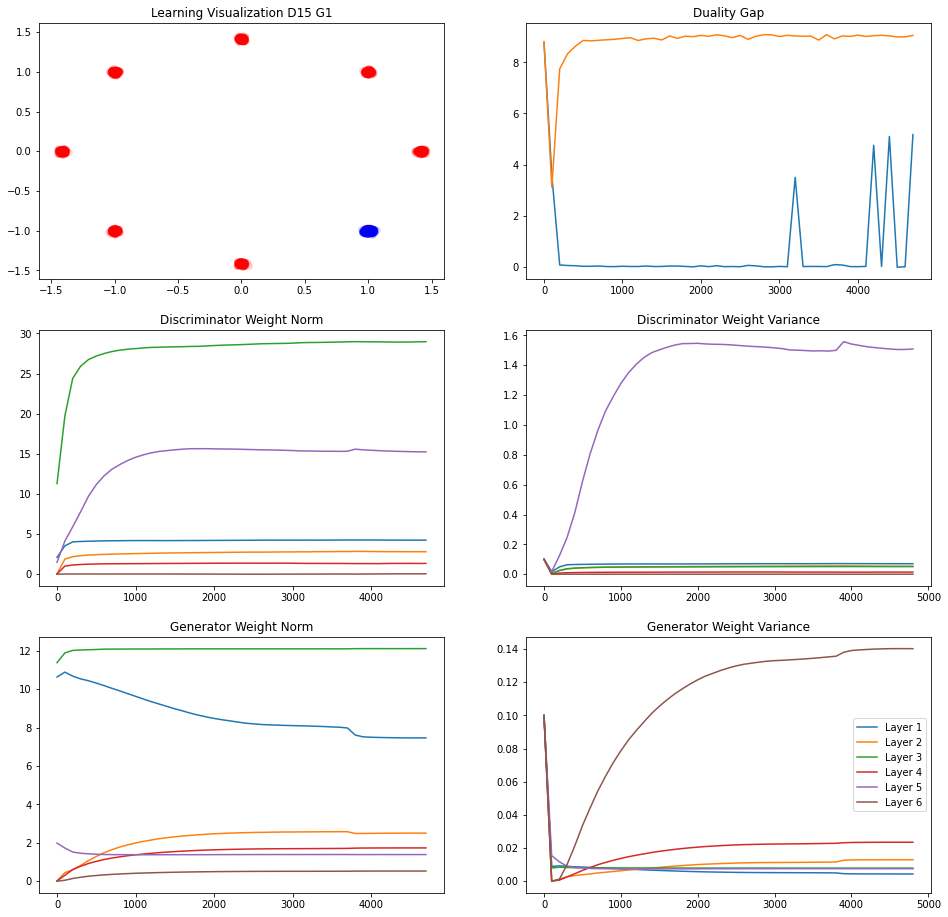

244/250 [============================>.] - ETA: 0sIteration : 4800 [D loss: 0.188052, acc.: 94.14%] [G loss: 2.218410]
Vanilla   Duality GAP :  -0.01503101
L Random  Duality Gap :  9.025597


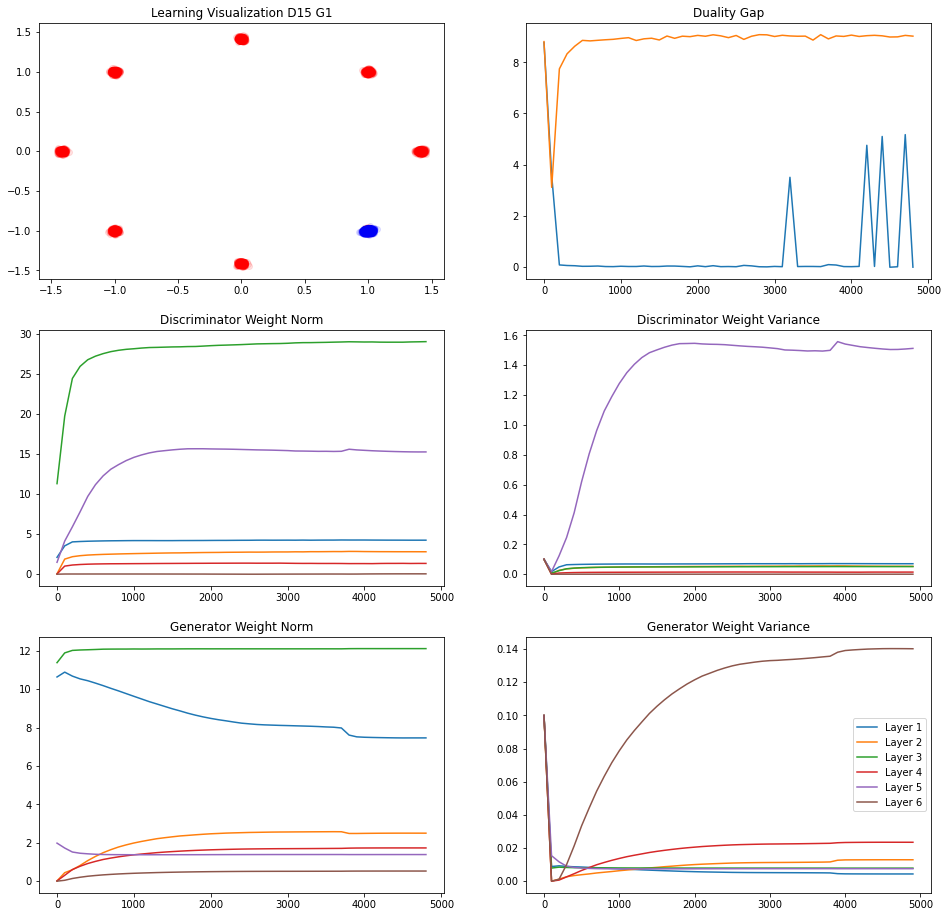

249/250 [============================>.] - ETA: 0sIteration : 4900 [D loss: 0.239821, acc.: 91.80%] [G loss: 2.198182]
Vanilla   Duality GAP :  4.633531
L Random  Duality Gap :  9.032963


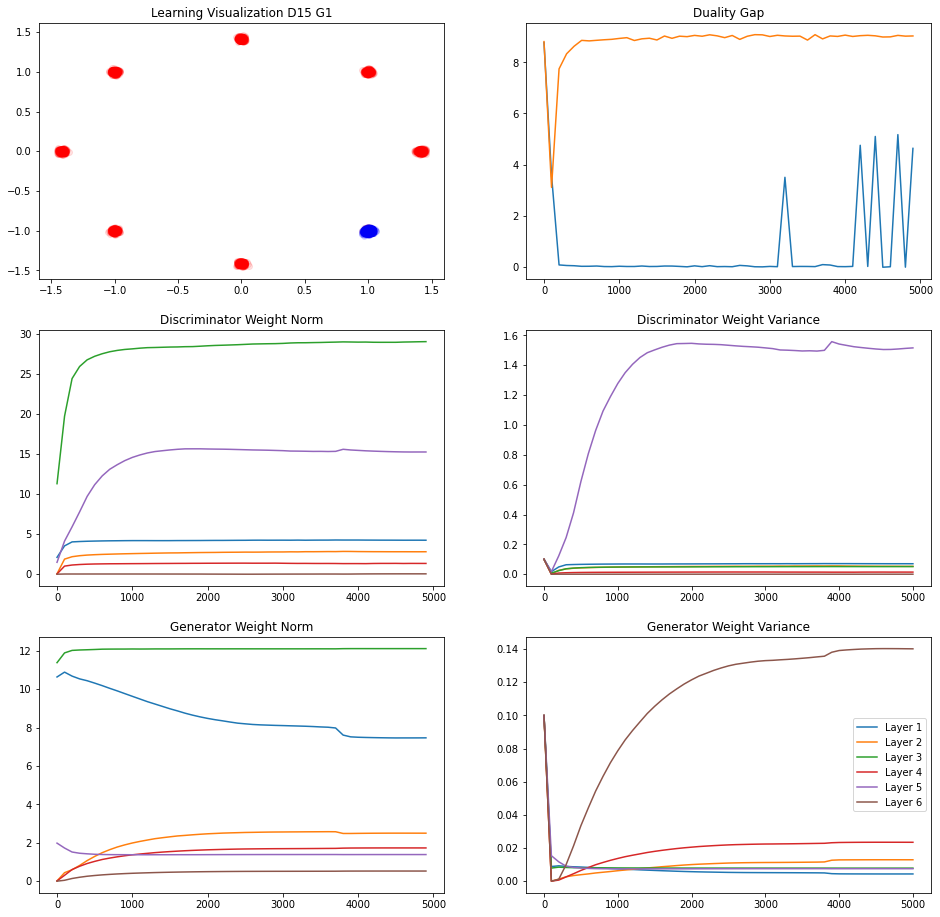

249/250 [============================>.] - ETA: 0sIteration : 5000 [D loss: 0.215385, acc.: 92.97%] [G loss: 2.264699]
Vanilla   Duality GAP :  4.86366
L Random  Duality Gap :  9.033245


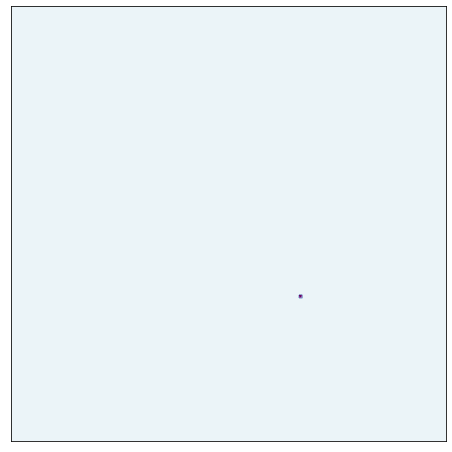

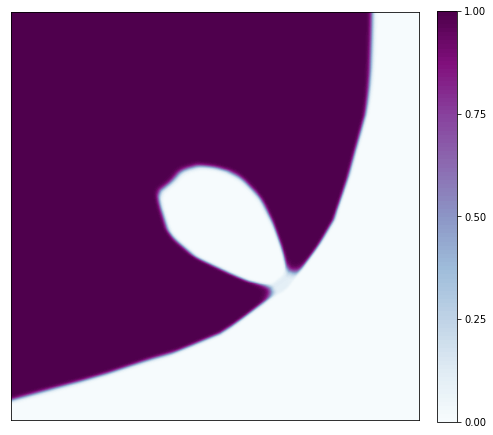

236/250 [===========================>..] - ETA: 0sIteration : 5100 [D loss: 0.214476, acc.: 92.97%] [G loss: 2.205379]
Vanilla   Duality GAP :  0.0006673038
L Random  Duality Gap :  9.067566


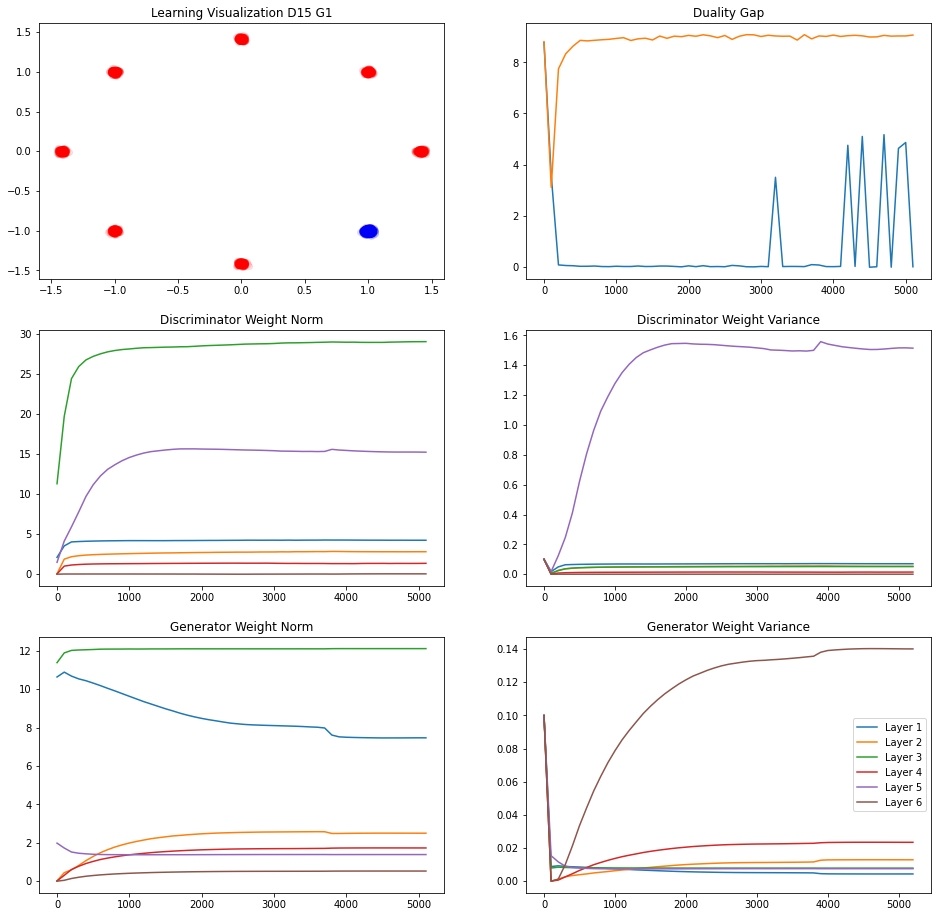

237/250 [===========================>..] - ETA: 0sIteration : 5200 [D loss: 0.188057, acc.: 94.14%] [G loss: 2.200605]
Vanilla   Duality GAP :  0.008760452
L Random  Duality Gap :  9.012149


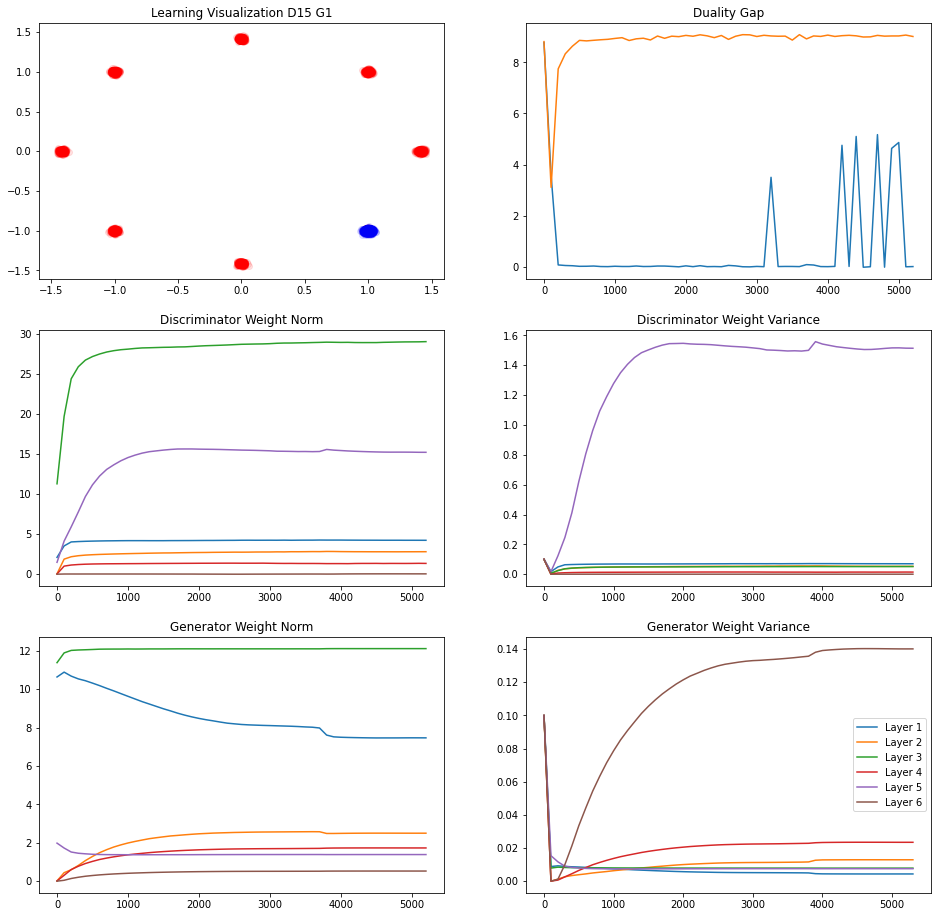

247/250 [============================>.] - ETA: 0sIteration : 5300 [D loss: 0.179163, acc.: 94.53%] [G loss: 2.232702]
Vanilla   Duality GAP :  0.010106921
L Random  Duality Gap :  9.070992


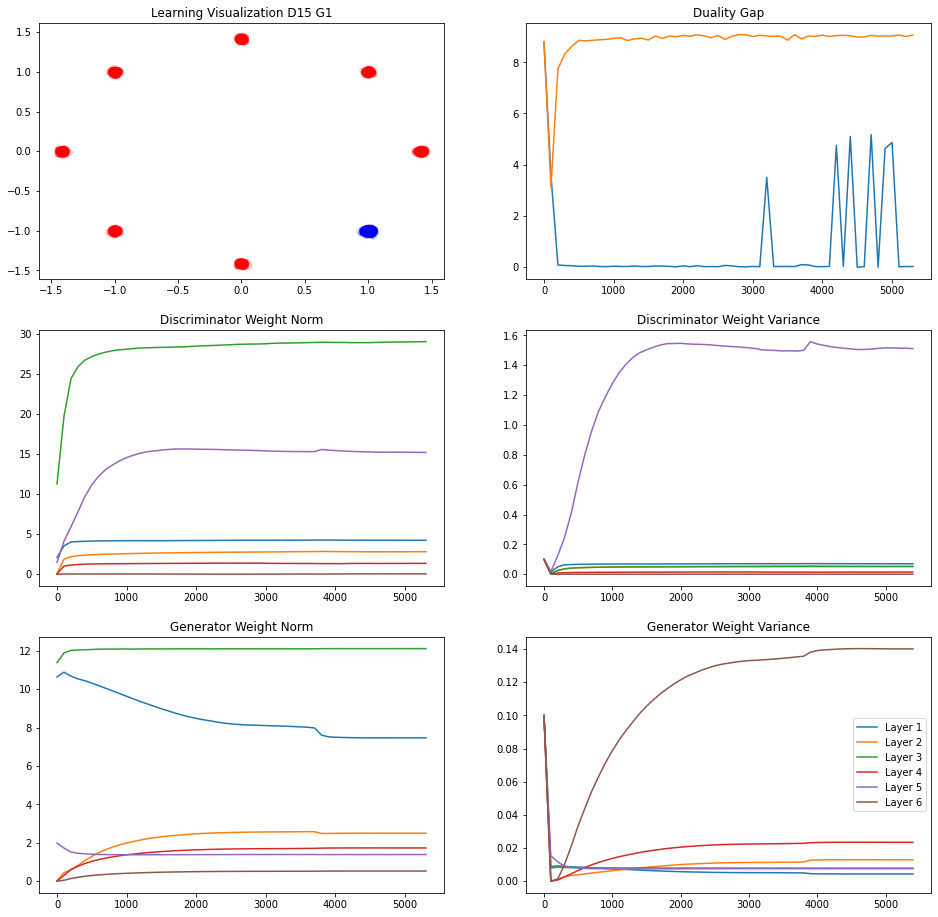

238/250 [===========================>..] - ETA: 0sIteration : 5400 [D loss: 0.205667, acc.: 93.36%] [G loss: 2.239619]
Vanilla   Duality GAP :  -0.008295447
L Random  Duality Gap :  9.07444


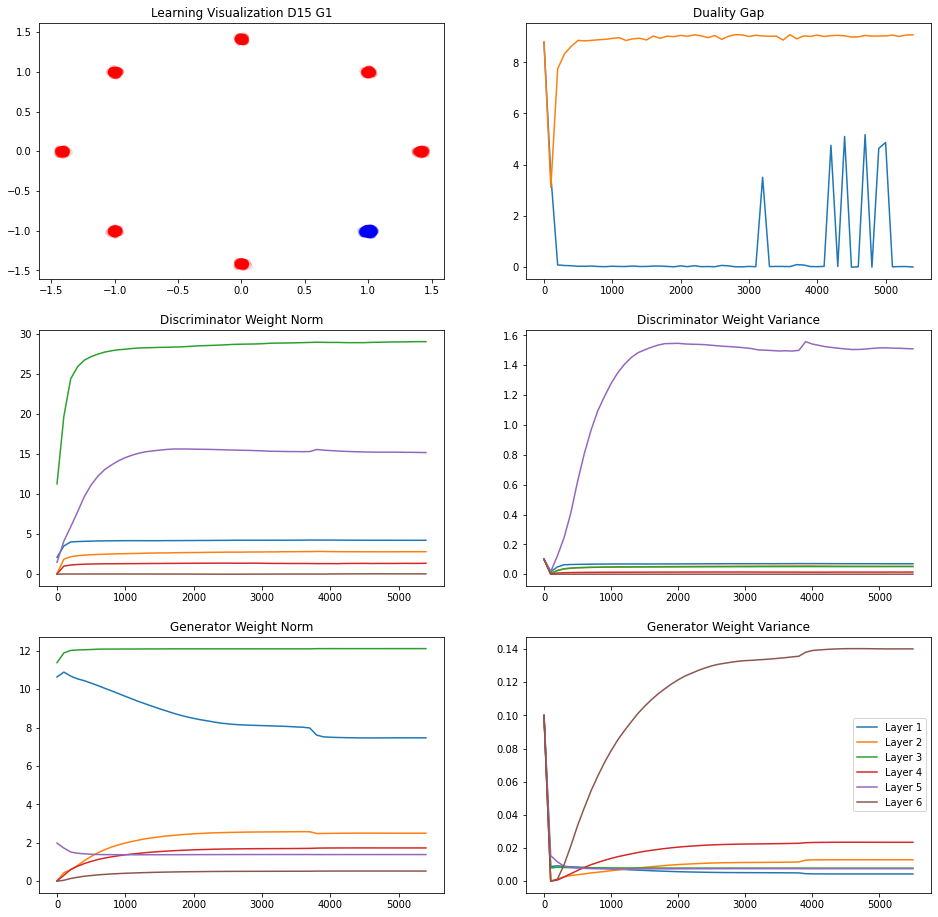

244/250 [============================>.] - ETA: 0sIteration : 5500 [D loss: 0.144966, acc.: 96.09%] [G loss: 2.209204]
Vanilla   Duality GAP :  -0.0050316155
L Random  Duality Gap :  9.03815


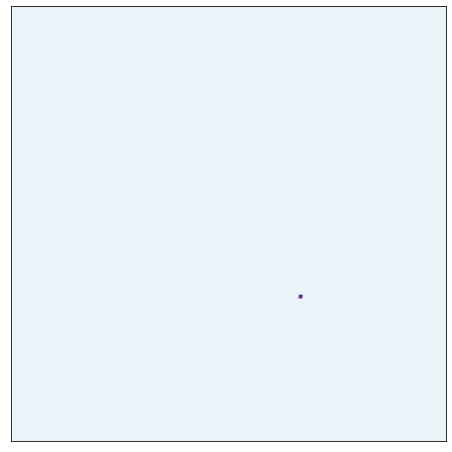

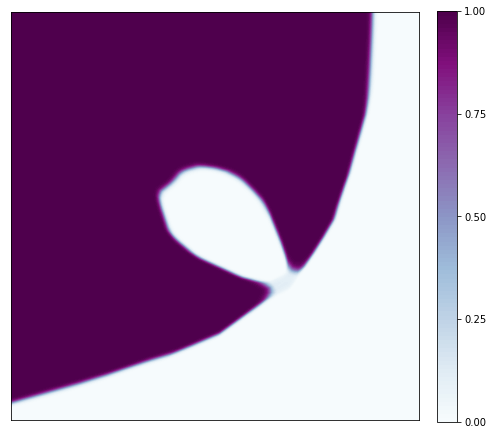

239/250 [===========================>..] - ETA: 0sIteration : 5600 [D loss: 0.117669, acc.: 97.27%] [G loss: 2.249772]
Vanilla   Duality GAP :  -0.008897364
L Random  Duality Gap :  8.988895


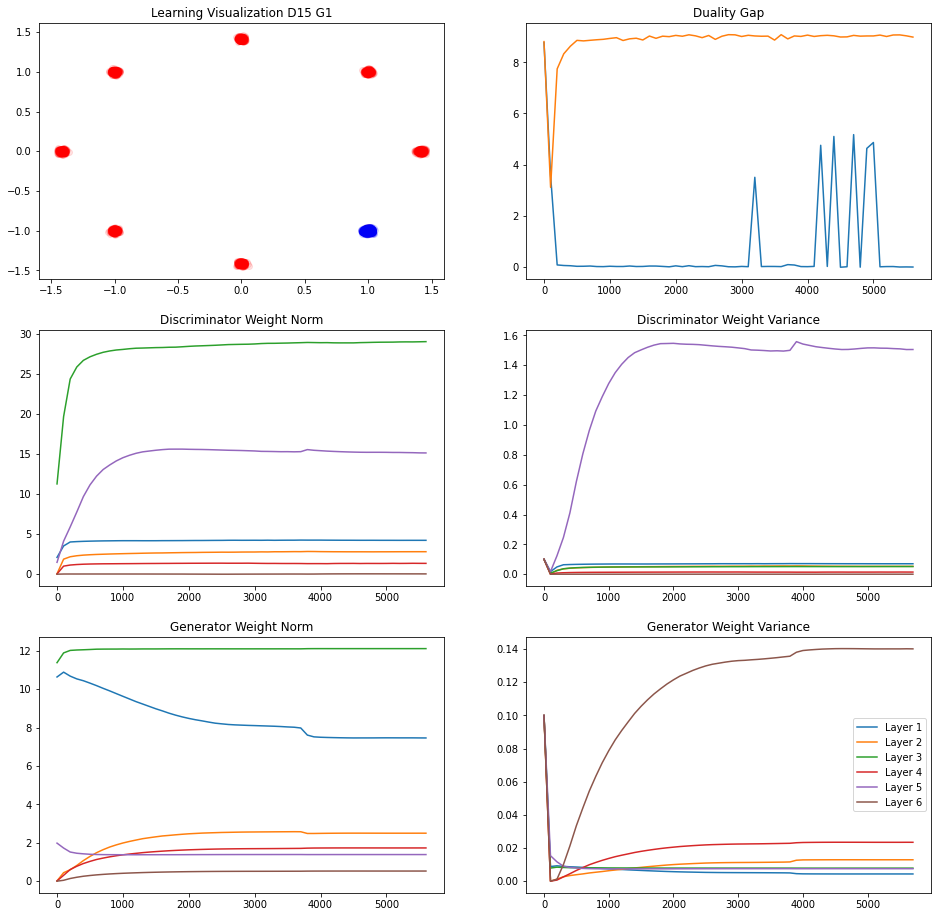

239/250 [===========================>..] - ETA: 0sIteration : 5700 [D loss: 0.223122, acc.: 92.58%] [G loss: 2.219486]
Vanilla   Duality GAP :  0.0006121993
L Random  Duality Gap :  9.054046


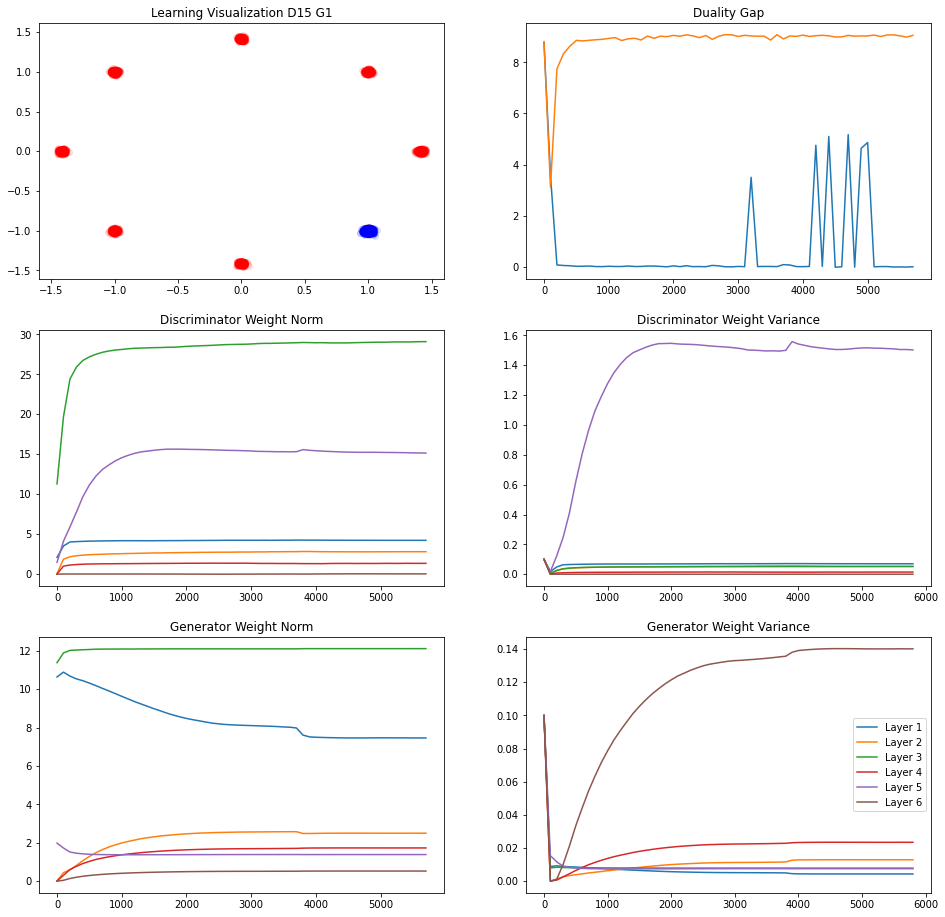

244/250 [============================>.] - ETA: 0sIteration : 5800 [D loss: 0.231982, acc.: 92.19%] [G loss: 2.238607]
Vanilla   Duality GAP :  -0.021201044
L Random  Duality Gap :  9.080087


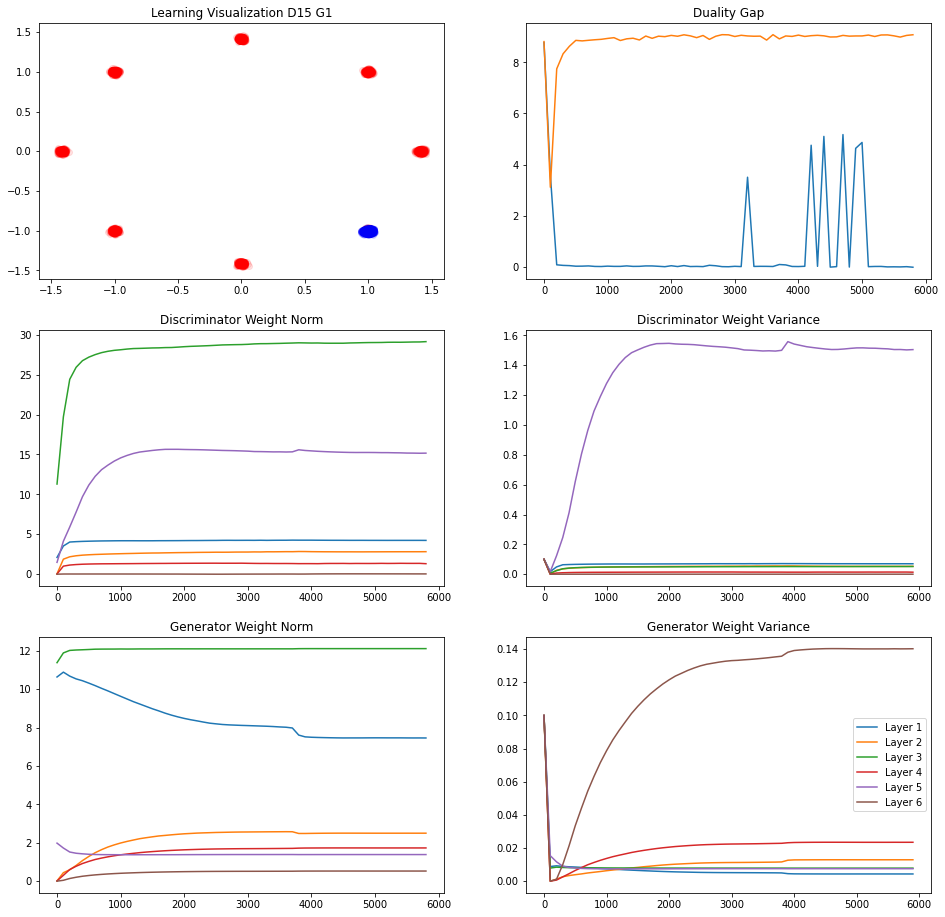

243/250 [============================>.] - ETA: 0sIteration : 5900 [D loss: 0.161649, acc.: 95.31%] [G loss: 2.228988]
Vanilla   Duality GAP :  -0.0029127896
L Random  Duality Gap :  9.069027


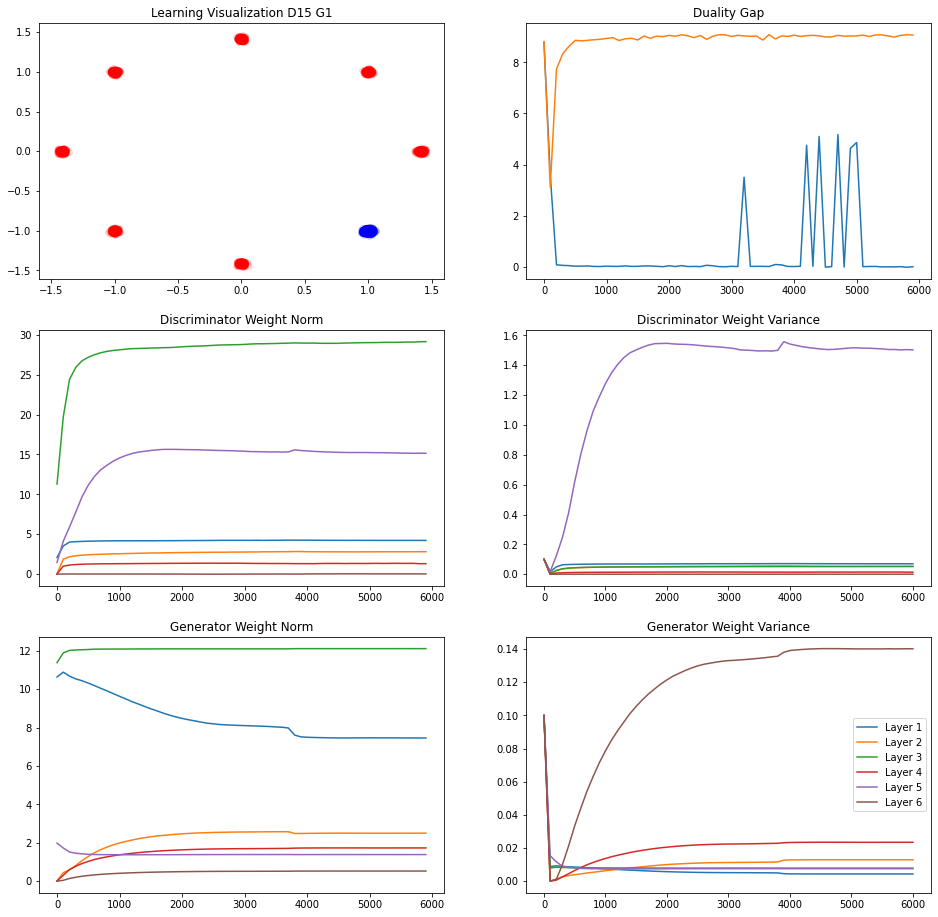

248/250 [============================>.] - ETA: 0sIteration : 6000 [D loss: 0.132641, acc.: 94.53%] [G loss: 3.266069]
Vanilla   Duality GAP :  0.22670609
L Random  Duality Gap :  9.112115


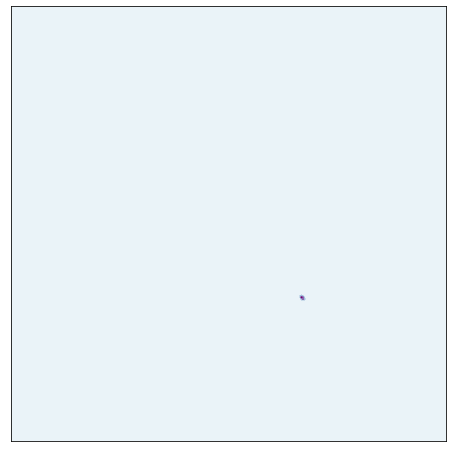

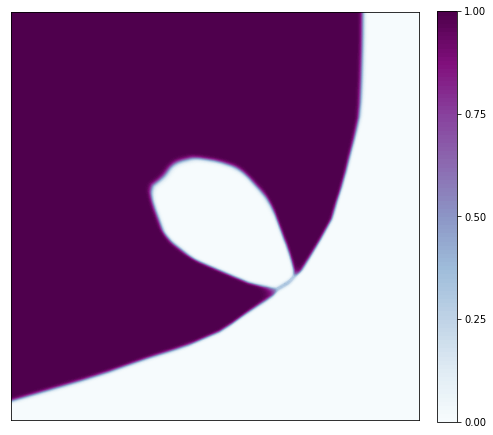

246/250 [============================>.] - ETA: 0sIteration : 6100 [D loss: 0.147923, acc.: 94.92%] [G loss: 2.925404]
Vanilla   Duality GAP :  3.66954
L Random  Duality Gap :  9.080375


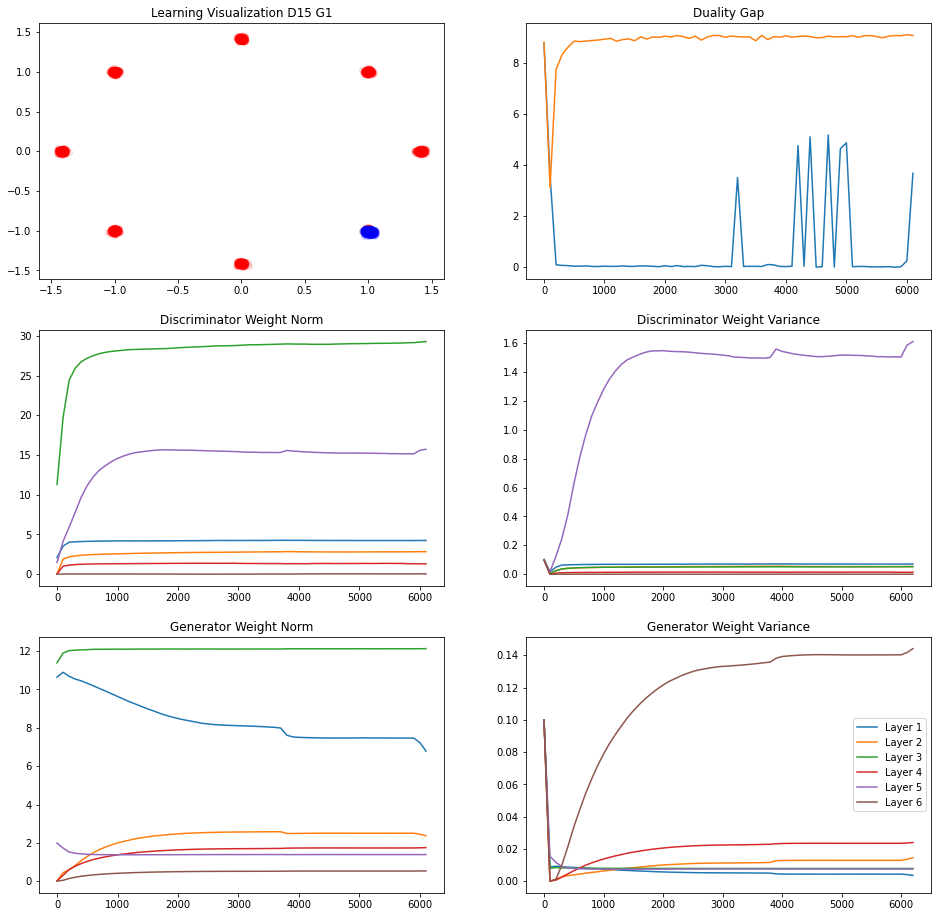

244/250 [============================>.] - ETA: 0sIteration : 6200 [D loss: 0.180117, acc.: 94.53%] [G loss: 2.238431]
Vanilla   Duality GAP :  3.7550414
L Random  Duality Gap :  9.073884


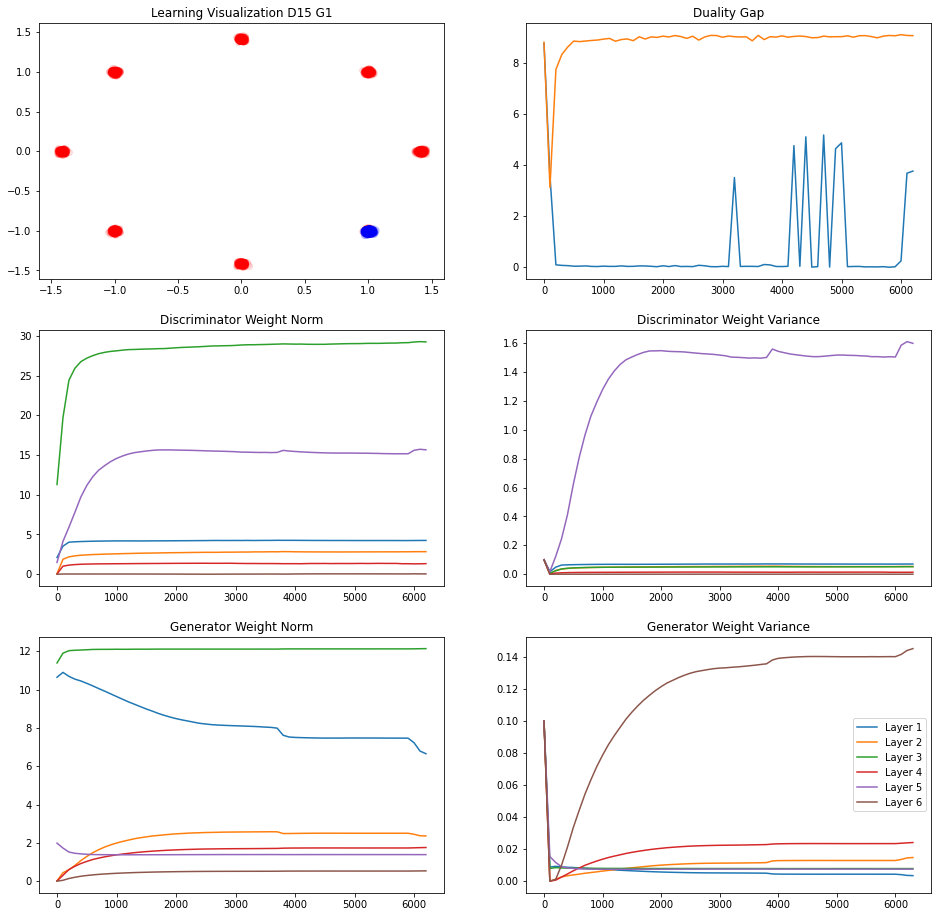

244/250 [============================>.] - ETA: 0sIteration : 6300 [D loss: 0.187771, acc.: 94.14%] [G loss: 2.235705]
Vanilla   Duality GAP :  0.018584818
L Random  Duality Gap :  8.981858


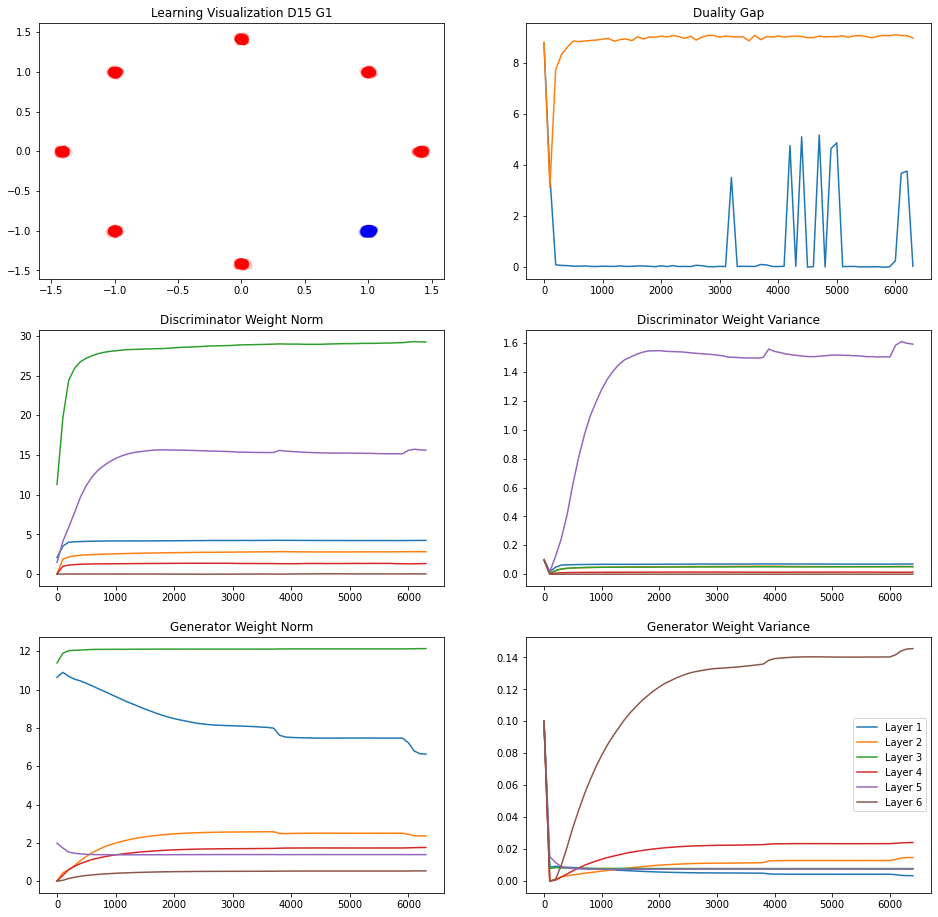

243/250 [============================>.] - ETA: 0sIteration : 6400 [D loss: 0.153895, acc.: 95.70%] [G loss: 2.208824]
Vanilla   Duality GAP :  0.015493989
L Random  Duality Gap :  9.063425


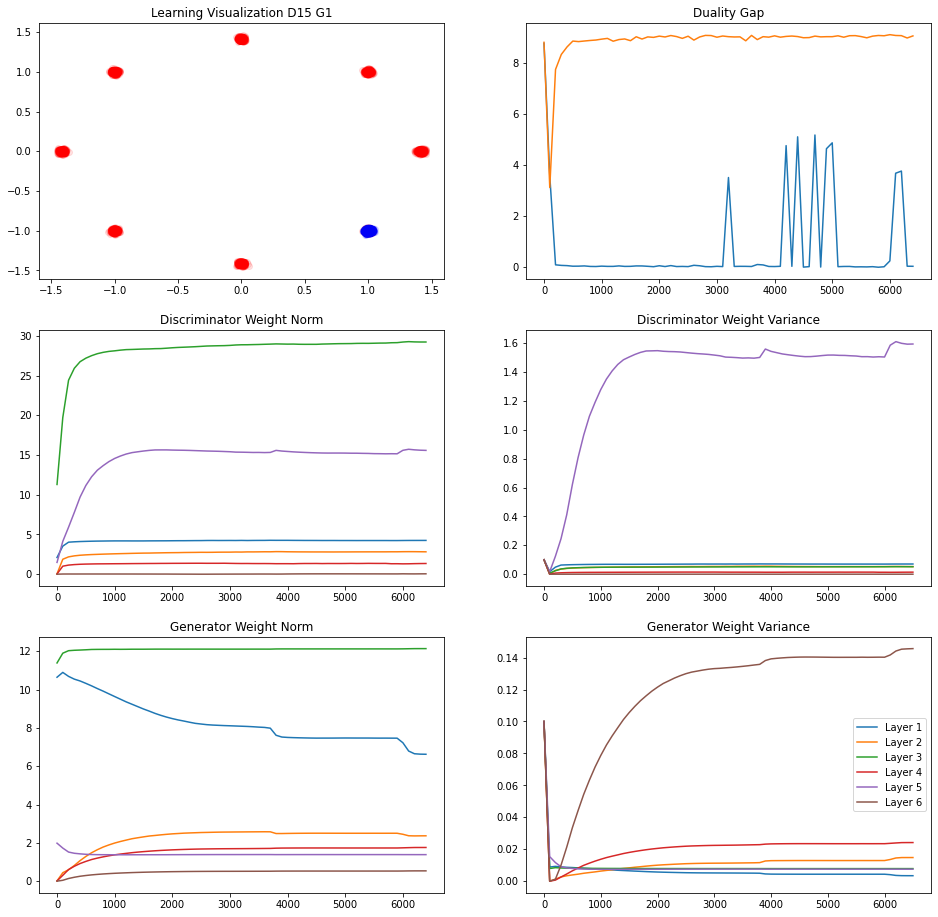

239/250 [===========================>..] - ETA: 0sIteration : 6500 [D loss: 0.241560, acc.: 91.80%] [G loss: 2.224036]
Vanilla   Duality GAP :  0.0032418072
L Random  Duality Gap :  9.032052


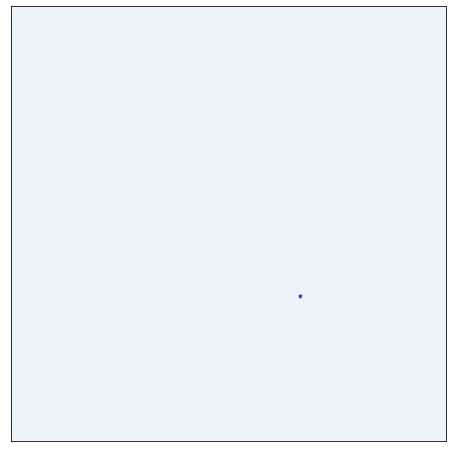

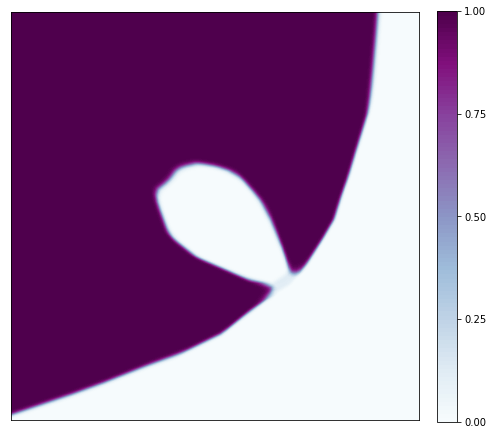

247/250 [============================>.] - ETA: 0sIteration : 6600 [D loss: 0.188605, acc.: 94.14%] [G loss: 2.173431]
Vanilla   Duality GAP :  -0.0040814877
L Random  Duality Gap :  9.070507


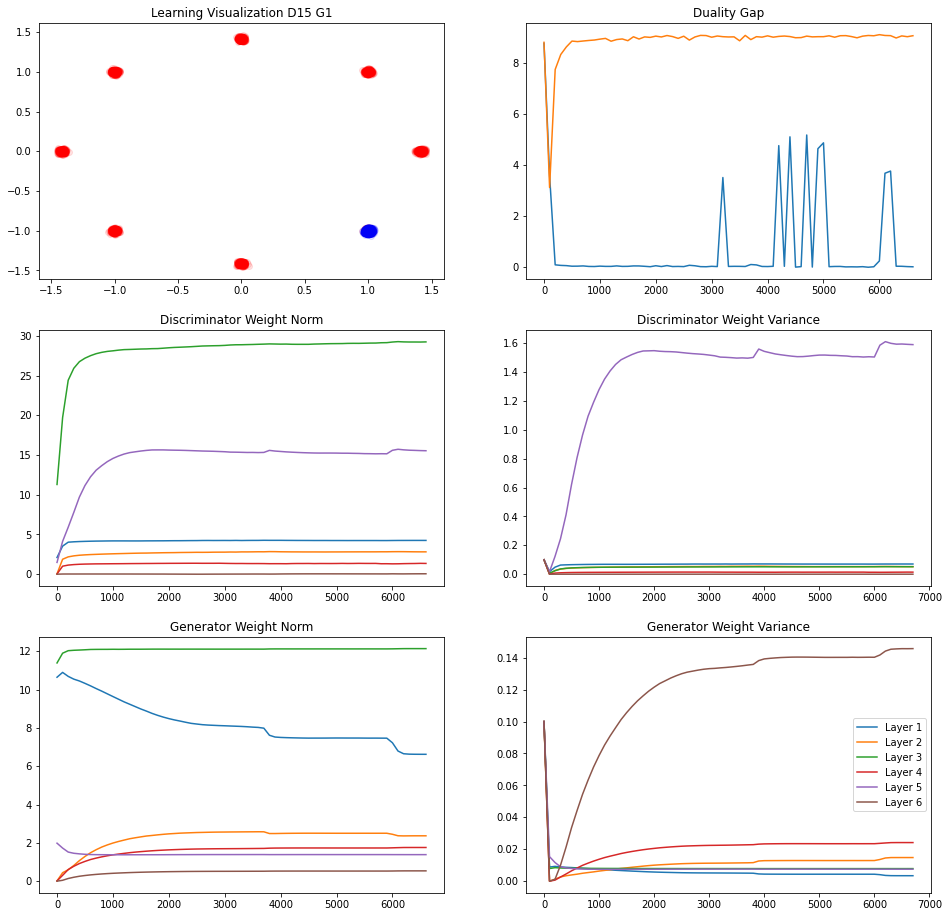

248/250 [============================>.] - ETA: 0sIteration : 6700 [D loss: 0.214359, acc.: 92.97%] [G loss: 2.194688]
Vanilla   Duality GAP :  0.0091147125
L Random  Duality Gap :  9.047058


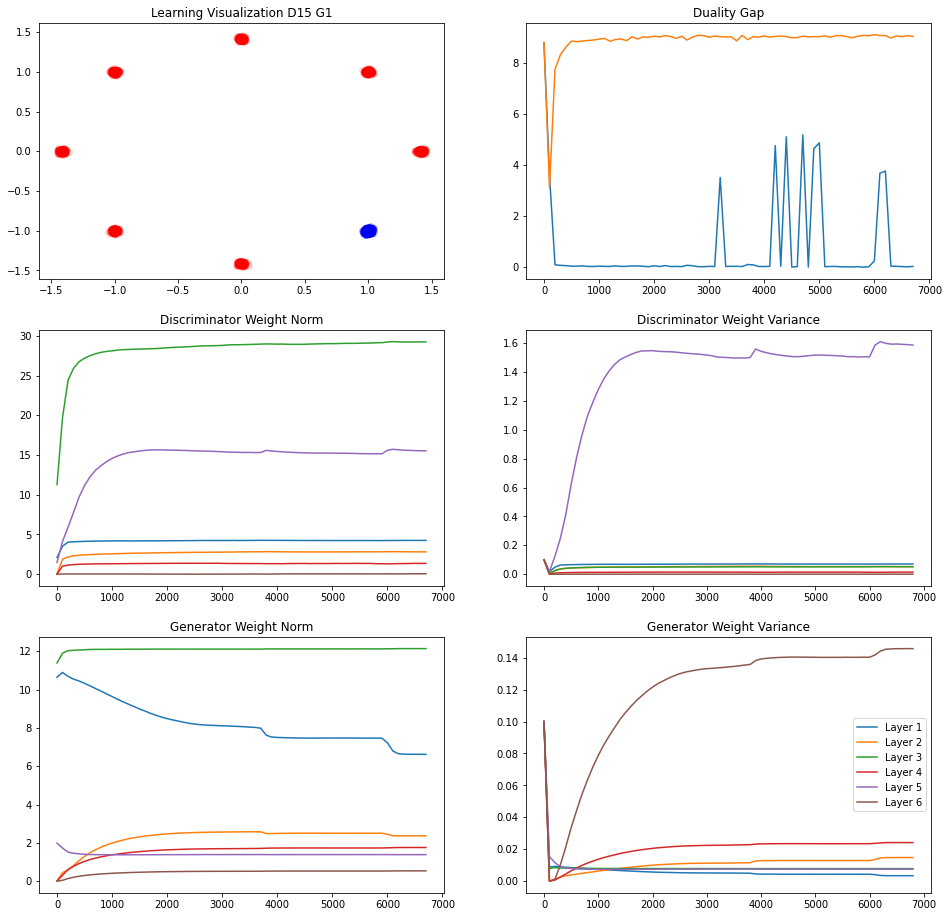

246/250 [============================>.] - ETA: 0sIteration : 6800 [D loss: 0.196938, acc.: 93.75%] [G loss: 2.214479]
Vanilla   Duality GAP :  5.193388
L Random  Duality Gap :  8.944457


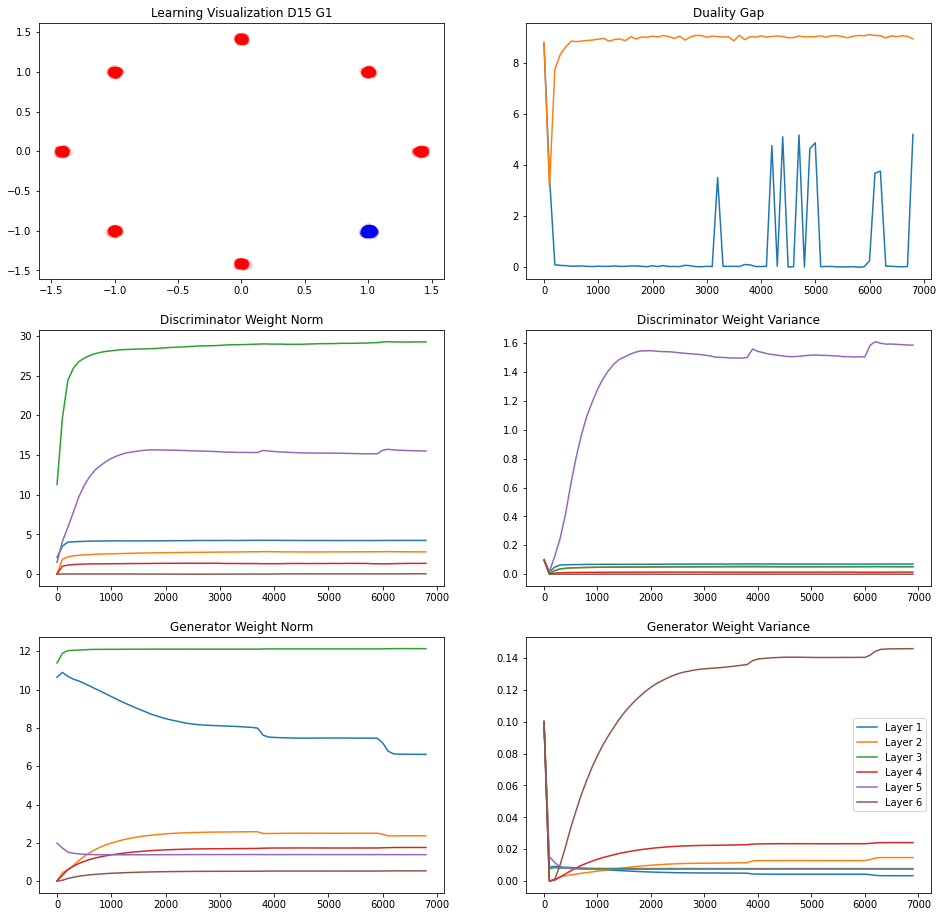

245/250 [============================>.] - ETA: 0sIteration : 6900 [D loss: 0.213889, acc.: 92.97%] [G loss: 2.192586]
Vanilla   Duality GAP :  -0.0057572722
L Random  Duality Gap :  9.071033


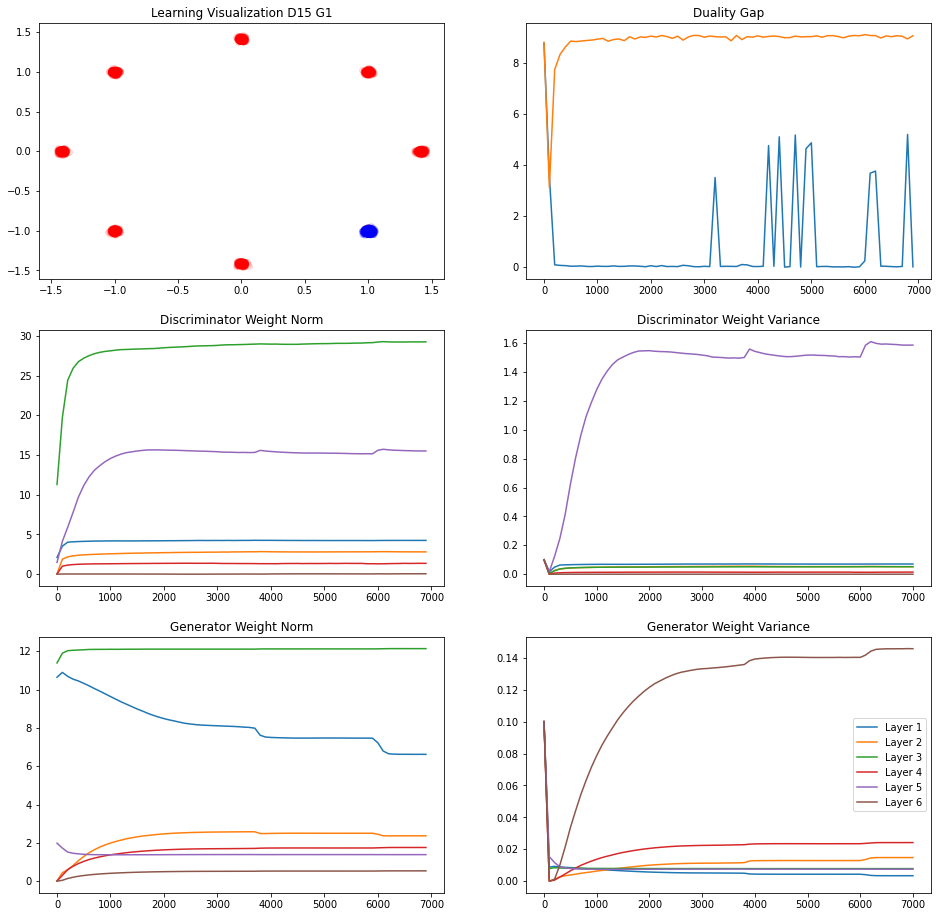

246/250 [============================>.] - ETA: 0sIteration : 7000 [D loss: 0.145076, acc.: 96.09%] [G loss: 2.212162]
Vanilla   Duality GAP :  0.030930638
L Random  Duality Gap :  9.067132


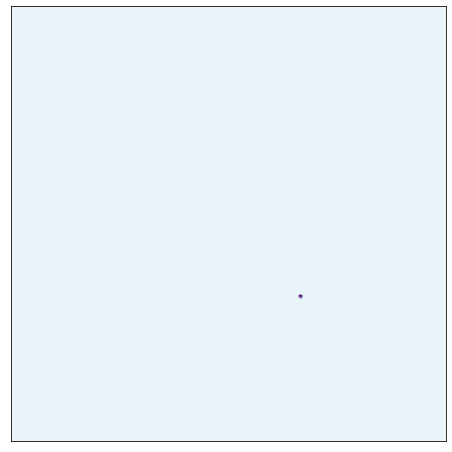

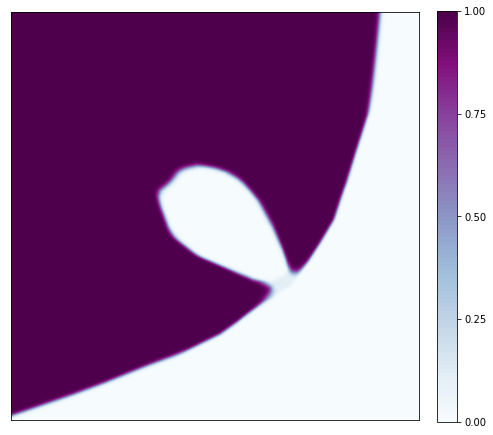

243/250 [============================>.] - ETA: 0sIteration : 7100 [D loss: 0.162274, acc.: 95.31%] [G loss: 2.194327]
Vanilla   Duality GAP :  0.00018286705
L Random  Duality Gap :  9.031627


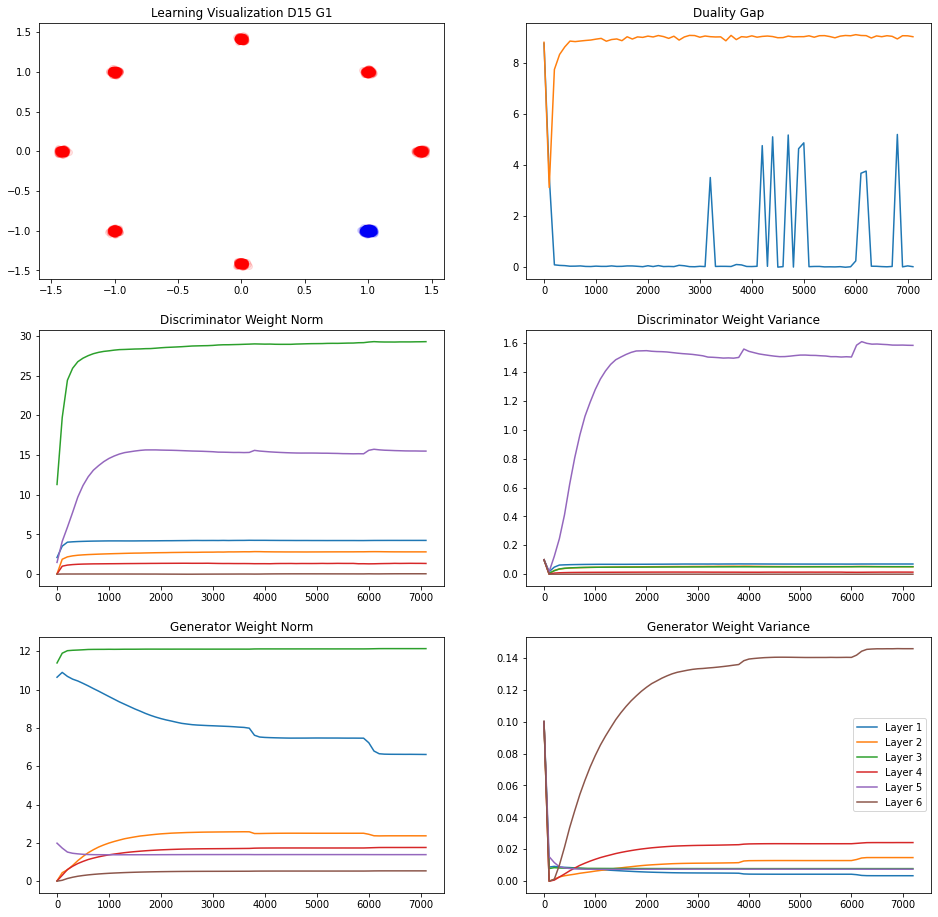

248/250 [============================>.] - ETA: 0sIteration : 7200 [D loss: 0.205618, acc.: 93.36%] [G loss: 2.199914]
Vanilla   Duality GAP :  0.0075404346
L Random  Duality Gap :  9.048746


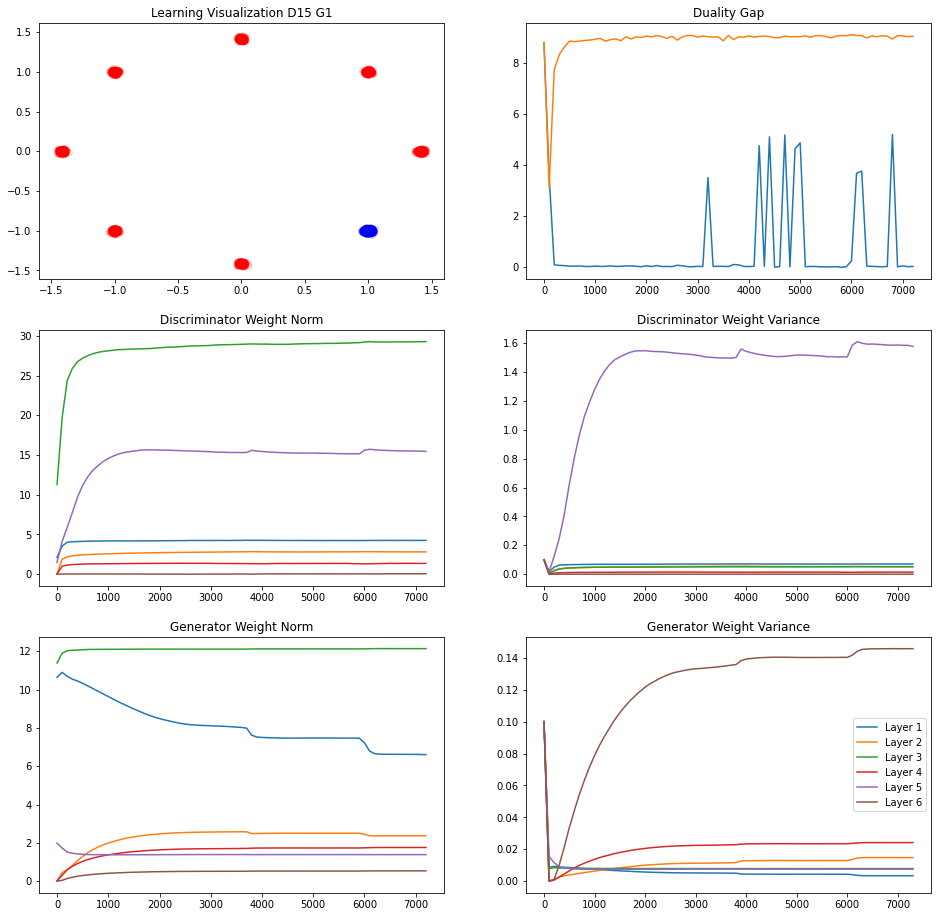

245/250 [============================>.] - ETA: 0sIteration : 7300 [D loss: 0.196782, acc.: 93.75%] [G loss: 2.161298]
Vanilla   Duality GAP :  0.001691997
L Random  Duality Gap :  8.999386


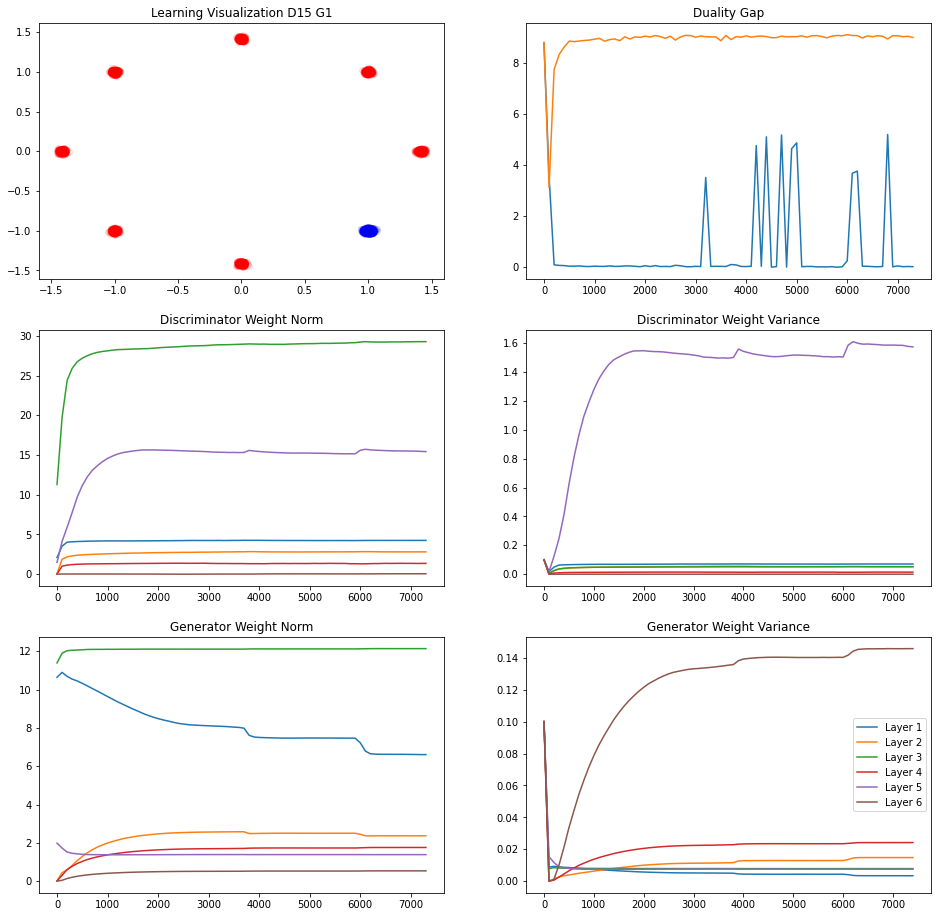

243/250 [============================>.] - ETA: 0sIteration : 7400 [D loss: 0.209198, acc.: 91.80%] [G loss: 2.872733]
Vanilla   Duality GAP :  0.18464056
L Random  Duality Gap :  8.819191


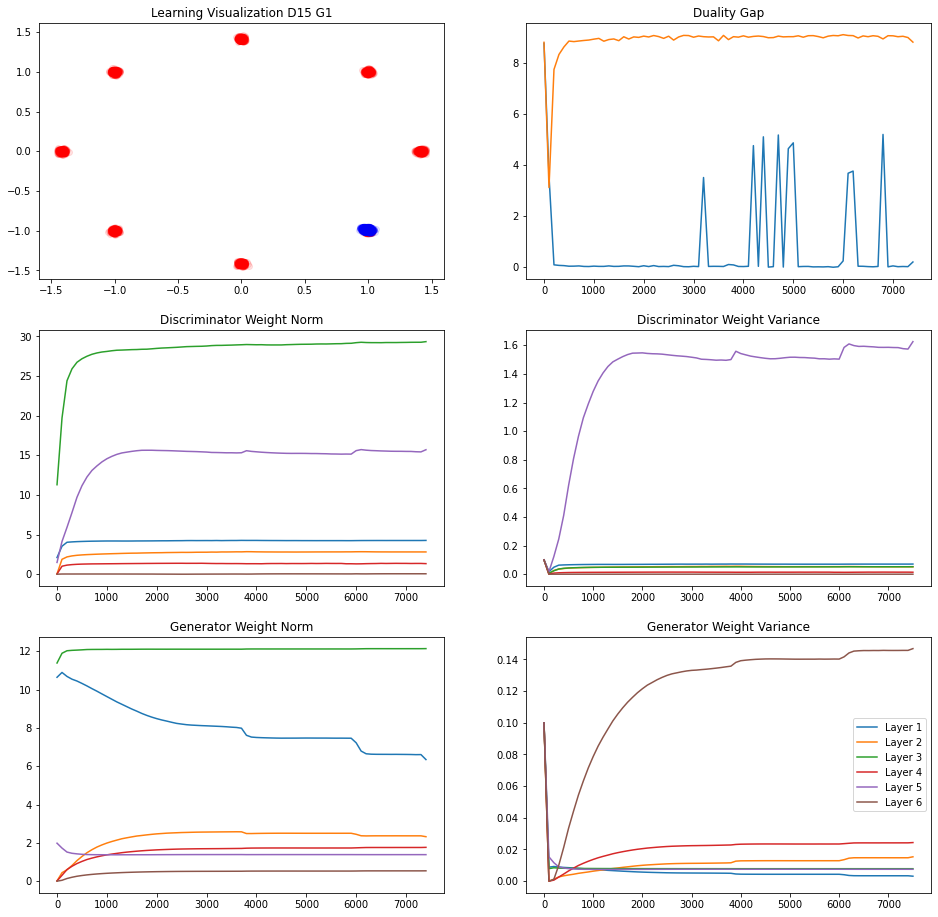

249/250 [============================>.] - ETA: 0sIteration : 7500 [D loss: 0.162764, acc.: 95.31%] [G loss: 2.183791]
Vanilla   Duality GAP :  0.0049298108
L Random  Duality Gap :  9.045726


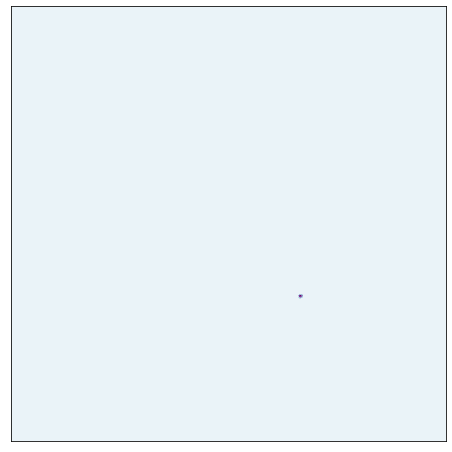

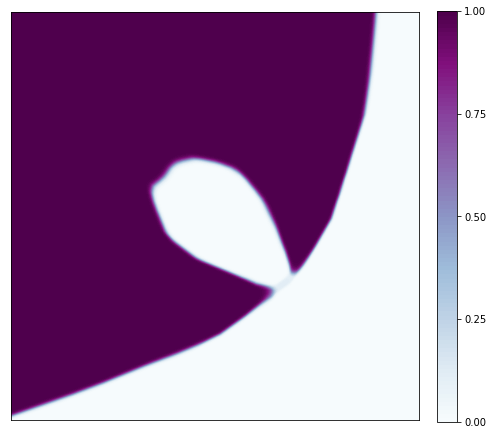

239/250 [===========================>..] - ETA: 0sIteration : 7600 [D loss: 0.231399, acc.: 92.19%] [G loss: 2.211642]
Vanilla   Duality GAP :  3.8575382
L Random  Duality Gap :  8.995513


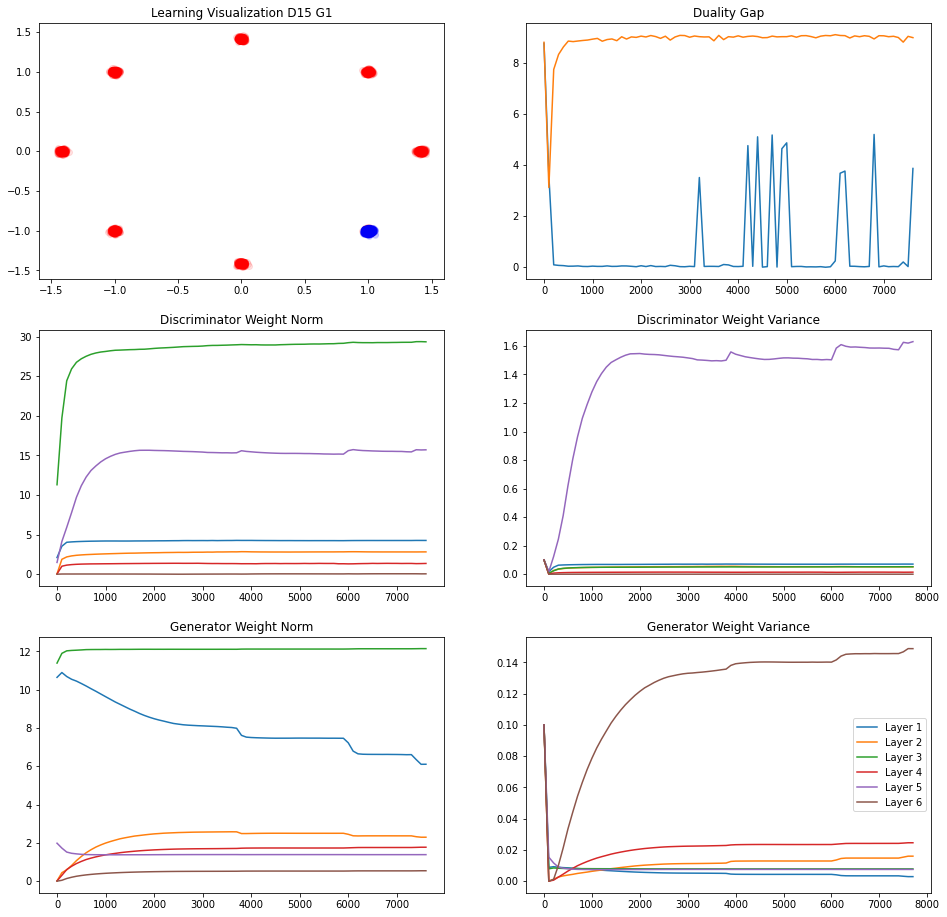

244/250 [============================>.] - ETA: 0sIteration : 7700 [D loss: 0.196556, acc.: 93.75%] [G loss: 2.255140]
Vanilla   Duality GAP :  3.7692995
L Random  Duality Gap :  9.004055


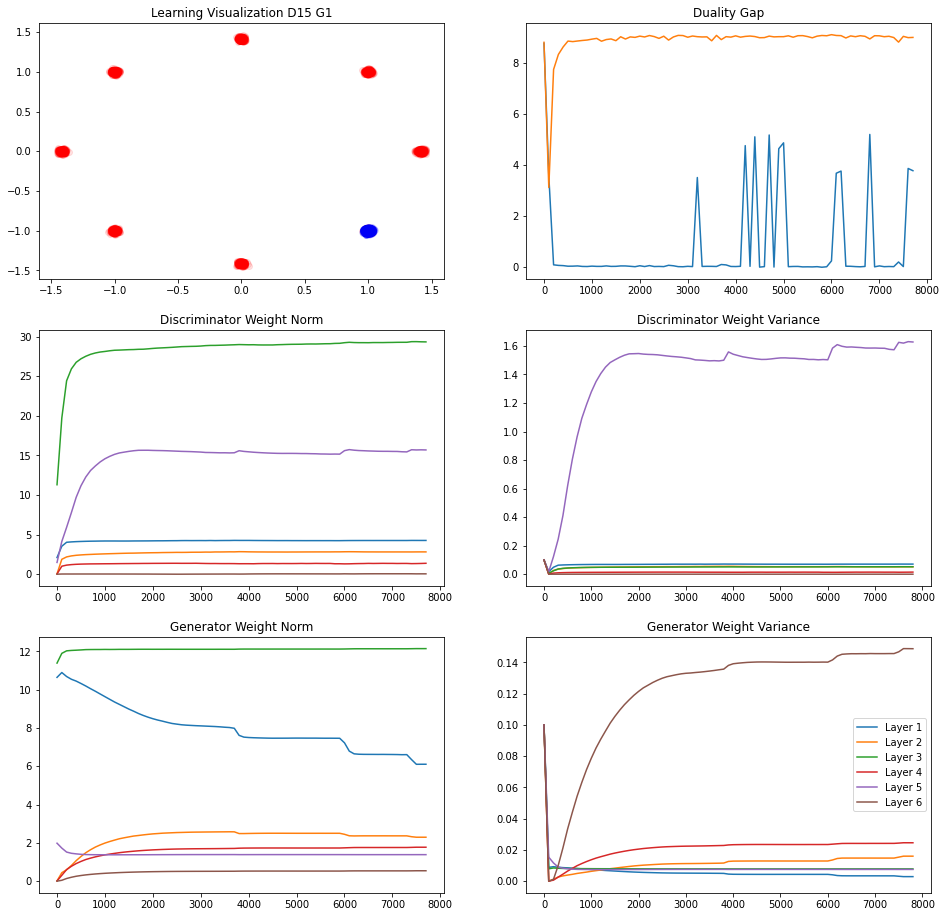

242/250 [============================>.] - ETA: 0sIteration : 7800 [D loss: 0.196979, acc.: 93.75%] [G loss: 2.158109]
Vanilla   Duality GAP :  4.004199
L Random  Duality Gap :  9.04166


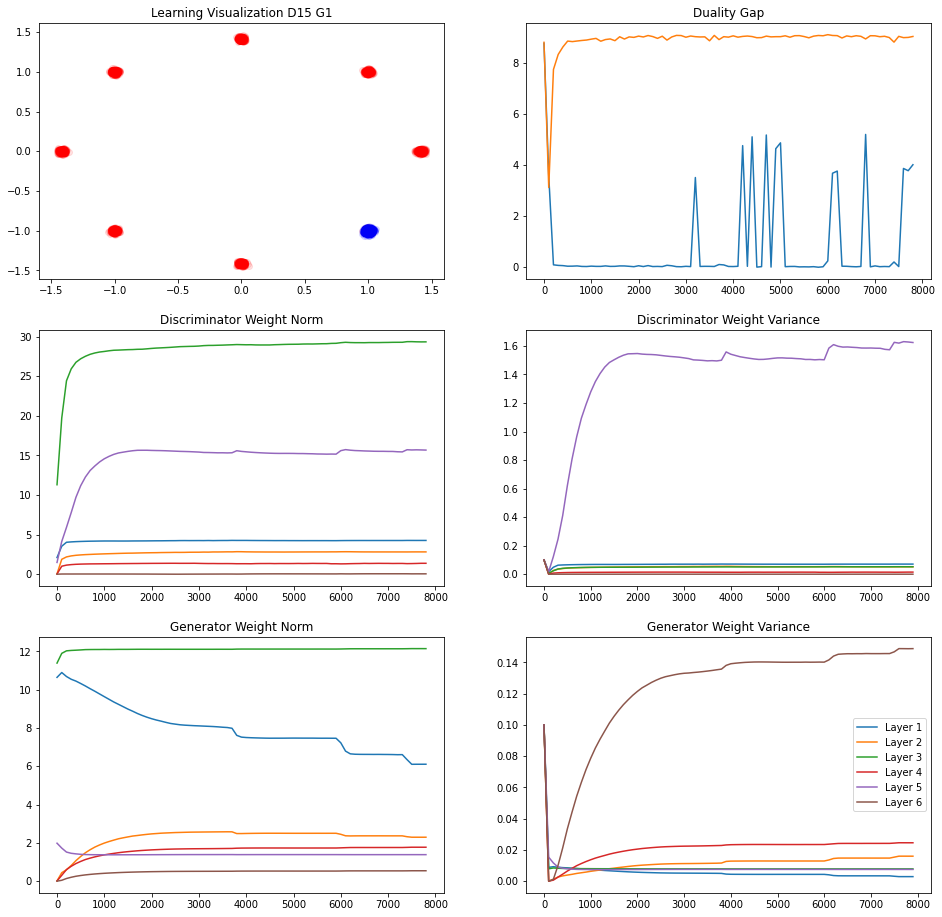

243/250 [============================>.] - ETA: 0sIteration : 7900 [D loss: 0.205008, acc.: 93.36%] [G loss: 2.195166]
Vanilla   Duality GAP :  0.033554375
L Random  Duality Gap :  9.073656


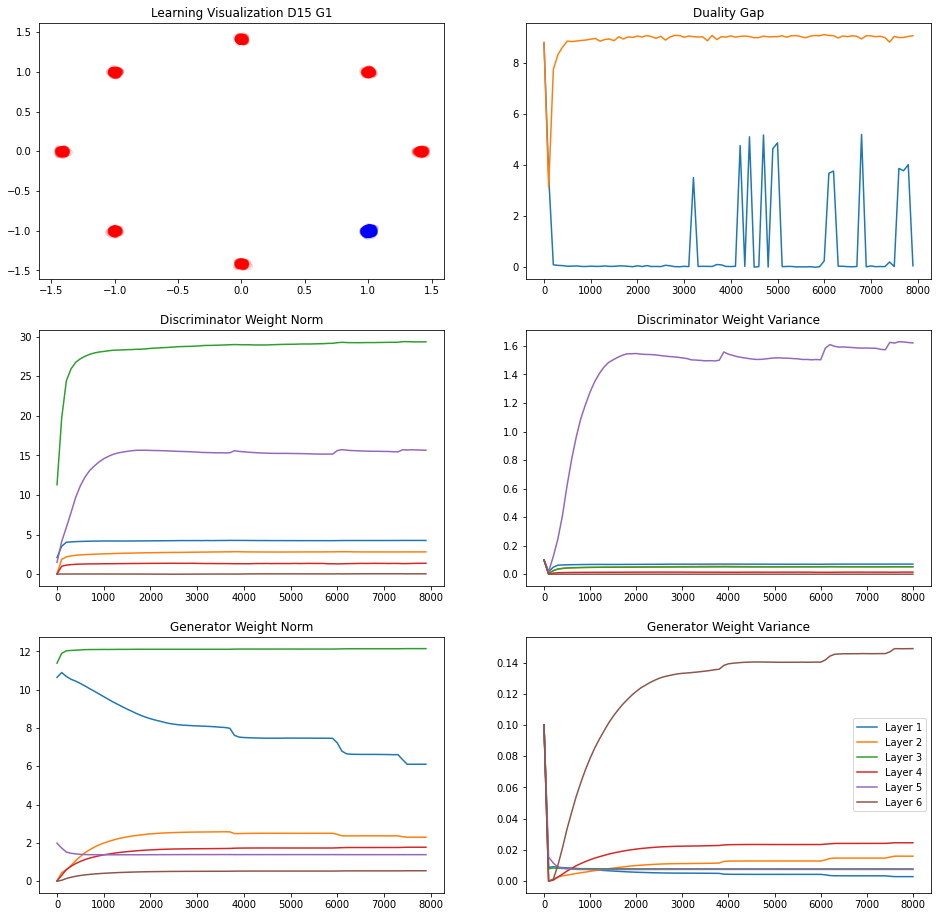

239/250 [===========================>..] - ETA: 0sIteration : 8000 [D loss: 0.161758, acc.: 95.31%] [G loss: 2.264514]
Vanilla   Duality GAP :  0.0070024133
L Random  Duality Gap :  9.026606


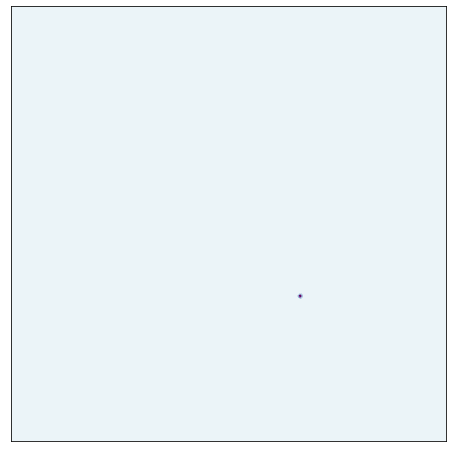

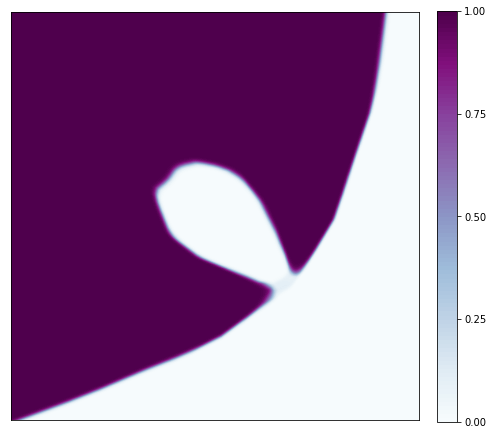

241/250 [===========================>..] - ETA: 0sIteration : 8100 [D loss: 0.179104, acc.: 94.53%] [G loss: 2.204351]
Vanilla   Duality GAP :  0.010443568
L Random  Duality Gap :  9.031866


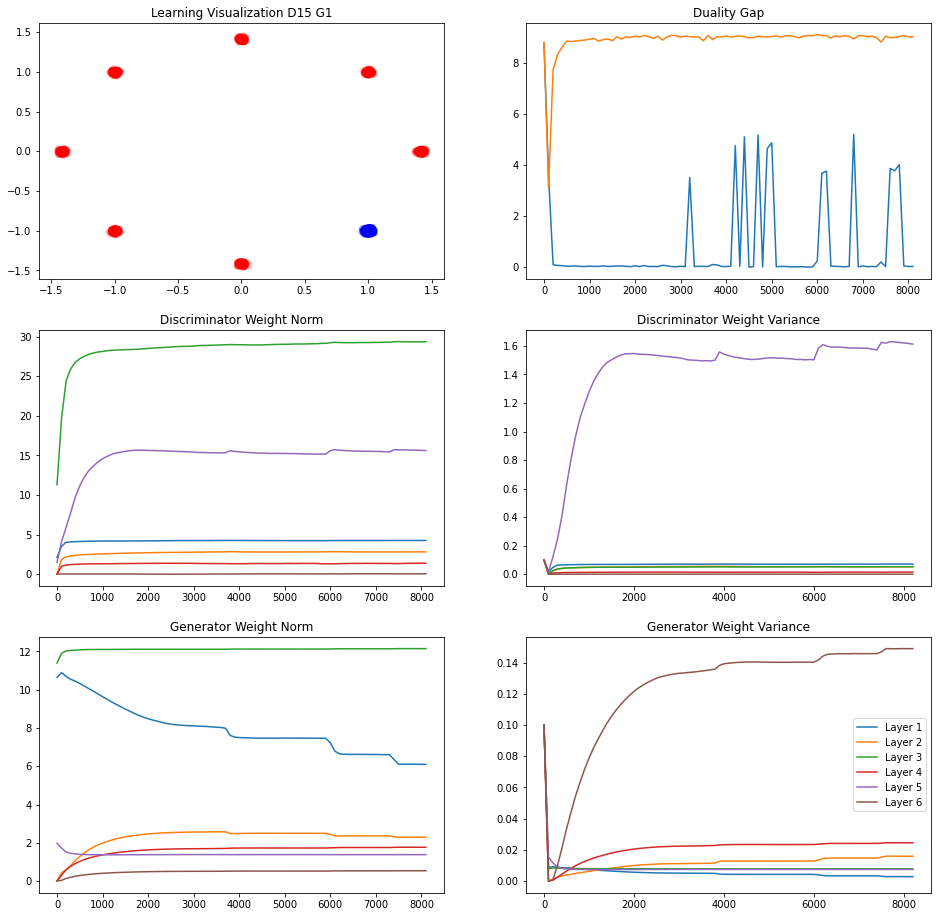

236/250 [===========================>..] - ETA: 0sIteration : 8200 [D loss: 0.163131, acc.: 95.31%] [G loss: 2.171181]
Vanilla   Duality GAP :  0.0017263293
L Random  Duality Gap :  9.071817


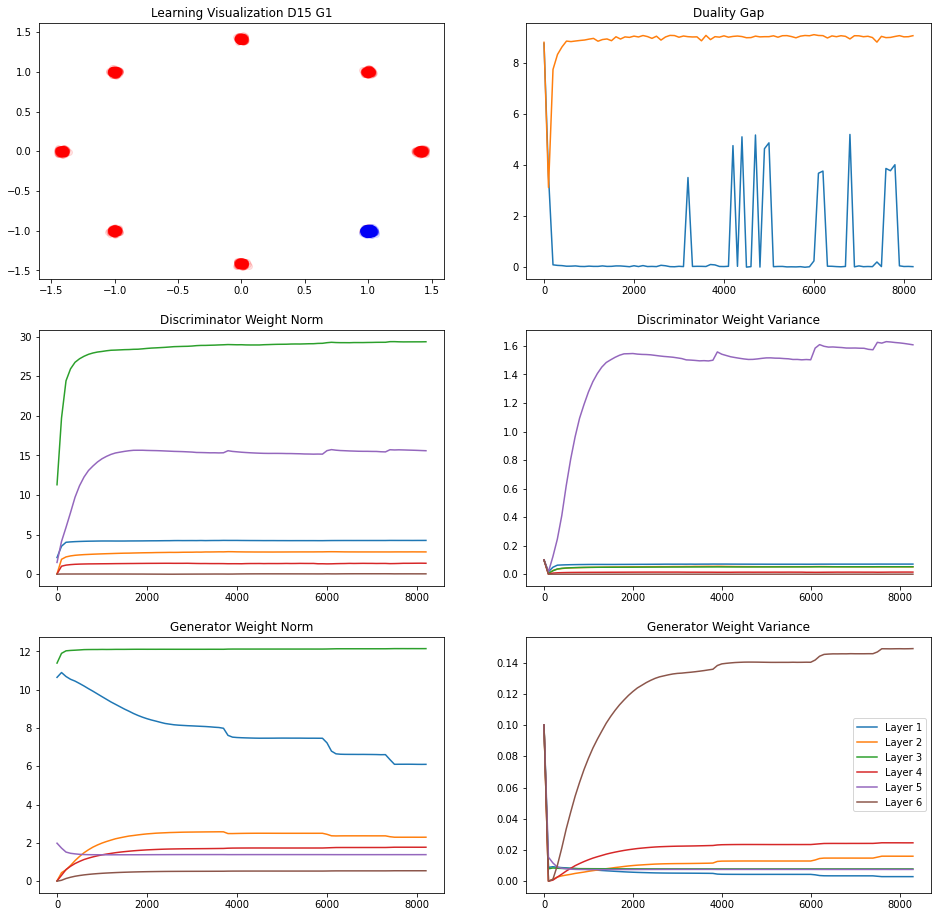

248/250 [============================>.] - ETA: 0sIteration : 8300 [D loss: 0.161614, acc.: 95.31%] [G loss: 2.240777]
Vanilla   Duality GAP :  0.01684168
L Random  Duality Gap :  9.022789


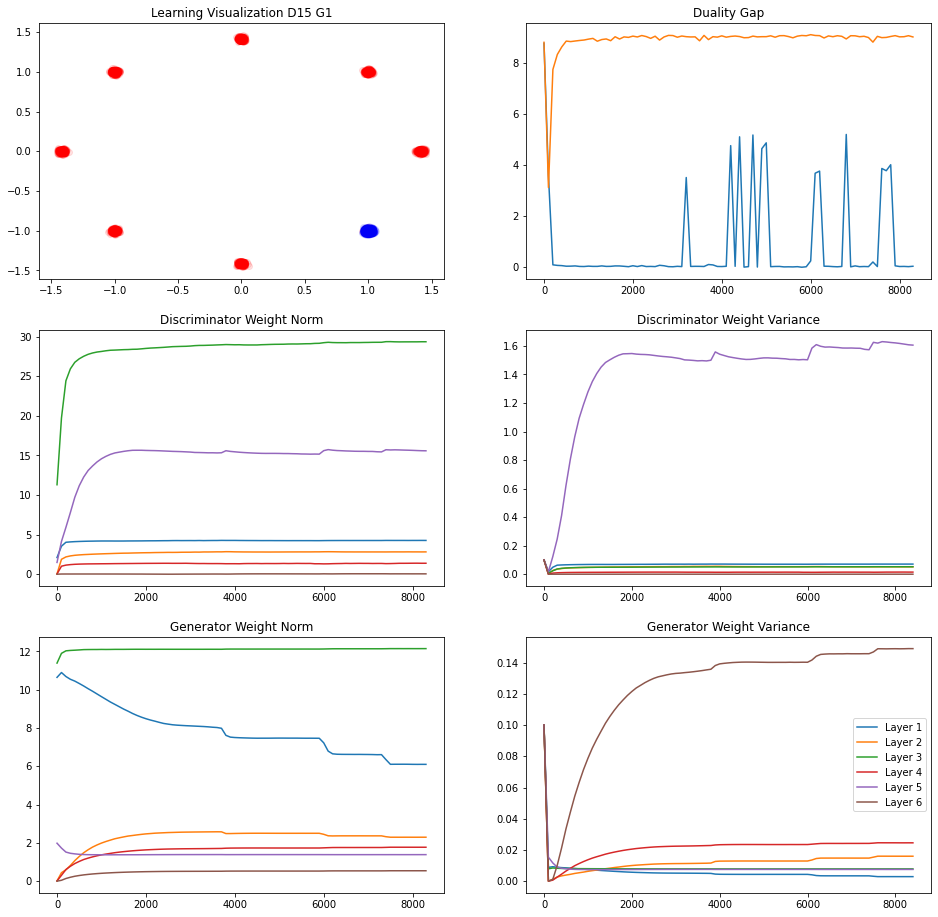

239/250 [===========================>..] - ETA: 0sIteration : 8400 [D loss: 0.179467, acc.: 94.53%] [G loss: 2.190957]
Vanilla   Duality GAP :  -0.008690476
L Random  Duality Gap :  9.072396


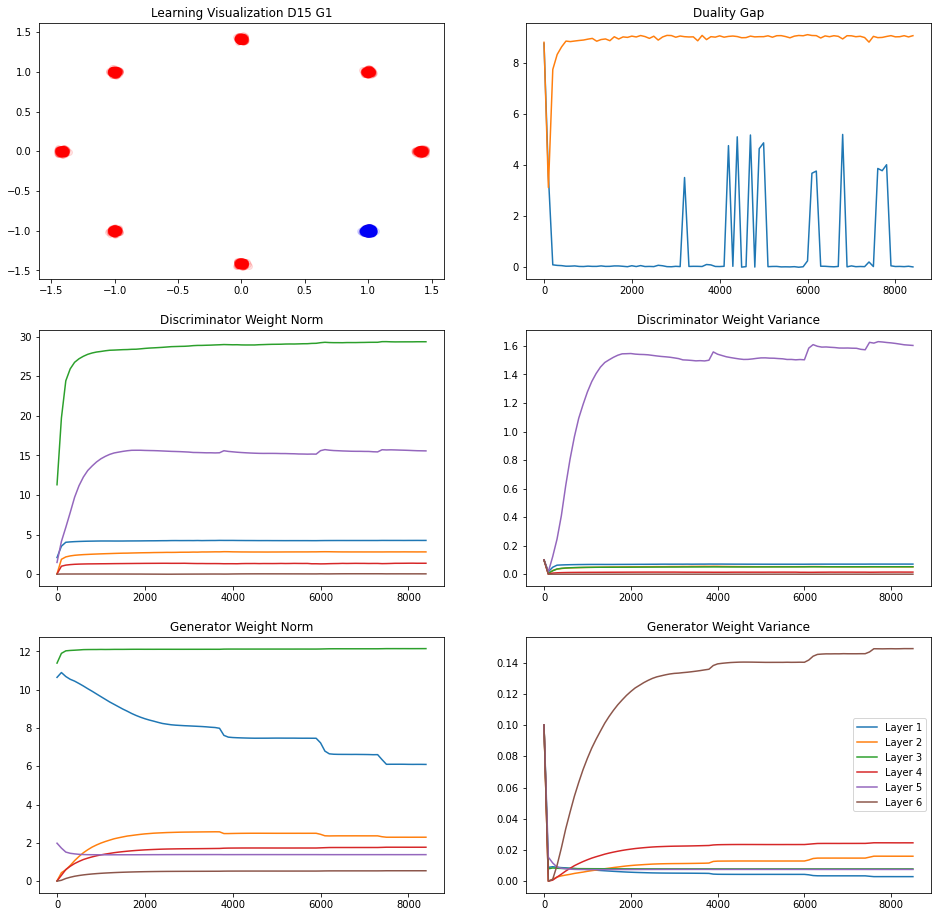

243/250 [============================>.] - ETA: 0sIteration : 8500 [D loss: 0.179244, acc.: 94.53%] [G loss: 2.223273]
Vanilla   Duality GAP :  0.006342411
L Random  Duality Gap :  9.06628


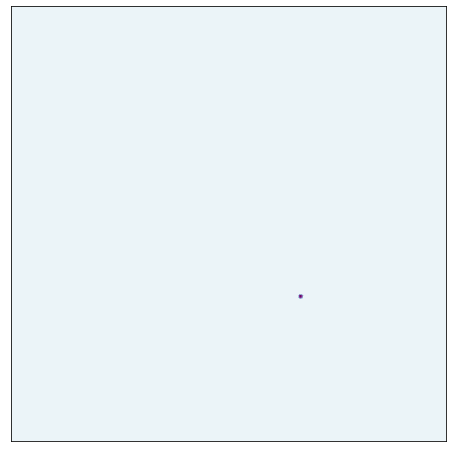

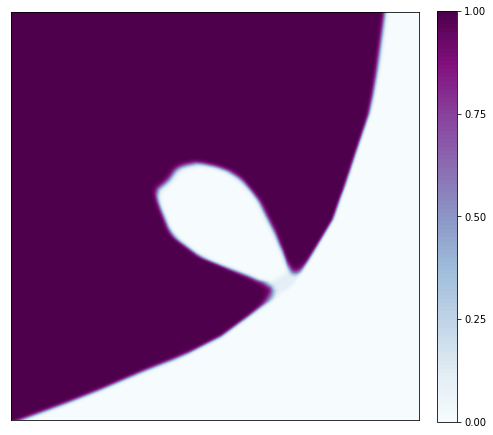

243/250 [============================>.] - ETA: 0sIteration : 8600 [D loss: 0.196634, acc.: 93.75%] [G loss: 2.207422]
Vanilla   Duality GAP :  0.011274904
L Random  Duality Gap :  8.94219


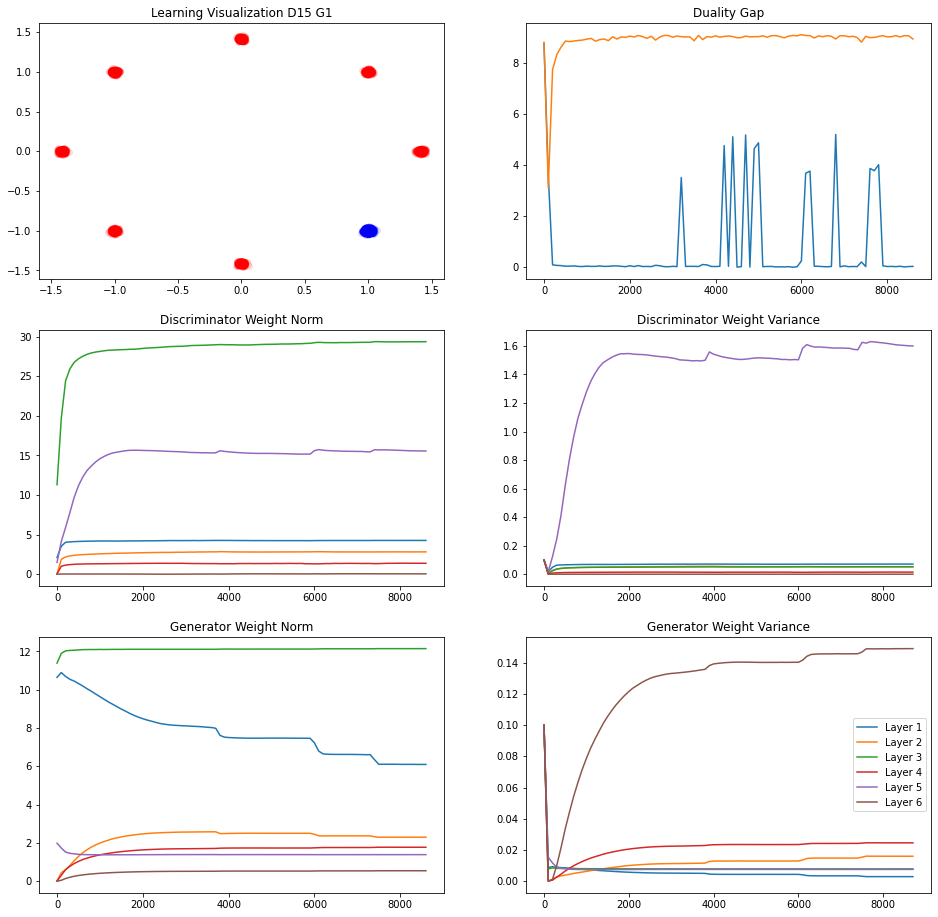

242/250 [============================>.] - ETA: 0sIteration : 8700 [D loss: 0.196587, acc.: 93.75%] [G loss: 2.208055]
Vanilla   Duality GAP :  -0.008258134
L Random  Duality Gap :  9.043783


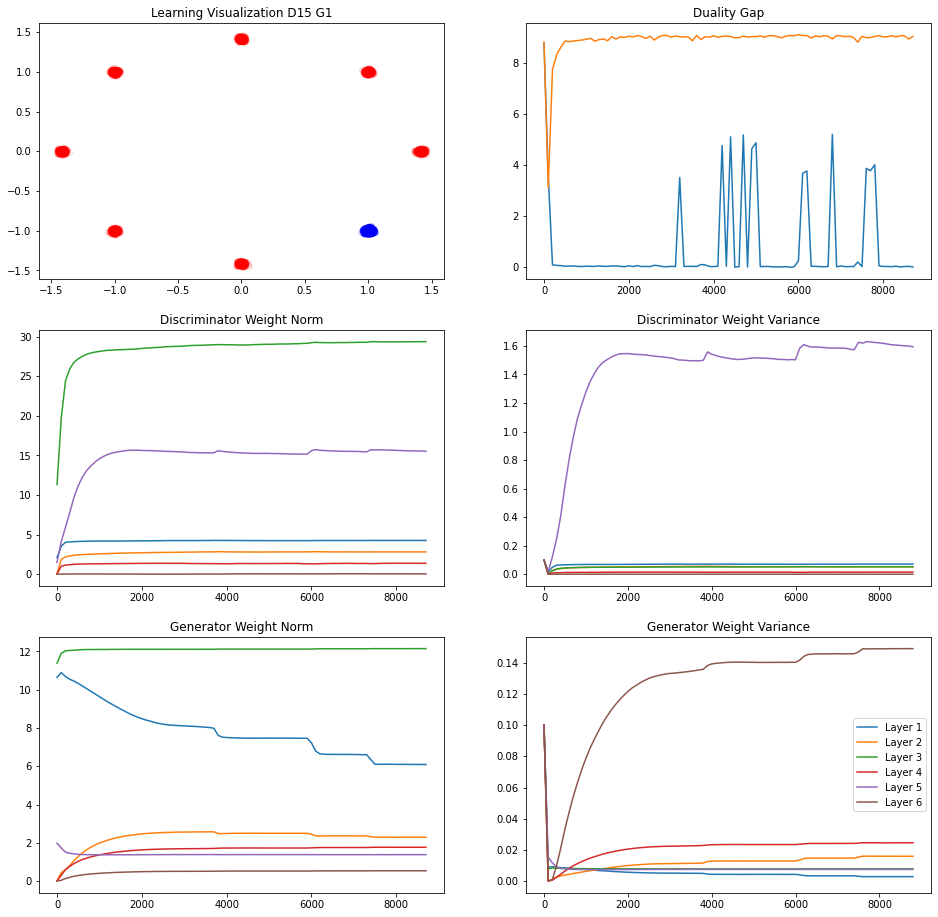

241/250 [===========================>..] - ETA: 0sIteration : 8800 [D loss: 0.170643, acc.: 94.92%] [G loss: 2.212016]
Vanilla   Duality GAP :  0.00010678172
L Random  Duality Gap :  9.070677


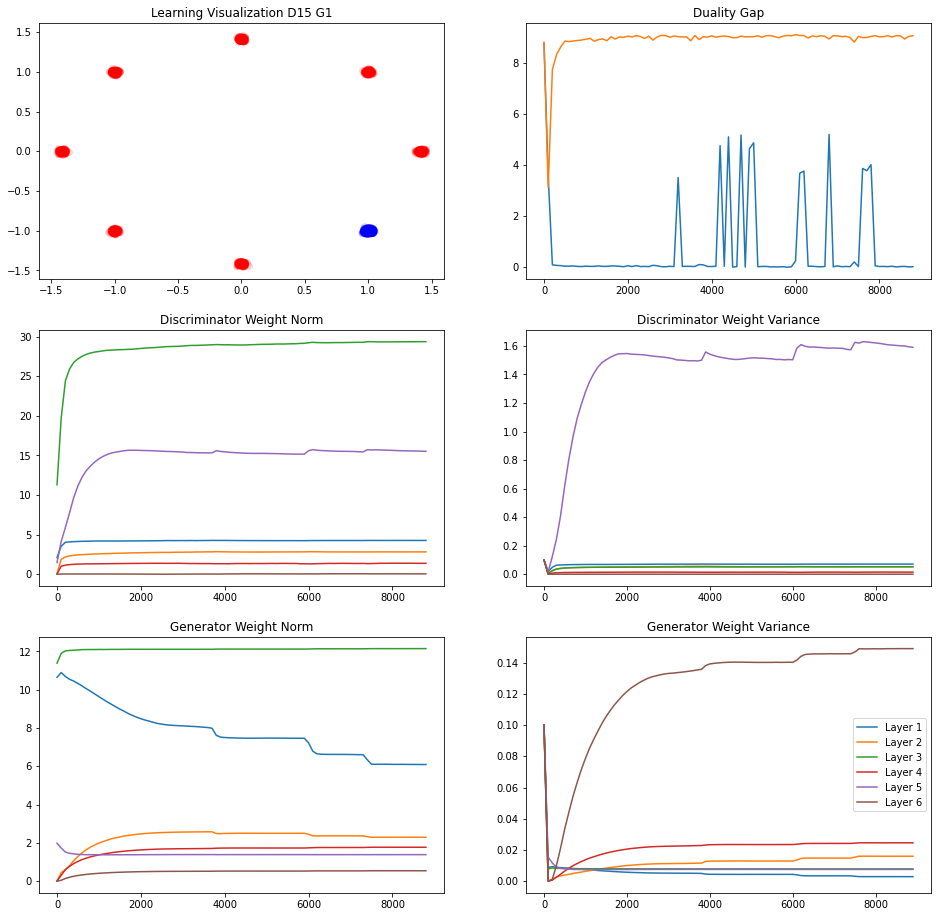

241/250 [===========================>..] - ETA: 0sIteration : 8900 [D loss: 0.152885, acc.: 95.70%] [G loss: 2.231406]
Vanilla   Duality GAP :  0.0022184849
L Random  Duality Gap :  9.043547


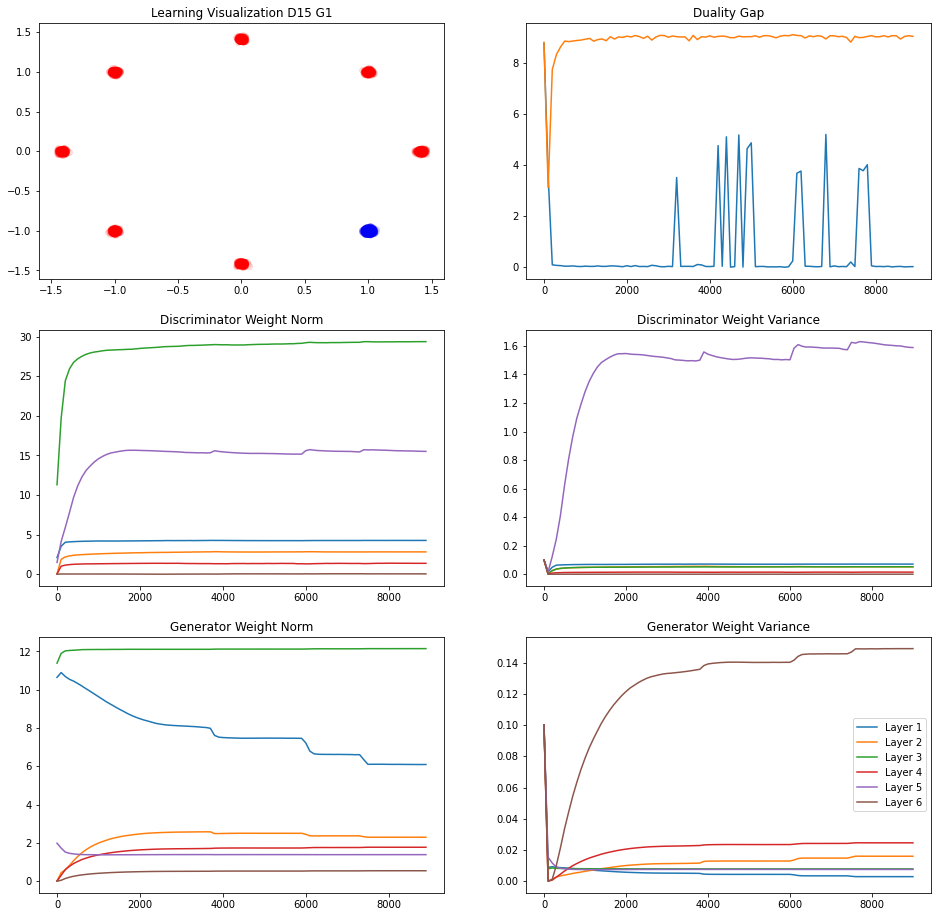

241/250 [===========================>..] - ETA: 0sIteration : 9000 [D loss: 0.188047, acc.: 94.14%] [G loss: 2.187052]
Vanilla   Duality GAP :  0.005384445
L Random  Duality Gap :  9.072608


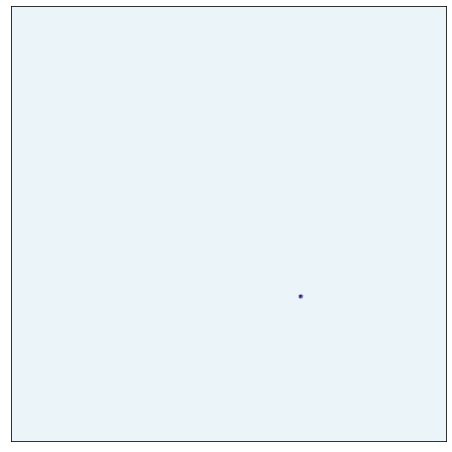

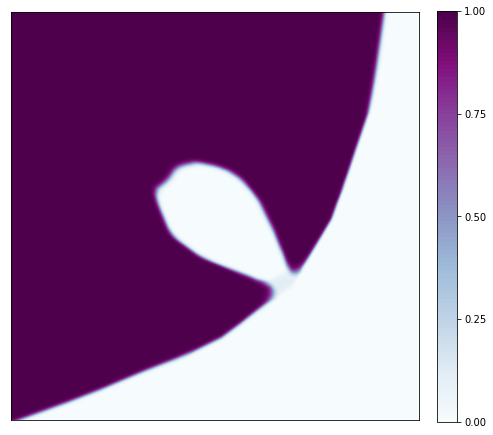

243/250 [============================>.] - ETA: 0sIteration : 9100 [D loss: 0.144268, acc.: 96.09%] [G loss: 2.227918]
Vanilla   Duality GAP :  -0.0021548867
L Random  Duality Gap :  9.071321


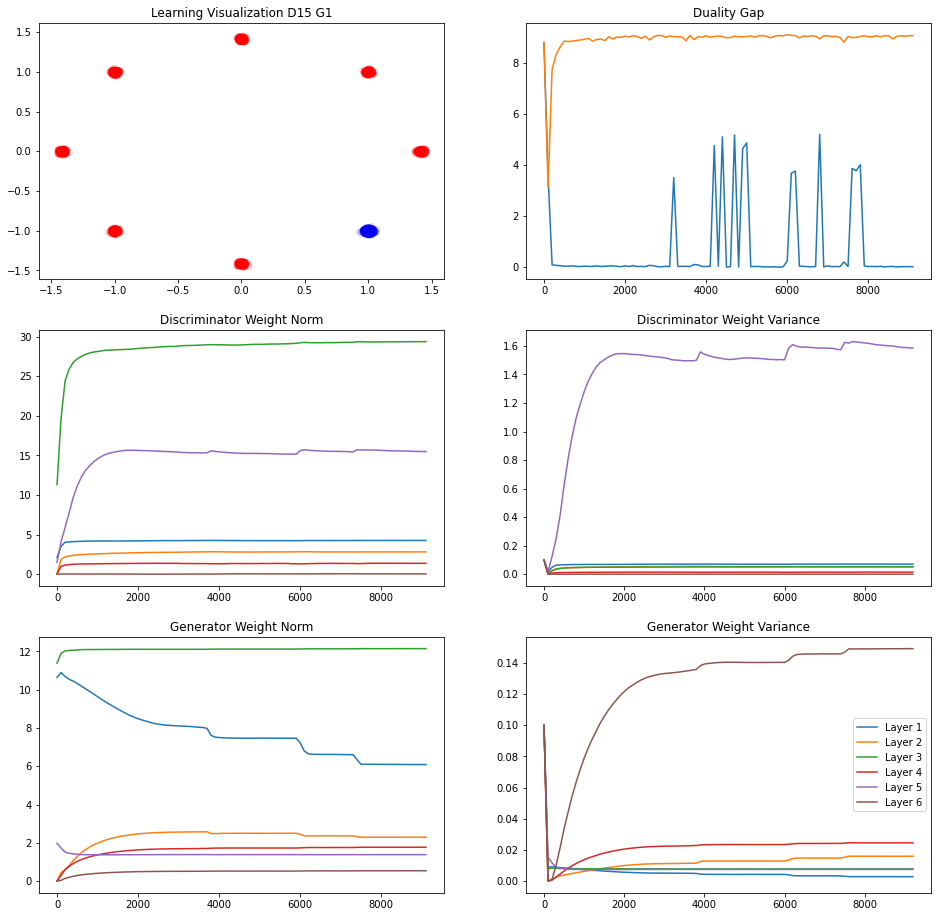

244/250 [============================>.] - ETA: 0sIteration : 9200 [D loss: 0.213873, acc.: 92.97%] [G loss: 2.200769]
Vanilla   Duality GAP :  -0.0012159348
L Random  Duality Gap :  9.013749


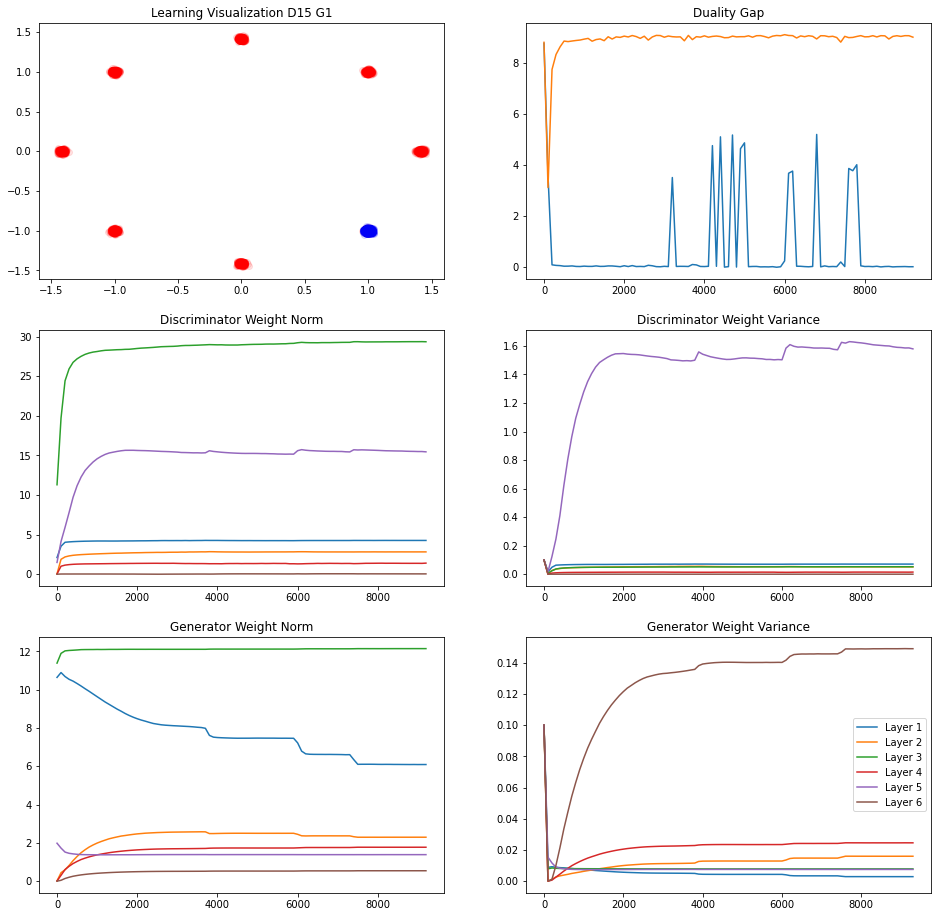

238/250 [===========================>..] - ETA: 0sIteration : 9300 [D loss: 0.196716, acc.: 93.75%] [G loss: 2.158427]
Vanilla   Duality GAP :  0.0042382777
L Random  Duality Gap :  9.043464


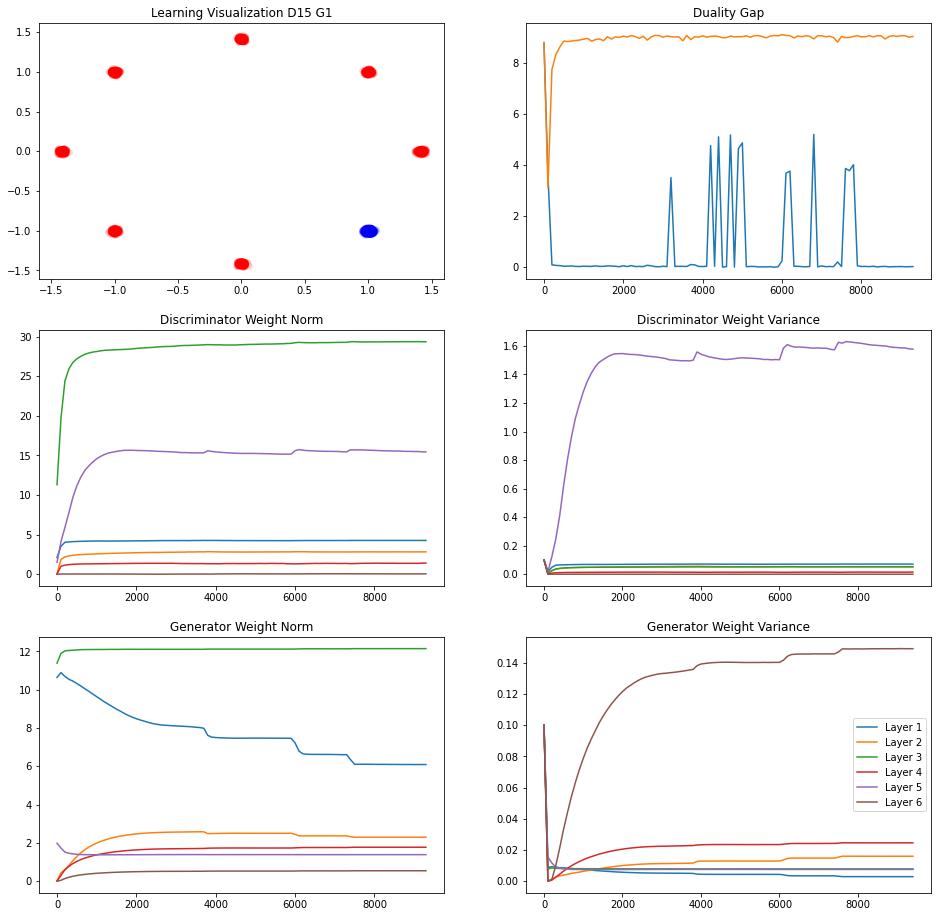

245/250 [============================>.] - ETA: 0sIteration : 9400 [D loss: 0.205285, acc.: 93.36%] [G loss: 2.203287]
Vanilla   Duality GAP :  -0.0074347854
L Random  Duality Gap :  9.0399885


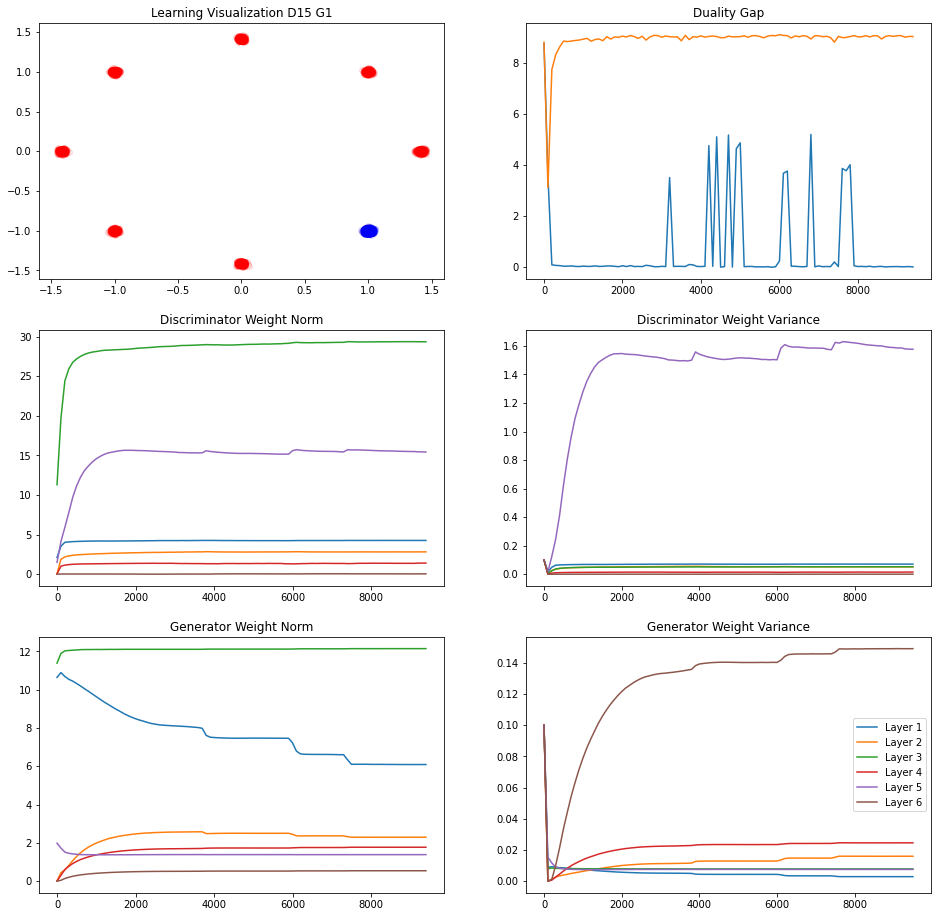

244/250 [============================>.] - ETA: 0sIteration : 9500 [D loss: 0.196660, acc.: 93.75%] [G loss: 2.240563]
Vanilla   Duality GAP :  -0.005093187
L Random  Duality Gap :  9.068038


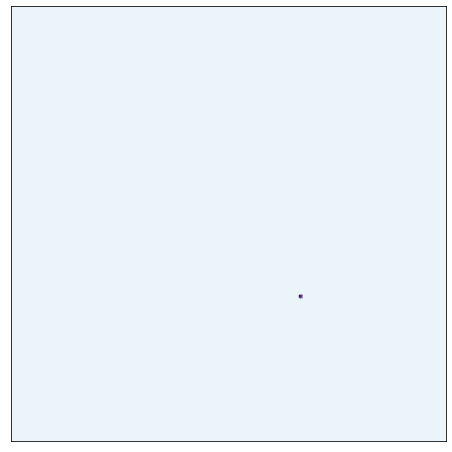

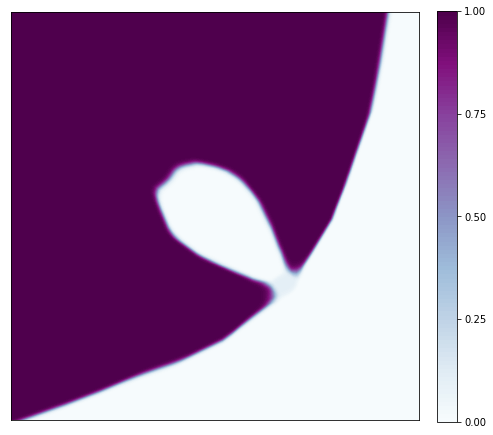

242/250 [============================>.] - ETA: 0sIteration : 9600 [D loss: 0.196596, acc.: 93.75%] [G loss: 2.179794]
Vanilla   Duality GAP :  -0.010231942
L Random  Duality Gap :  9.033764


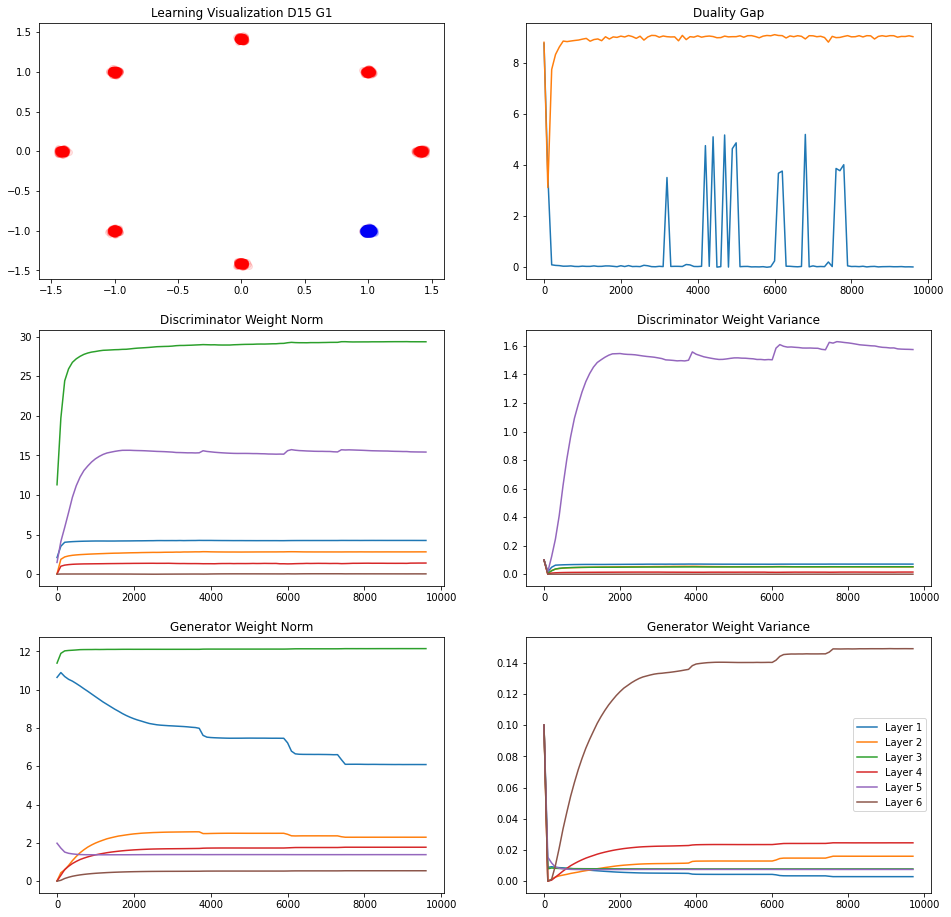

242/250 [============================>.] - ETA: 0sIteration : 9700 [D loss: 0.179435, acc.: 94.53%] [G loss: 2.190948]
Vanilla   Duality GAP :  -0.010426819
L Random  Duality Gap :  9.027192


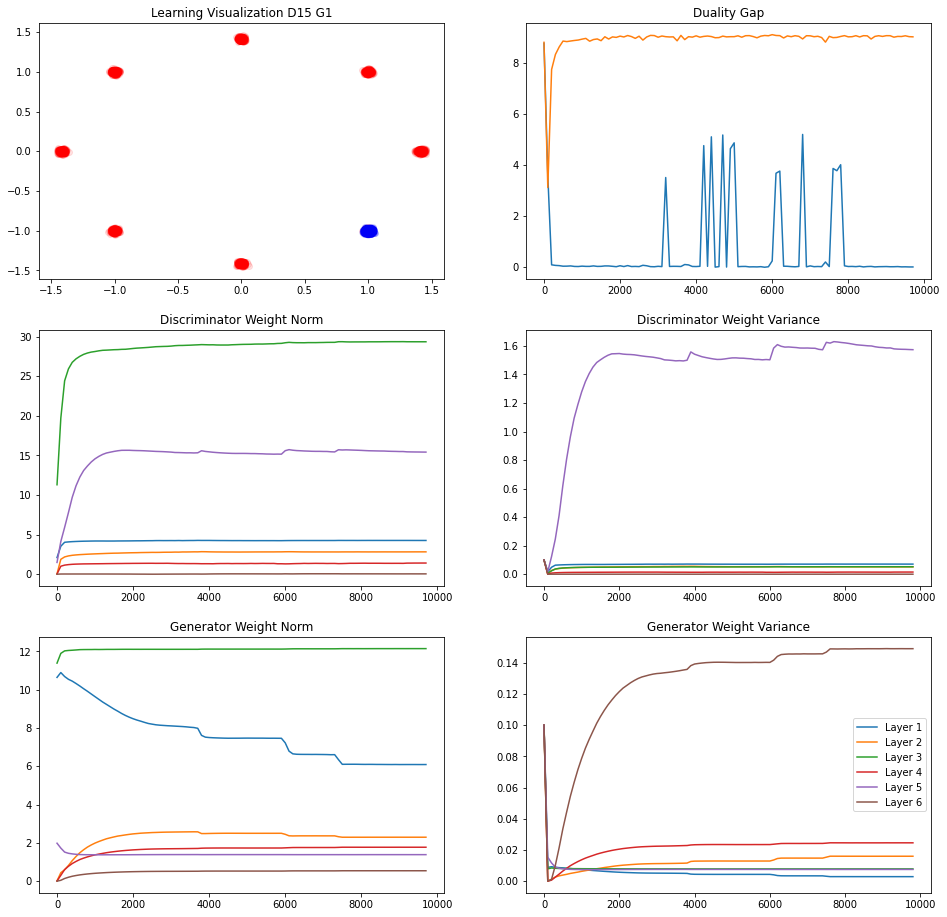

249/250 [============================>.] - ETA: 0sIteration : 9800 [D loss: 0.196638, acc.: 93.75%] [G loss: 2.185004]
Vanilla   Duality GAP :  -0.019042164
L Random  Duality Gap :  9.075573


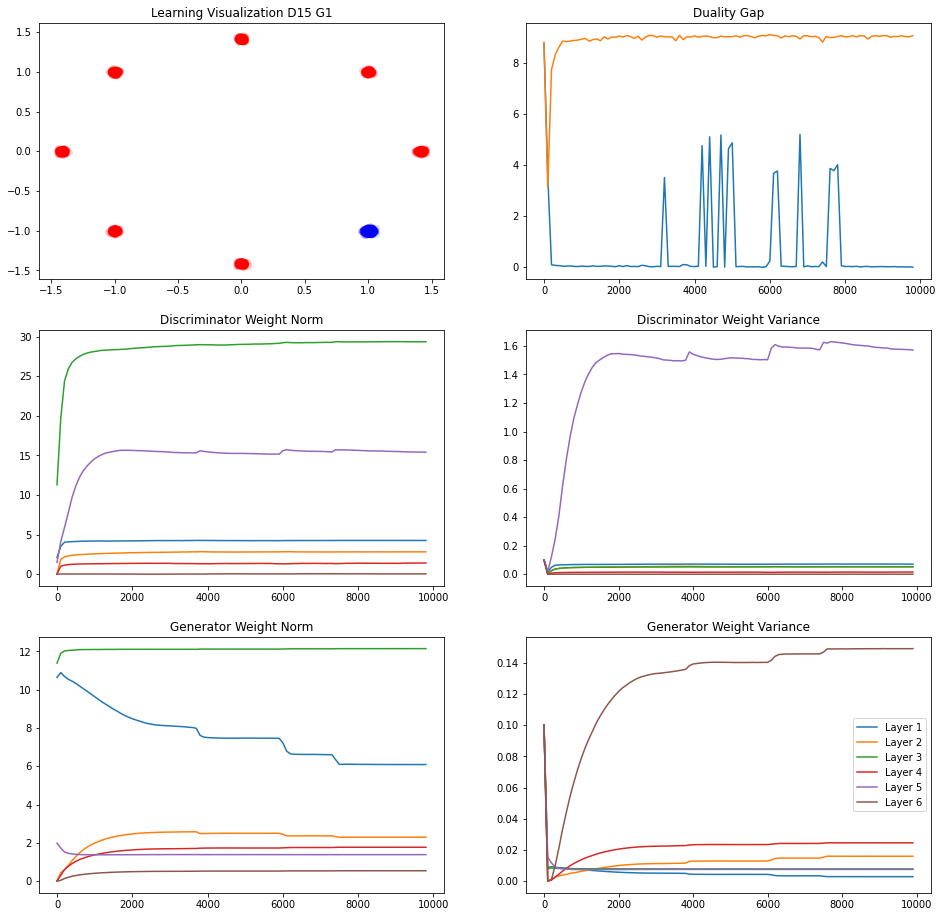

249/250 [============================>.] - ETA: 0sIteration : 9900 [D loss: 0.205229, acc.: 93.36%] [G loss: 2.220570]
Vanilla   Duality GAP :  0.0075824857
L Random  Duality Gap :  8.998361


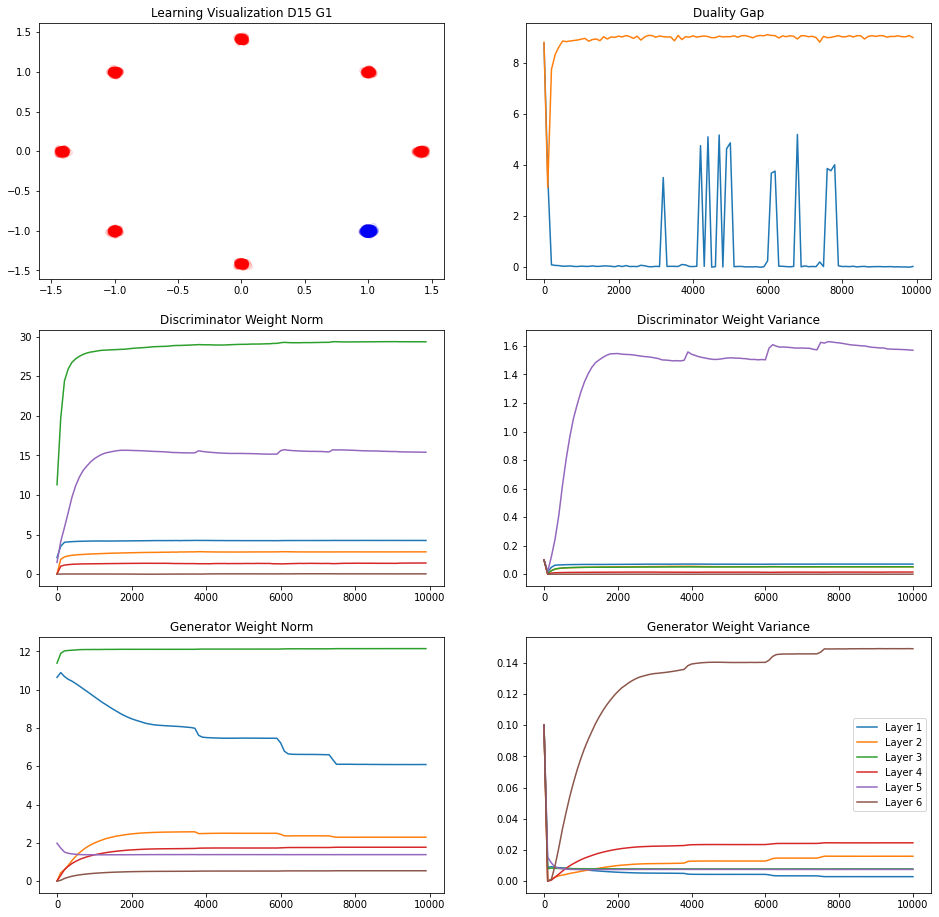

246/250 [============================>.] - ETA: 0sIteration : 10000 [D loss: 0.196624, acc.: 93.75%] [G loss: 2.238534]
Vanilla   Duality GAP :  -0.011544257
L Random  Duality Gap :  9.055128


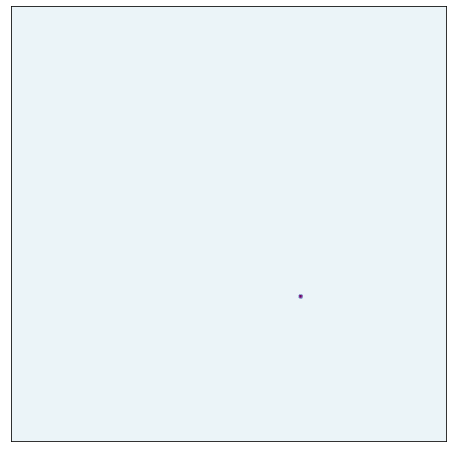

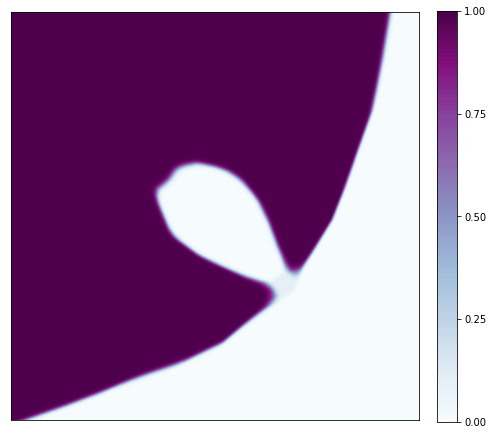

10000/10001 [============================>.] - ETA: 0s----------------------------------------------------------------------------------------------------
		8_modes GAN divergence
----------------------------------------------------------------------------------------------------
./Experiments/8_modes/GAN/divergence
8_modes divergence
1 15
 M1 - Random : False
236/250 [===========================>..] - ETA: 0sIteration : 0 [D loss: 0.714104, acc.: 33.59%] [G loss: 0.694056]
Vanilla   Duality GAP :  0.8927643
L Random  Duality Gap :  0.9069568


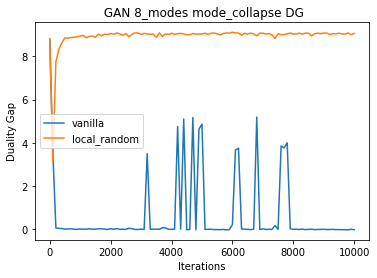

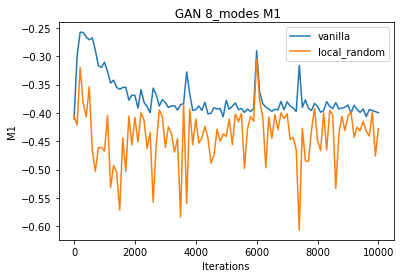

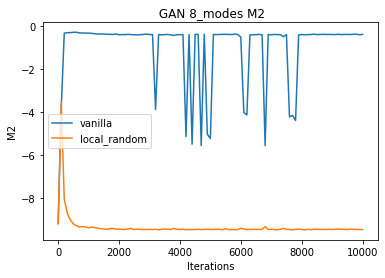

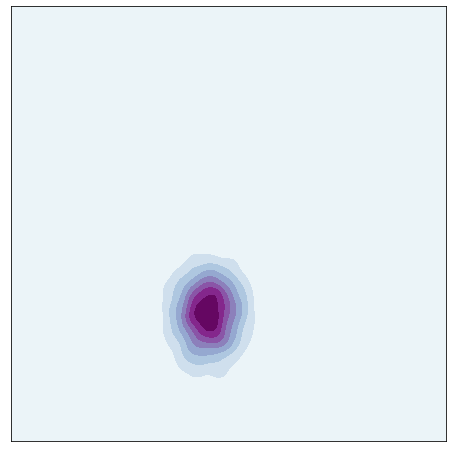

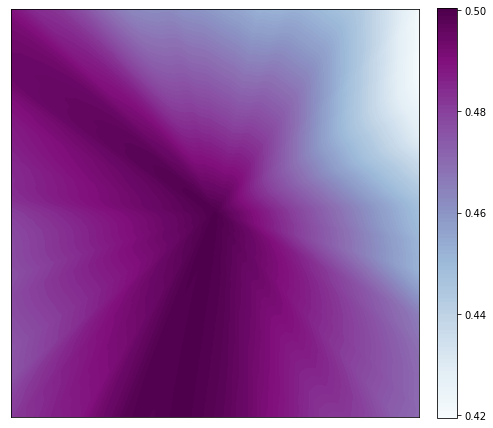

236/250 [===========================>..] - ETA: 0sIteration : 100 [D loss: 0.682514, acc.: 50.00%] [G loss: 0.759692]
Vanilla   Duality GAP :  1.19326
L Random  Duality Gap :  1.244913


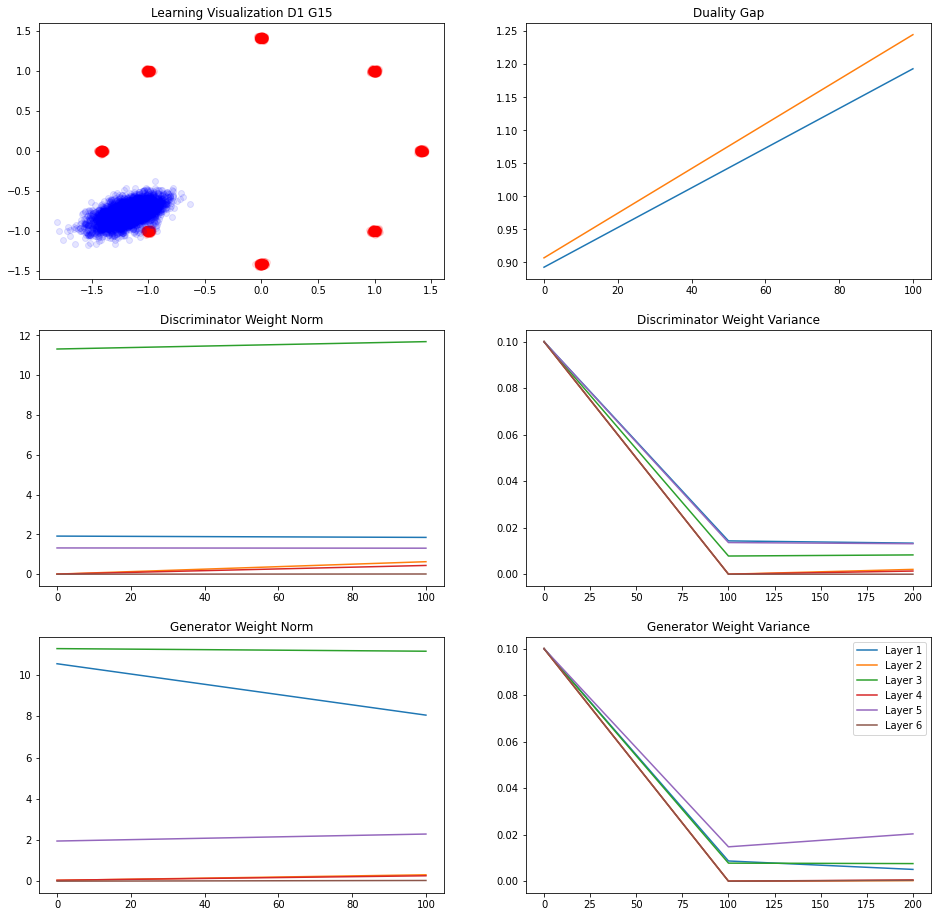

247/250 [============================>.] - ETA: 0sIteration : 200 [D loss: 0.687864, acc.: 50.00%] [G loss: 0.741430]
Vanilla   Duality GAP :  0.95750976
L Random  Duality Gap :  1.0090389


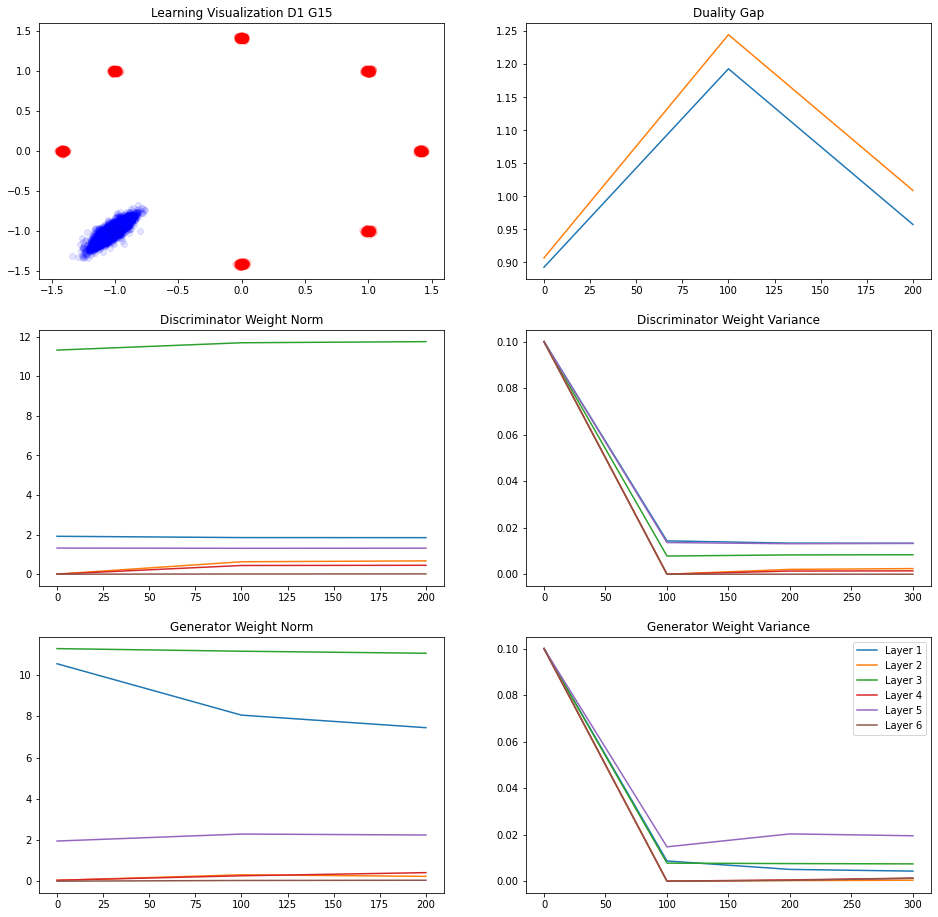

249/250 [============================>.] - ETA: 0sIteration : 300 [D loss: 0.676034, acc.: 63.67%] [G loss: 0.780819]
Vanilla   Duality GAP :  0.9760934
L Random  Duality Gap :  1.0905429


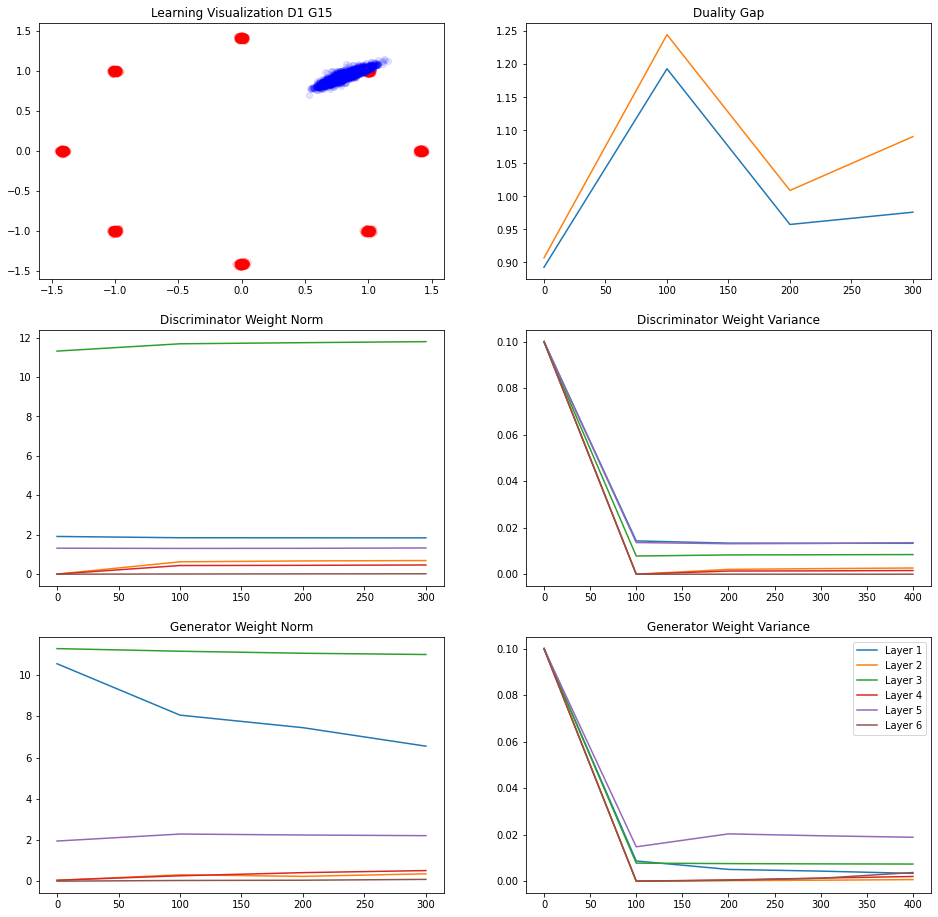

244/250 [============================>.] - ETA: 0sIteration : 400 [D loss: 0.703010, acc.: 65.23%] [G loss: 0.714364]
Vanilla   Duality GAP :  0.98519856
L Random  Duality Gap :  1.0864508


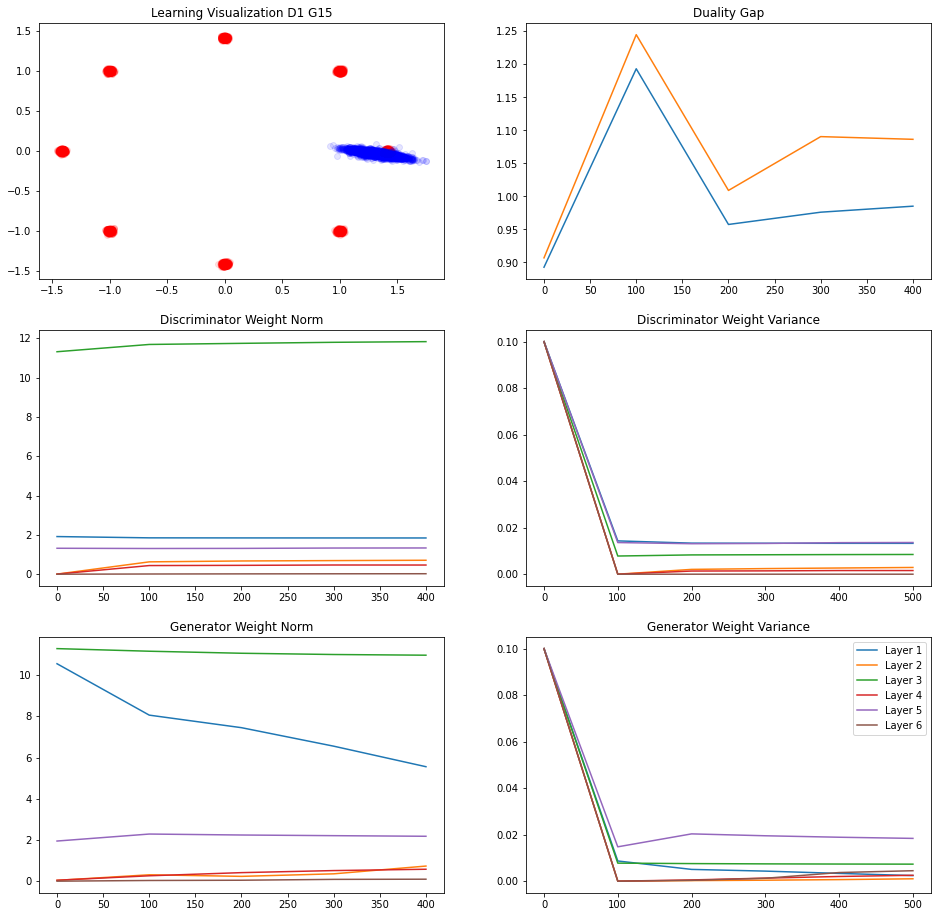

241/250 [===========================>..] - ETA: 0sIteration : 500 [D loss: 0.707411, acc.: 25.78%] [G loss: 0.667332]
Vanilla   Duality GAP :  1.0035133
L Random  Duality Gap :  1.0341284


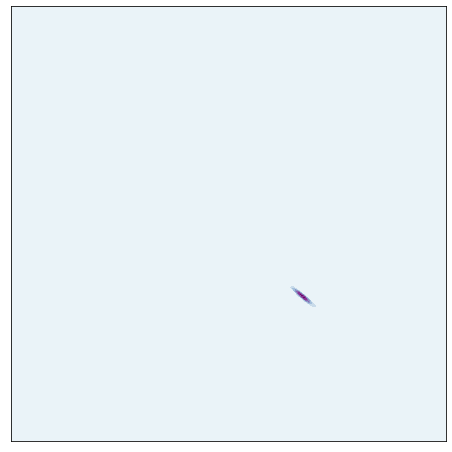

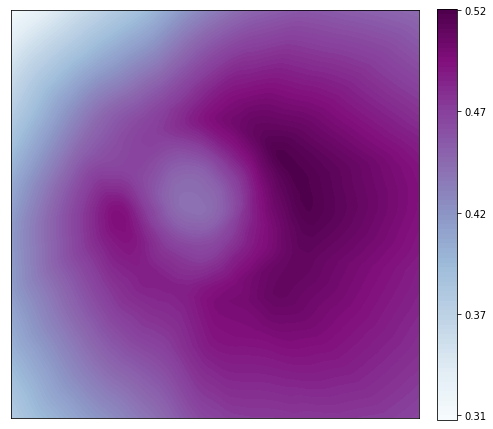

244/250 [============================>.] - ETA: 0sIteration : 600 [D loss: 0.697454, acc.: 50.00%] [G loss: 0.734433]
Vanilla   Duality GAP :  1.1129857
L Random  Duality Gap :  1.1995928


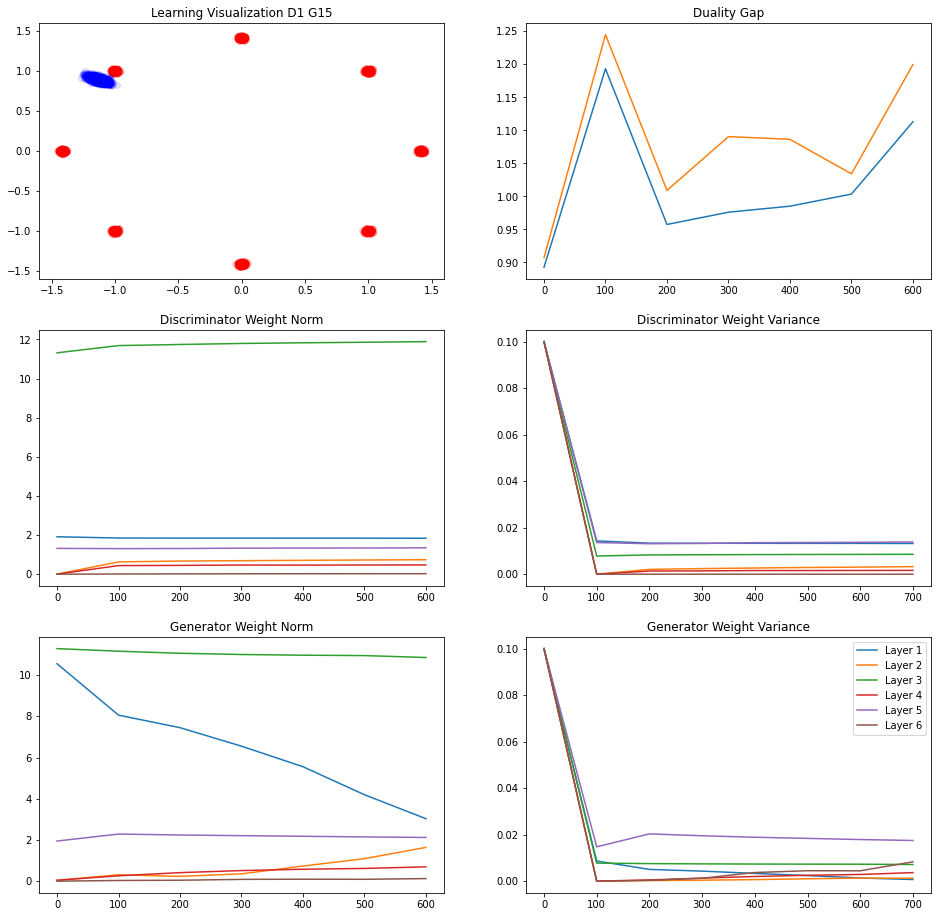

248/250 [============================>.] - ETA: 0sIteration : 700 [D loss: 0.683377, acc.: 68.75%] [G loss: 0.744302]
Vanilla   Duality GAP :  0.9436823
L Random  Duality Gap :  0.94958854


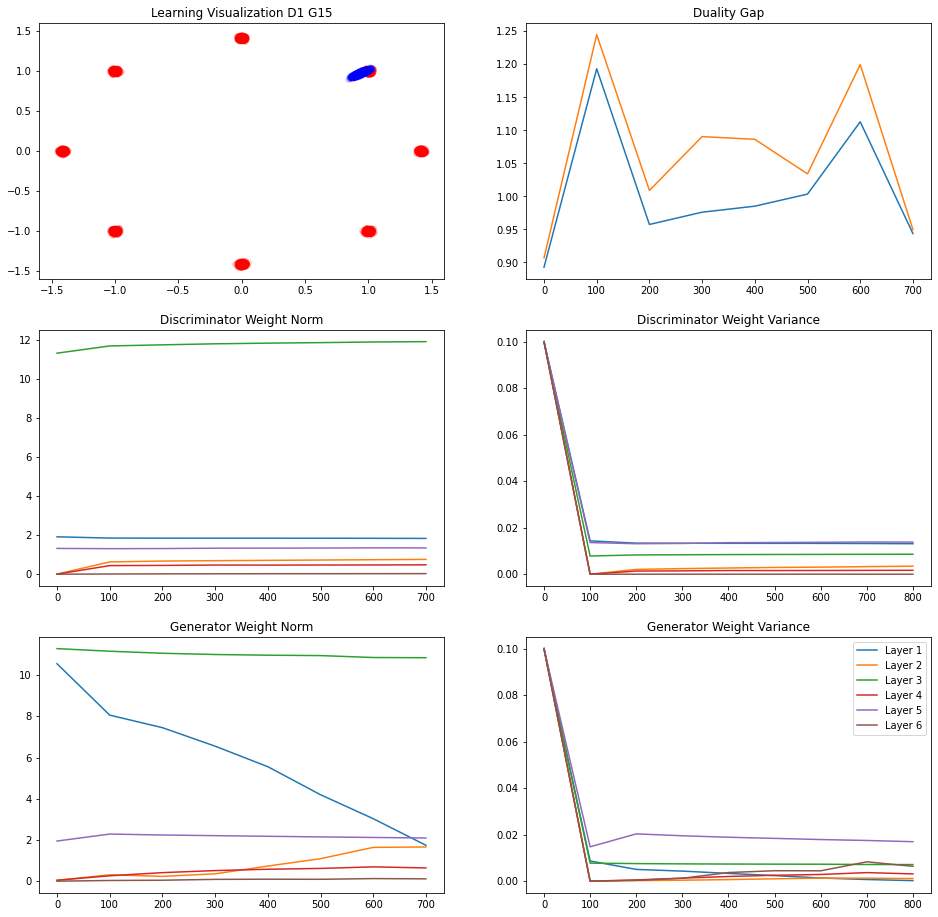

240/250 [===========================>..] - ETA: 0sIteration : 800 [D loss: 0.669006, acc.: 68.36%] [G loss: 0.771034]
Vanilla   Duality GAP :  1.0217235
L Random  Duality Gap :  1.0790124


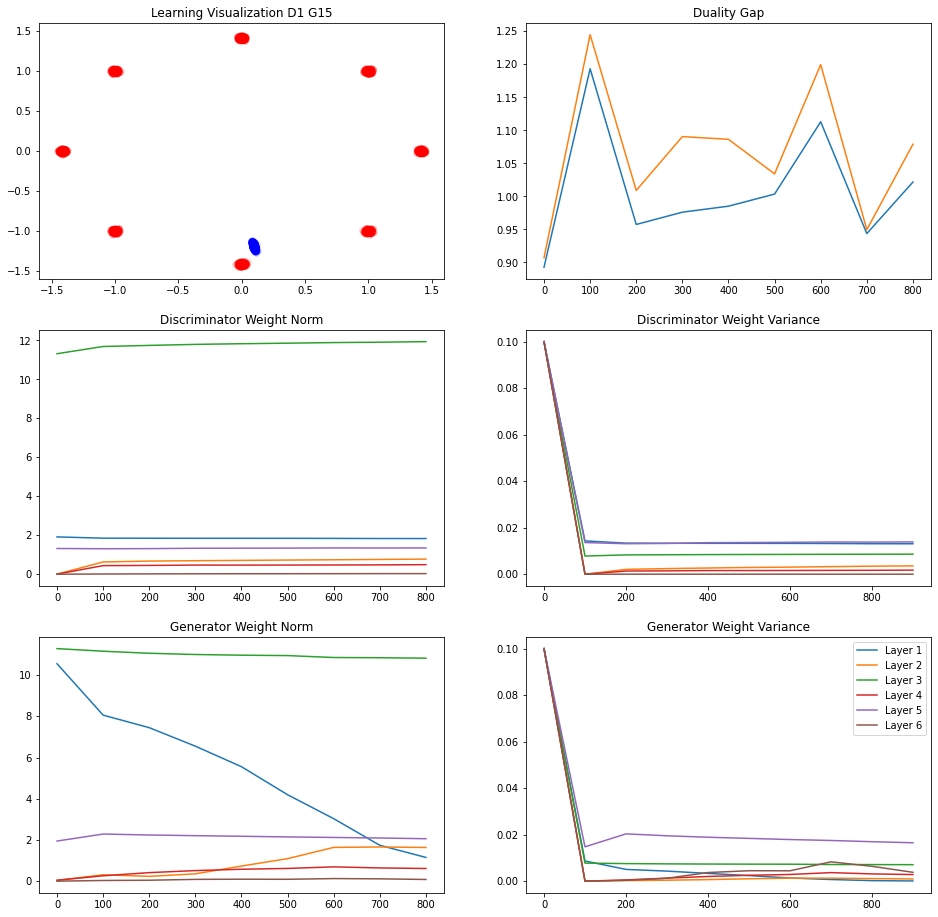

249/250 [============================>.] - ETA: 0sIteration : 900 [D loss: 0.787777, acc.: 21.09%] [G loss: 0.412522]
Vanilla   Duality GAP :  5.9452558
L Random  Duality Gap :  6.270126


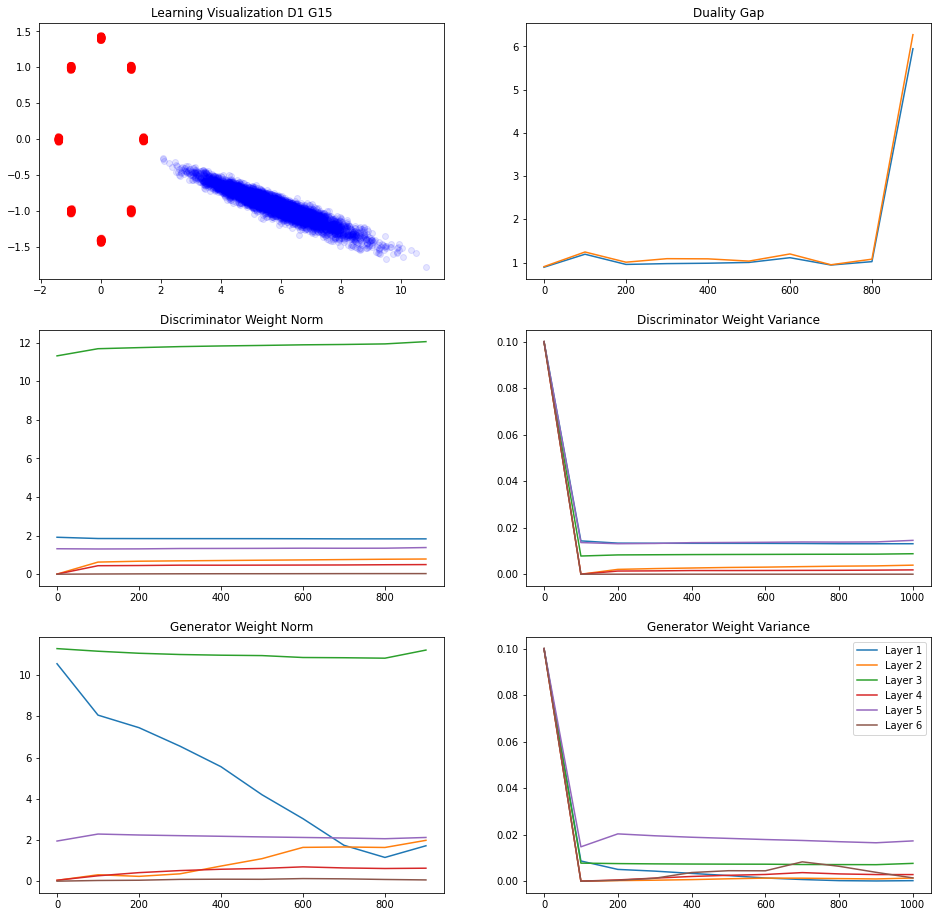

246/250 [============================>.] - ETA: 0sIteration : 1000 [D loss: 0.667003, acc.: 72.27%] [G loss: 0.763116]
Vanilla   Duality GAP :  1.1334769
L Random  Duality Gap :  1.1803554


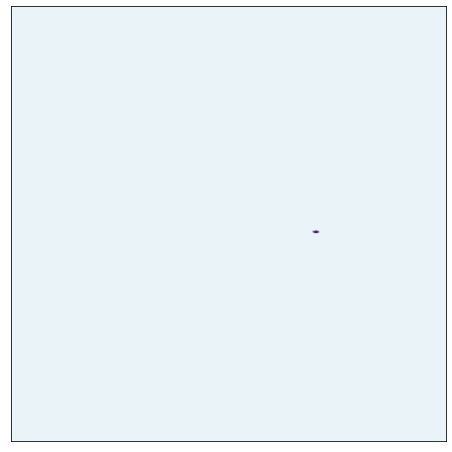

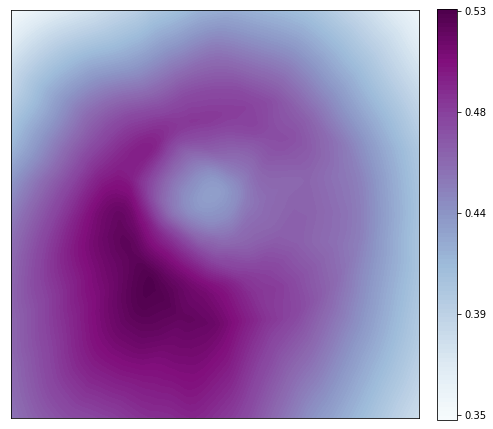

245/250 [============================>.] - ETA: 0sIteration : 1100 [D loss: 0.666265, acc.: 65.62%] [G loss: 0.782811]
Vanilla   Duality GAP :  0.9572569
L Random  Duality Gap :  1.0829804


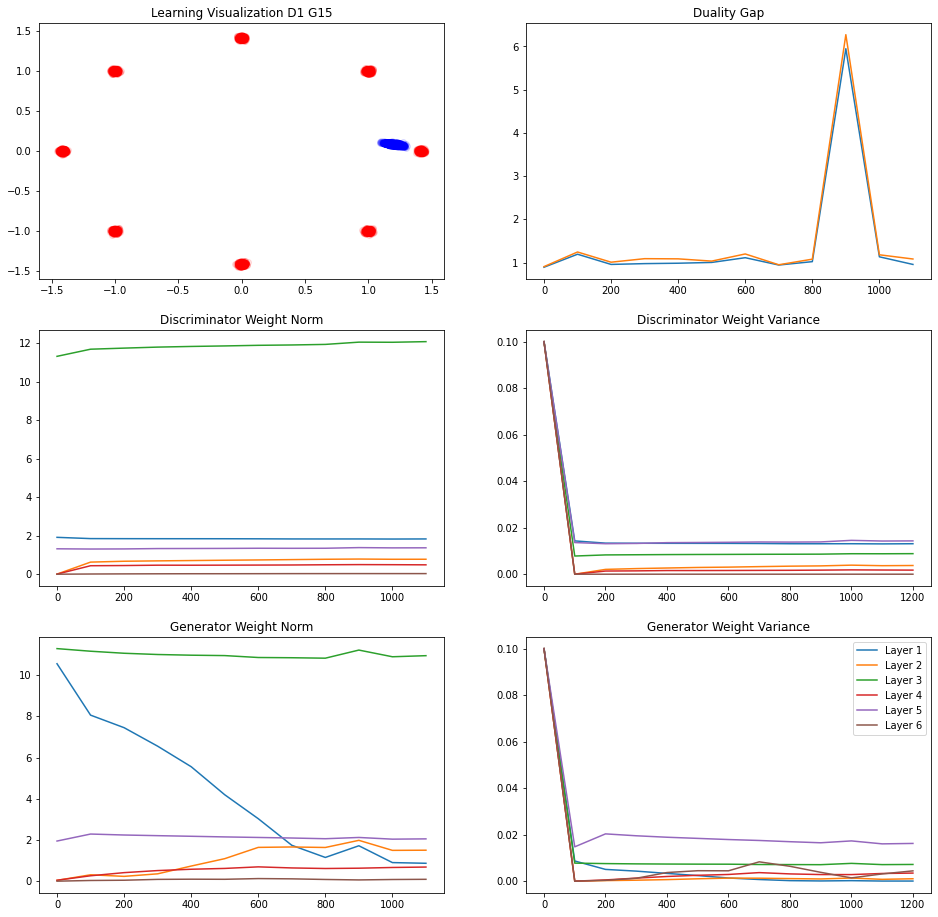

248/250 [============================>.] - ETA: 0sIteration : 1200 [D loss: 0.657982, acc.: 81.64%] [G loss: 0.765463]
Vanilla   Duality GAP :  1.0319415
L Random  Duality Gap :  1.0914673


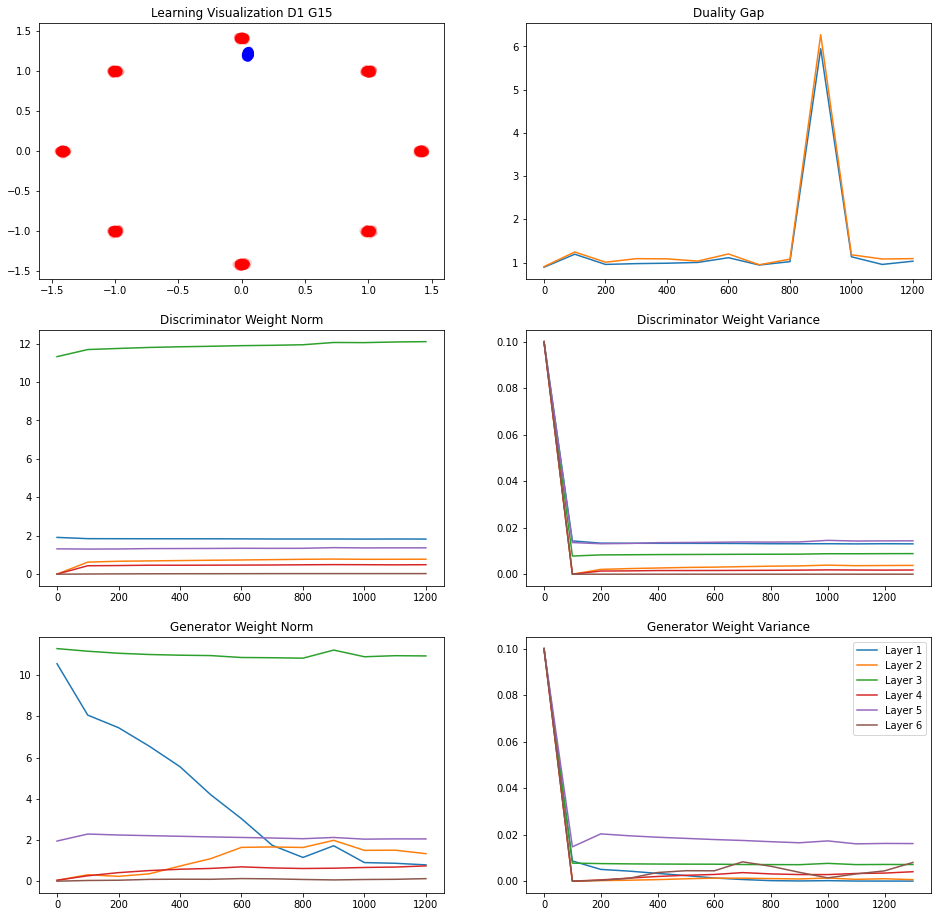

234/250 [===========================>..] - ETA: 0sIteration : 1300 [D loss: 0.713816, acc.: 30.86%] [G loss: 0.658385]
Vanilla   Duality GAP :  1.0322101
L Random  Duality Gap :  1.0388801


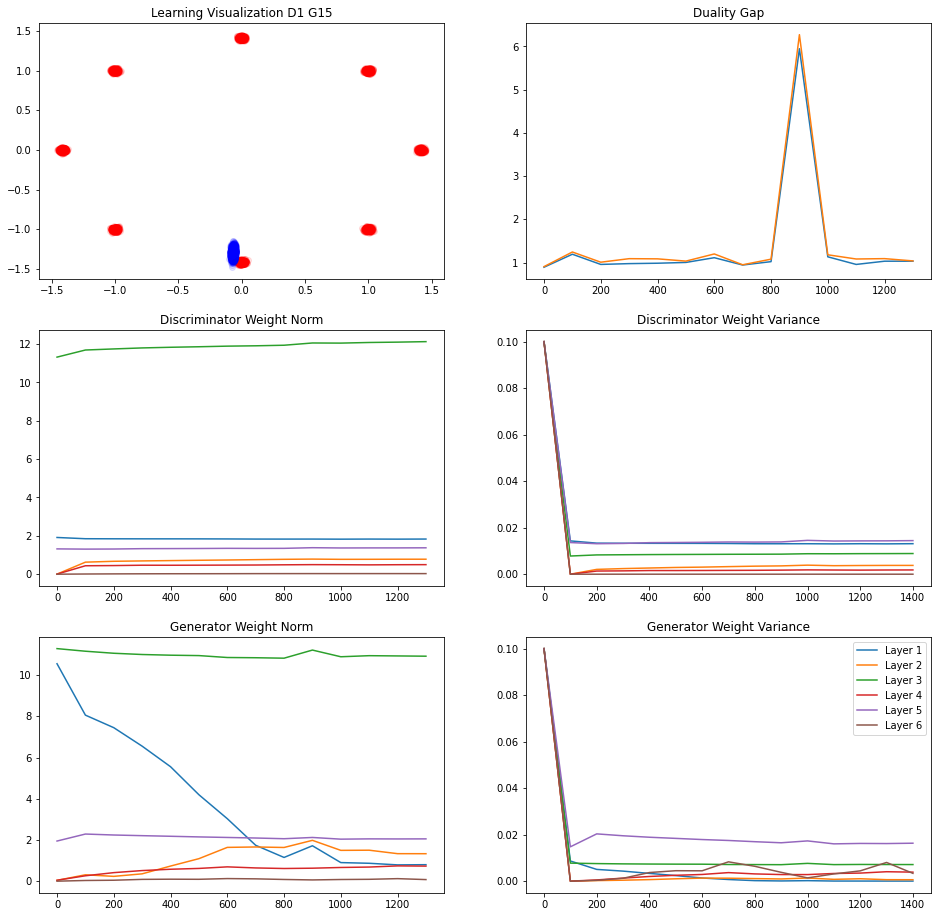

244/250 [============================>.] - ETA: 0sIteration : 1400 [D loss: 0.634684, acc.: 81.64%] [G loss: 0.833990]
Vanilla   Duality GAP :  0.913977
L Random  Duality Gap :  1.0954033


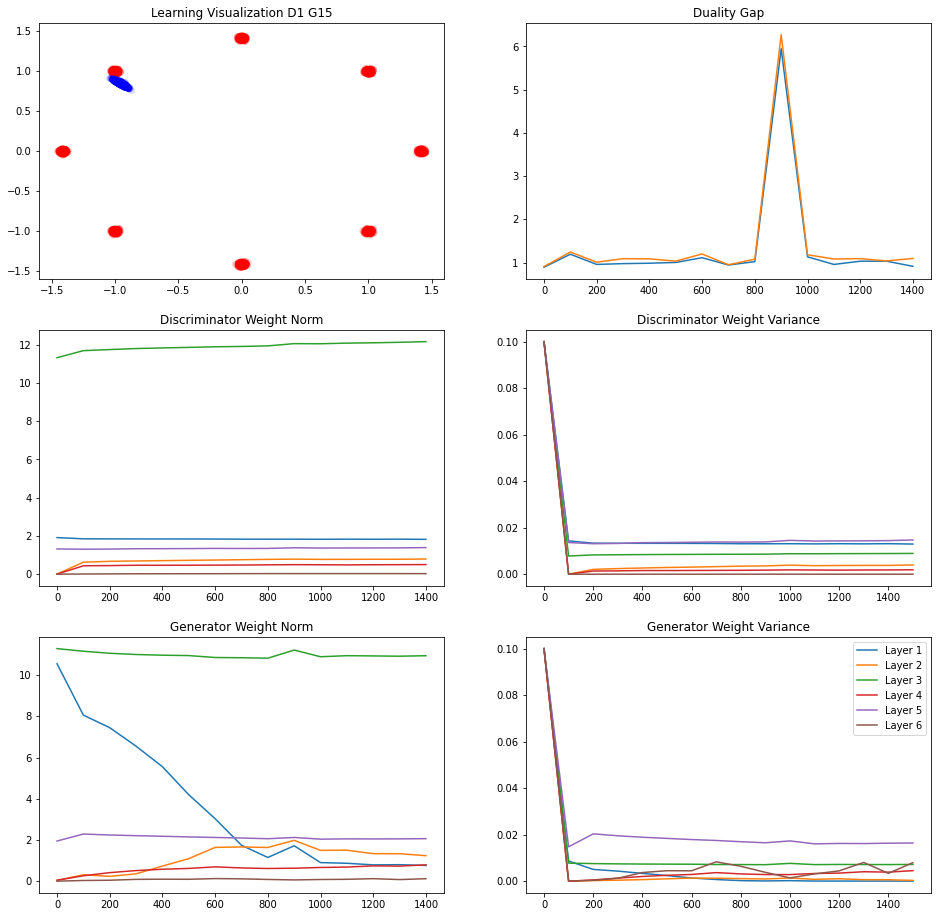

249/250 [============================>.] - ETA: 0sIteration : 1500 [D loss: 0.706015, acc.: 25.78%] [G loss: 0.677069]
Vanilla   Duality GAP :  1.0130845
L Random  Duality Gap :  1.0430061


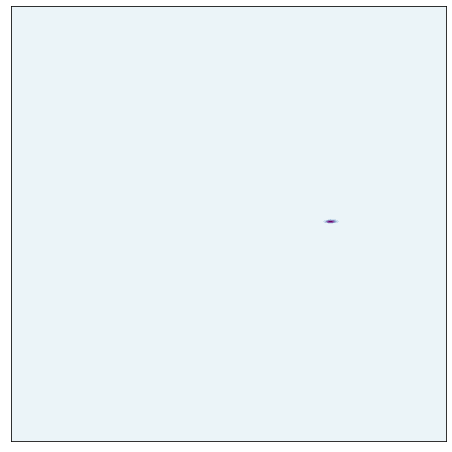

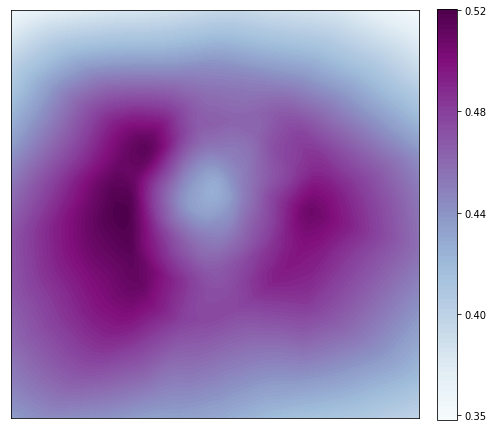

247/250 [============================>.] - ETA: 0sIteration : 1600 [D loss: 0.639488, acc.: 77.34%] [G loss: 0.671395]
Vanilla   Duality GAP :  1.2526262
L Random  Duality Gap :  1.3931283


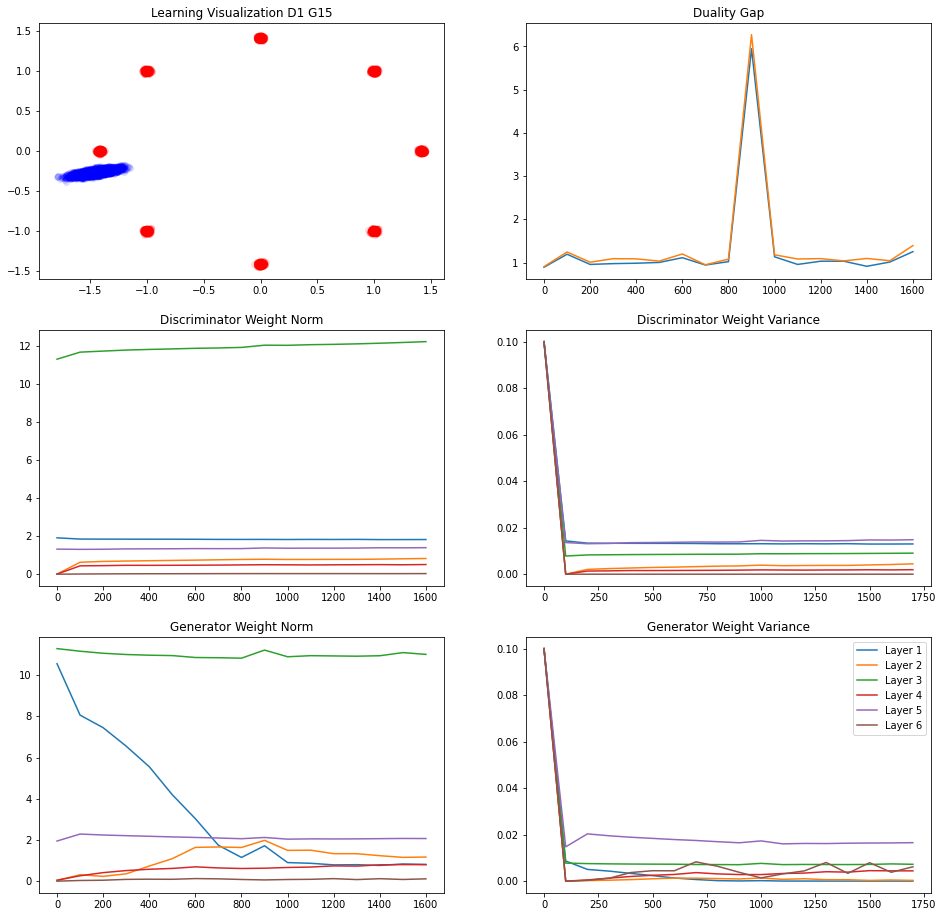

239/250 [===========================>..] - ETA: 0sIteration : 1700 [D loss: 0.693511, acc.: 62.11%] [G loss: 0.705509]
Vanilla   Duality GAP :  1.213182
L Random  Duality Gap :  1.2601558


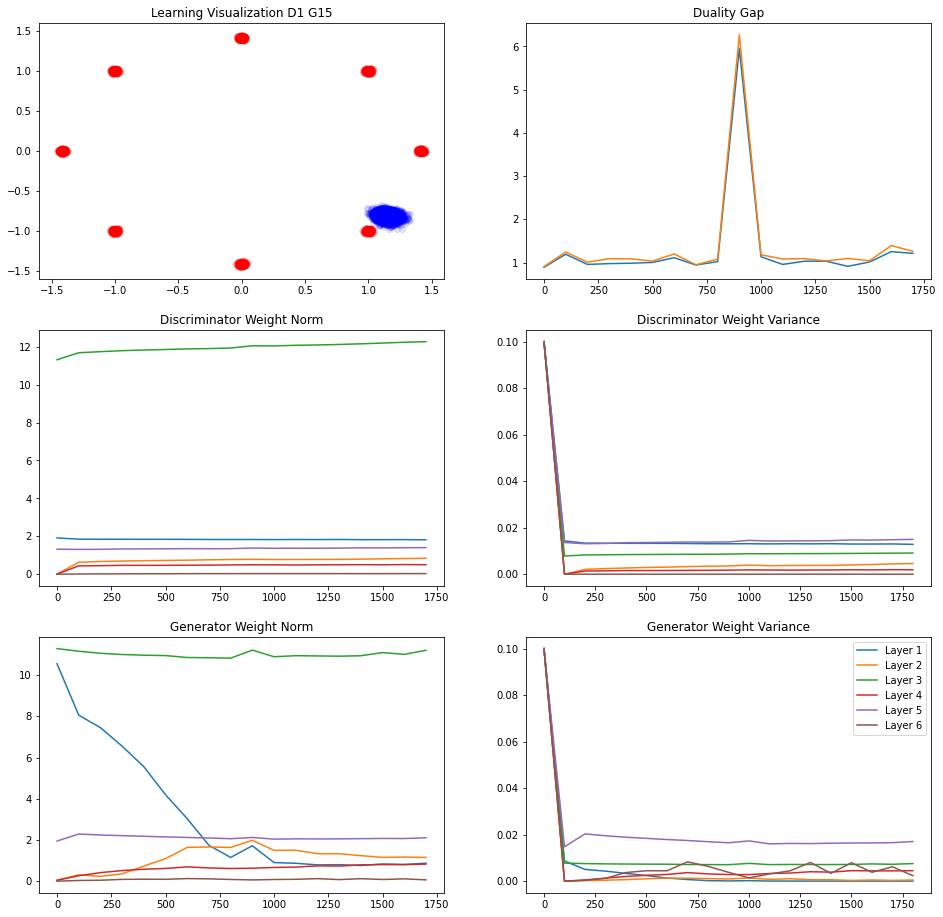

239/250 [===========================>..] - ETA: 0sIteration : 1800 [D loss: 0.704370, acc.: 17.58%] [G loss: 0.701449]
Vanilla   Duality GAP :  0.9824858
L Random  Duality Gap :  1.027572


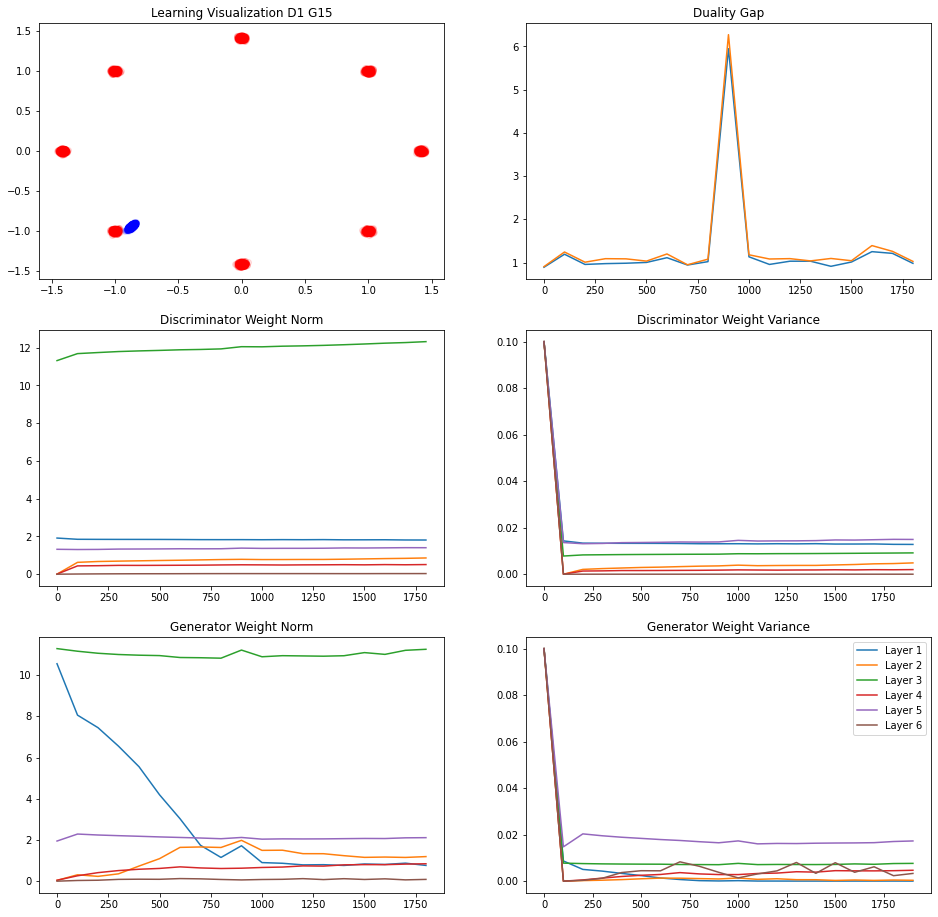

247/250 [============================>.] - ETA: 0sIteration : 1900 [D loss: 0.659077, acc.: 73.44%] [G loss: 0.793528]
Vanilla   Duality GAP :  0.9705106
L Random  Duality Gap :  0.9610514


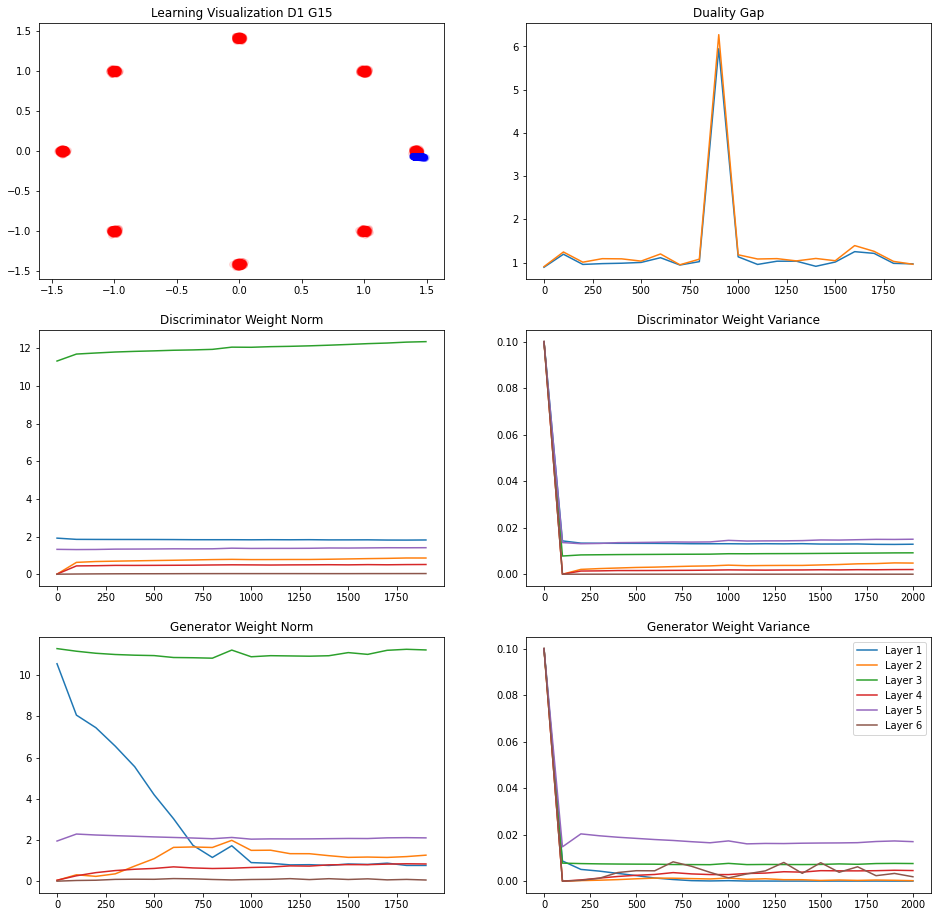

249/250 [============================>.] - ETA: 0sIteration : 2000 [D loss: 0.746838, acc.: 32.03%] [G loss: 0.578150]
Vanilla   Duality GAP :  1.1402421
L Random  Duality Gap :  1.2719512


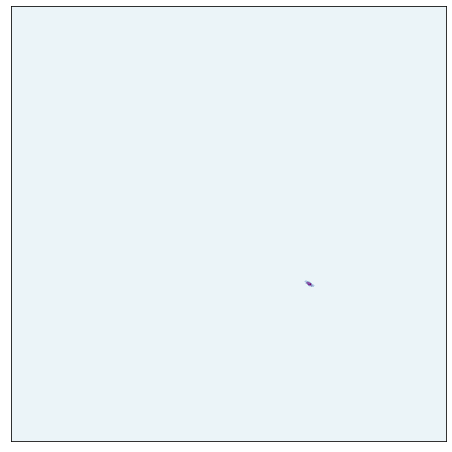

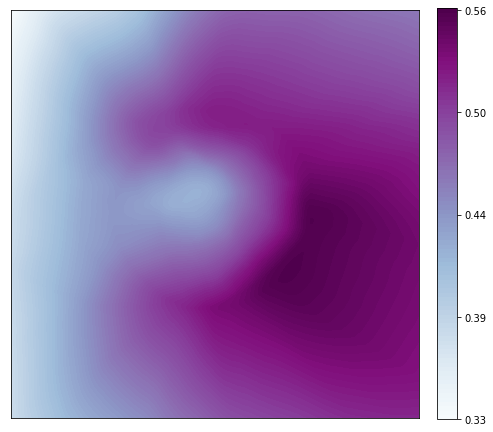

237/250 [===========================>..] - ETA: 0sIteration : 2100 [D loss: 0.710522, acc.: 39.06%] [G loss: 0.654483]
Vanilla   Duality GAP :  1.0594158
L Random  Duality Gap :  1.1317341


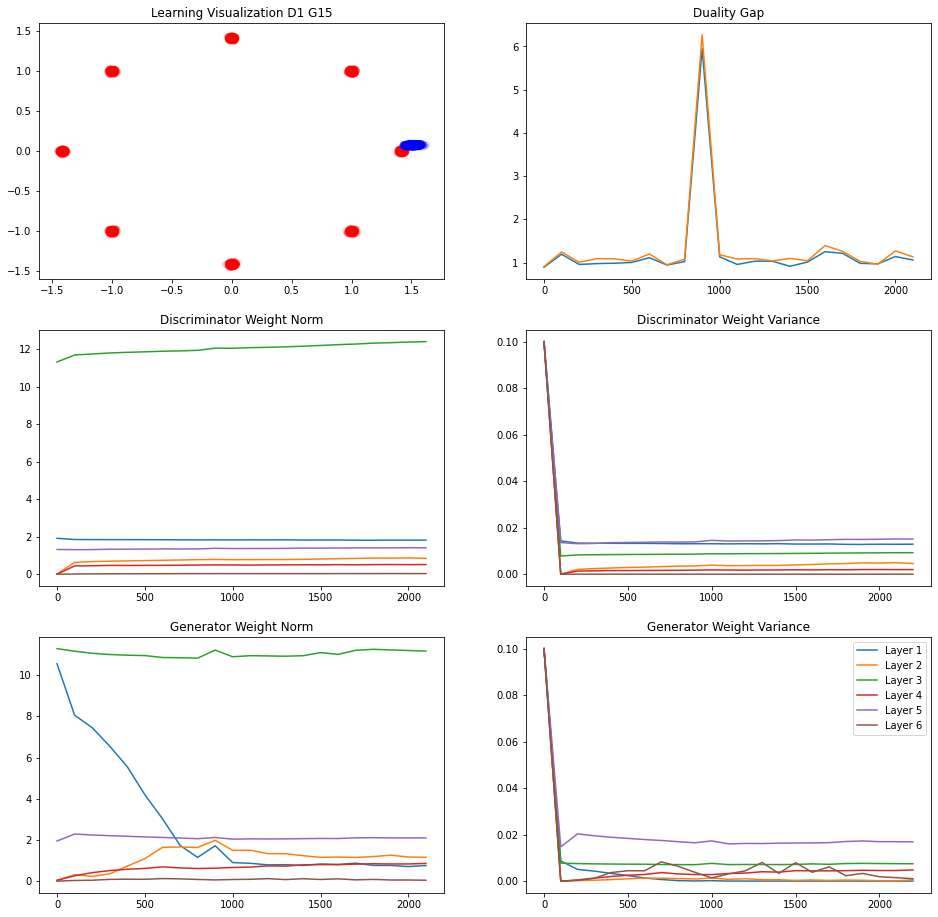

237/250 [===========================>..] - ETA: 0sIteration : 2200 [D loss: 0.666932, acc.: 71.09%] [G loss: 0.771897]
Vanilla   Duality GAP :  1.029058
L Random  Duality Gap :  1.0615671


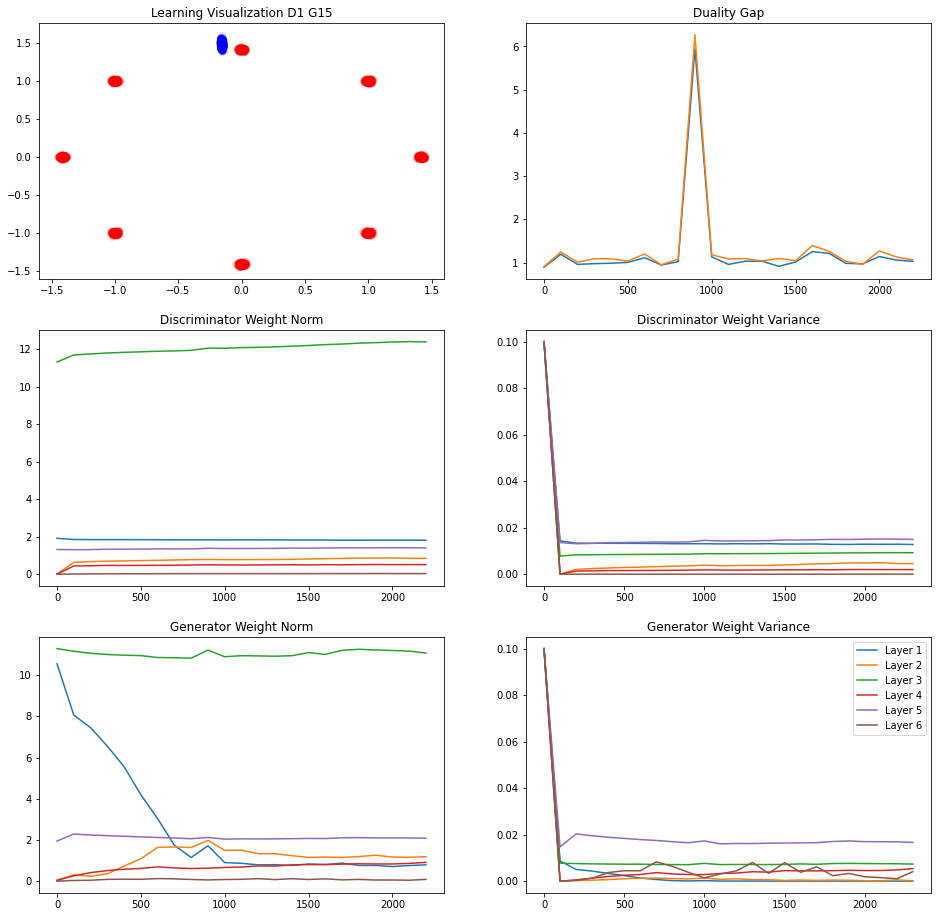

242/250 [============================>.] - ETA: 0sIteration : 2300 [D loss: 0.709237, acc.: 30.08%] [G loss: 0.666414]
Vanilla   Duality GAP :  1.0163791
L Random  Duality Gap :  1.0599577


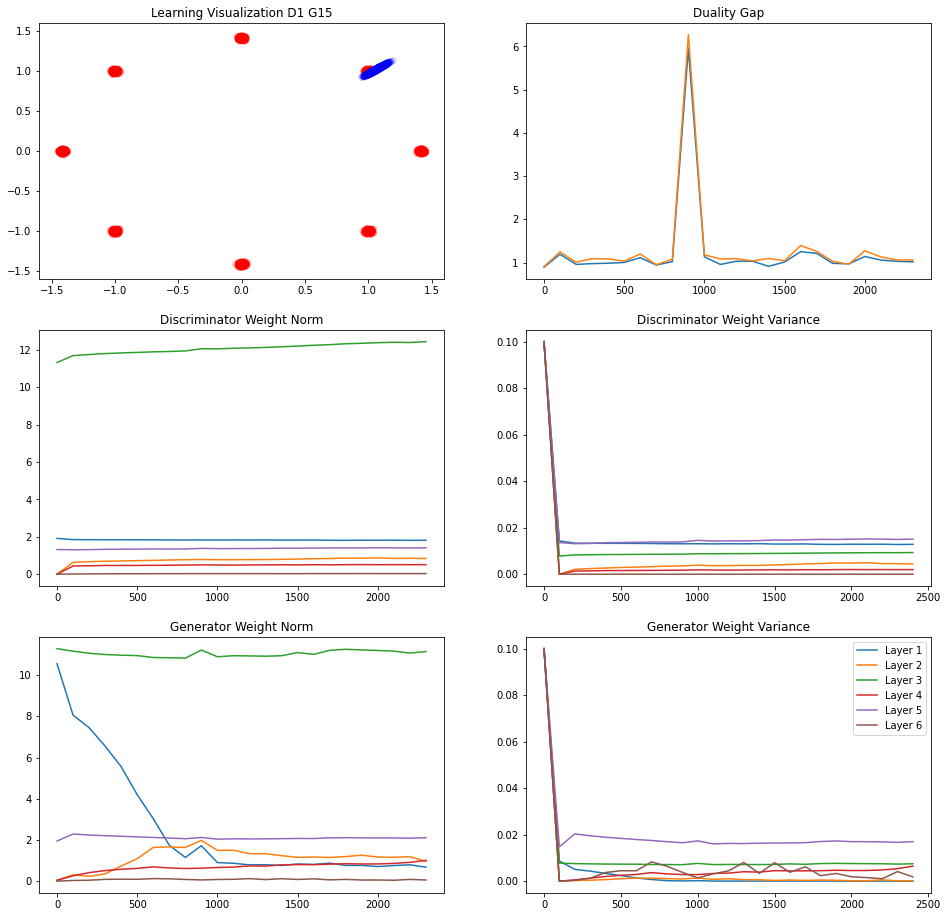

243/250 [============================>.] - ETA: 0sIteration : 2400 [D loss: 0.700403, acc.: 32.42%] [G loss: 0.685653]
Vanilla   Duality GAP :  0.9827765
L Random  Duality Gap :  1.0768864


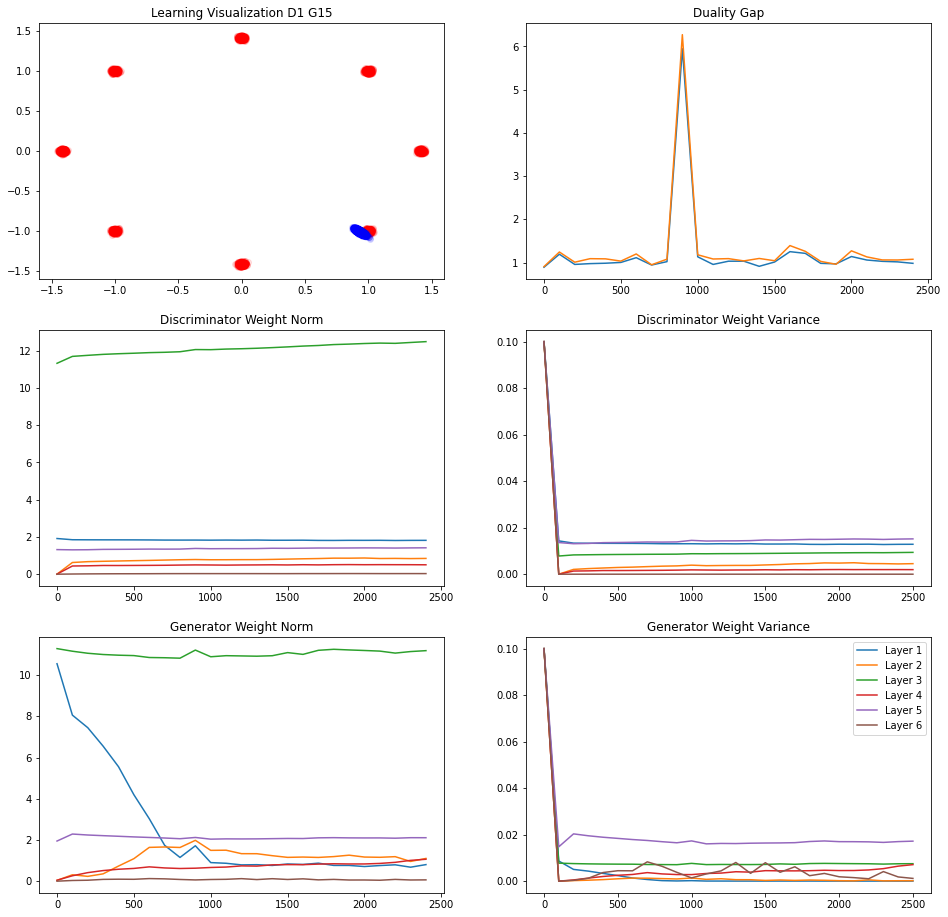

248/250 [============================>.] - ETA: 0sIteration : 2500 [D loss: 0.720941, acc.: 21.09%] [G loss: 0.679529]
Vanilla   Duality GAP :  1.1145462
L Random  Duality Gap :  1.2105516


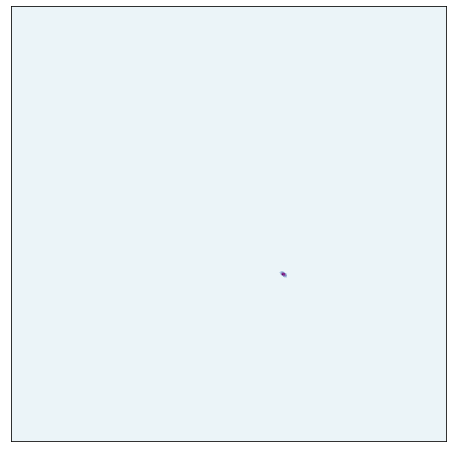

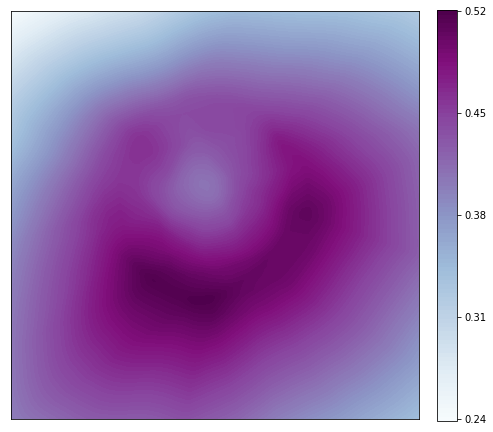

247/250 [============================>.] - ETA: 0sIteration : 2600 [D loss: 0.683732, acc.: 77.34%] [G loss: 0.716087]
Vanilla   Duality GAP :  0.97982913
L Random  Duality Gap :  1.0112627


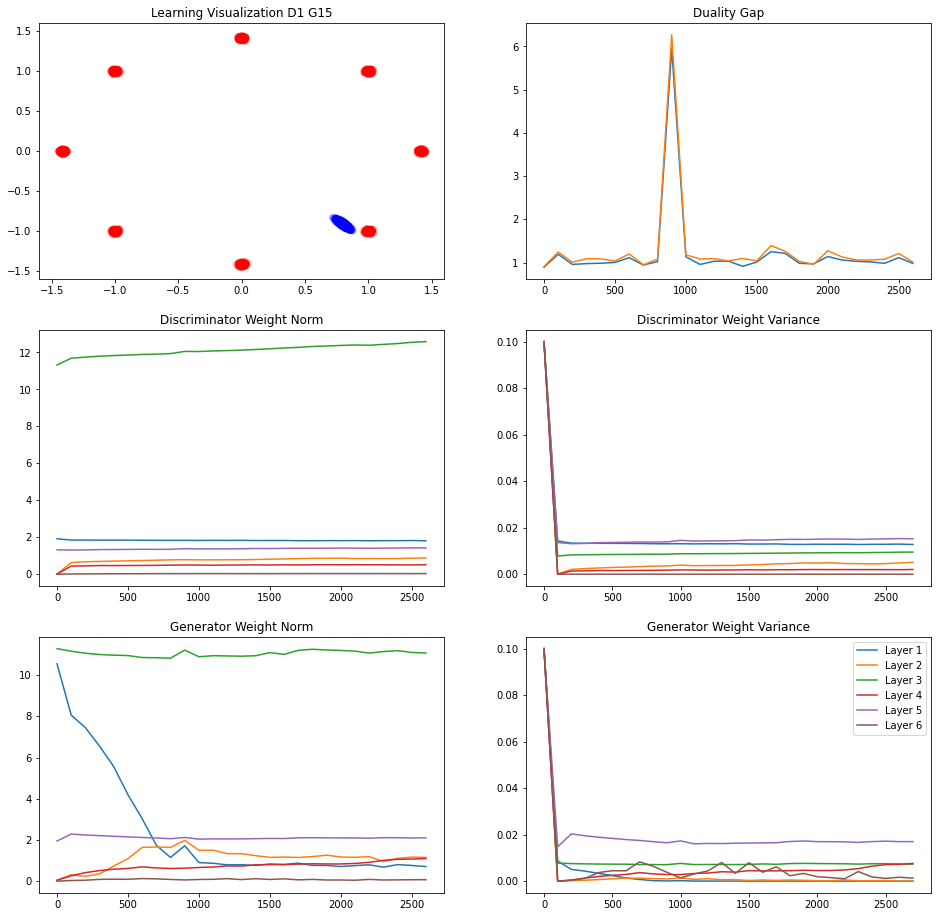

245/250 [============================>.] - ETA: 0sIteration : 2700 [D loss: 0.717002, acc.: 28.91%] [G loss: 0.652766]
Vanilla   Duality GAP :  0.9998362
L Random  Duality Gap :  1.0246619


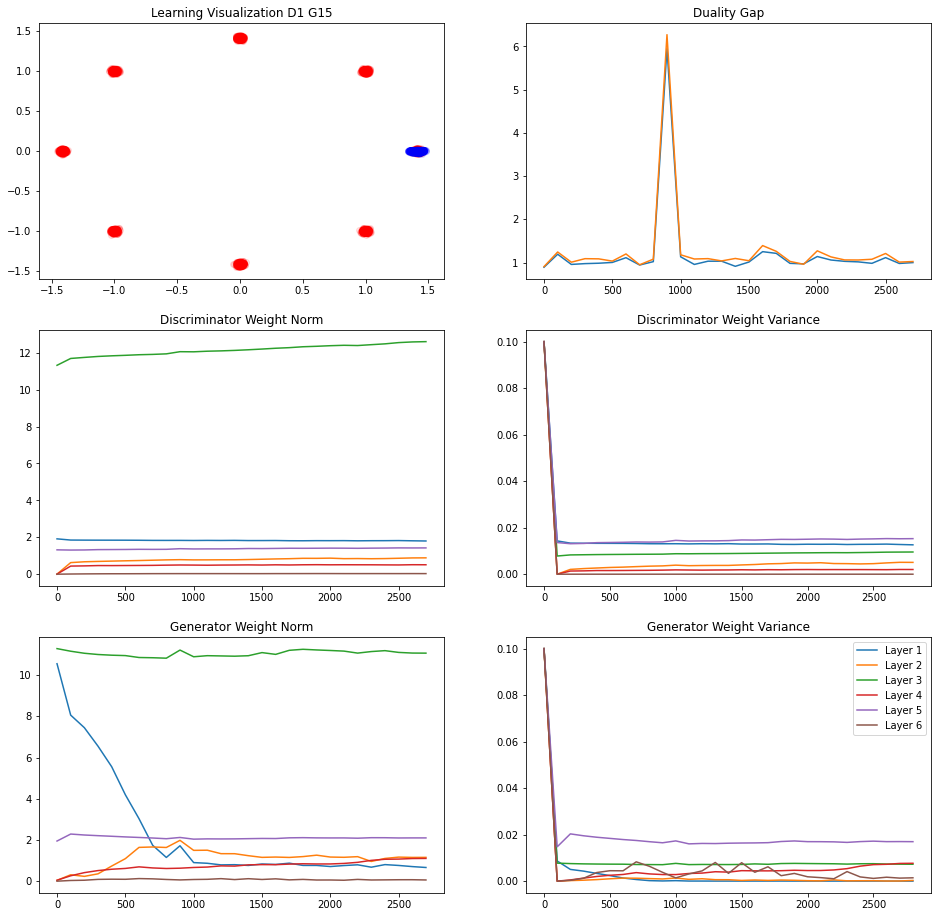

240/250 [===========================>..] - ETA: 0sIteration : 2800 [D loss: 0.652826, acc.: 76.95%] [G loss: 0.820148]
Vanilla   Duality GAP :  1.0140853
L Random  Duality Gap :  1.2567024


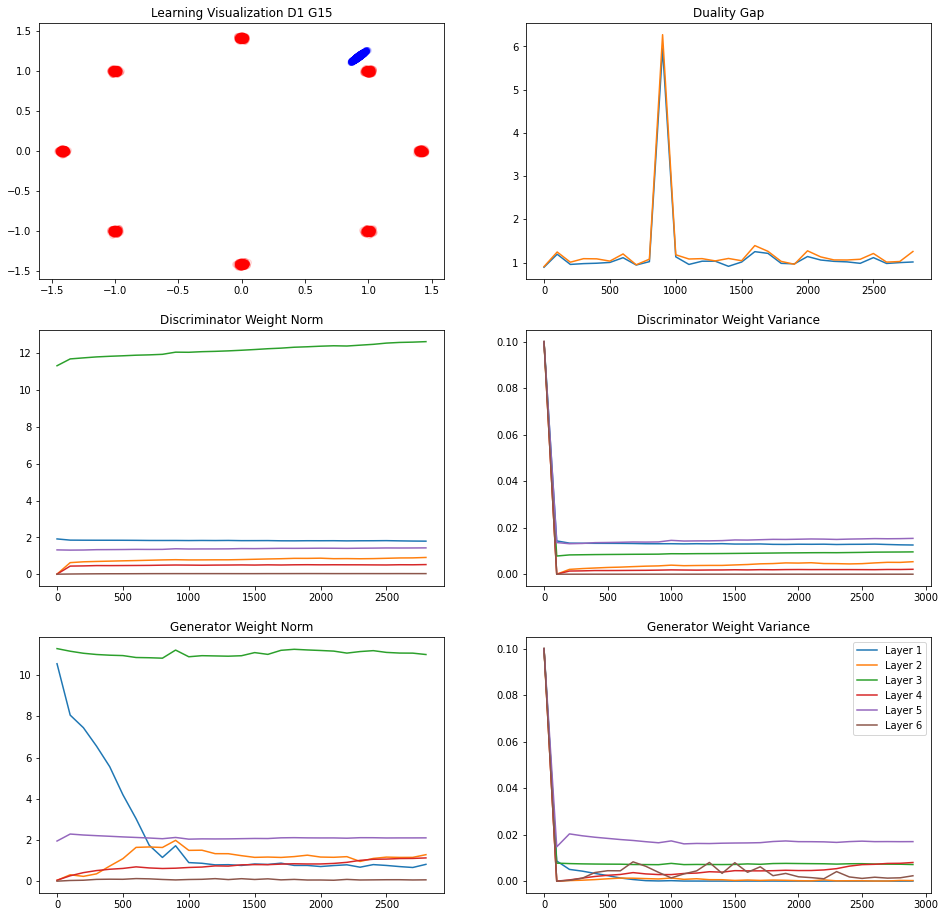

242/250 [============================>.] - ETA: 0sIteration : 2900 [D loss: 0.738436, acc.: 24.61%] [G loss: 0.614506]
Vanilla   Duality GAP :  1.059677
L Random  Duality Gap :  1.069653


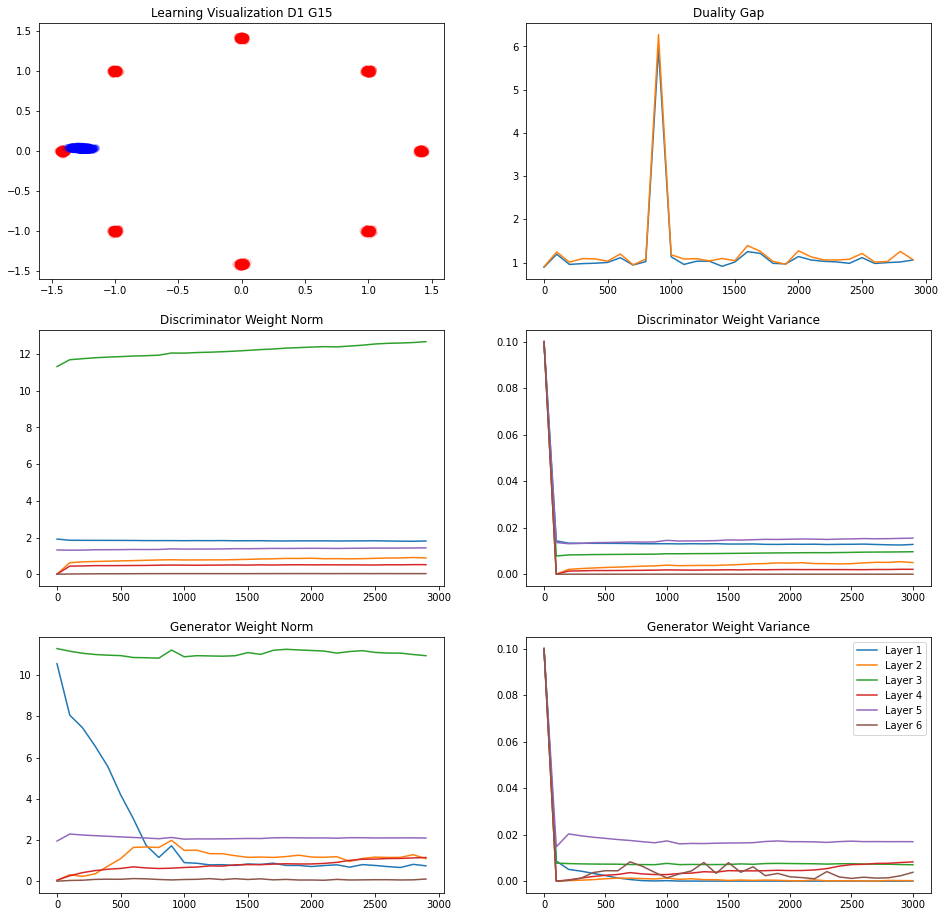

239/250 [===========================>..] - ETA: 0sIteration : 3000 [D loss: 0.727084, acc.: 29.69%] [G loss: 0.612995]
Vanilla   Duality GAP :  1.1071432
L Random  Duality Gap :  1.156472


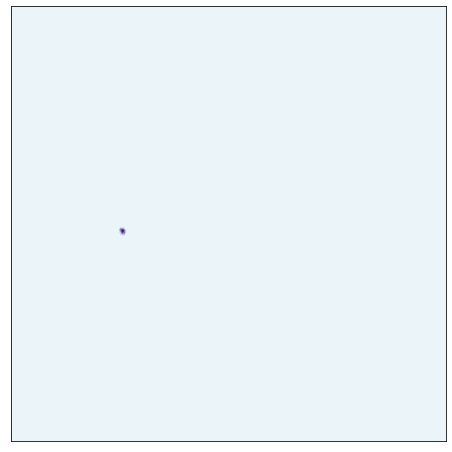

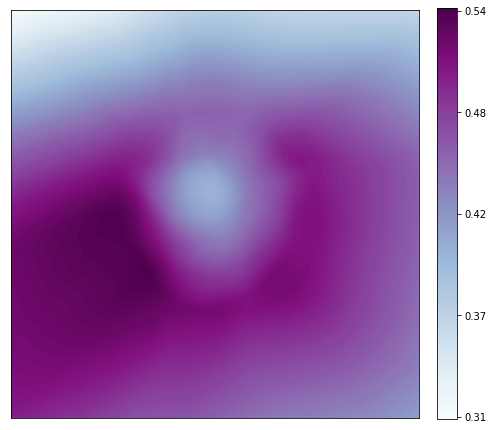

248/250 [============================>.] - ETA: 0sIteration : 3100 [D loss: 0.649006, acc.: 70.31%] [G loss: 0.810927]
Vanilla   Duality GAP :  0.85165703
L Random  Duality Gap :  1.072743


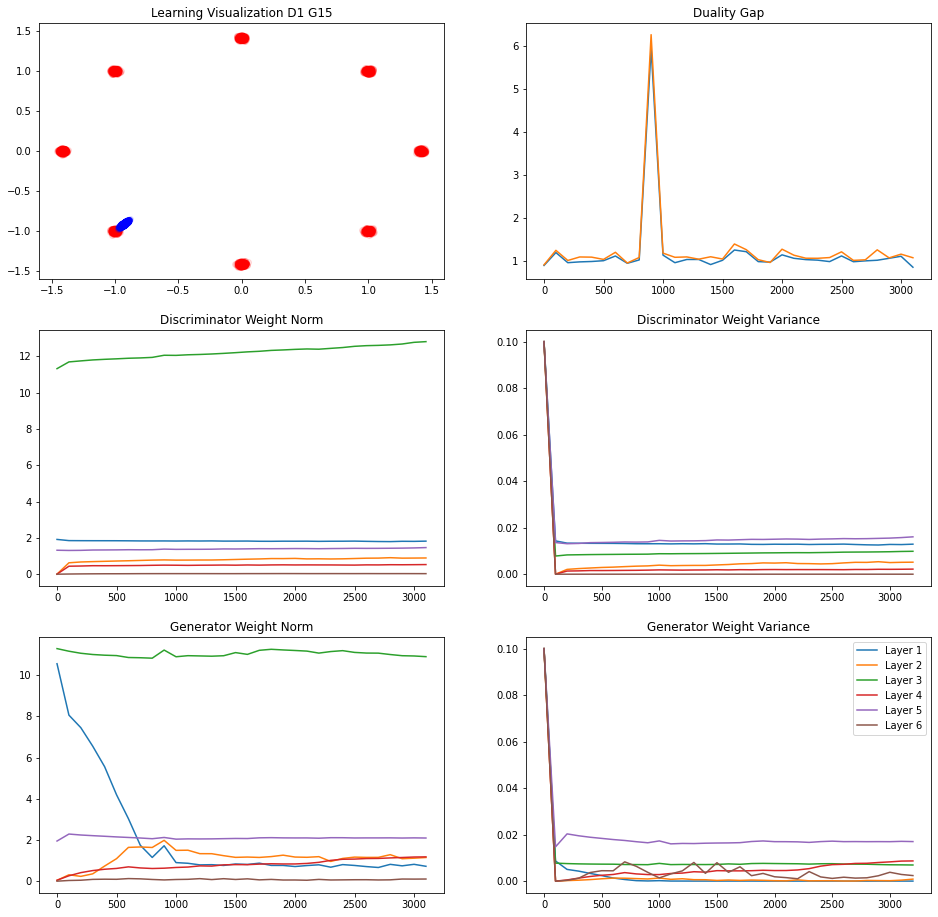

234/250 [===========================>..] - ETA: 0sIteration : 3200 [D loss: 0.626421, acc.: 75.78%] [G loss: 0.896014]
Vanilla   Duality GAP :  1.2783127
L Random  Duality Gap :  1.3710722


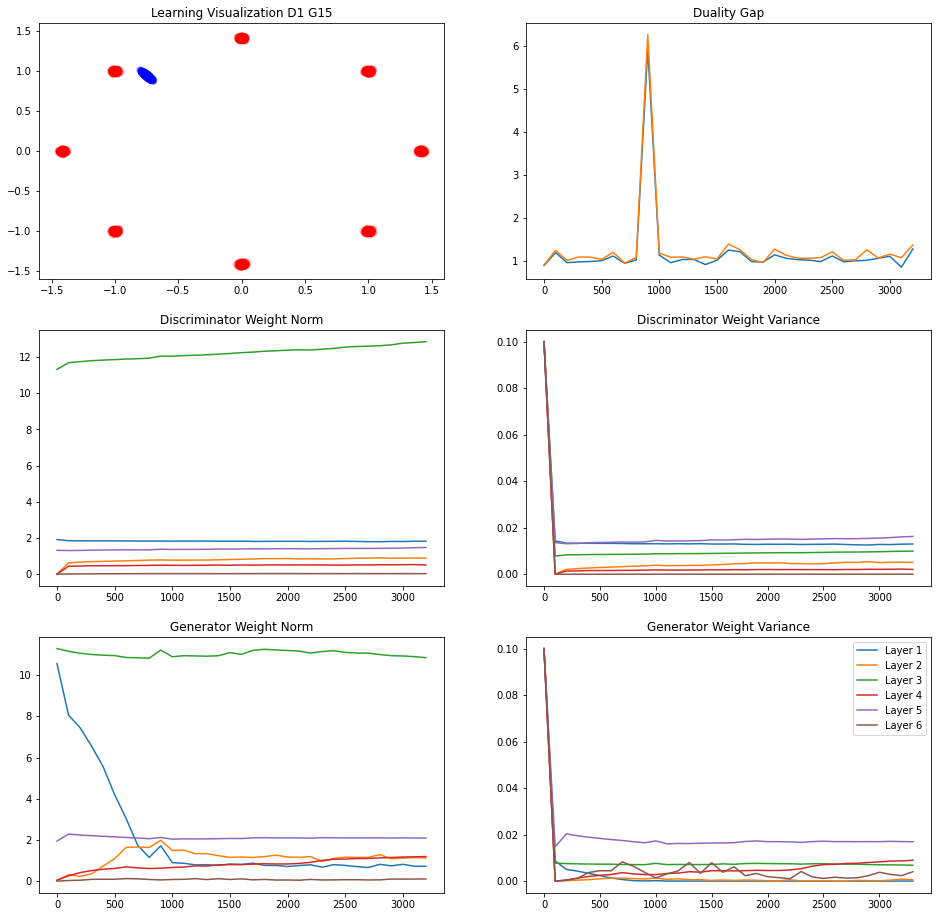

246/250 [============================>.] - ETA: 0sIteration : 3300 [D loss: 0.758276, acc.: 26.95%] [G loss: 0.534826]
Vanilla   Duality GAP :  4.8479614
L Random  Duality Gap :  6.88854


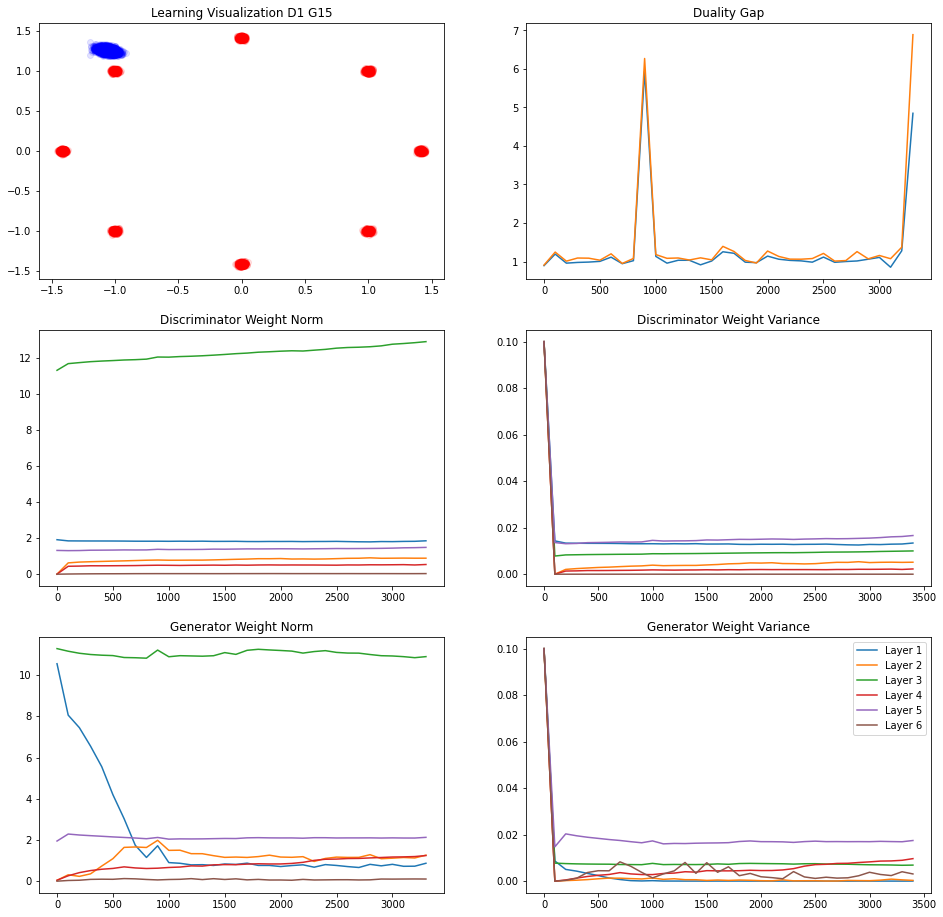

247/250 [============================>.] - ETA: 0sIteration : 3400 [D loss: 0.666461, acc.: 69.92%] [G loss: 0.803332]
Vanilla   Duality GAP :  1.0934782
L Random  Duality Gap :  1.3538707


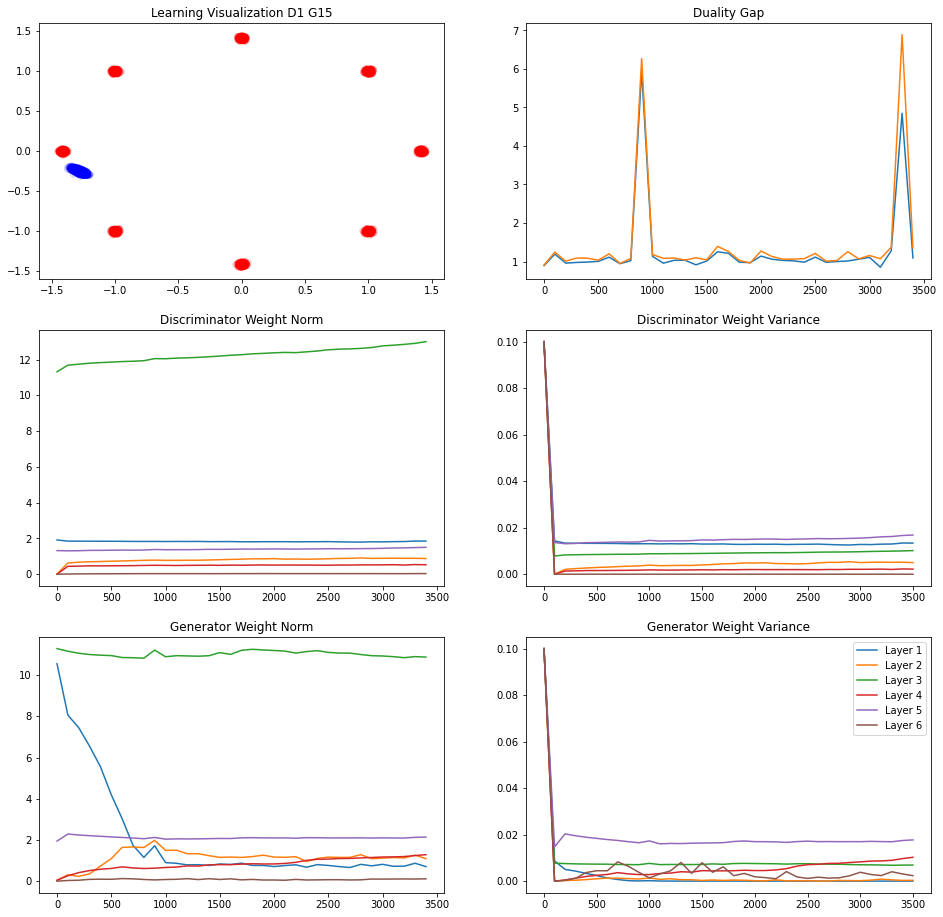

243/250 [============================>.] - ETA: 0sIteration : 3500 [D loss: 0.650623, acc.: 63.67%] [G loss: 0.849827]
Vanilla   Duality GAP :  0.91458964
L Random  Duality Gap :  1.0555398


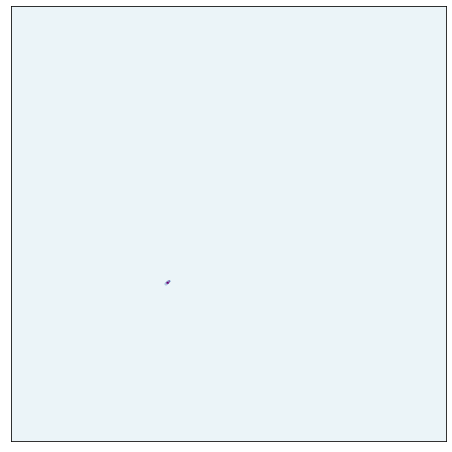

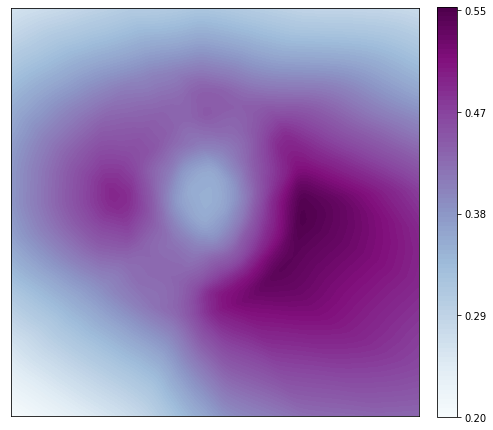

237/250 [===========================>..] - ETA: 0sIteration : 3600 [D loss: 0.784576, acc.: 26.95%] [G loss: 0.544247]
Vanilla   Duality GAP :  1.159871
L Random  Duality Gap :  1.1781704


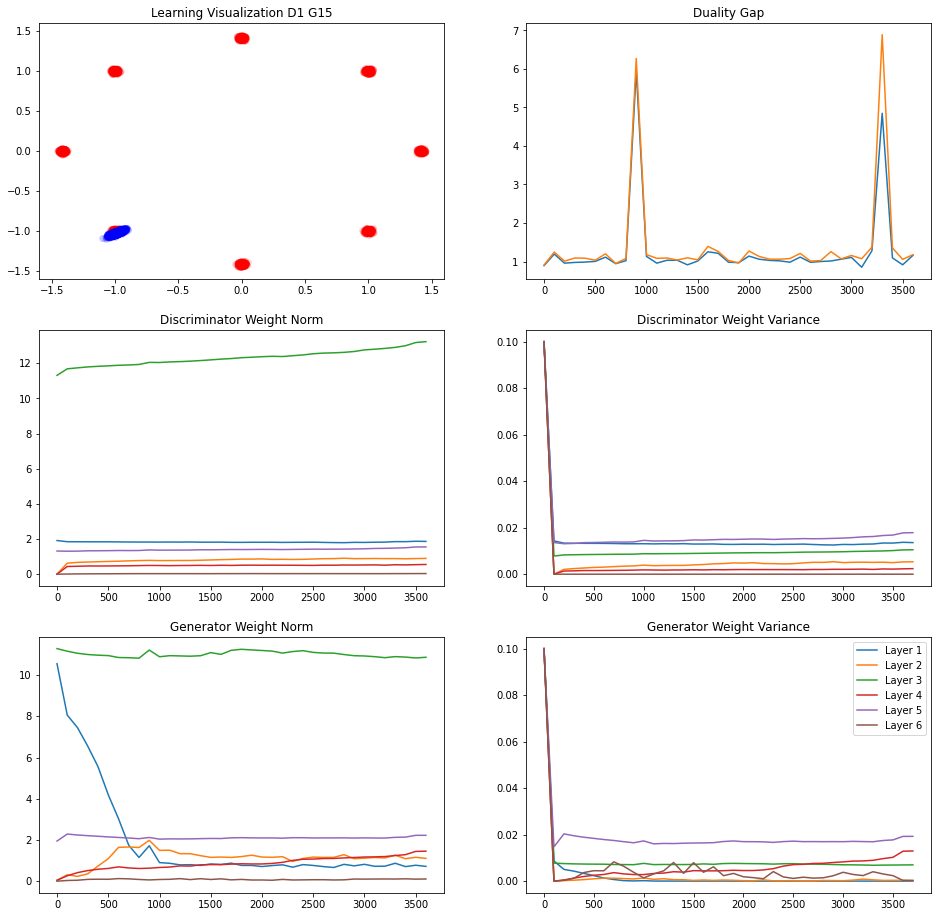

242/250 [============================>.] - ETA: 0sIteration : 3700 [D loss: 0.746841, acc.: 26.17%] [G loss: 0.565344]
Vanilla   Duality GAP :  1.4978445
L Random  Duality Gap :  4.395067


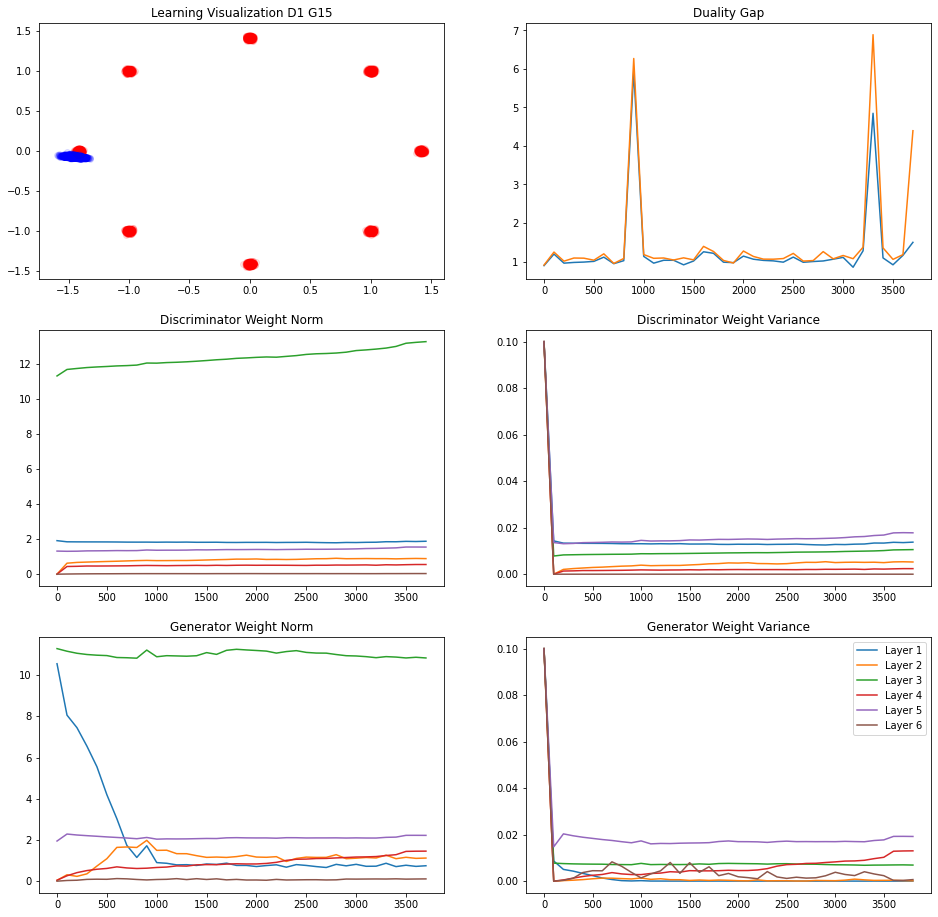

241/250 [===========================>..] - ETA: 0sIteration : 3800 [D loss: 0.729683, acc.: 35.94%] [G loss: 0.634405]
Vanilla   Duality GAP :  1.1044915
L Random  Duality Gap :  1.0925602


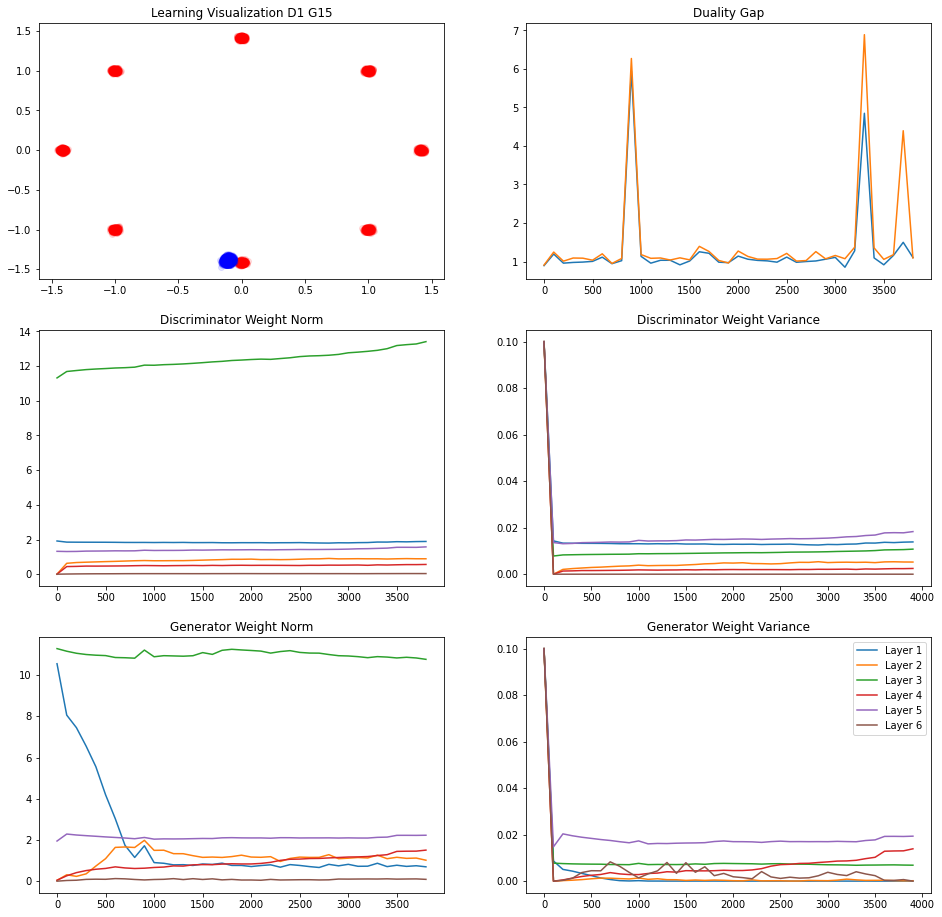

248/250 [============================>.] - ETA: 0sIteration : 3900 [D loss: 0.672738, acc.: 76.56%] [G loss: 0.734117]
Vanilla   Duality GAP :  0.9212905
L Random  Duality Gap :  1.1480885


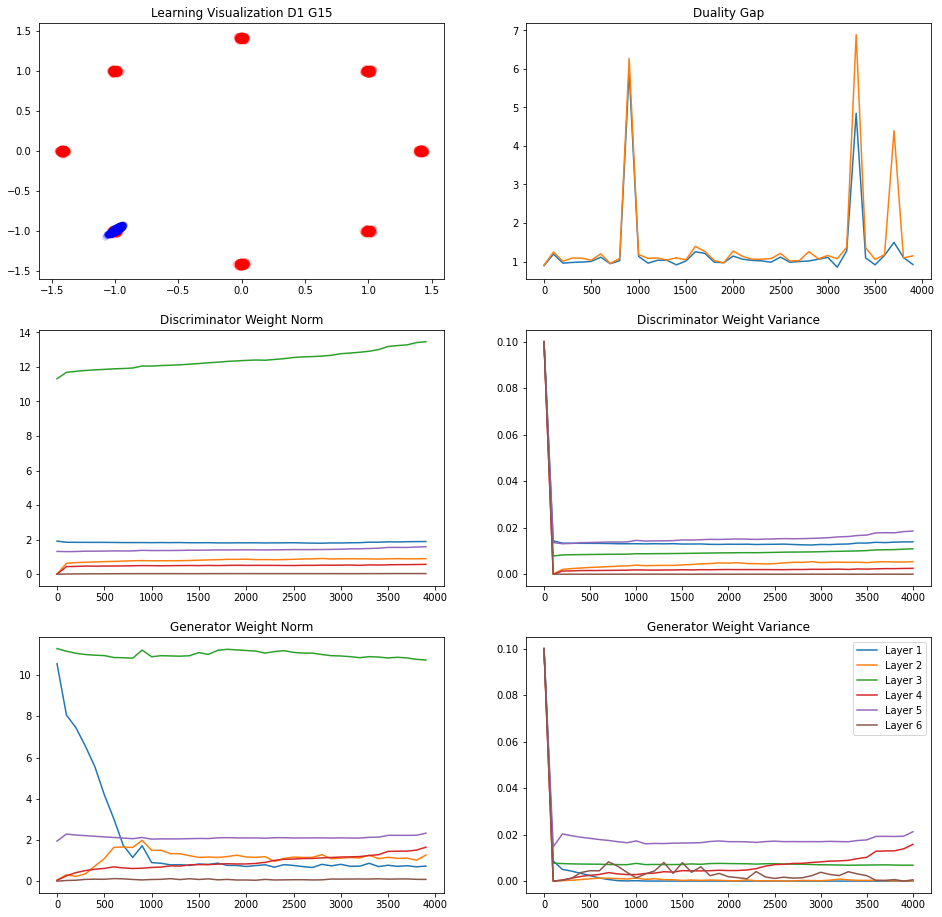

245/250 [============================>.] - ETA: 0sIteration : 4000 [D loss: 0.641600, acc.: 75.39%] [G loss: 0.802068]
Vanilla   Duality GAP :  1.3379093
L Random  Duality Gap :  1.4874651


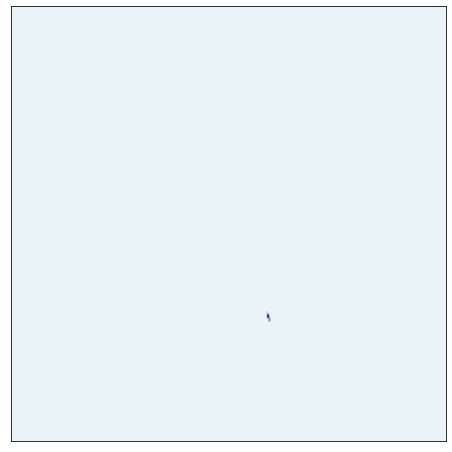

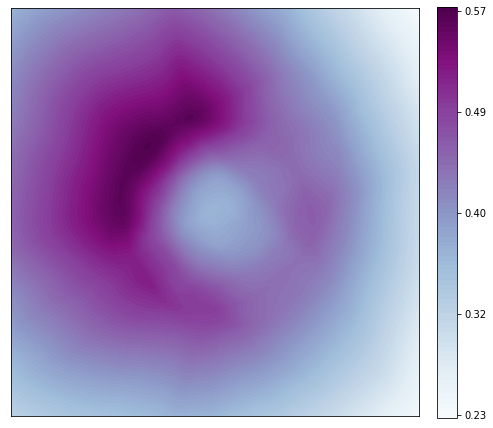

240/250 [===========================>..] - ETA: 0sIteration : 4100 [D loss: 0.627057, acc.: 74.22%] [G loss: 0.911729]
Vanilla   Duality GAP :  0.8186368
L Random  Duality Gap :  1.163197


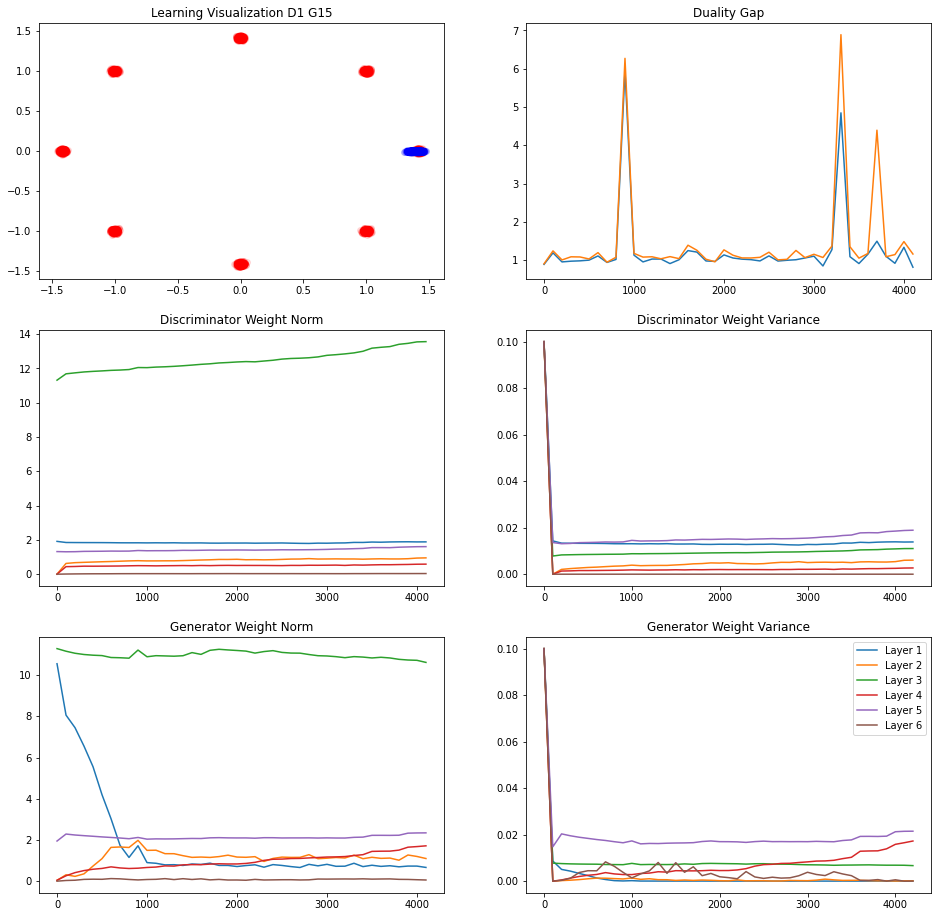

244/250 [============================>.] - ETA: 0sIteration : 4200 [D loss: 0.693262, acc.: 30.47%] [G loss: 0.697296]
Vanilla   Duality GAP :  0.97166616
L Random  Duality Gap :  0.9677992


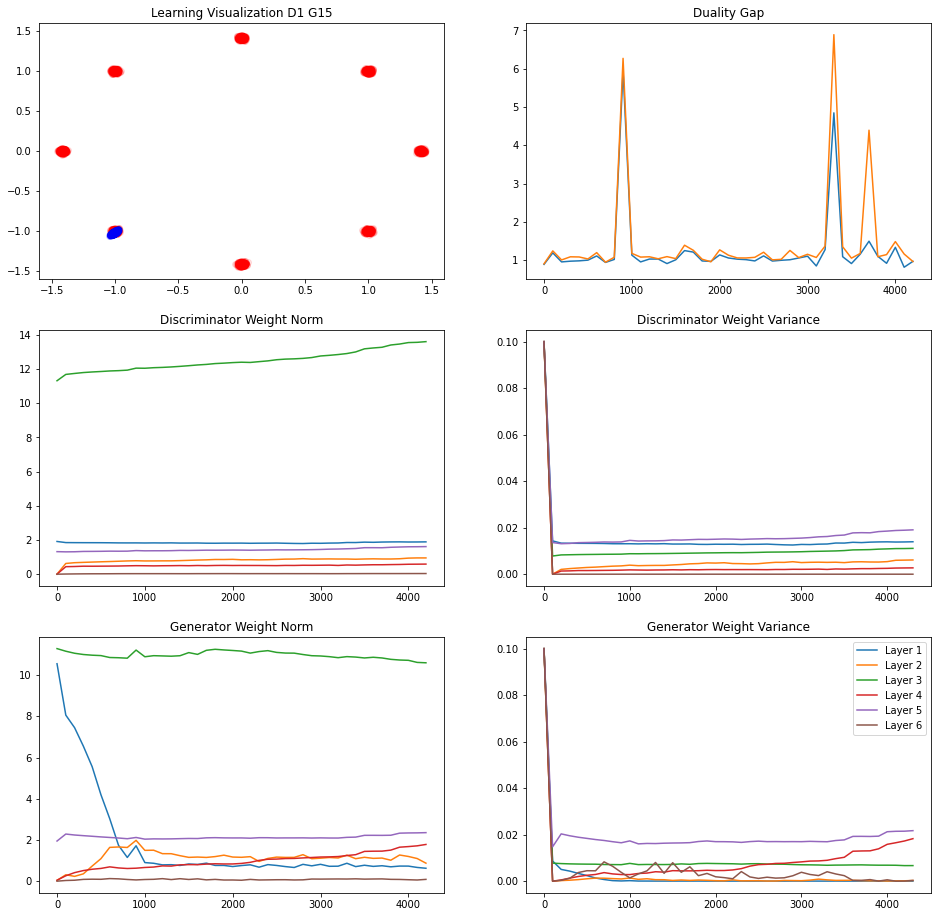

249/250 [============================>.] - ETA: 0sIteration : 4300 [D loss: 0.879947, acc.: 28.12%] [G loss: 0.450713]
Vanilla   Duality GAP :  1.4541125
L Random  Duality Gap :  1.5007061


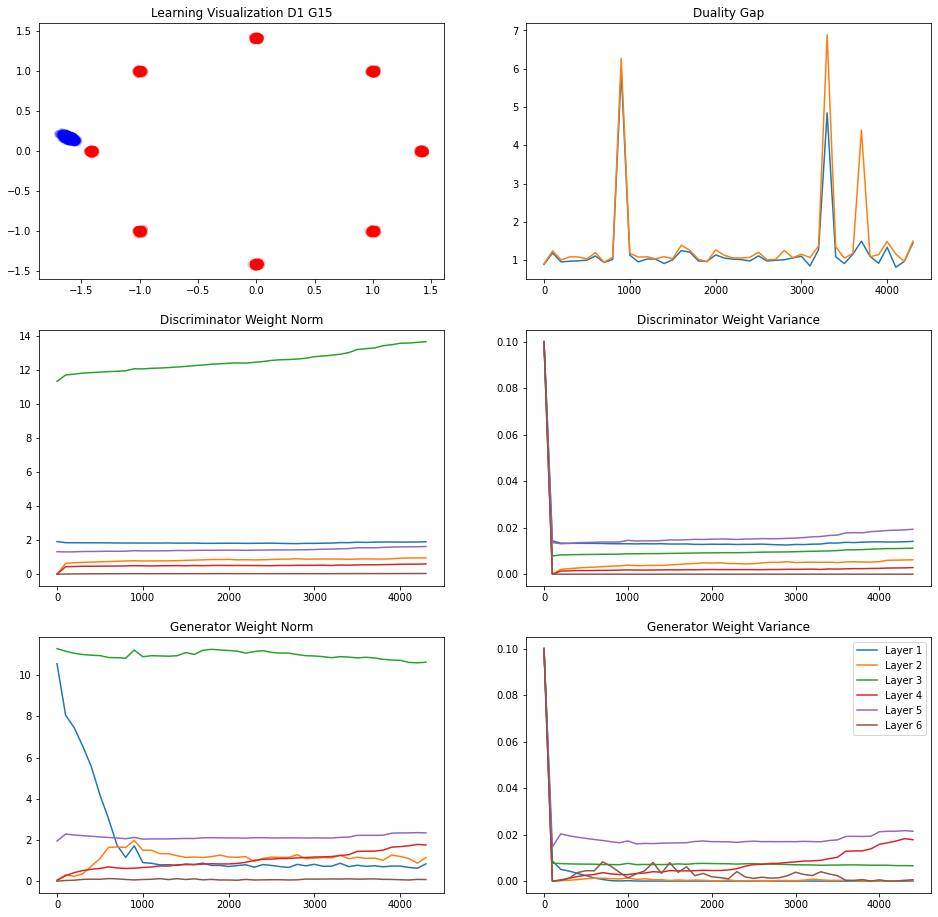

249/250 [============================>.] - ETA: 0sIteration : 4400 [D loss: 0.638879, acc.: 93.75%] [G loss: 0.780641]
Vanilla   Duality GAP :  1.0605111
L Random  Duality Gap :  1.3020908


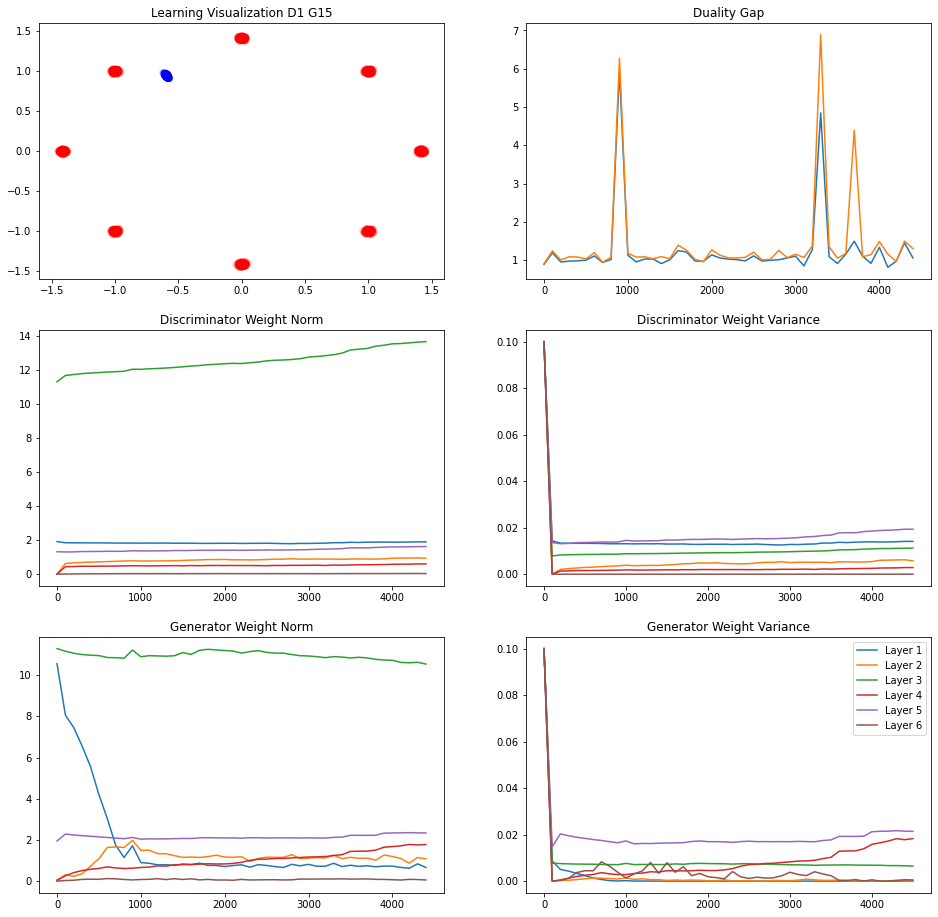

247/250 [============================>.] - ETA: 0sIteration : 4500 [D loss: 0.643427, acc.: 76.17%] [G loss: 0.794478]
Vanilla   Duality GAP :  0.8505566
L Random  Duality Gap :  1.1285347


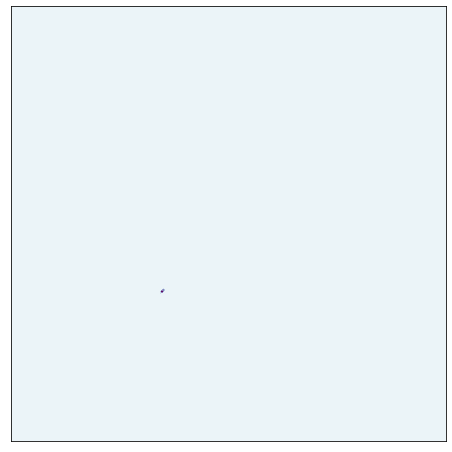

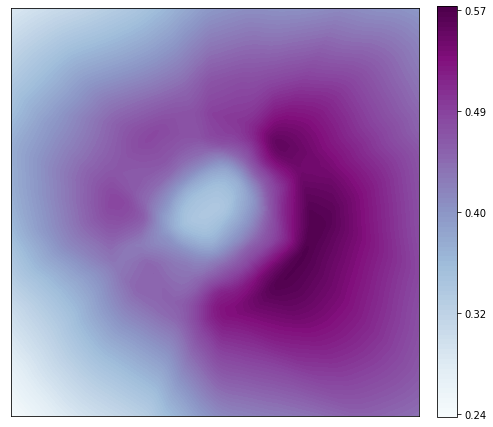

238/250 [===========================>..] - ETA: 0sIteration : 4600 [D loss: 0.725818, acc.: 17.19%] [G loss: 0.638819]
Vanilla   Duality GAP :  1.0232604
L Random  Duality Gap :  1.0577258


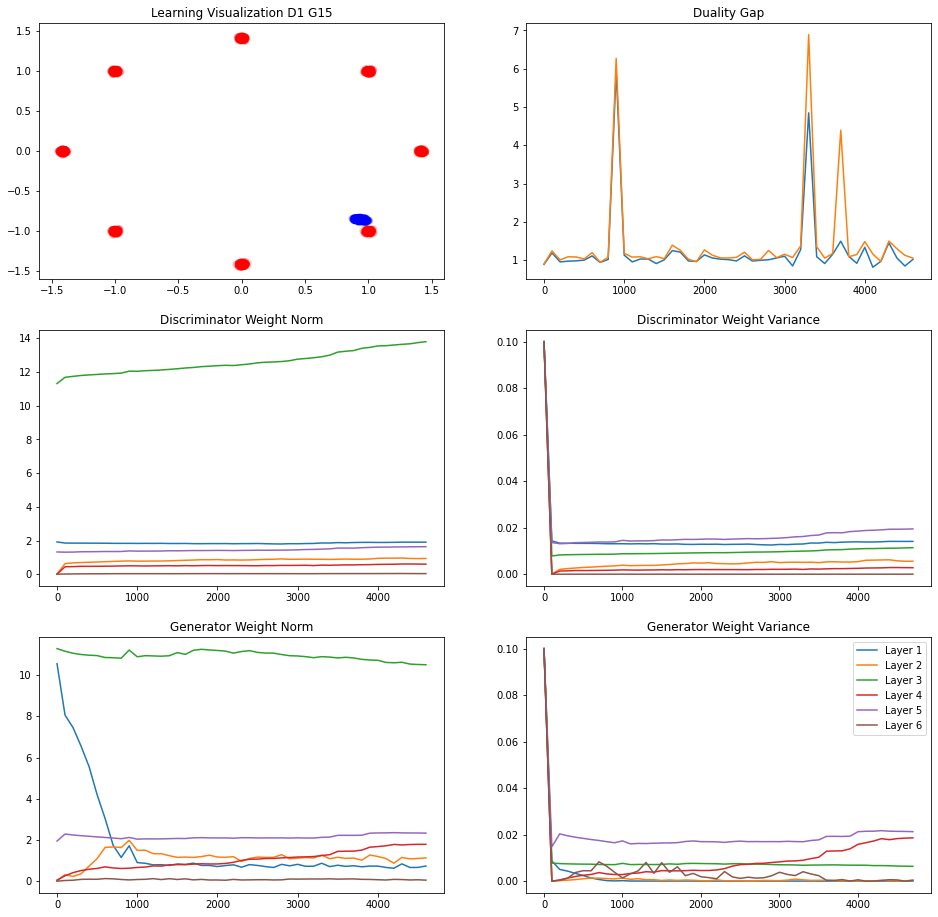

237/250 [===========================>..] - ETA: 0sIteration : 4700 [D loss: 0.837196, acc.: 21.09%] [G loss: 0.483252]
Vanilla   Duality GAP :  1.4907817
L Random  Duality Gap :  1.6213266


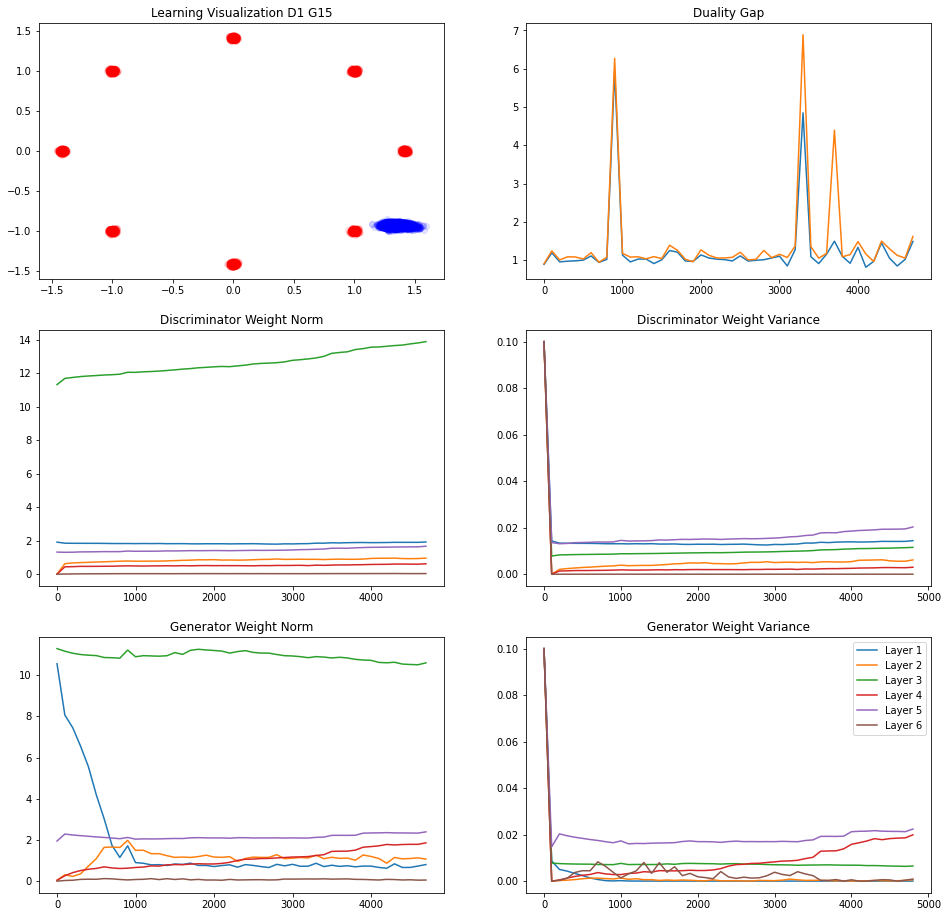

241/250 [===========================>..] - ETA: 0sIteration : 4800 [D loss: 0.732983, acc.: 27.34%] [G loss: 0.540480]
Vanilla   Duality GAP :  1.2785137
L Random  Duality Gap :  1.3209193


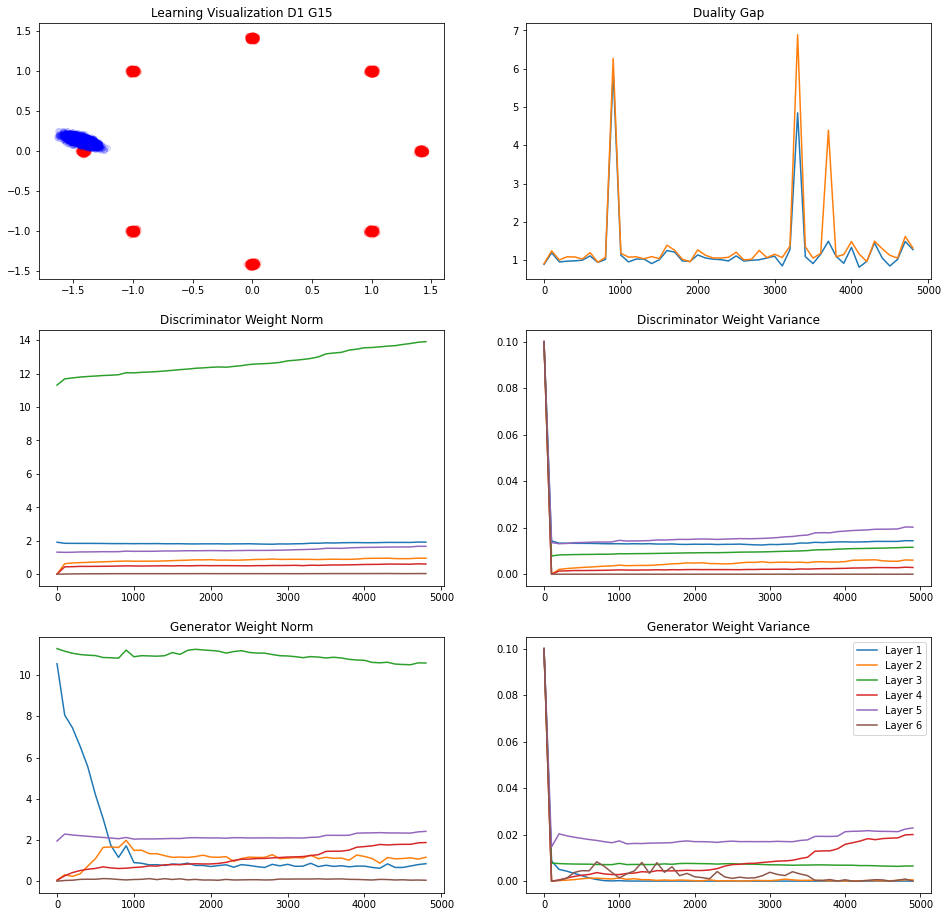

239/250 [===========================>..] - ETA: 0sIteration : 4900 [D loss: 0.707742, acc.: 25.78%] [G loss: 0.695532]
Vanilla   Duality GAP :  1.0335064
L Random  Duality Gap :  1.130477


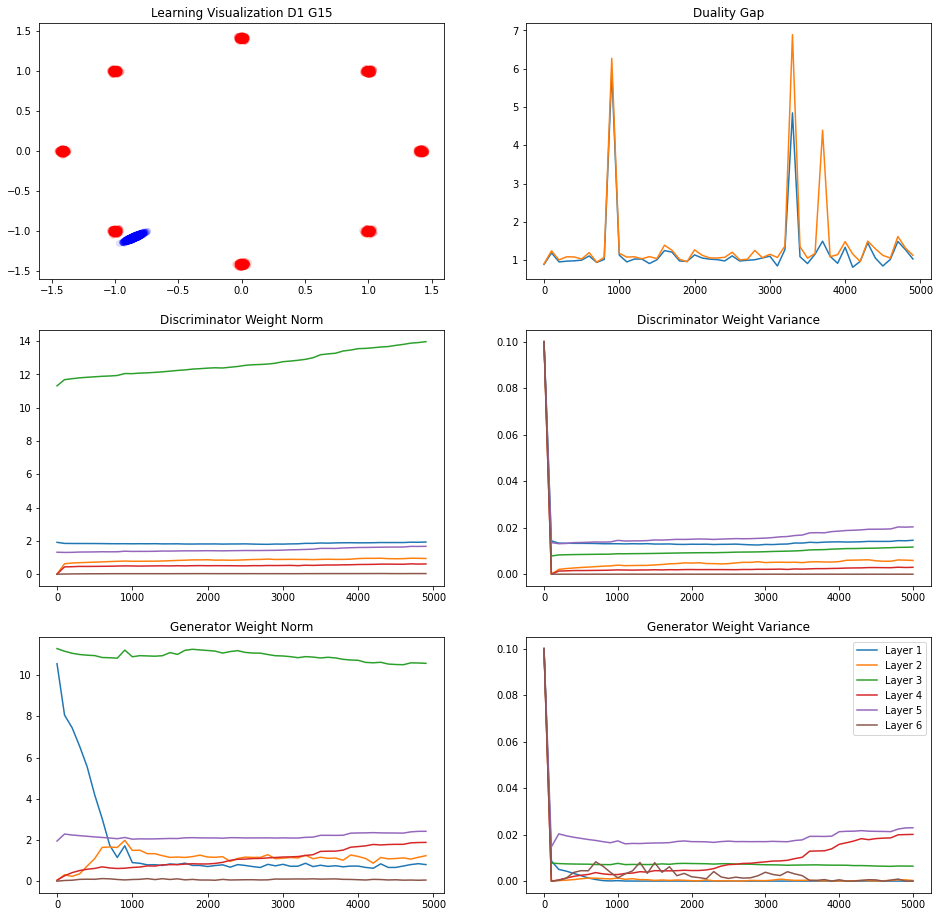

240/250 [===========================>..] - ETA: 0sIteration : 5000 [D loss: 0.655794, acc.: 73.83%] [G loss: 0.749818]
Vanilla   Duality GAP :  0.89185536
L Random  Duality Gap :  0.90754867


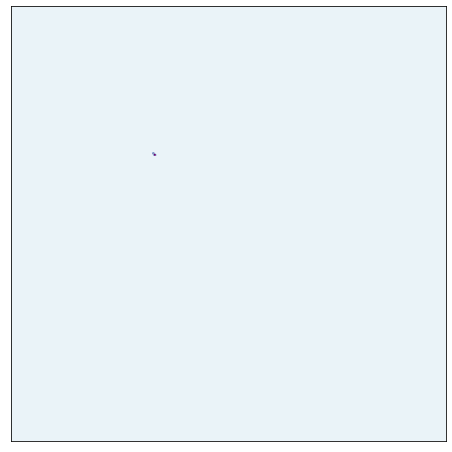

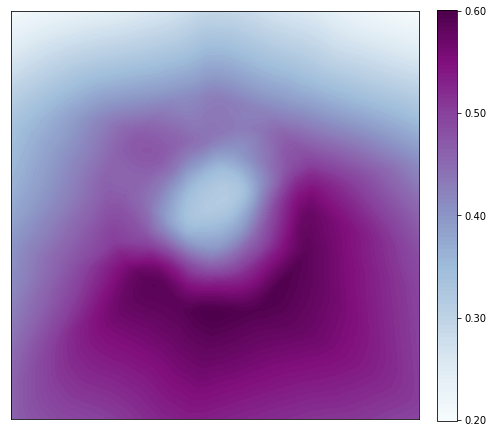

243/250 [============================>.] - ETA: 0sIteration : 5100 [D loss: 0.741987, acc.: 39.45%] [G loss: 0.592773]
Vanilla   Duality GAP :  1.0670309
L Random  Duality Gap :  1.1210066


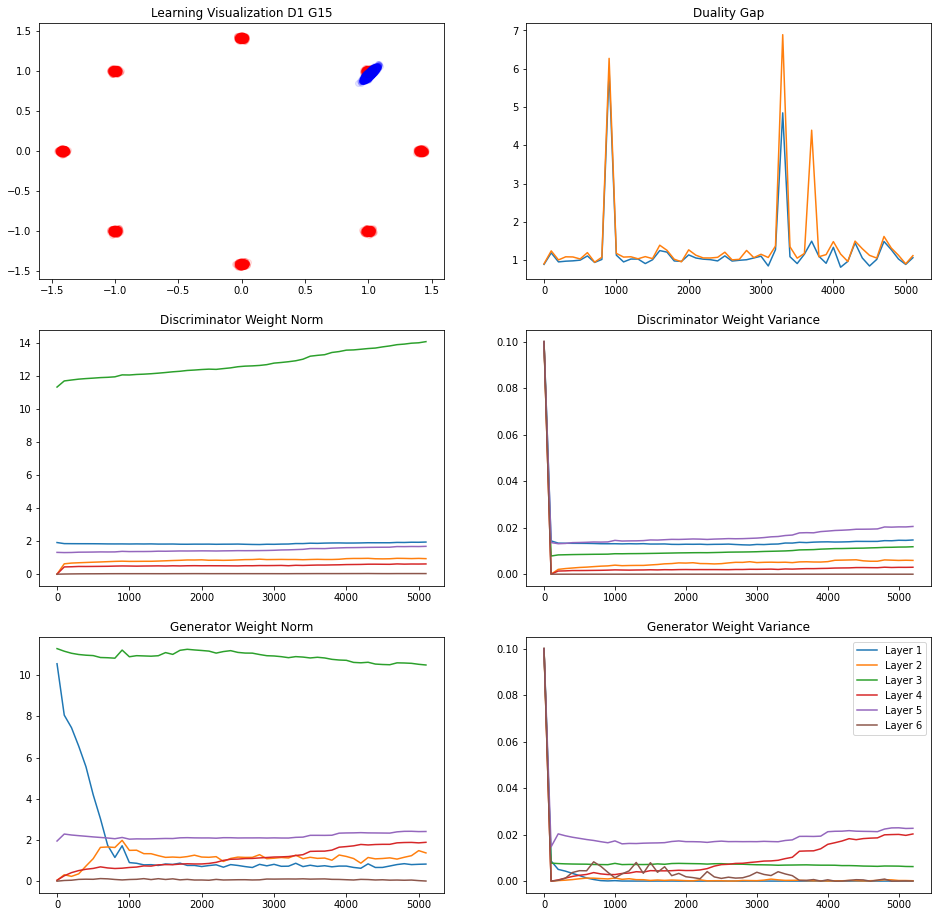

247/250 [============================>.] - ETA: 0sIteration : 5200 [D loss: 0.637020, acc.: 76.17%] [G loss: 0.841988]
Vanilla   Duality GAP :  0.9168583
L Random  Duality Gap :  1.2852544


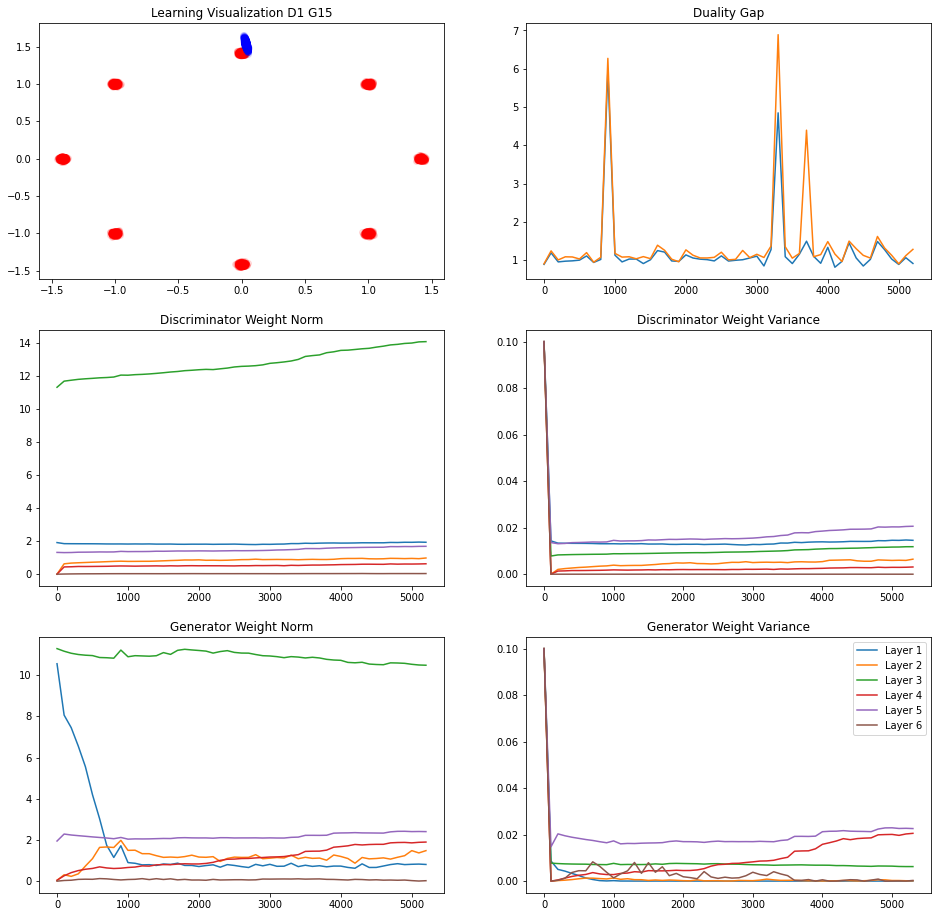

245/250 [============================>.] - ETA: 0sIteration : 5300 [D loss: 0.803513, acc.: 31.64%] [G loss: 0.504380]
Vanilla   Duality GAP :  1.1889191
L Random  Duality Gap :  1.2930999


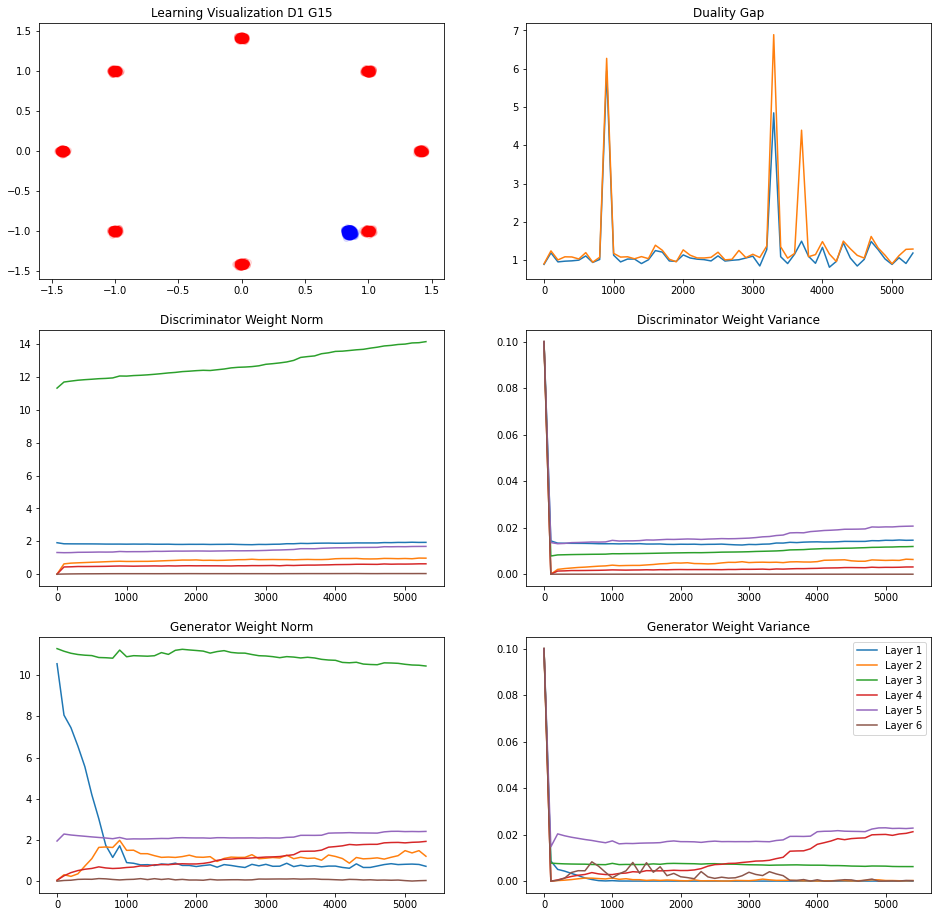

242/250 [============================>.] - ETA: 0sIteration : 5400 [D loss: 0.568932, acc.: 72.27%] [G loss: 1.058671]
Vanilla   Duality GAP :  1.2790148
L Random  Duality Gap :  0.9580314


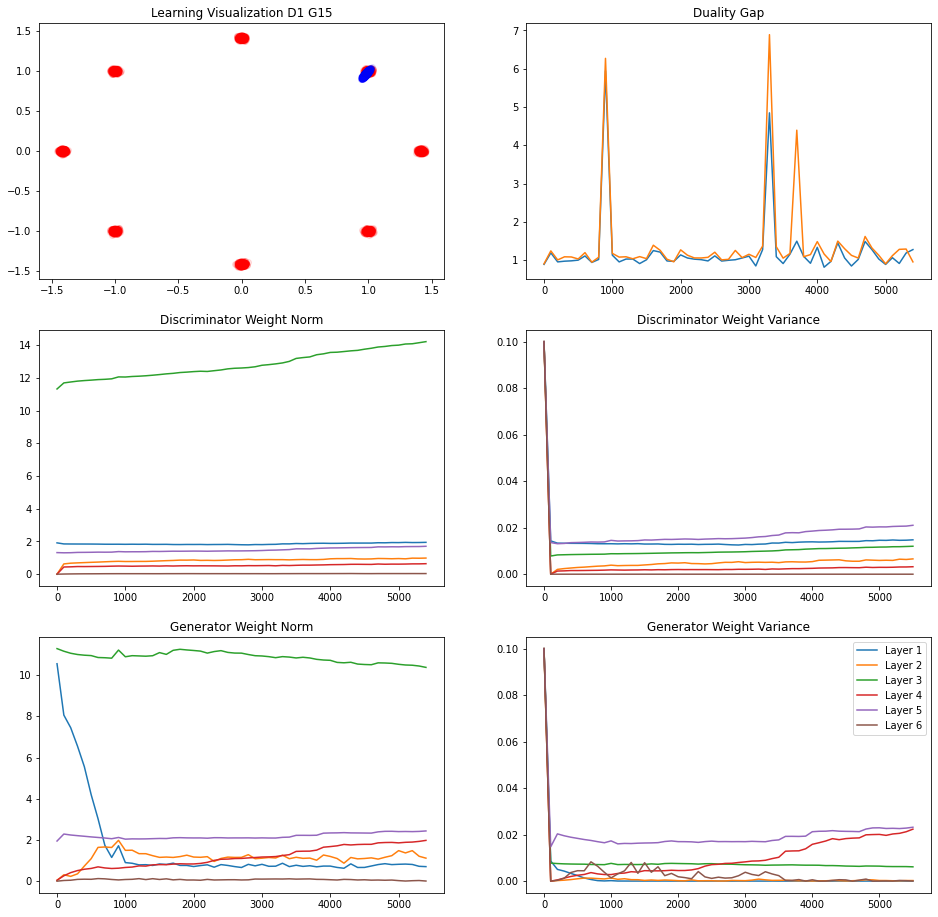

245/250 [============================>.] - ETA: 0sIteration : 5500 [D loss: 0.802584, acc.: 26.56%] [G loss: 0.538213]
Vanilla   Duality GAP :  1.2206521
L Random  Duality Gap :  1.2716775


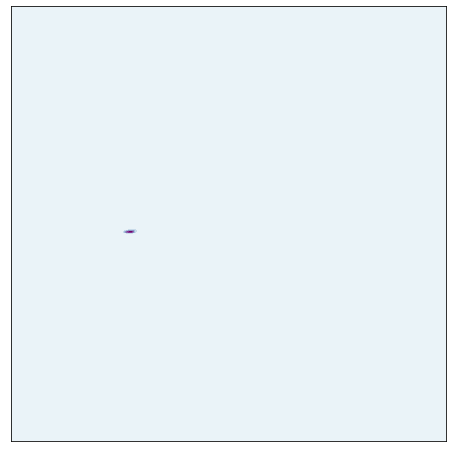

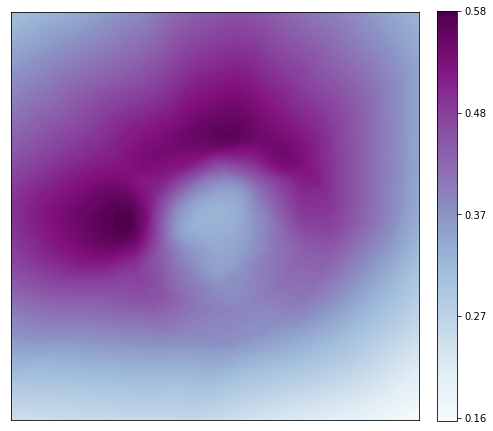

249/250 [============================>.] - ETA: 0sIteration : 5600 [D loss: 0.828285, acc.: 28.52%] [G loss: 0.467168]
Vanilla   Duality GAP :  1.3227191
L Random  Duality Gap :  1.4857626


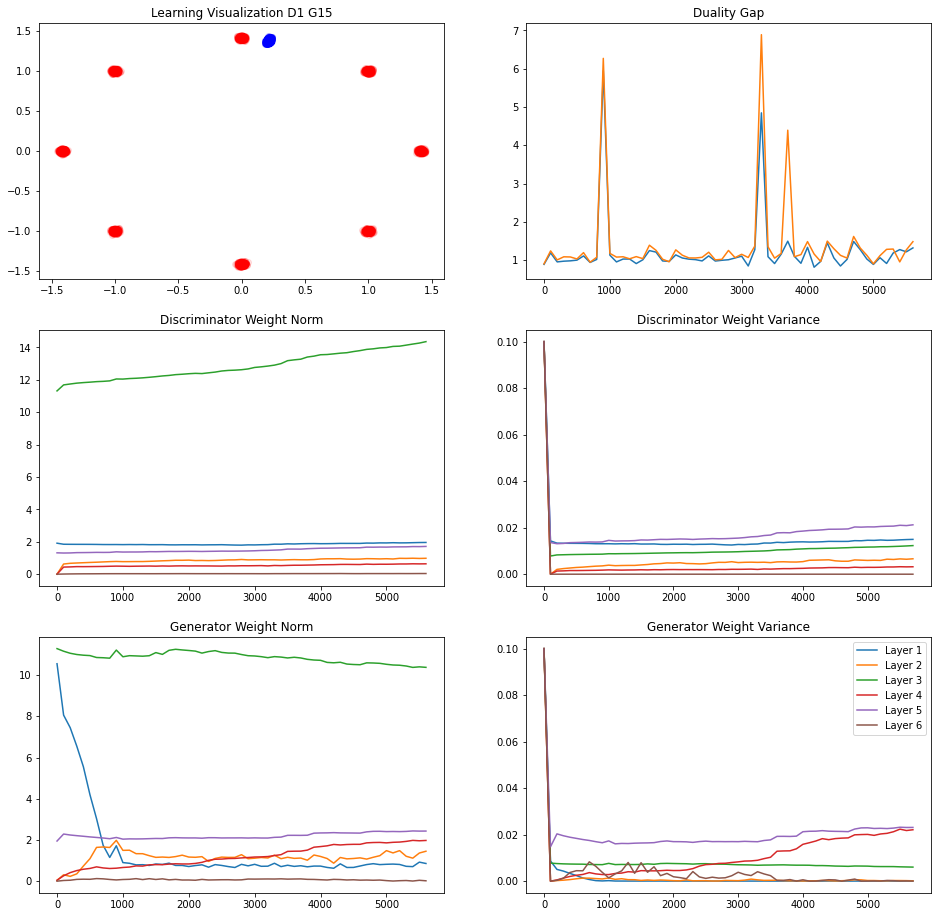

244/250 [============================>.] - ETA: 0sIteration : 5700 [D loss: 0.775820, acc.: 25.39%] [G loss: 0.480730]
Vanilla   Duality GAP :  1.8357743
L Random  Duality Gap :  3.694071


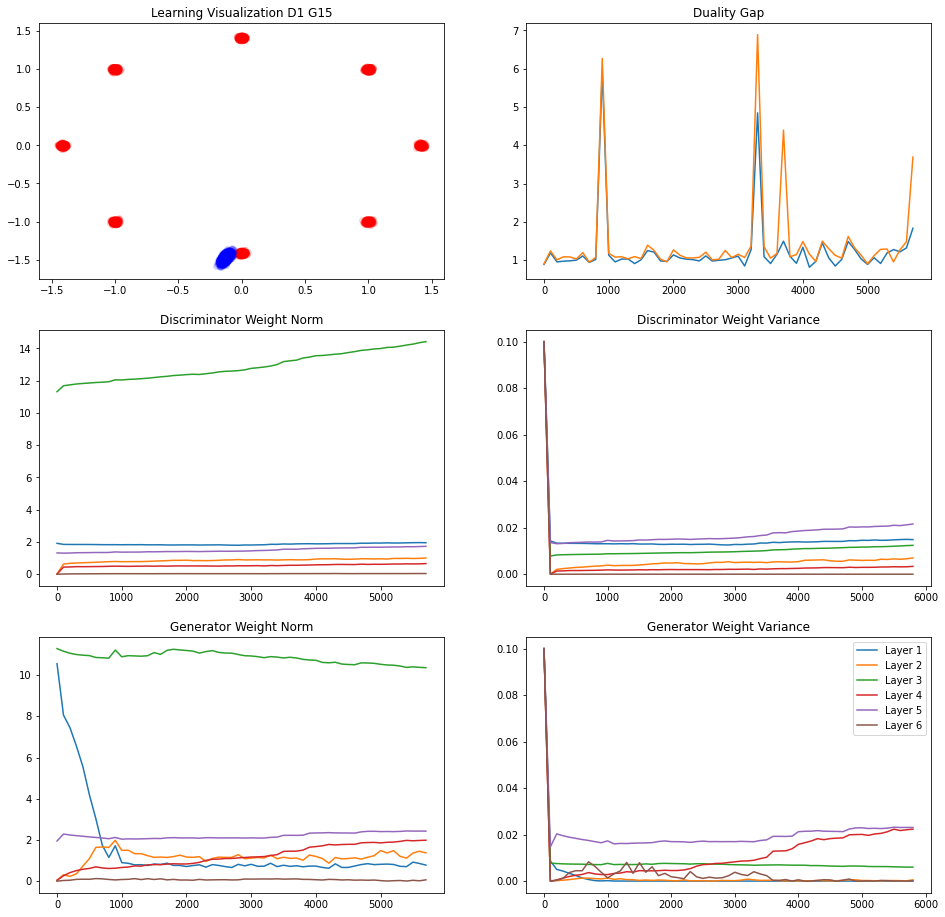

245/250 [============================>.] - ETA: 0sIteration : 5800 [D loss: 0.656833, acc.: 69.53%] [G loss: 0.766465]
Vanilla   Duality GAP :  1.0355856
L Random  Duality Gap :  1.5445865


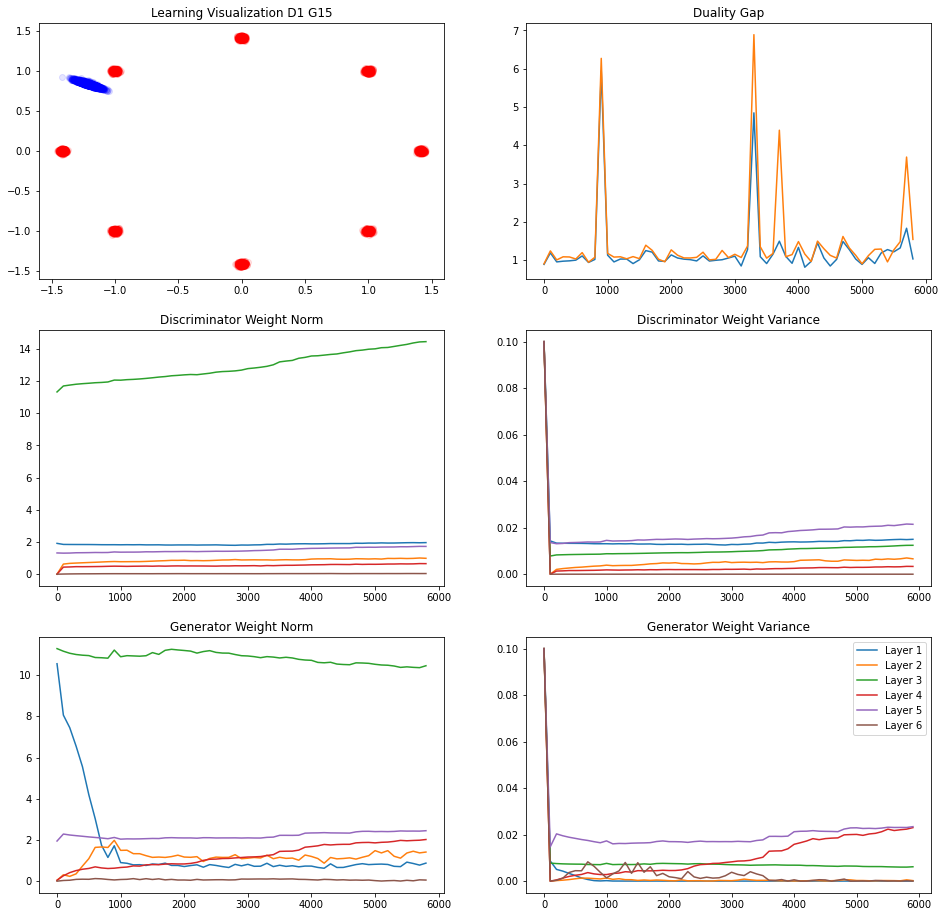

243/250 [============================>.] - ETA: 0sIteration : 5900 [D loss: 0.601178, acc.: 89.45%] [G loss: 0.609182]
Vanilla   Duality GAP :  1.3782021
L Random  Duality Gap :  1.4567437


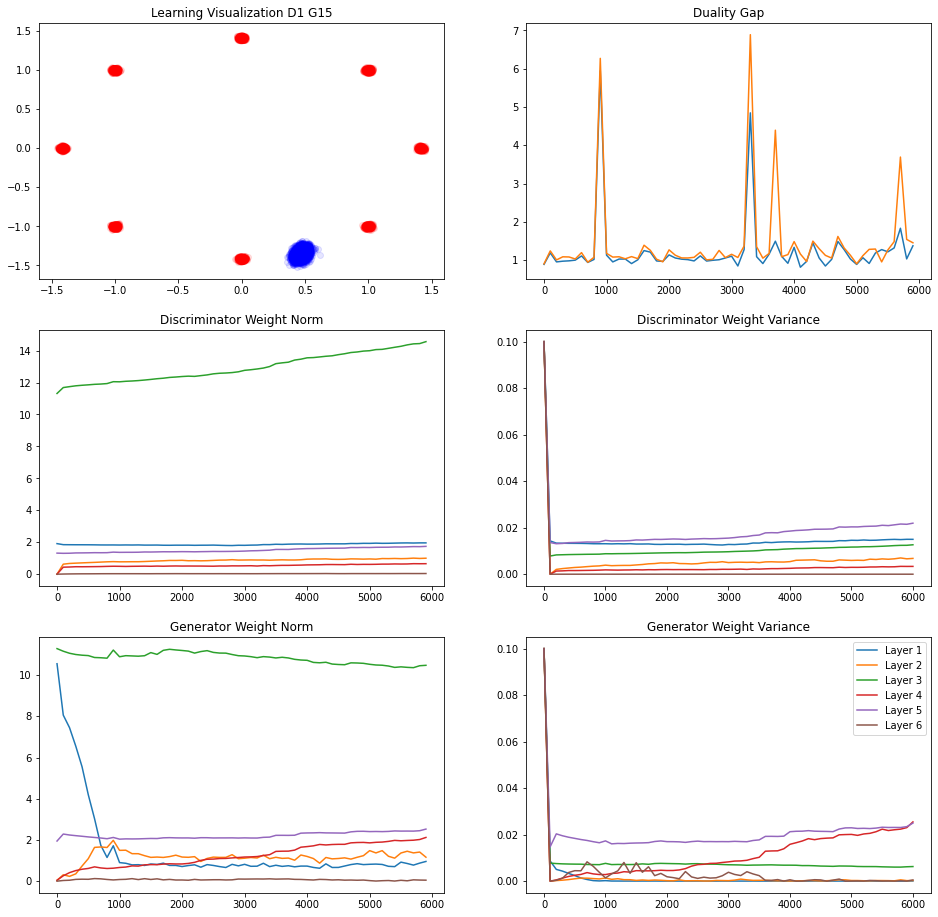

249/250 [============================>.] - ETA: 0sIteration : 6000 [D loss: 0.567375, acc.: 80.47%] [G loss: 1.025064]
Vanilla   Duality GAP :  0.75272924
L Random  Duality Gap :  1.4107482


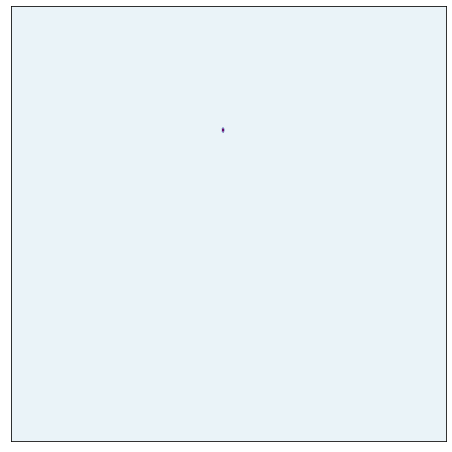

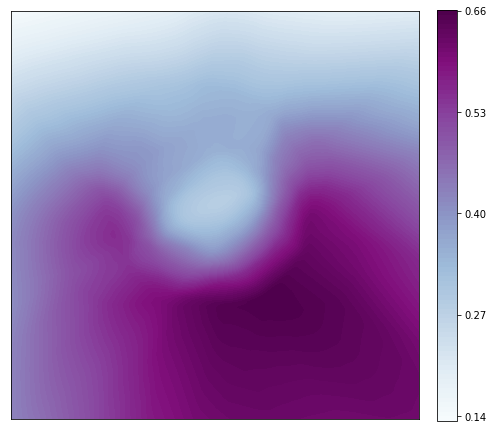

243/250 [============================>.] - ETA: 0sIteration : 6100 [D loss: 0.518728, acc.: 78.12%] [G loss: 0.824486]
Vanilla   Duality GAP :  0.84770274
L Random  Duality Gap :  0.89260423


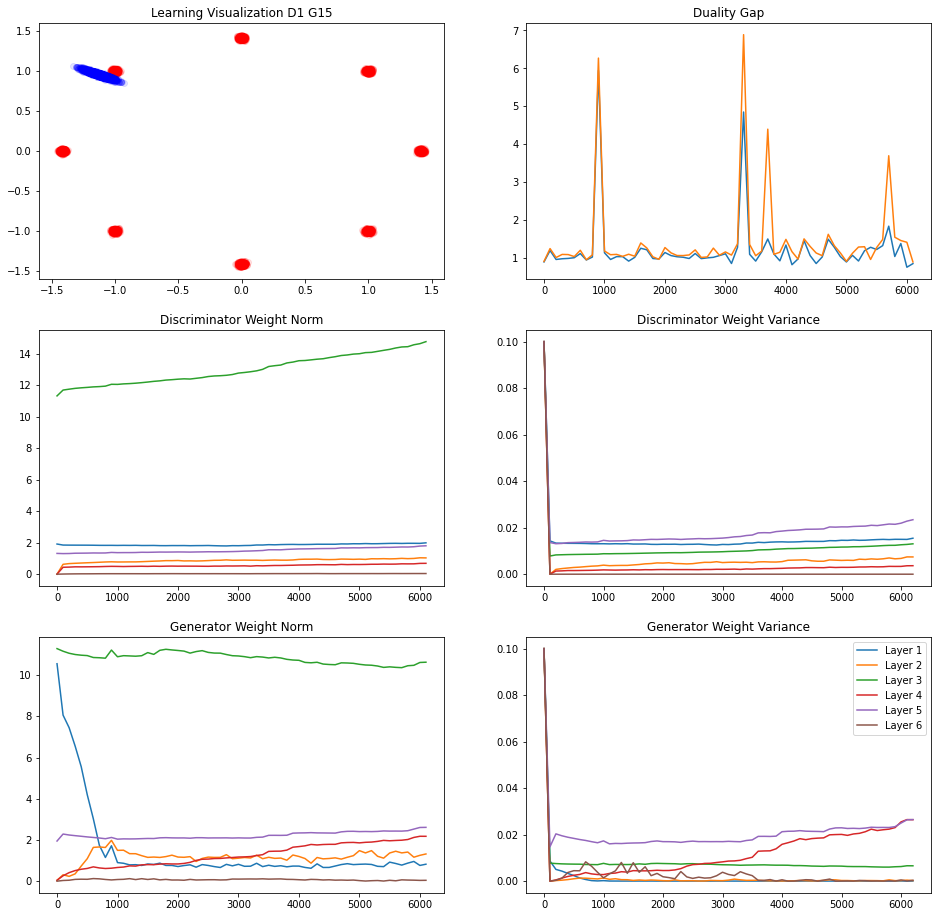

246/250 [============================>.] - ETA: 0sIteration : 6200 [D loss: 0.723457, acc.: 27.73%] [G loss: 0.645598]
Vanilla   Duality GAP :  1.458314
L Random  Duality Gap :  1.5204263


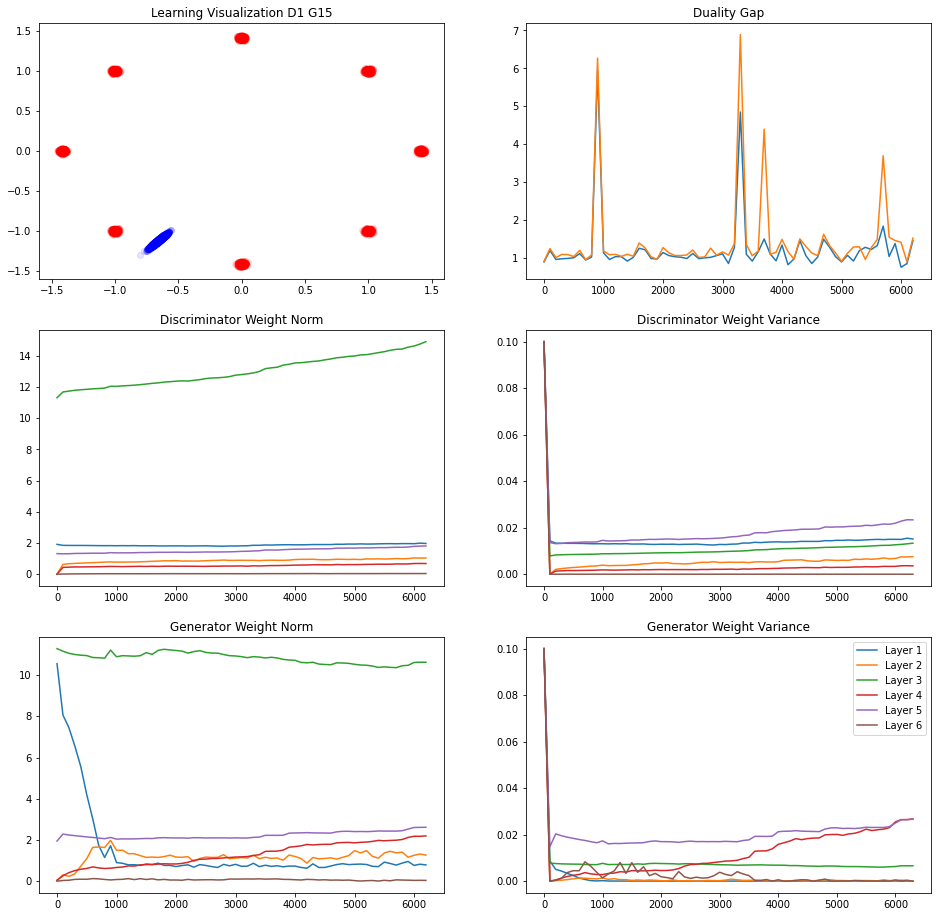

236/250 [===========================>..] - ETA: 0sIteration : 6300 [D loss: 0.611023, acc.: 93.75%] [G loss: 0.839500]
Vanilla   Duality GAP :  0.80689335
L Random  Duality Gap :  1.1428503


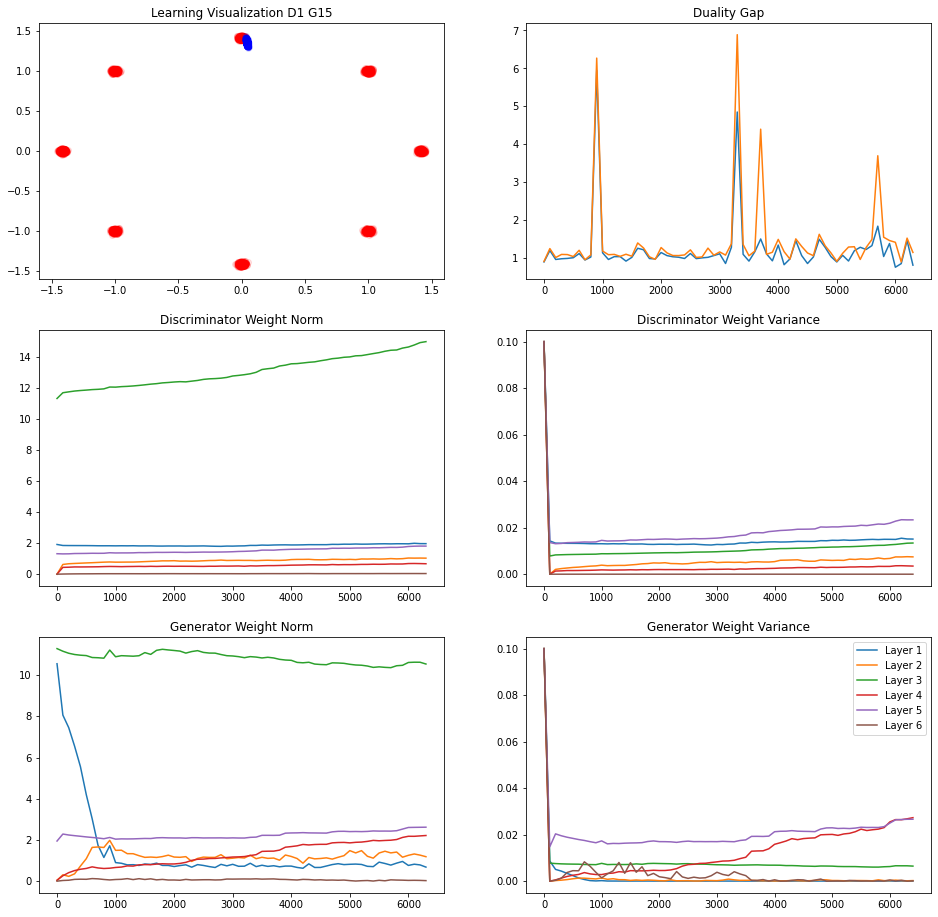

245/250 [============================>.] - ETA: 0sIteration : 6400 [D loss: 0.596449, acc.: 80.86%] [G loss: 0.920087]
Vanilla   Duality GAP :  0.8479792
L Random  Duality Gap :  1.5115887


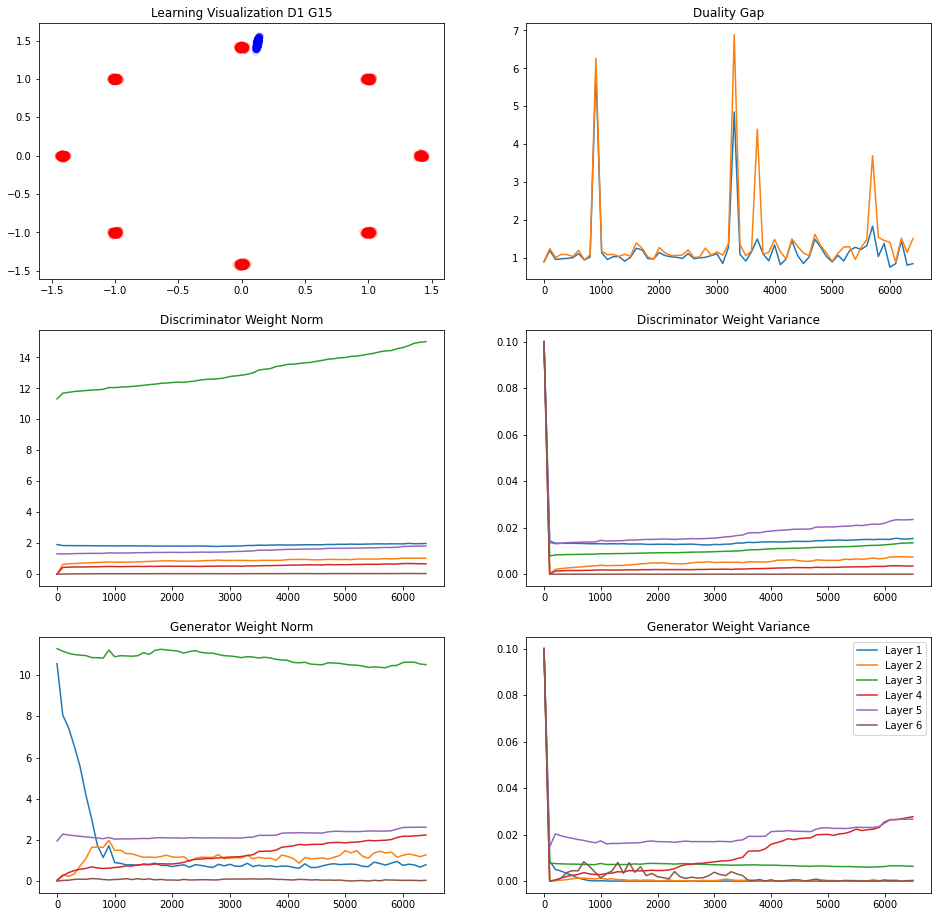

246/250 [============================>.] - ETA: 0sIteration : 6500 [D loss: 0.461868, acc.: 83.20%] [G loss: 0.879141]
Vanilla   Duality GAP :  1.1356025
L Random  Duality Gap :  6.628038


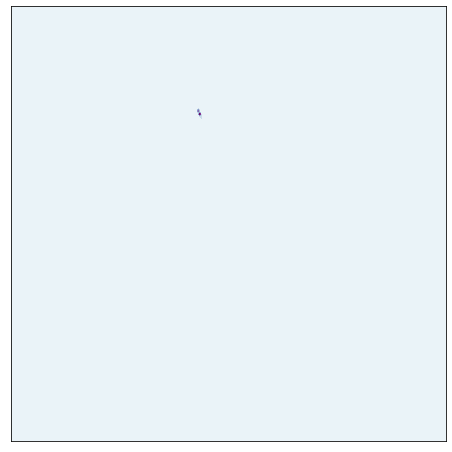

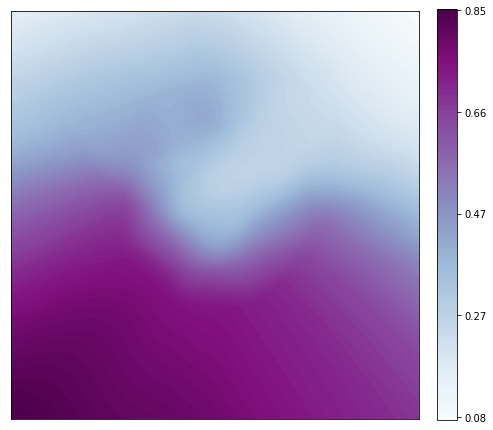

241/250 [===========================>..] - ETA: 0sIteration : 6600 [D loss: 0.798896, acc.: 23.05%] [G loss: 0.510011]
Vanilla   Duality GAP :  1.3129996
L Random  Duality Gap :  1.2952514


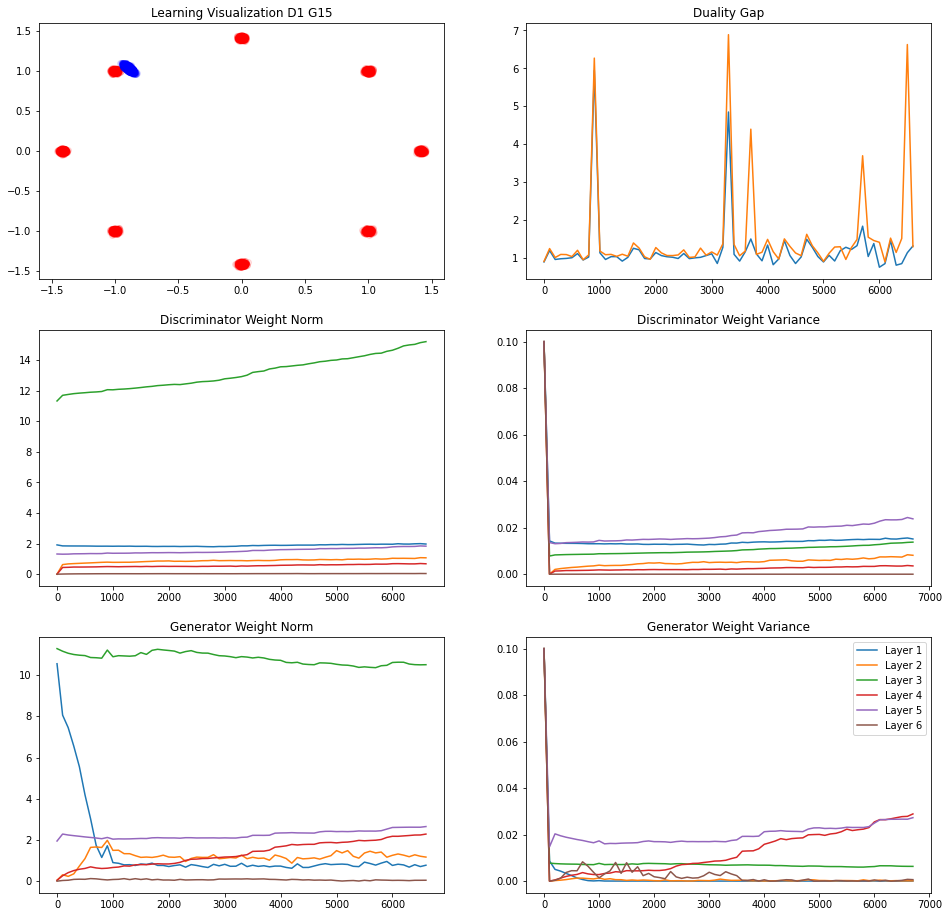

240/250 [===========================>..] - ETA: 0sIteration : 6700 [D loss: 0.742699, acc.: 28.52%] [G loss: 0.631312]
Vanilla   Duality GAP :  1.1242574
L Random  Duality Gap :  1.1876653


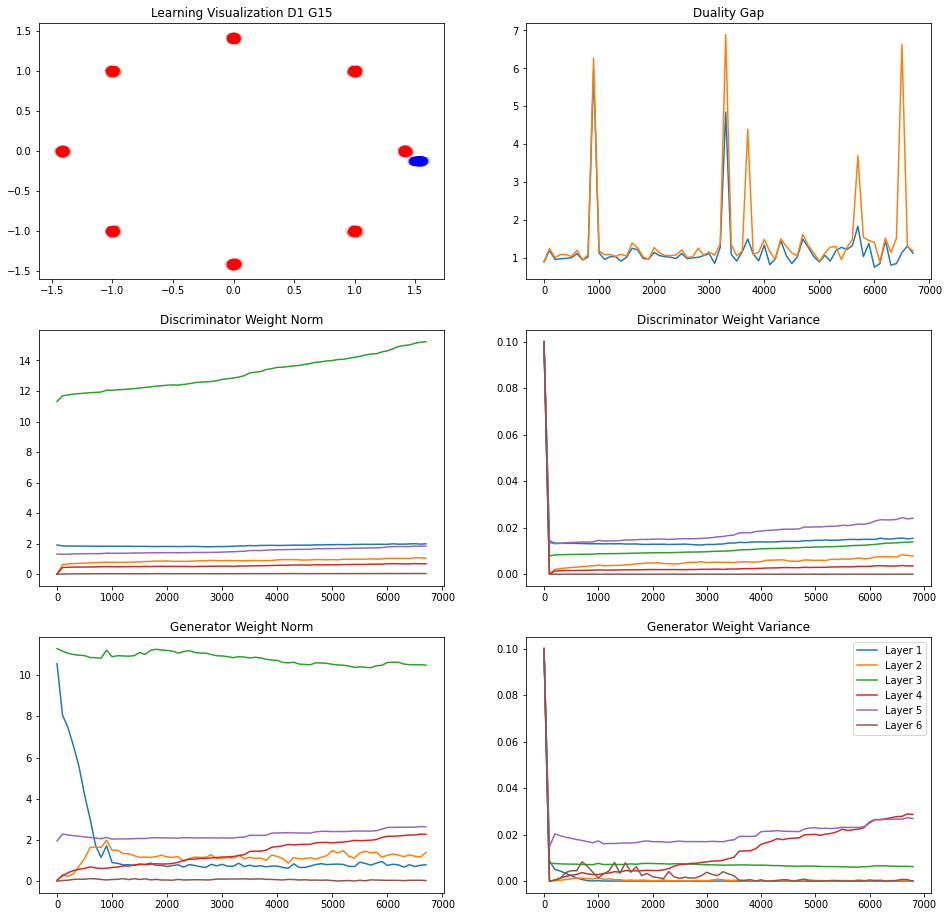

243/250 [============================>.] - ETA: 0sIteration : 6800 [D loss: 0.617810, acc.: 81.64%] [G loss: 0.816900]
Vanilla   Duality GAP :  1.3927208
L Random  Duality Gap :  1.3974612


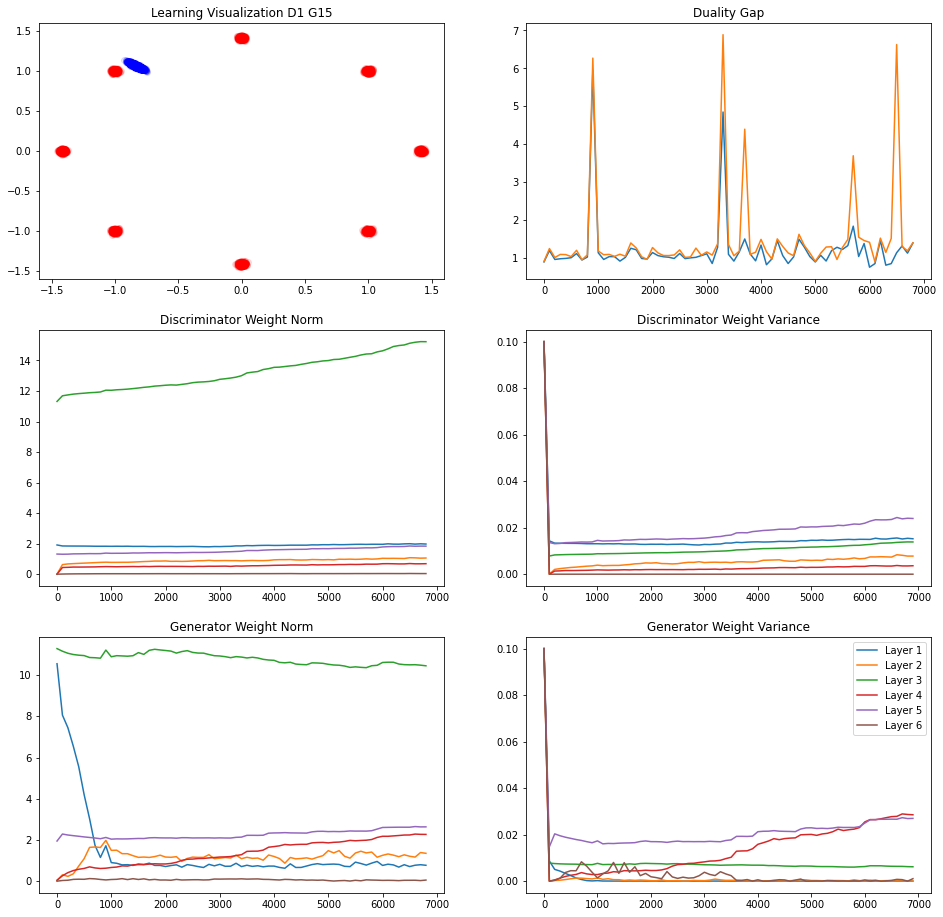

248/250 [============================>.] - ETA: 0sIteration : 6900 [D loss: 0.775631, acc.: 38.67%] [G loss: 0.538737]
Vanilla   Duality GAP :  1.1784599
L Random  Duality Gap :  1.1811658


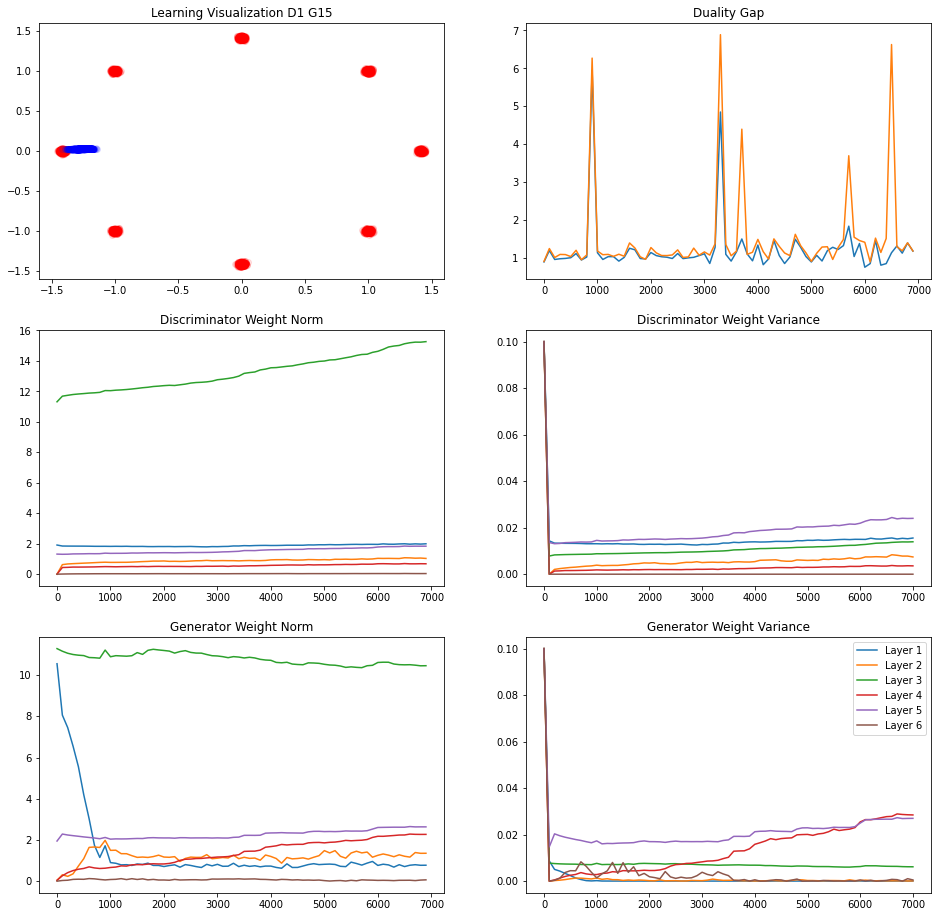

238/250 [===========================>..] - ETA: 0sIteration : 7000 [D loss: 0.534461, acc.: 72.27%] [G loss: 1.196219]
Vanilla   Duality GAP :  0.6695249
L Random  Duality Gap :  7.301618


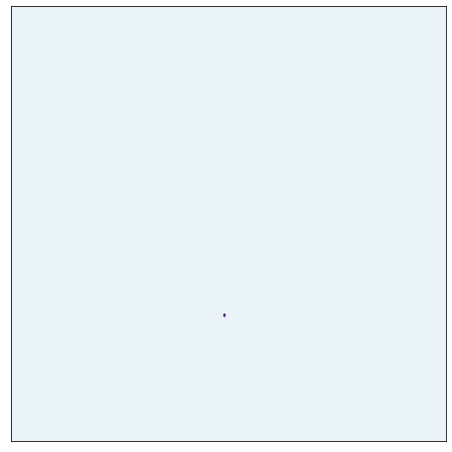

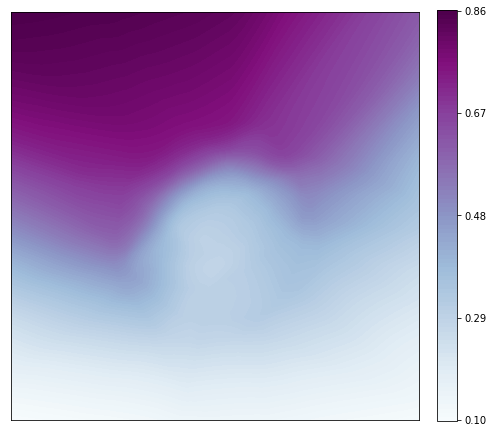

239/250 [===========================>..] - ETA: 0sIteration : 7100 [D loss: 0.692056, acc.: 29.69%] [G loss: 0.691974]
Vanilla   Duality GAP :  0.9250826
L Random  Duality Gap :  1.2329972


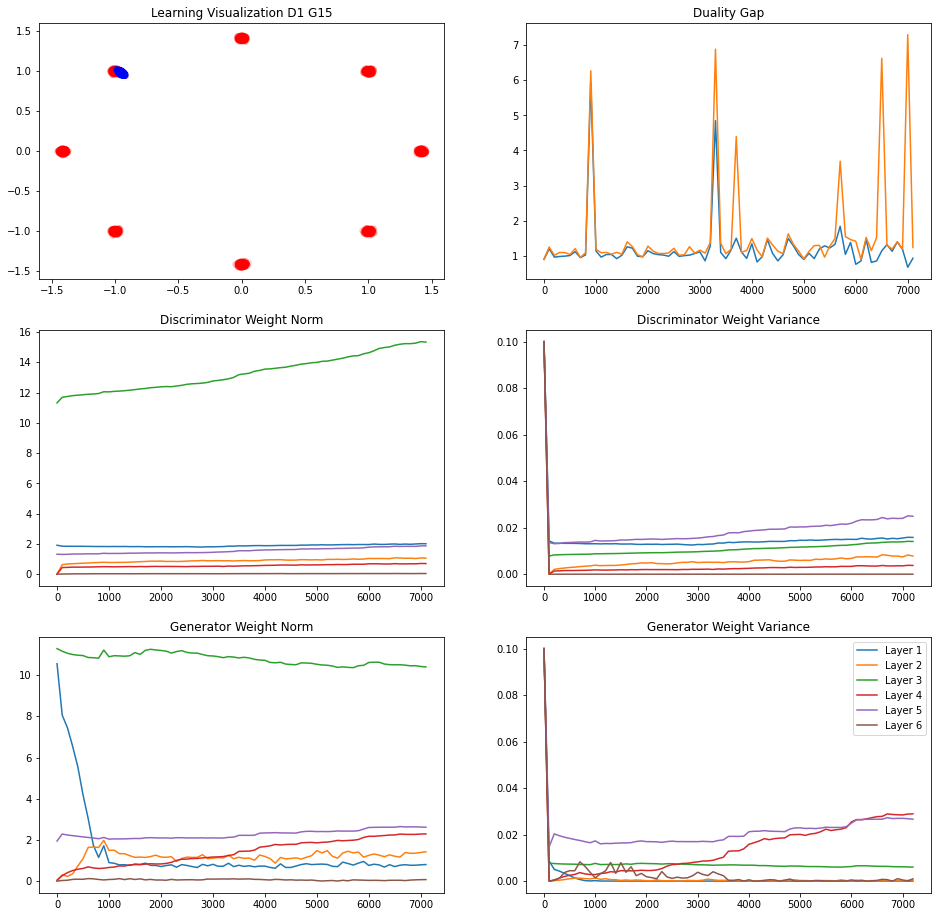

240/250 [===========================>..] - ETA: 0sIteration : 7200 [D loss: 0.565894, acc.: 83.98%] [G loss: 0.433783]
Vanilla   Duality GAP :  1.7375617
L Random  Duality Gap :  1.8668549


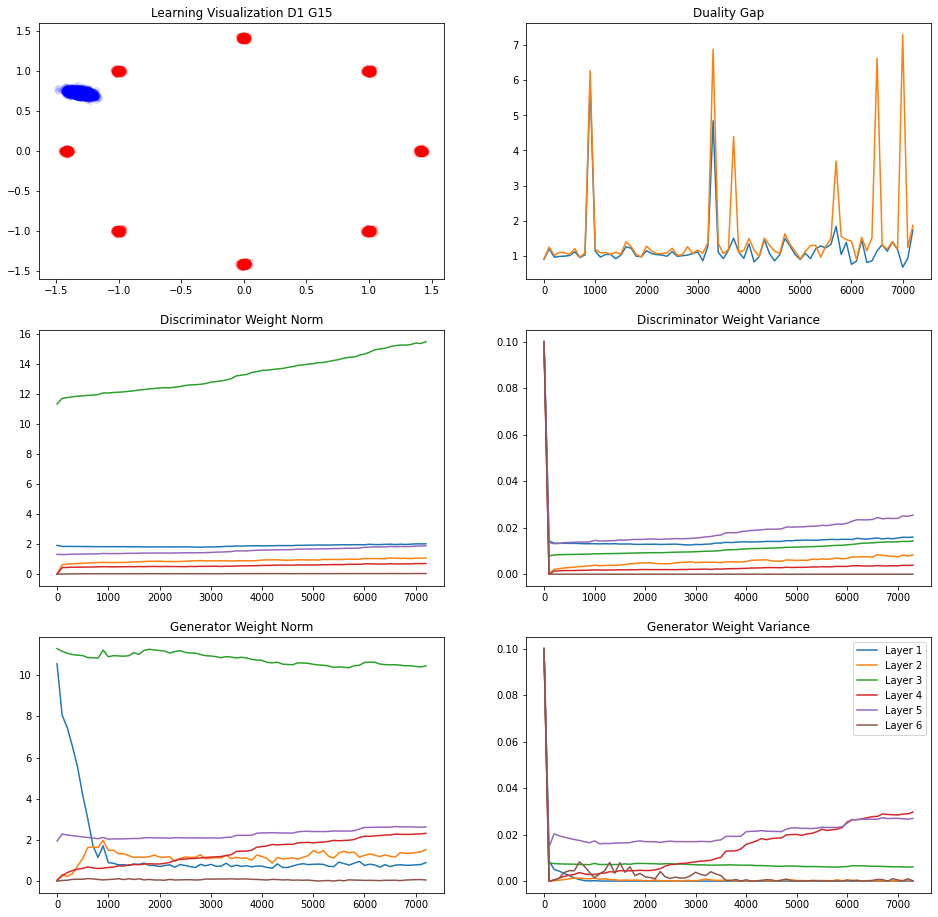

243/250 [============================>.] - ETA: 0sIteration : 7300 [D loss: 0.484859, acc.: 79.69%] [G loss: 1.247524]
Vanilla   Duality GAP :  0.6534275
L Random  Duality Gap :  7.51252


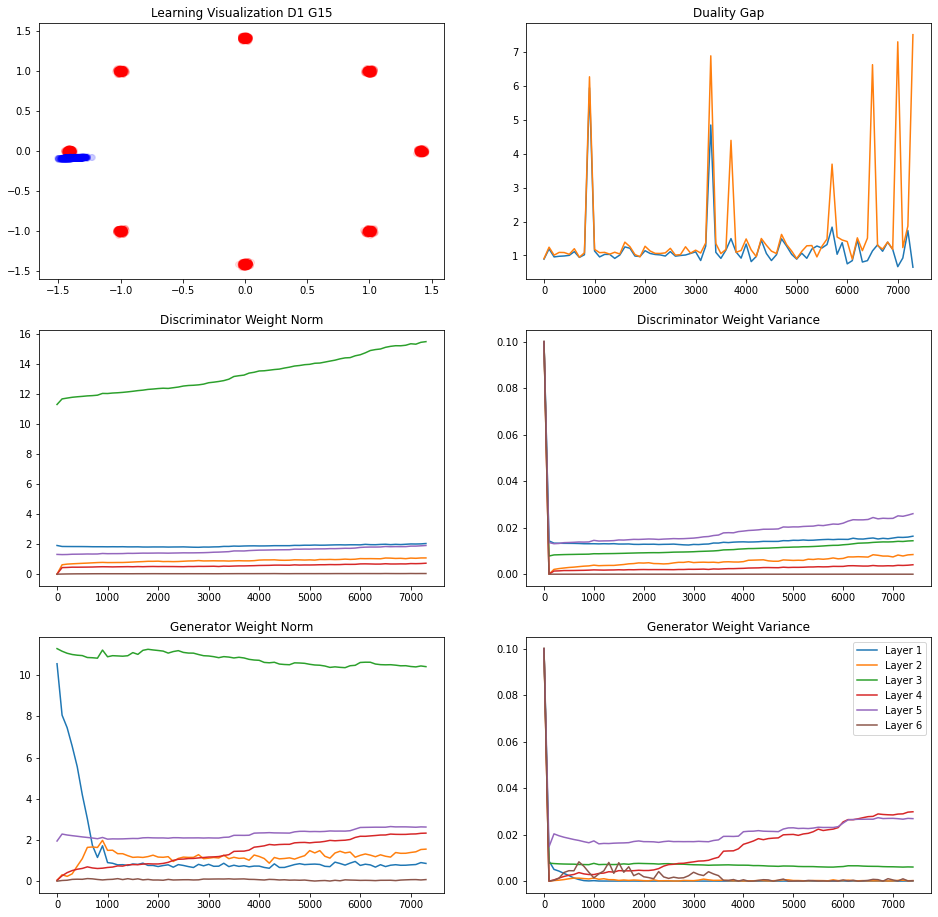

246/250 [============================>.] - ETA: 0sIteration : 7400 [D loss: 0.543914, acc.: 71.88%] [G loss: 0.544793]
Vanilla   Duality GAP :  1.688801
L Random  Duality Gap :  3.3587606


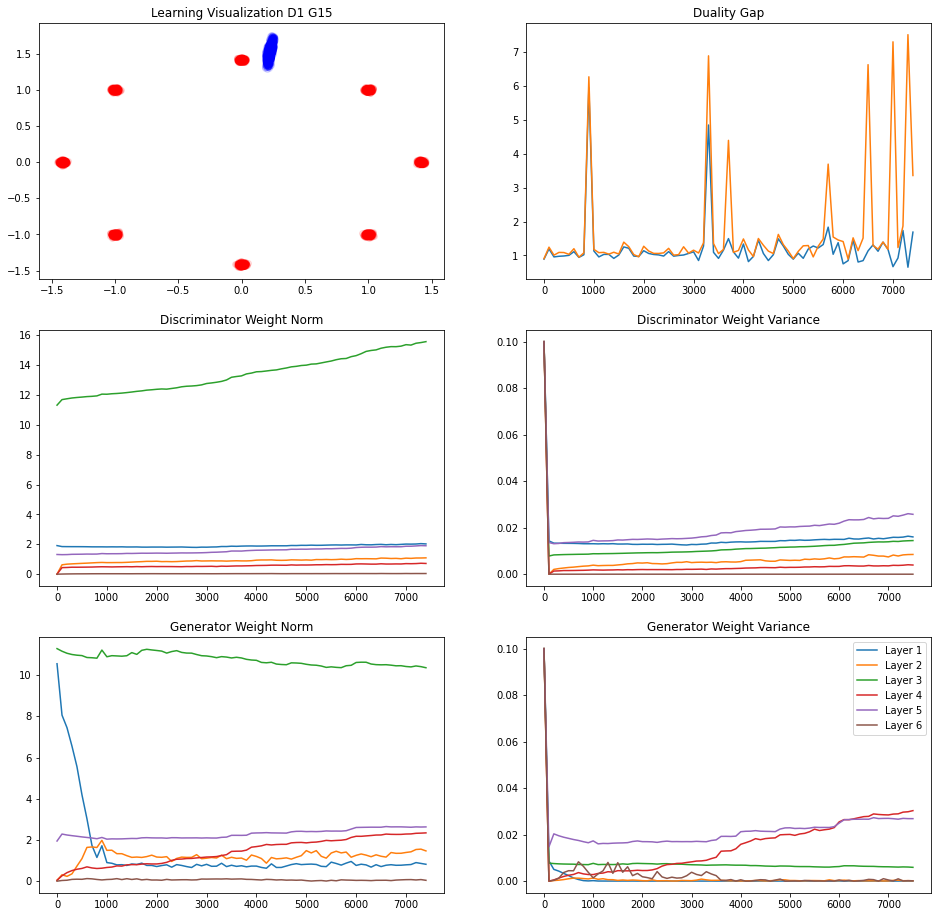

242/250 [============================>.] - ETA: 0sIteration : 7500 [D loss: 0.607206, acc.: 78.91%] [G loss: 0.894908]
Vanilla   Duality GAP :  0.82054687
L Random  Duality Gap :  1.2973647


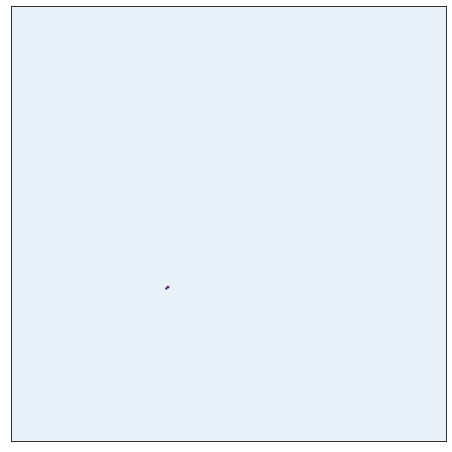

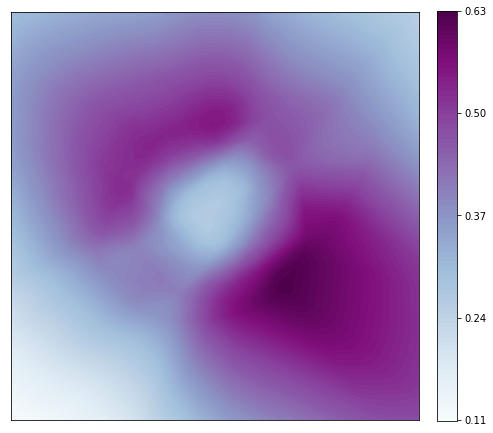

249/250 [============================>.] - ETA: 0sIteration : 7600 [D loss: 0.638626, acc.: 75.78%] [G loss: 0.892900]
Vanilla   Duality GAP :  1.2856247
L Random  Duality Gap :  1.3507978


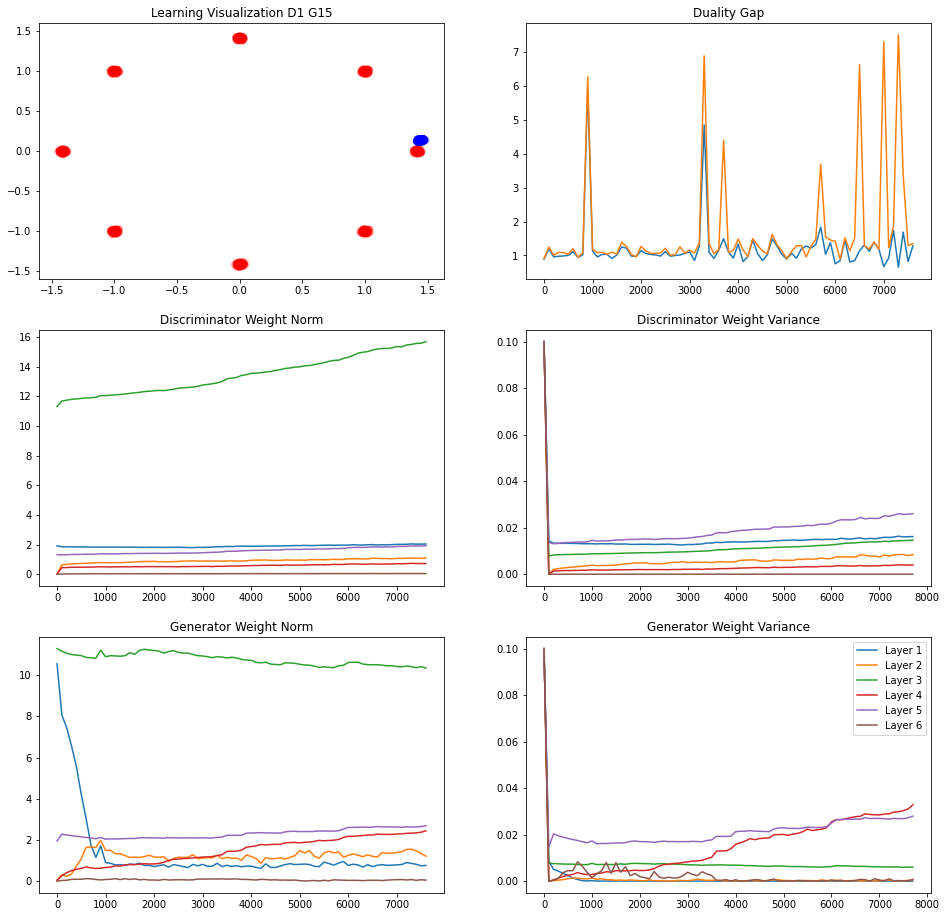

249/250 [============================>.] - ETA: 0sIteration : 7700 [D loss: 0.592832, acc.: 74.22%] [G loss: 0.847394]
Vanilla   Duality GAP :  0.93752027
L Random  Duality Gap :  1.6114806


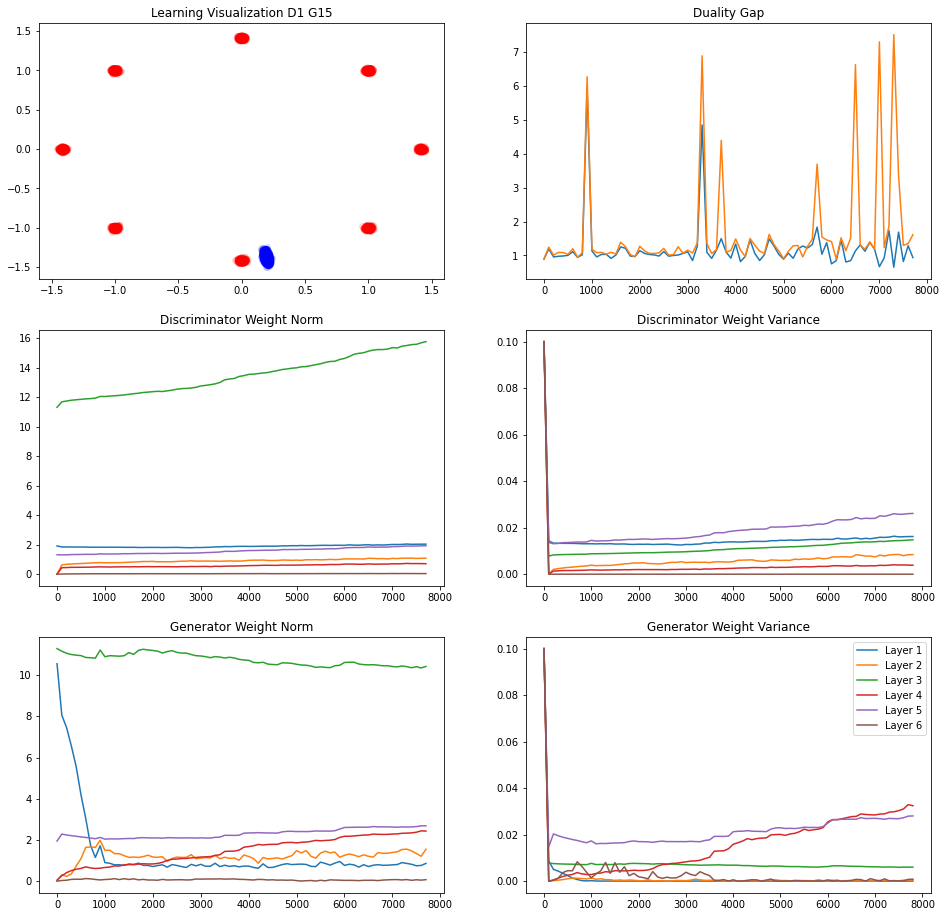

249/250 [============================>.] - ETA: 0sIteration : 7800 [D loss: 0.509829, acc.: 86.33%] [G loss: 1.089843]
Vanilla   Duality GAP :  0.66121244
L Random  Duality Gap :  1.2783383


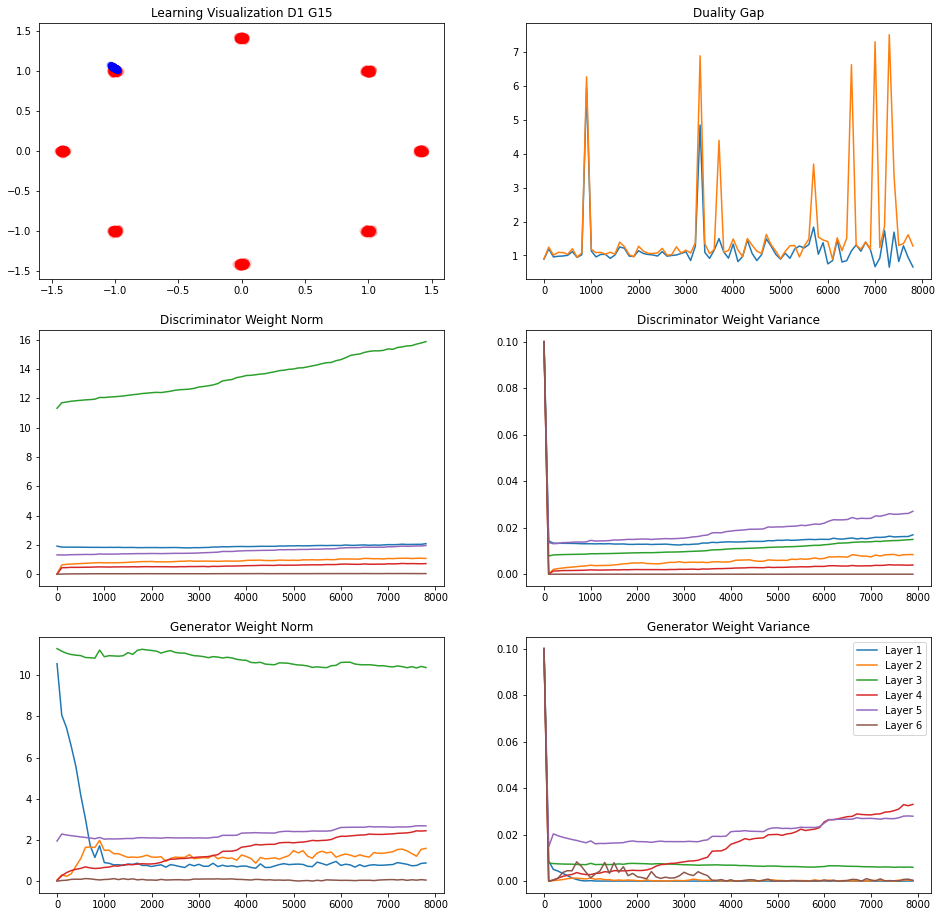

241/250 [===========================>..] - ETA: 0sIteration : 7900 [D loss: 0.629203, acc.: 75.00%] [G loss: 0.886666]
Vanilla   Duality GAP :  0.9153938
L Random  Duality Gap :  0.9881777


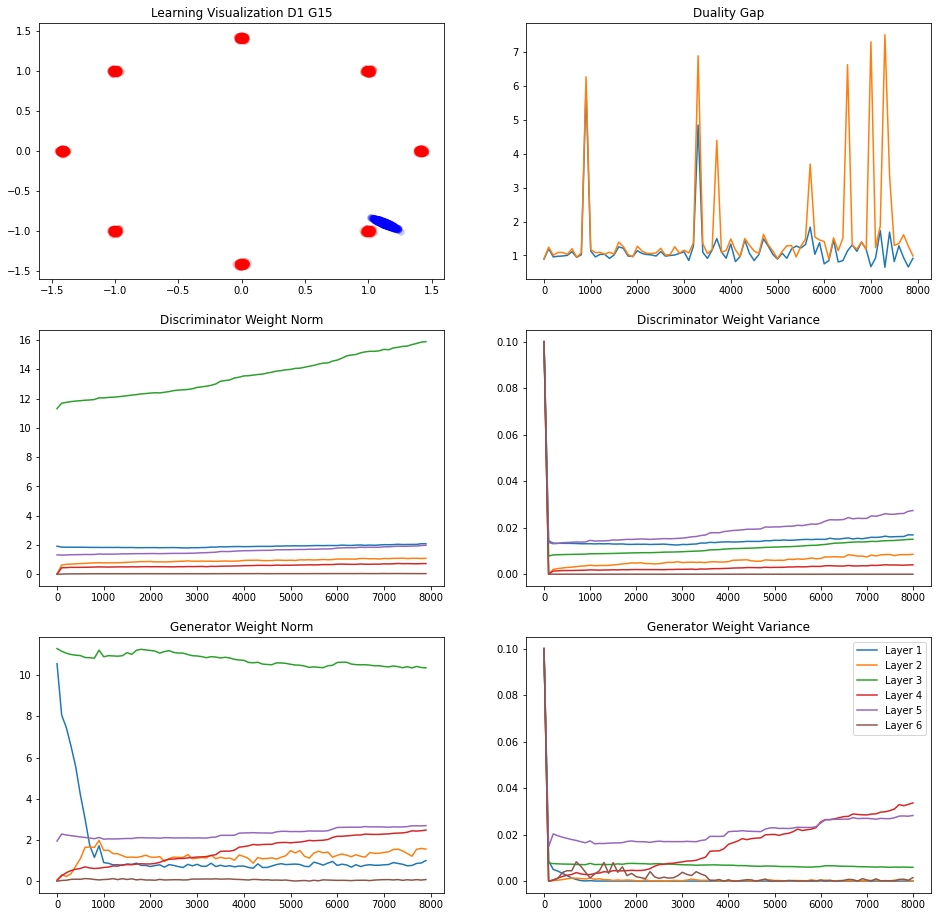

240/250 [===========================>..] - ETA: 0sIteration : 8000 [D loss: 0.574389, acc.: 71.48%] [G loss: 1.076303]
Vanilla   Duality GAP :  0.8152892
L Random  Duality Gap :  4.7764735


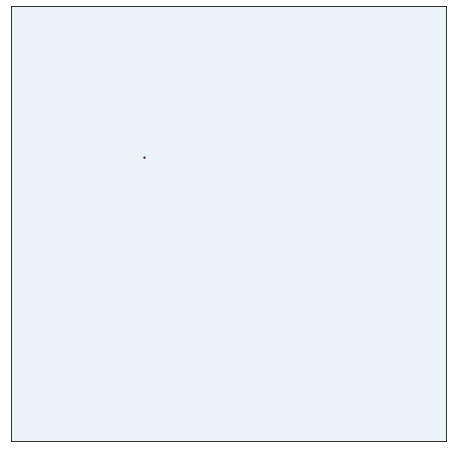

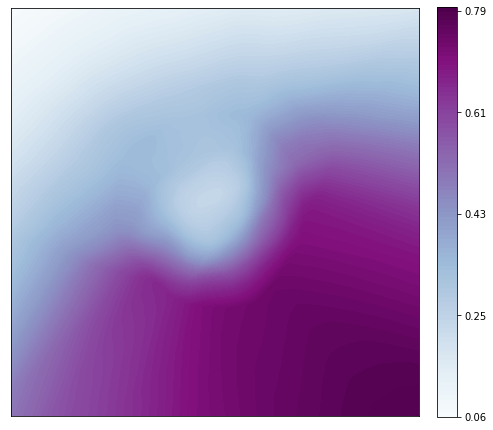

245/250 [============================>.] - ETA: 0sIteration : 8100 [D loss: 0.638451, acc.: 80.08%] [G loss: 0.778661]
Vanilla   Duality GAP :  0.9198568
L Random  Duality Gap :  1.018249


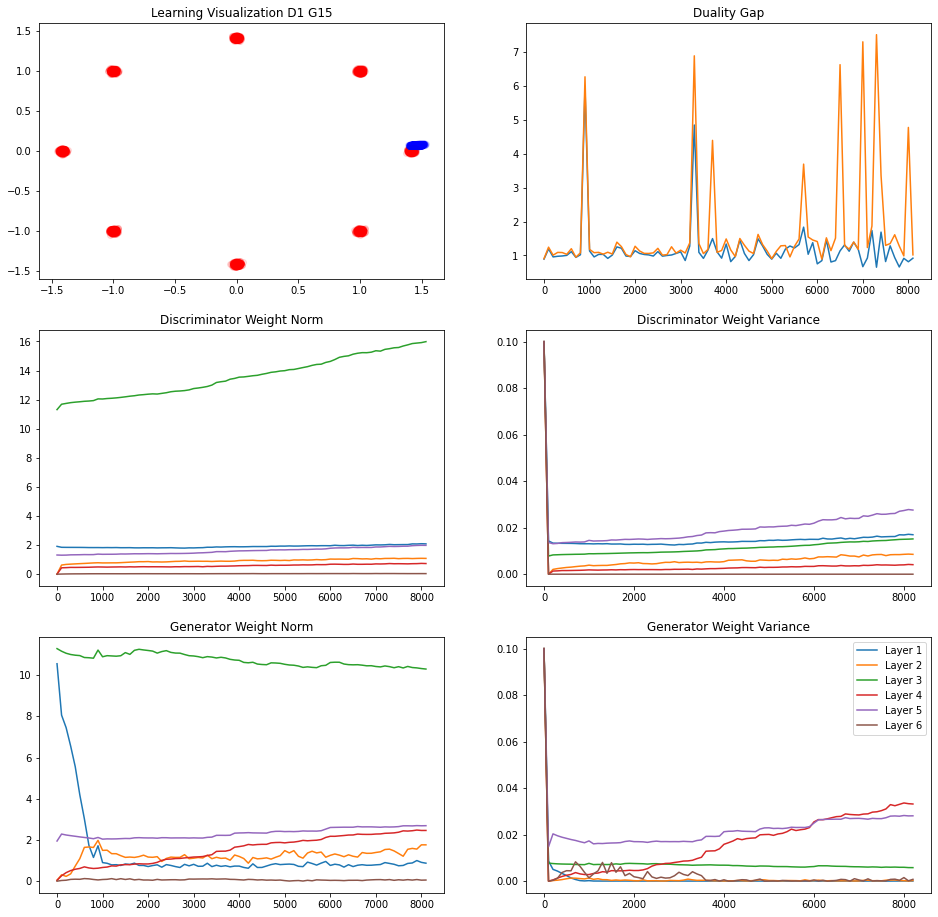

249/250 [============================>.] - ETA: 0sIteration : 8200 [D loss: 0.586651, acc.: 79.69%] [G loss: 0.925279]
Vanilla   Duality GAP :  0.7828473
L Random  Duality Gap :  0.75042236


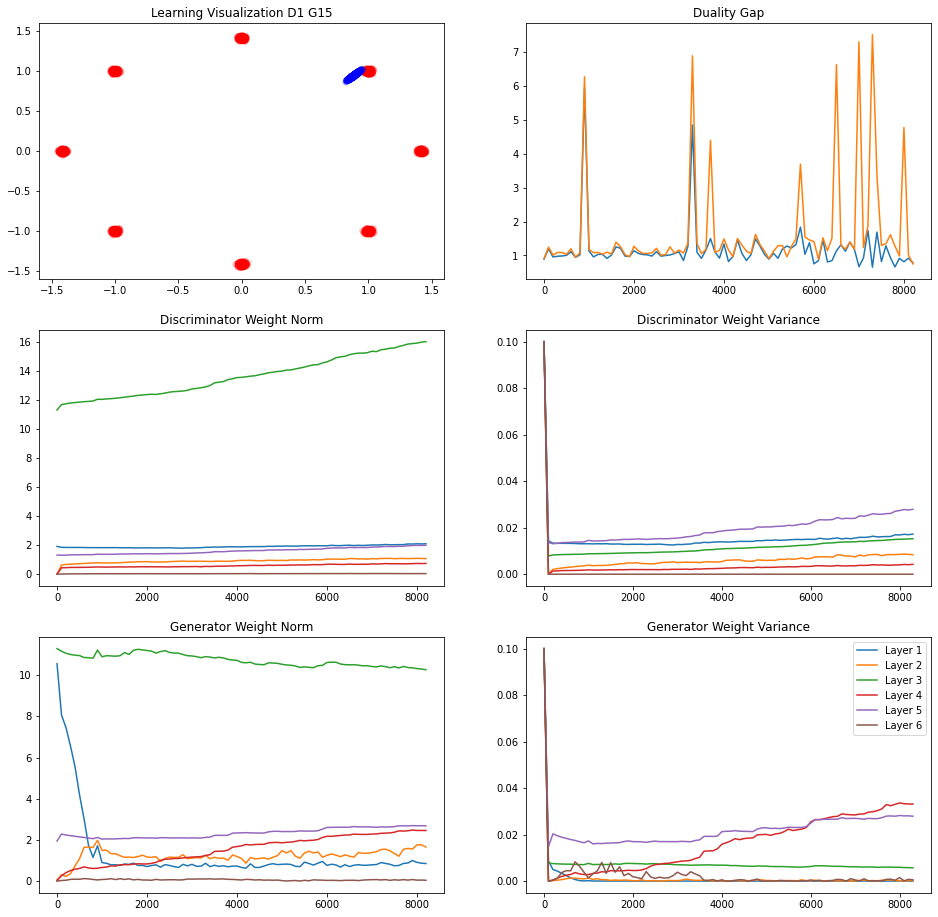

244/250 [============================>.] - ETA: 0sIteration : 8300 [D loss: 0.502596, acc.: 72.66%] [G loss: 1.358952]
Vanilla   Duality GAP :  0.5566499
L Random  Duality Gap :  4.026873


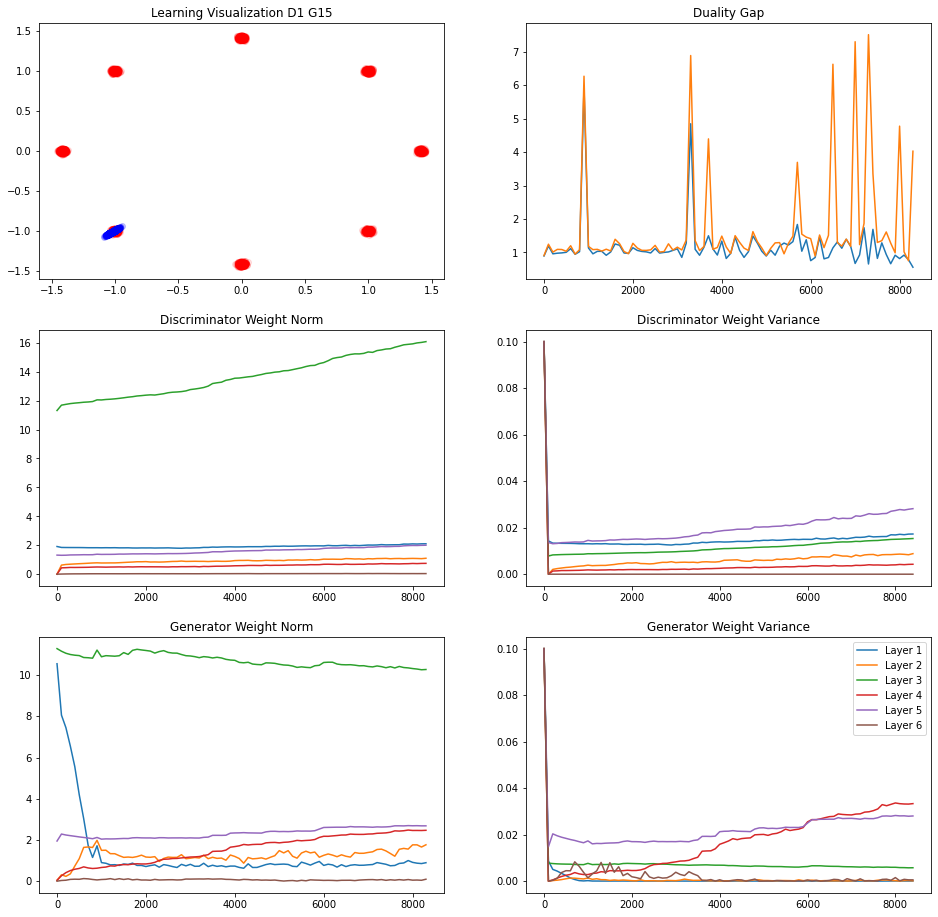

244/250 [============================>.] - ETA: 0sIteration : 8400 [D loss: 0.771108, acc.: 39.45%] [G loss: 0.534720]
Vanilla   Duality GAP :  1.3447492
L Random  Duality Gap :  1.585241


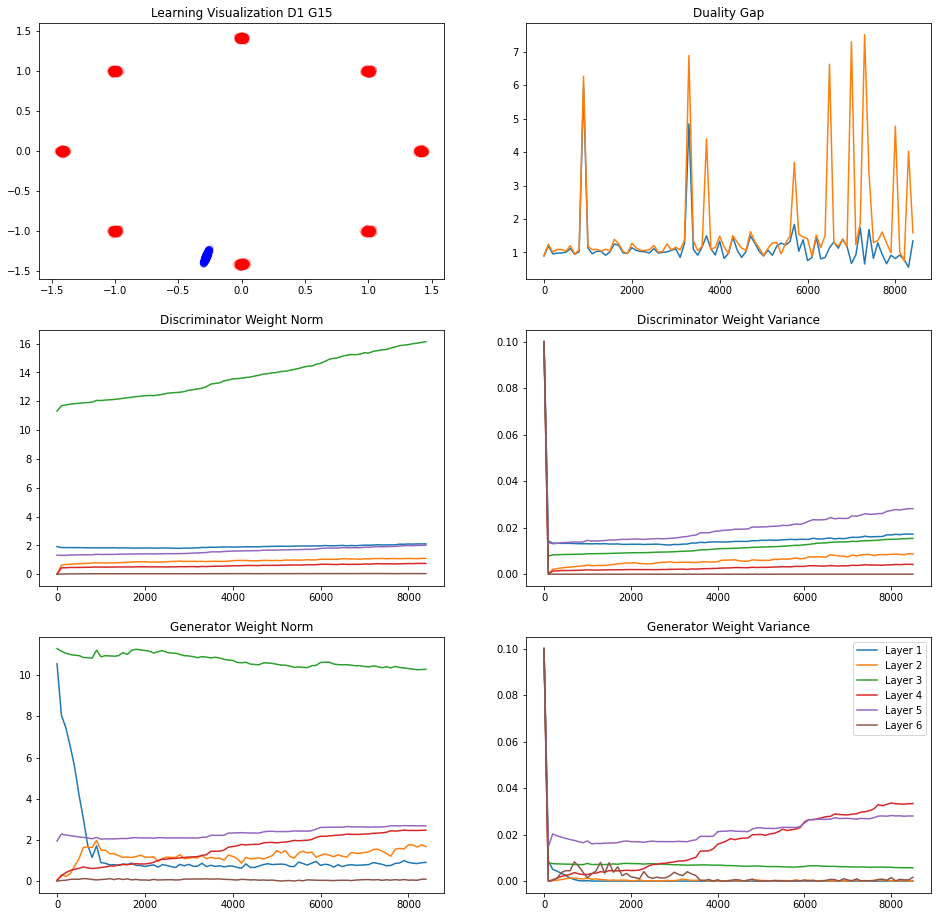

243/250 [============================>.] - ETA: 0sIteration : 8500 [D loss: 0.622013, acc.: 75.39%] [G loss: 0.846169]
Vanilla   Duality GAP :  0.8380064
L Random  Duality Gap :  1.313054


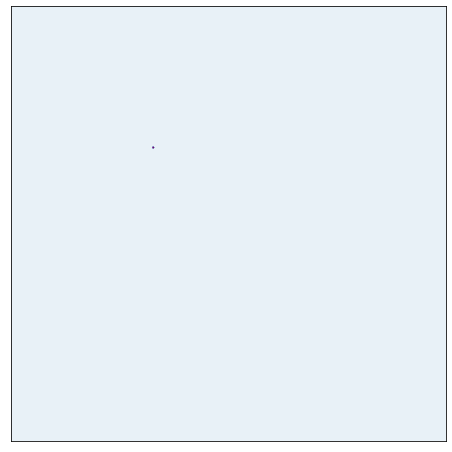

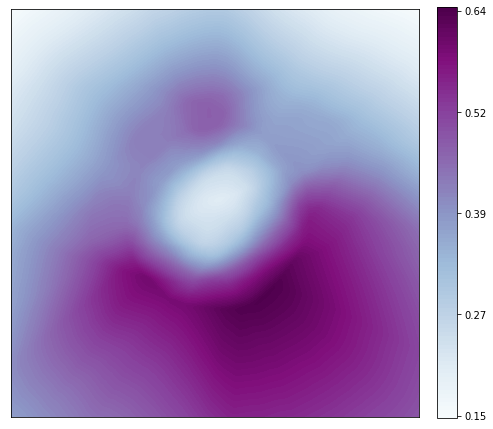

238/250 [===========================>..] - ETA: 0sIteration : 8600 [D loss: 0.584995, acc.: 73.05%] [G loss: 1.035754]
Vanilla   Duality GAP :  0.78921056
L Random  Duality Gap :  0.83292204


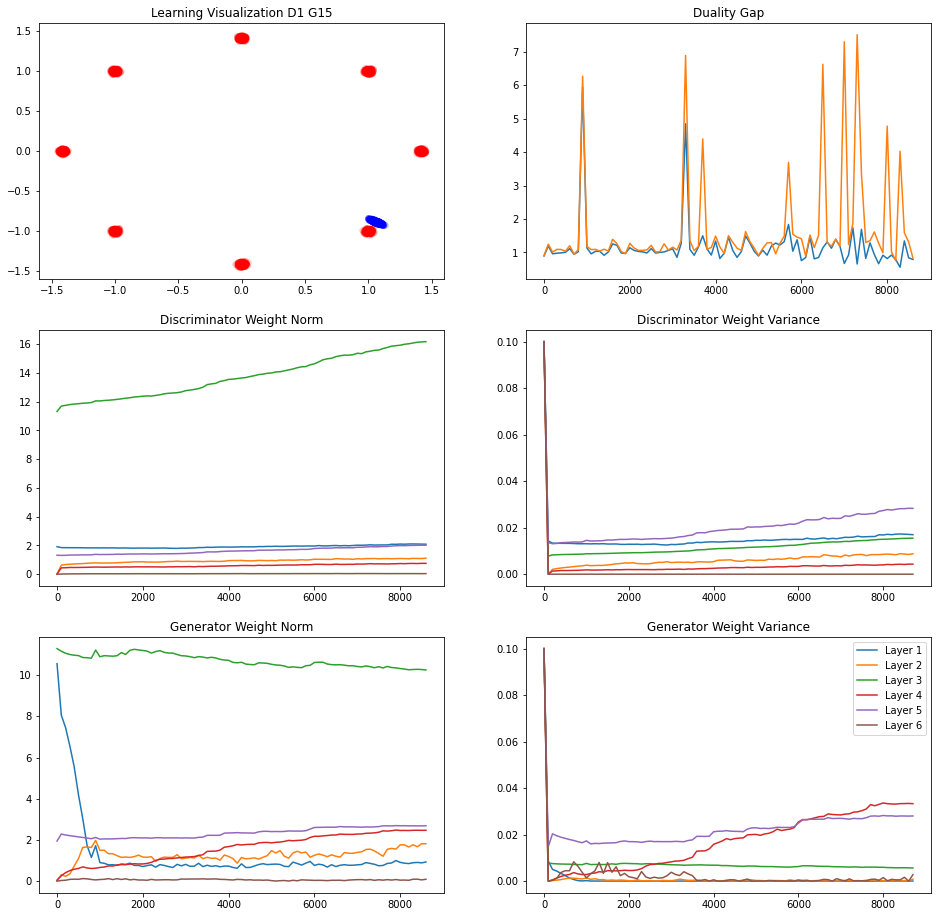

240/250 [===========================>..] - ETA: 0sIteration : 8700 [D loss: 0.685249, acc.: 31.25%] [G loss: 0.672714]
Vanilla   Duality GAP :  1.0765736
L Random  Duality Gap :  1.1056501


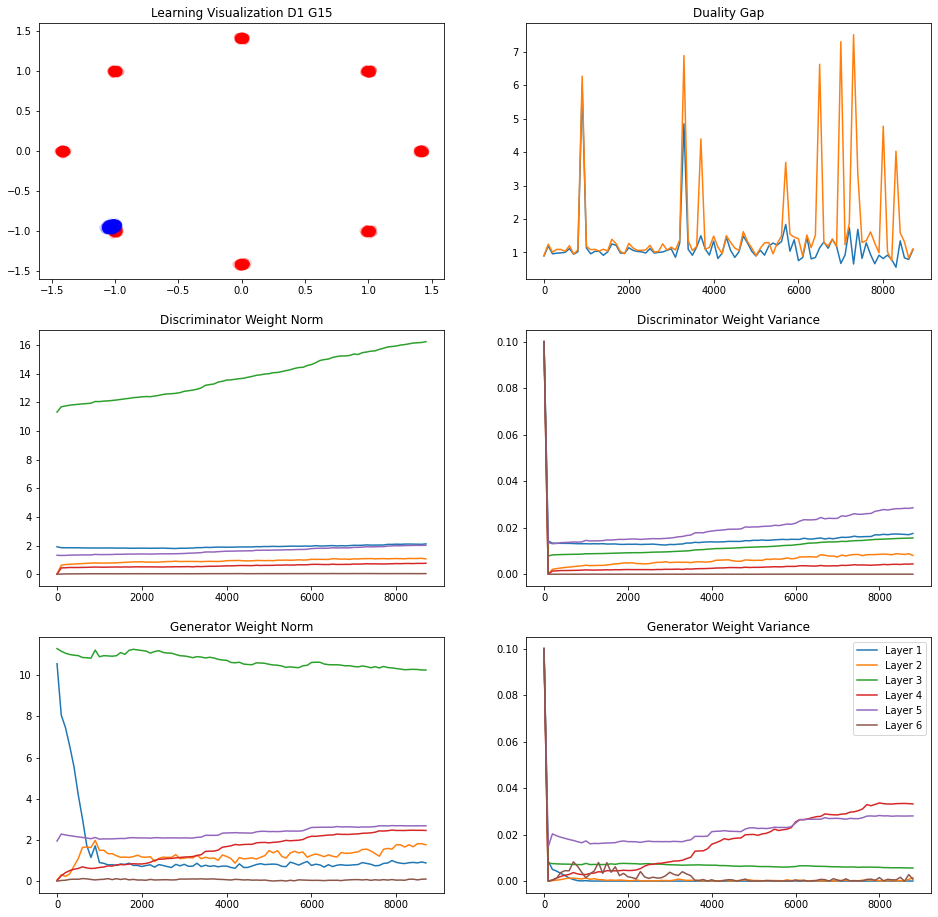

245/250 [============================>.] - ETA: 0sIteration : 8800 [D loss: 0.620806, acc.: 78.12%] [G loss: 0.928895]
Vanilla   Duality GAP :  0.8828834
L Random  Duality Gap :  1.0895926


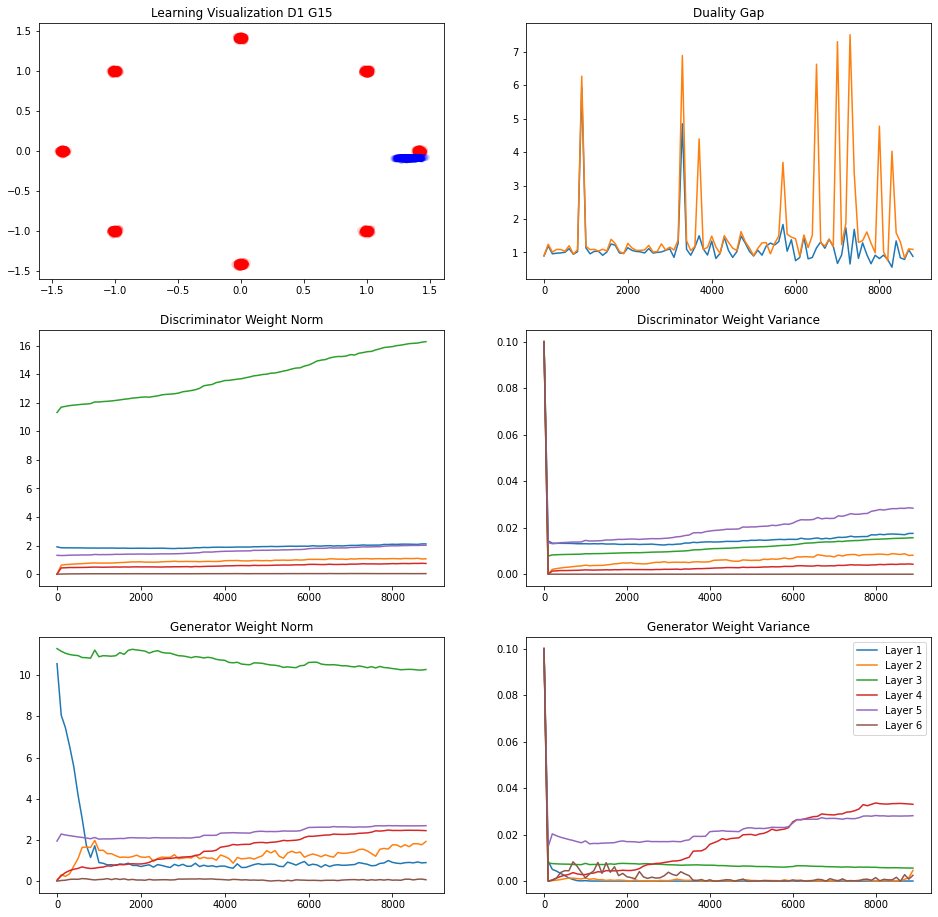

239/250 [===========================>..] - ETA: 0sIteration : 8900 [D loss: 0.496160, acc.: 85.55%] [G loss: 1.346267]
Vanilla   Duality GAP :  0.56058526
L Random  Duality Gap :  1.2599167


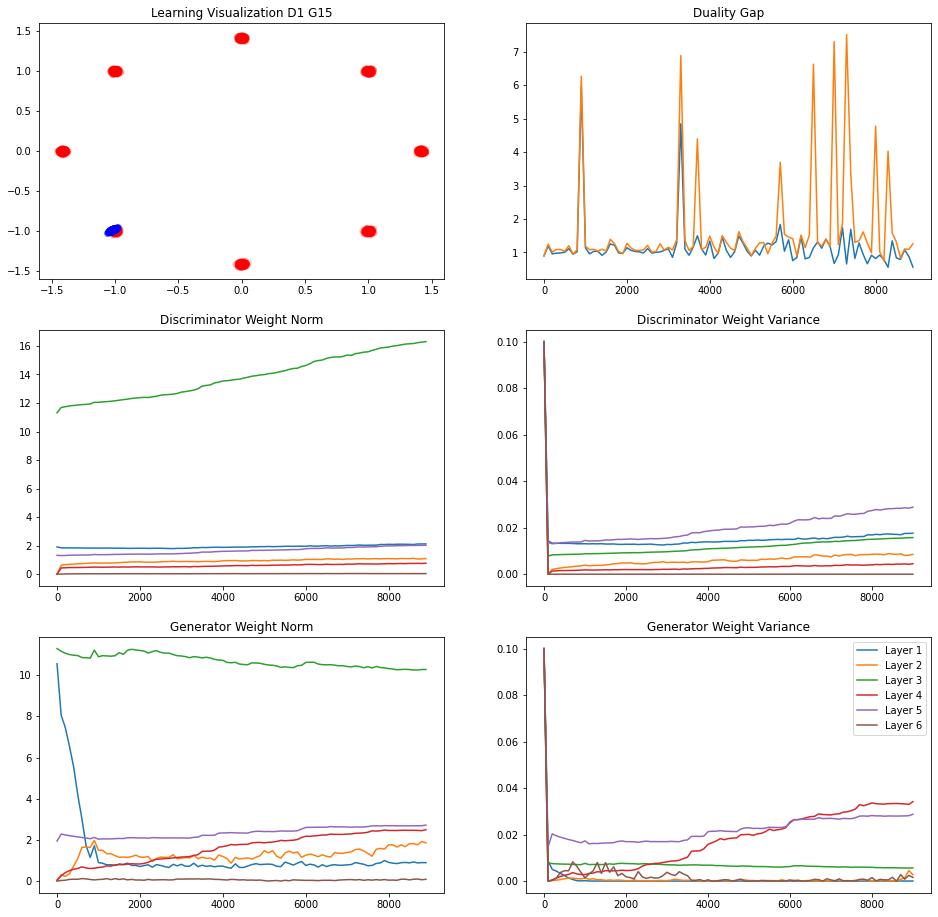

245/250 [============================>.] - ETA: 0sIteration : 9000 [D loss: 0.708609, acc.: 27.73%] [G loss: 0.650859]
Vanilla   Duality GAP :  0.9810877
L Random  Duality Gap :  0.99932075


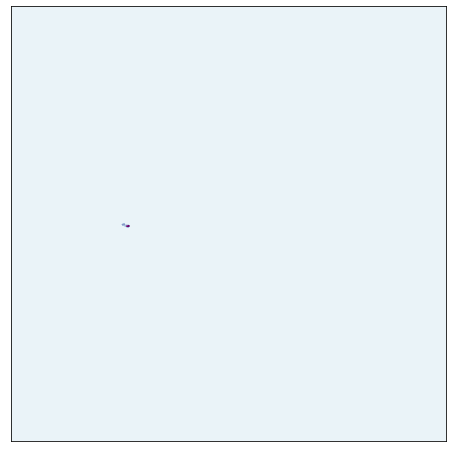

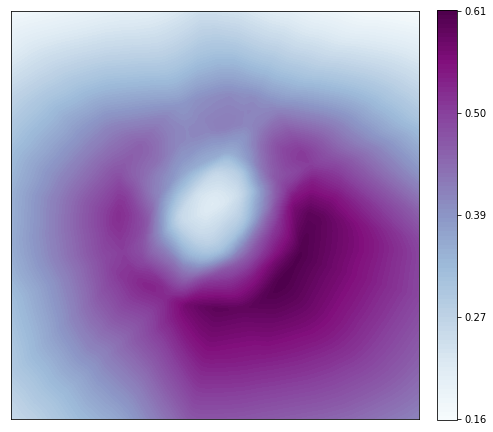

237/250 [===========================>..] - ETA: 0sIteration : 9100 [D loss: 0.615860, acc.: 75.39%] [G loss: 0.899004]
Vanilla   Duality GAP :  0.8053591
L Random  Duality Gap :  0.88450676


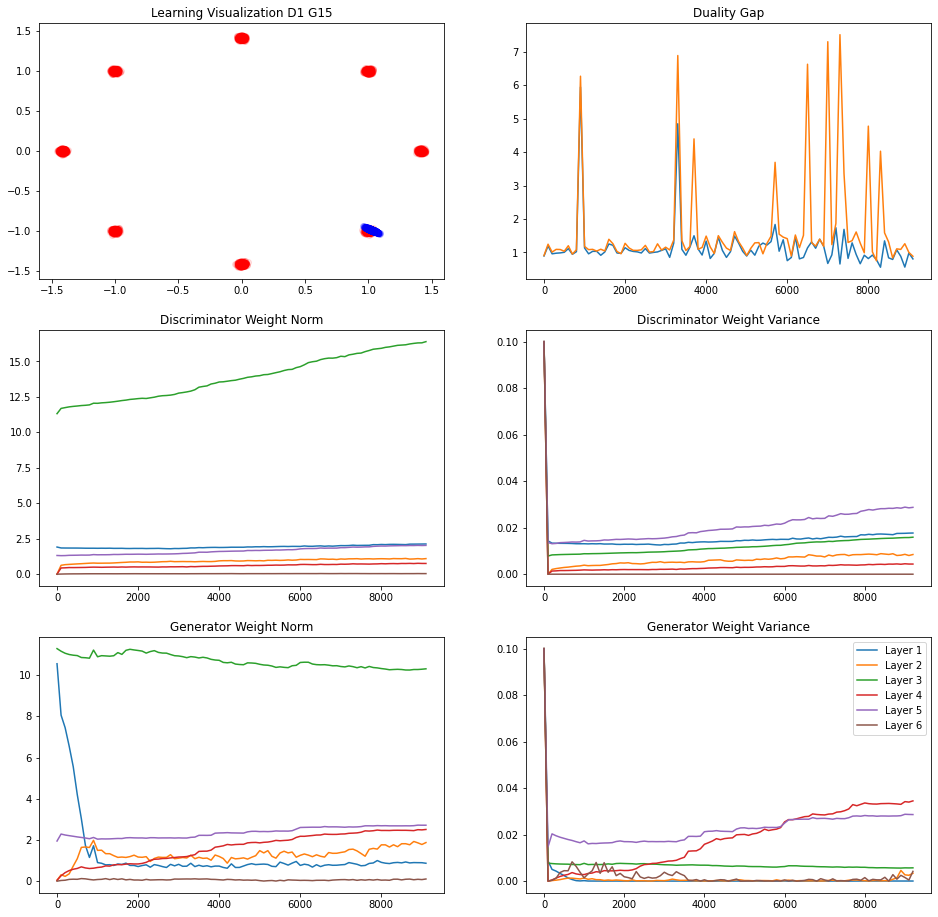

243/250 [============================>.] - ETA: 0sIteration : 9200 [D loss: 0.894838, acc.: 35.55%] [G loss: 0.369434]
Vanilla   Duality GAP :  1.4698466
L Random  Duality Gap :  1.4742427


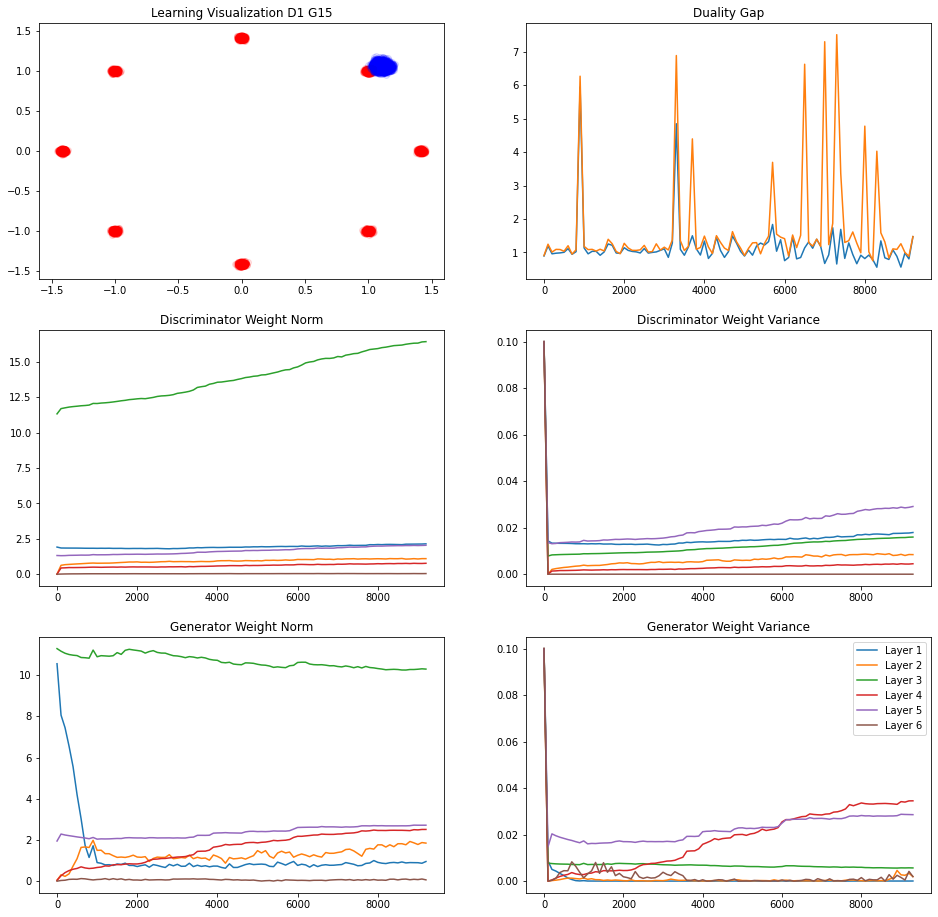

248/250 [============================>.] - ETA: 0sIteration : 9300 [D loss: 0.743048, acc.: 30.47%] [G loss: 0.615321]
Vanilla   Duality GAP :  1.1885468
L Random  Duality Gap :  1.3449627


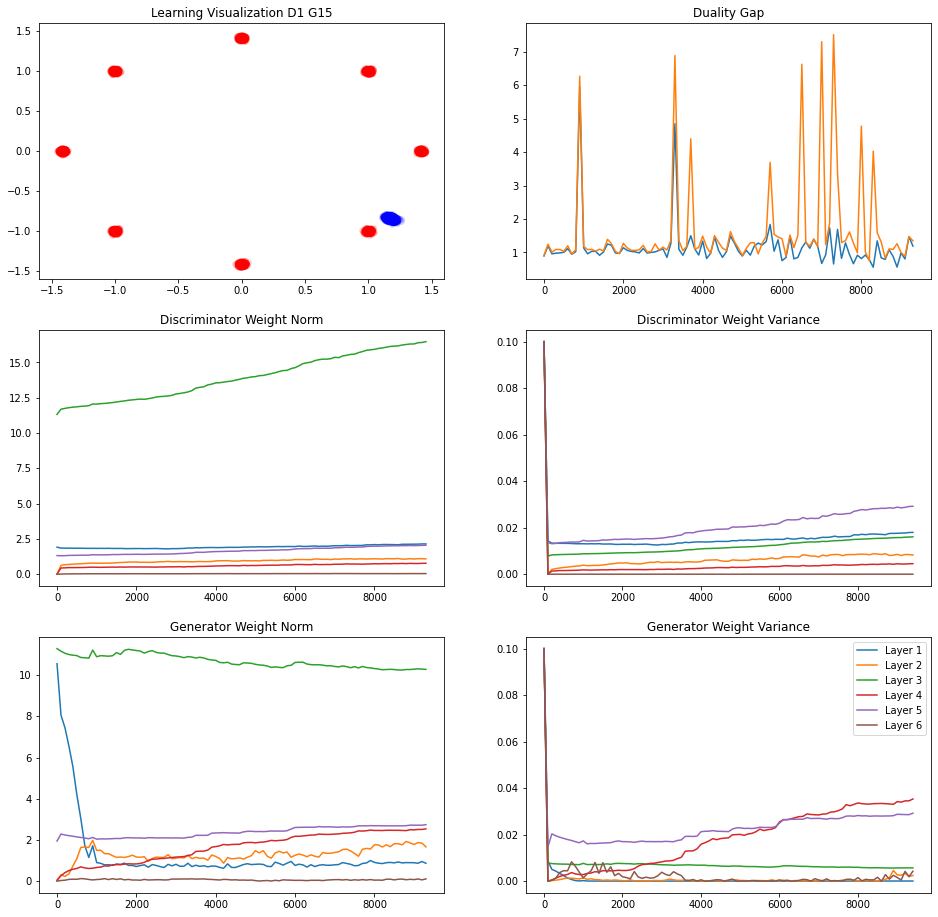

248/250 [============================>.] - ETA: 0sIteration : 9400 [D loss: 0.590671, acc.: 82.81%] [G loss: 0.875643]
Vanilla   Duality GAP :  0.8359361
L Random  Duality Gap :  1.3399974


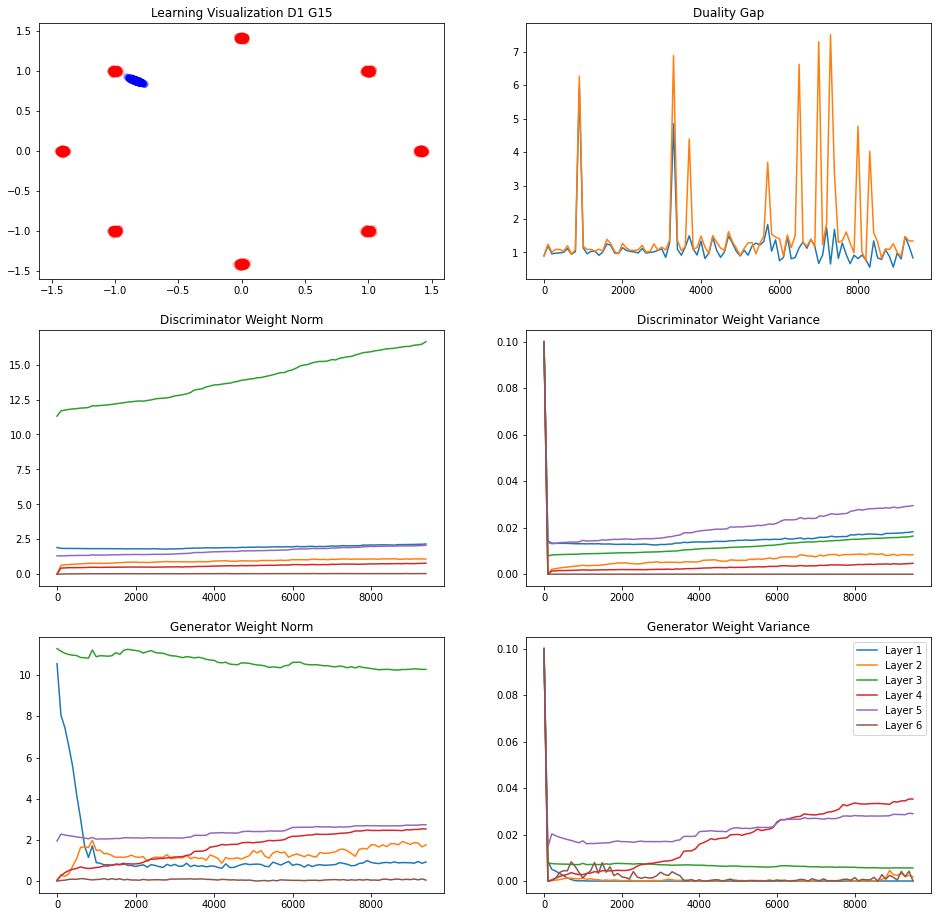

247/250 [============================>.] - ETA: 0sIteration : 9500 [D loss: 0.864117, acc.: 29.69%] [G loss: 0.453923]
Vanilla   Duality GAP :  1.5743341
L Random  Duality Gap :  1.6567272


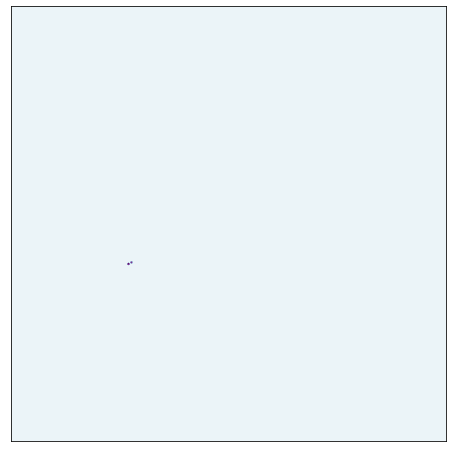

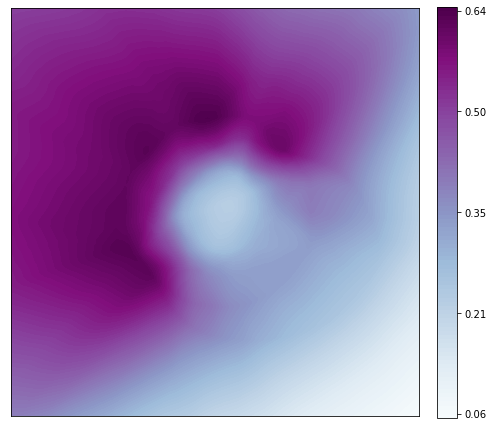

245/250 [============================>.] - ETA: 0sIteration : 9600 [D loss: 0.532828, acc.: 83.98%] [G loss: 1.302456]
Vanilla   Duality GAP :  0.6956675
L Random  Duality Gap :  1.550843


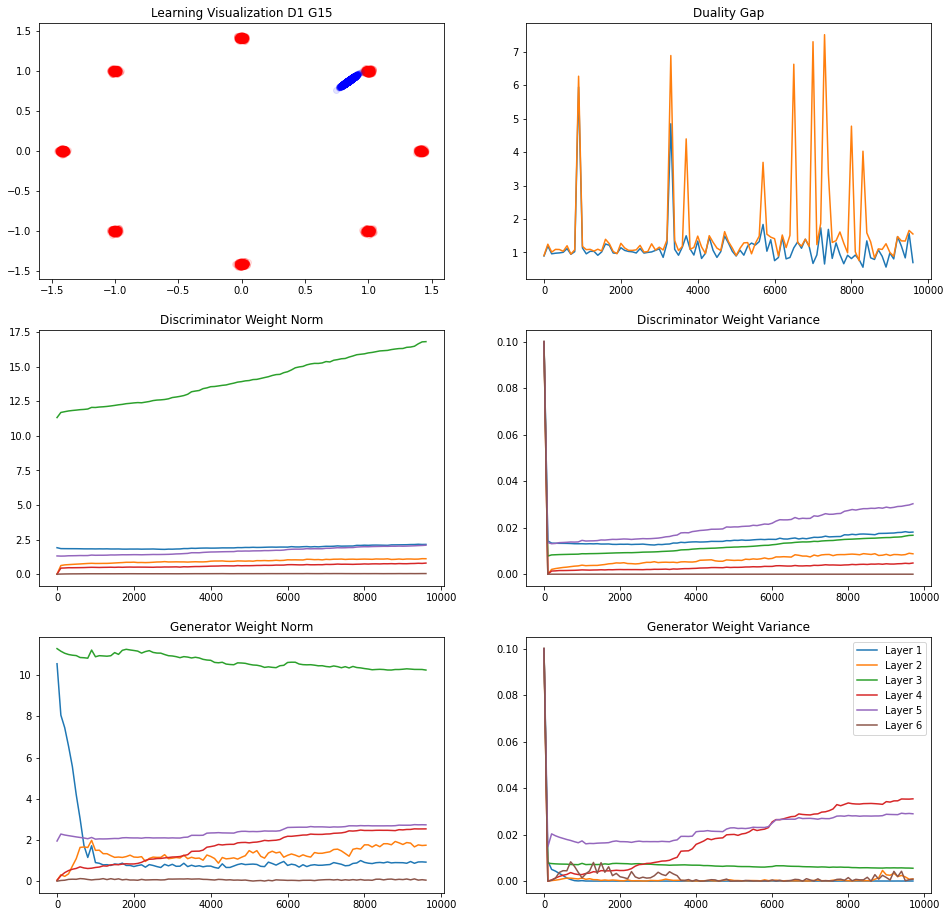

246/250 [============================>.] - ETA: 0sIteration : 9700 [D loss: 0.786807, acc.: 41.80%] [G loss: 0.509225]
Vanilla   Duality GAP :  1.2225451
L Random  Duality Gap :  1.3494997


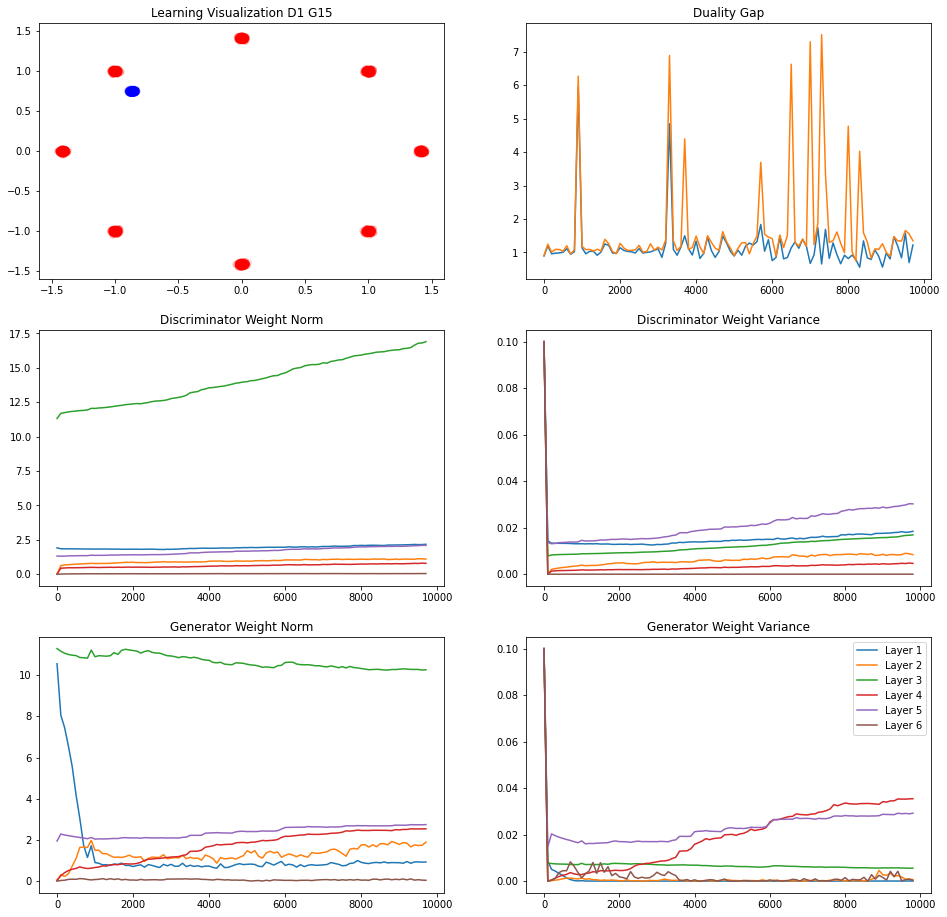

242/250 [============================>.] - ETA: 0sIteration : 9800 [D loss: 0.703376, acc.: 37.50%] [G loss: 0.637198]
Vanilla   Duality GAP :  0.9933001
L Random  Duality Gap :  1.0810726


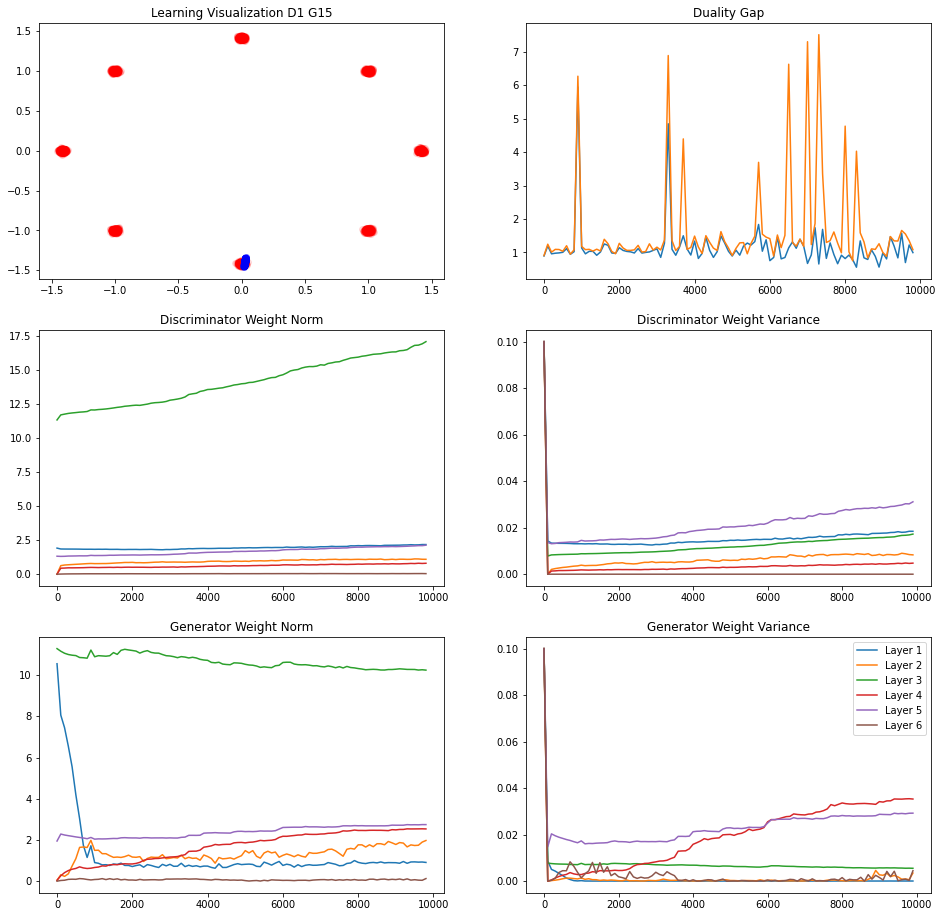

244/250 [============================>.] - ETA: 0sIteration : 9900 [D loss: 0.759790, acc.: 32.03%] [G loss: 0.577581]
Vanilla   Duality GAP :  1.1204531
L Random  Duality Gap :  1.3070464


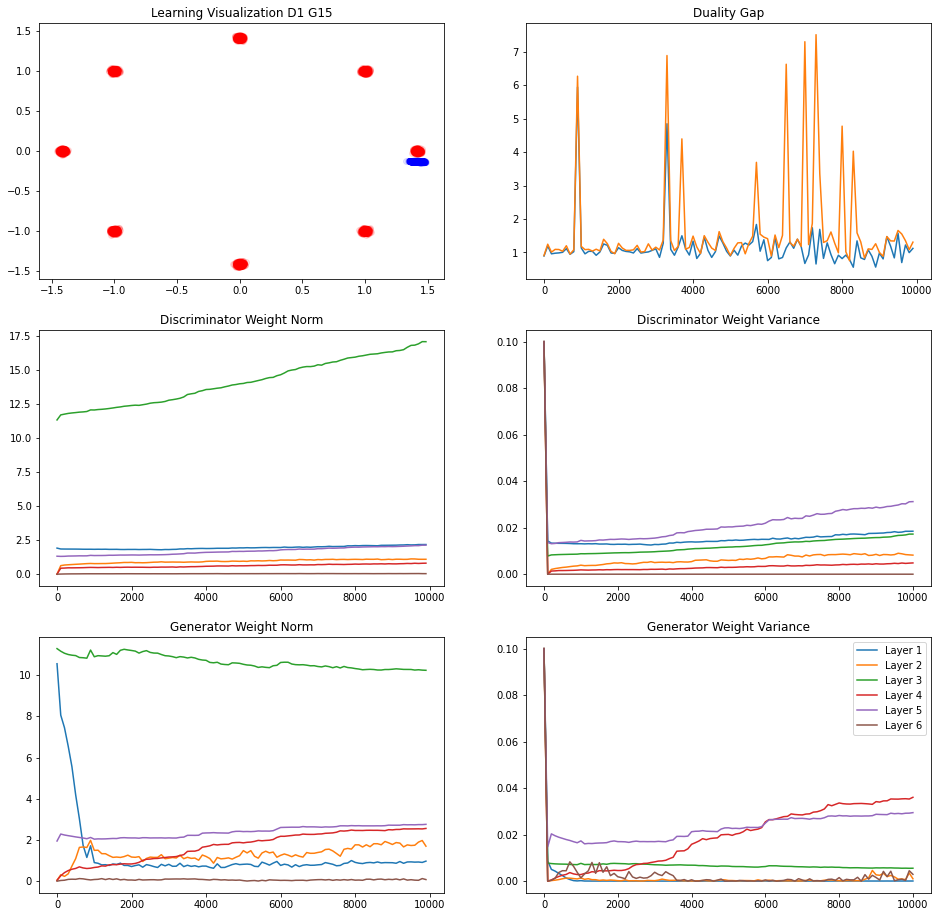

243/250 [============================>.] - ETA: 0sIteration : 10000 [D loss: 0.559881, acc.: 75.00%] [G loss: 1.069290]
Vanilla   Duality GAP :  0.6824939
L Random  Duality Gap :  1.4729548


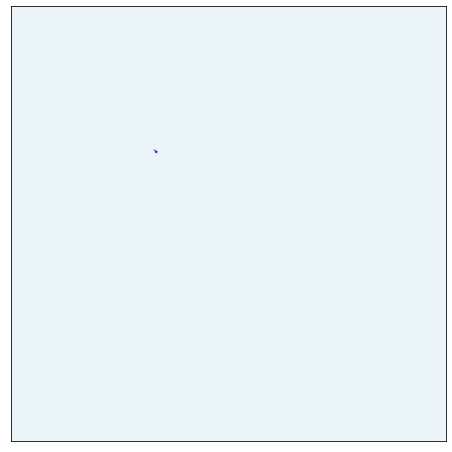

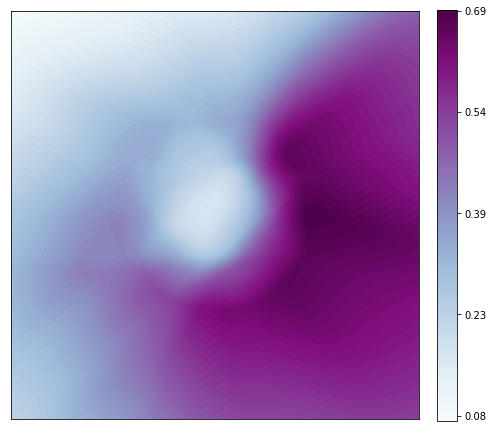

10000/10001 [============================>.] - ETA: 0s

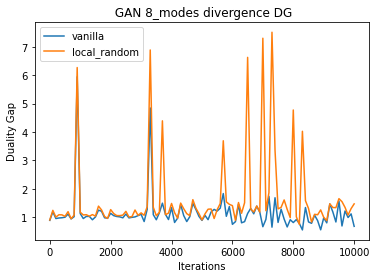

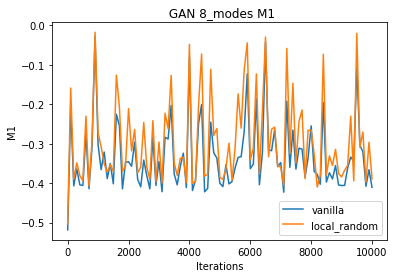

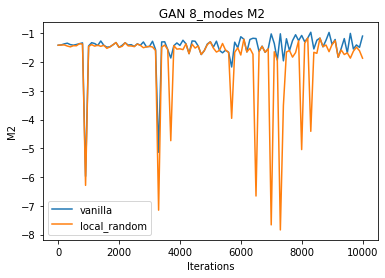

In [11]:

datasets      = ['8_modes']
exp_types     = ['convergence','mode_collapse','divergence']


total_data    = {}
epochs        = 10001
save_interval = 100
batch_size    = 128

model_data    = {}
for dataset in datasets:
    
    trials={}
    
    for setting in exp_types:
      
      models = {
      'GAN':Classic_GAN()
      } 

      for model in models.keys():
          print('--'*50+'\n\t\t{} {} {}\n'.format(dataset,model,setting)+'--'*50)
          save_path = './Experiments/{}/{}/{}'.format(dataset,model,setting)
          print(save_path)
          os.makedirs(save_path,exist_ok = True)               
          x_axis = [i for i in range(0,epochs,save_interval)]
          M1[model+'-vanilla-'+setting]=[]
          M2[model+'-vanilla-'+setting]=[]
          duality_gaps[model+'-vanilla-'+setting]=[]
          
          M1[model+'-local_random-'+setting]=[]
          M2[model+'-local_random-'+setting]=[]
          duality_gaps[model+'-local_random-'+setting]=[]
          
          models[model].configure_setting(setting)
          #train the model
          models[model].train(epochs=epochs, batch_size=batch_size, save_interval=save_interval,dataset=dataset,save_path=save_path)
          
          
          plt.figure()
          plt.title(' {} {} {} DG'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('Duality Gap')
          plt.plot(x_axis,duality_gaps[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,duality_gaps[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/DG.png',bbox_inches='tight')
          
          
          plt.figure()
          plt.title(' {} {} M1'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('M1')
          plt.plot(x_axis,M1[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,M1[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/M1.png',bbox_inches='tight')
          
          plt.figure()
          plt.title(' {} {} M2'.format(model,dataset,setting))
          plt.xlabel('Iterations')
          plt.ylabel('M2')
          plt.plot(x_axis,M2[model+'-vanilla-'+setting],label='vanilla')
          plt.plot(x_axis,M2[model+'-local_random-'+setting],label='local_random')
          plt.legend()
          plt.savefig(save_path+'/M2.png',bbox_inches='tight')
          
          trials['{}'.format(model)]={
              'DG':duality_gaps,
              'M1' :M1,
              'M2' :M2
          } 
          
    model_data[dataset]=models    
    total_data[dataset]=trials